# Машинное обучение, ФКН ВШЭ

## Практическое задание 5. Решающие деревья

### Общая информация
Дата выдачи: 29.11.2023

Мягий дедлайн: 23:59 12.12.2023

Жестокий дедлайн: 23:59 14.12.2023

### О задании

Задание состоит из двух разделов:
1. В первом разделе вы научитесь применять деревья из sklearn для задачи классификации. Вы посмотрите какие разделяющие поверхности деревья строят для различных датасетов и проанализируете их зависимость от различных гиперпараметров.
2. Во втором разделе вы попробуете реализовать свое решающее дерево и сравните его со стандартное имплиментацией из sklearn. Вы также протестируете деревья на более сложных датасетах и сравните различные подходы к кодированию категориальных признаков.

### Оценивание и штрафы
Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.


### Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-05-trees-Username.ipynb
* Модуль hw5code.py
* Ссылки на посылки в Яндекс.Контесте для обеих задач

В контест https://contest.yandex.ru/contest/56884/problems/ нужно отправить файл hw5code.py с реализованными функциями и классами.

Username — ваша фамилия и имя на латинице именно в таком порядке

Для удобства проверки самостоятельно посчитайте свою максимальную оценку (исходя из набора решенных задач) и укажите ниже:

__Оценка:__

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from matplotlib.colors import Colormap, ListedColormap
import pandas as pd
from sklearn.model_selection import train_test_split
import seaborn as sns
sns.set(style='whitegrid')

import warnings
warnings.filterwarnings('ignore')

%load_ext autoreload
%autoreload 2

# 1. Решающие деревья. Визуализация.

В этой части мы рассмотрим два простых двумерных датасета сделанных с помощью `make_moons`, `make_circles` и посмотрим как ведет себя разделяющая поверхность в зависимости от различных гиперпараметров.

In [2]:
from sklearn.datasets import make_moons, make_circles, make_classification
datasets = [
    make_circles(noise=0.2, factor=0.5, random_state=42),
    make_moons(noise=0.2, random_state=42),
    make_classification(n_classes=3, n_clusters_per_class=1, n_features=2, class_sep=.8, random_state=3,
                        n_redundant=0., )
]

In [4]:
palette = sns.color_palette(n_colors=3)
cmap = ListedColormap(palette)

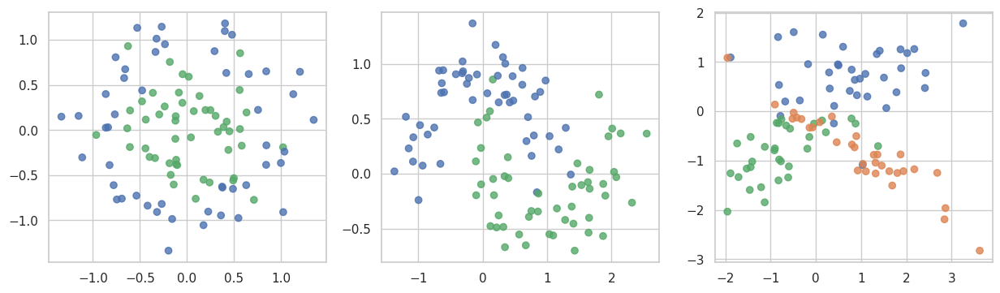

In [5]:
plt.figure(figsize=(15, 4))
for i, (x, y) in enumerate(datasets):
    plt.subplot(1, 3, i + 1)
    plt.scatter(x[:, 0], x[:, 1], c=y, cmap=cmap, alpha=.8)

__Задание 1. (1 балл)__

Для каждого датасета обучите решающее дерево с параметрами по умолчанию, предварительно разбив выборку на обучающую и тестовую. Постройте разделящие поверхности (для этого воспользуйтесь функцией `plot_surface`, пример ниже). Посчитайте accuracy на обучающей и тестовой выборках. Сильно ли деревья переобучились?

In [3]:
def plot_surface(clf, X, y, title=""):
    plot_step = 0.01
    palette = sns.color_palette(n_colors=len(np.unique(y)))
    cmap = ListedColormap(palette)
    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, plot_step),
                         np.arange(y_min, y_max, plot_step))
    plt.tight_layout(h_pad=0.5, w_pad=0.5, pad=2.5)

    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    cs = plt.contourf(xx, yy, Z, cmap=cmap, alpha=0.3)

    plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap, alpha=.7,
                edgecolors=np.array(palette)[y], linewidths=2)
    
    plt.title(title)

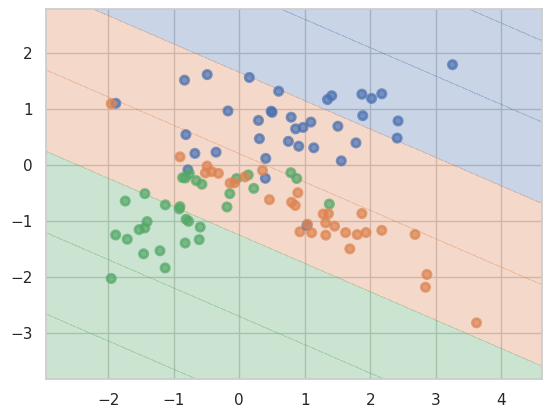

In [7]:
# Пример:
from sklearn.linear_model import LinearRegression
X, y = datasets[2]
lr  = LinearRegression().fit(X, y)
plot_surface(lr, X, y)

Accuracy on train for dataset 1: 1.00


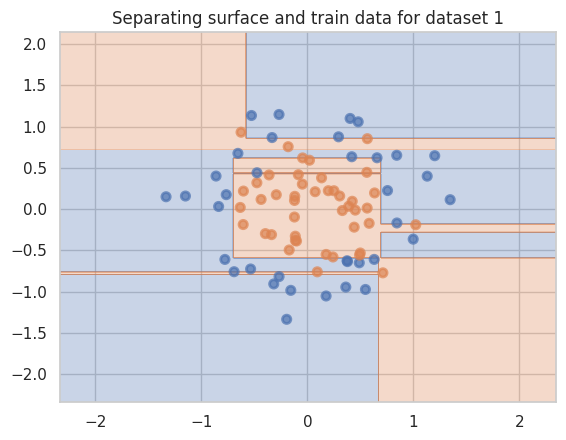

Accuracy on test for dataset 1: 0.65


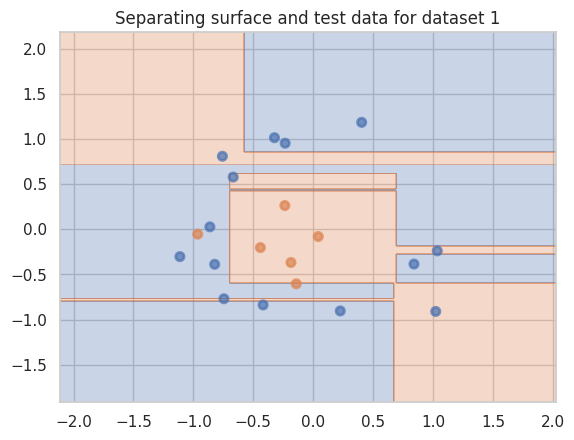

Accuracy on train for dataset 2: 1.00


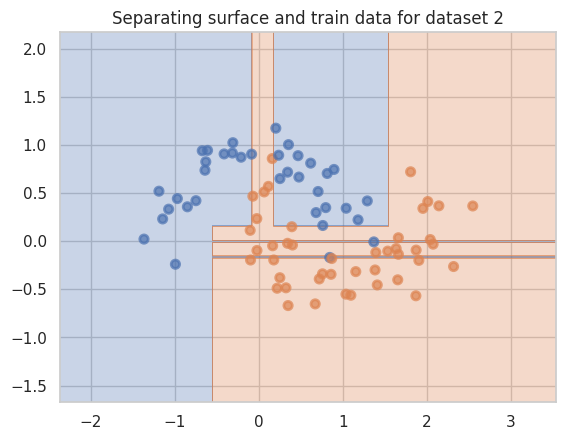

Accuracy on test for dataset 2: 0.95


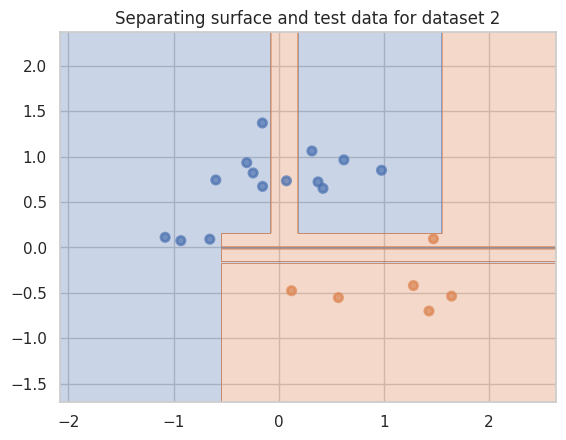

Accuracy on train for dataset 3: 1.00


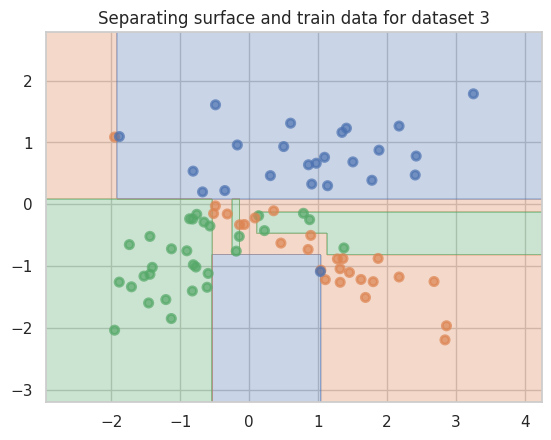

Accuracy on test for dataset 3: 0.70


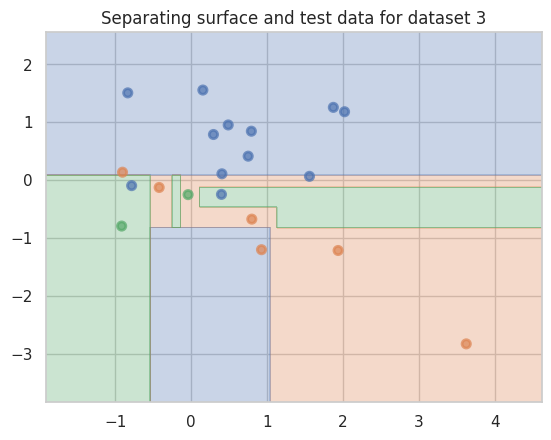

In [4]:
from sklearn.metrics import accuracy_score

for i in range(3):
    X, y = datasets[i]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    model = DecisionTreeClassifier()
    model.fit(X_train, y_train)
    
    y_train_pred = model.predict(X_train)
    print(f"Accuracy on train for dataset {i+1}: {accuracy_score(y_train, y_train_pred):.2f}")
    plot_surface(model, X_train, y_train, f"Separating surface and train data for dataset {i + 1}")
    plt.show()
    
    y_test_pred = model.predict(X_test)
    print(f"Accuracy on test for dataset {i+1}: {accuracy_score(y_test, y_test_pred):.2f}")
    plot_surface(model, X_test, y_test, f"Separating surface and test data for dataset {i + 1}")
    plt.show()

__Ответ:__ в принципе качество на тестовом датасете получилось везде неплохое, особенно на втором. Но переобучение довольно заметно, во-первых, потому что на train идеальное качество; а во-вторых, на разделяющих поверхностях довольно много <<вырожденных>>, явно подстроенных под тестовую выборку параметров, типа каких-нибудь узких полос, в которых лежит всего один-два элемента, которые в нормальной модели мы бы скорее хотели посчитать выбросами и отнести к другому классу.

__Задание 2. (1.5 балла)__

Попробуйте перебрать несколько параметров для регуляризации (напр. `max_depth`, `min_samples_leaf`). Для каждого набора гиперпараметров постройте разделяющую поверхность, выведите обучающую и тестовую ошибки. Можно делать кросс-валидацию или просто разбиение на трейн и тест, главное делайте каждый раз одинаковое разбиение, чтобы можно было корректно сравнивать (помните же, что итоговое дерево сильно зависит от небольшого изменения обучающей выборки?). Проследите как меняется разделяющая поверхность и обобщающая способность. Почему так происходит, одинаково ли изменение для разных датасетов?

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 1: 0.81


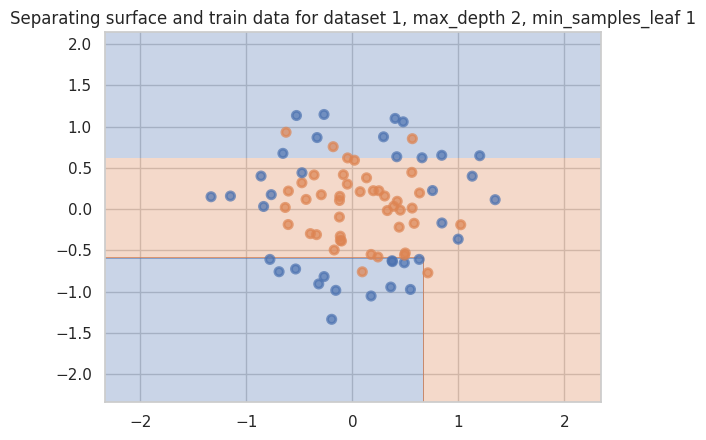

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 1: 0.60


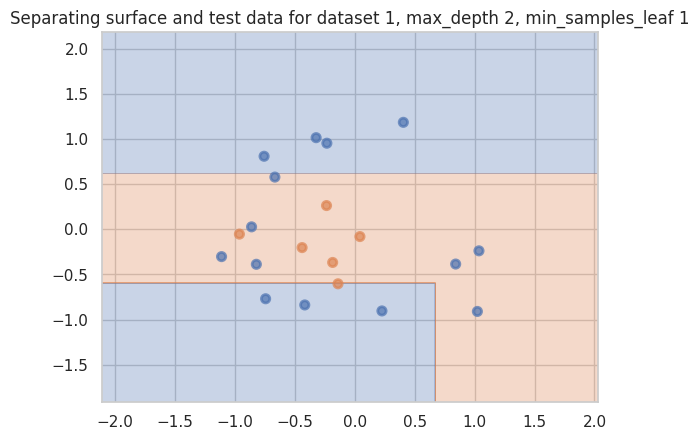

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 2: 0.80


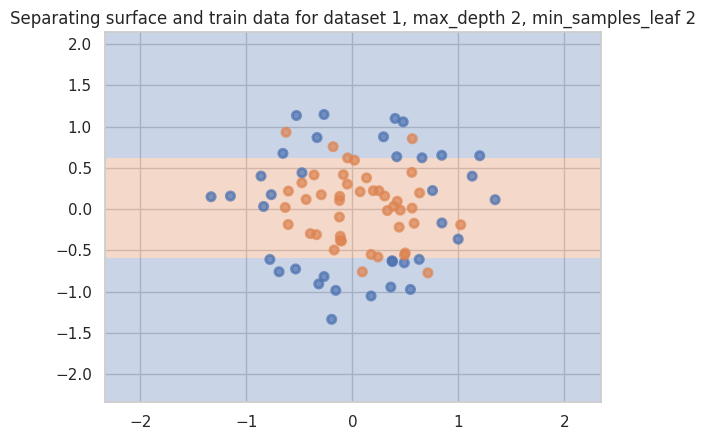

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 2: 0.65


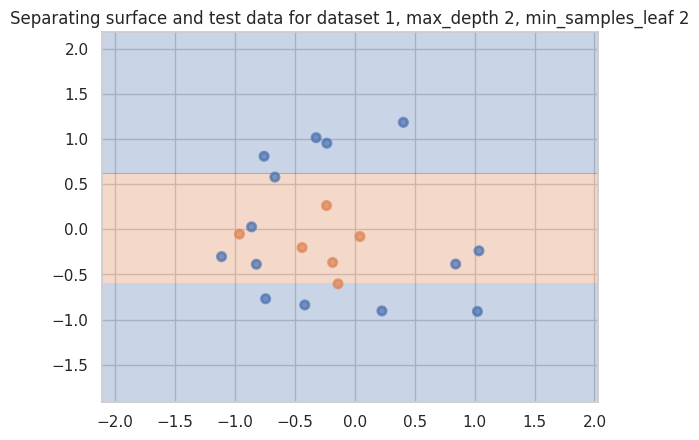

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 3: 0.80


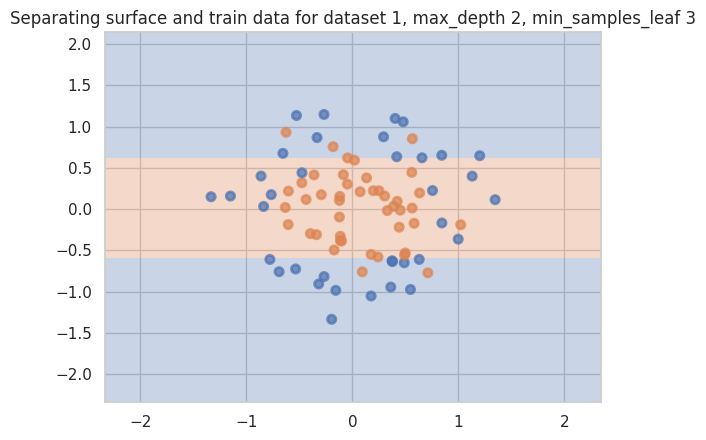

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 3: 0.65


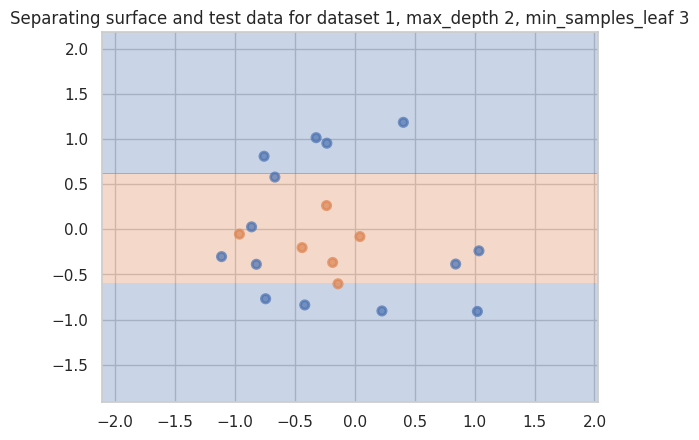

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 4: 0.80


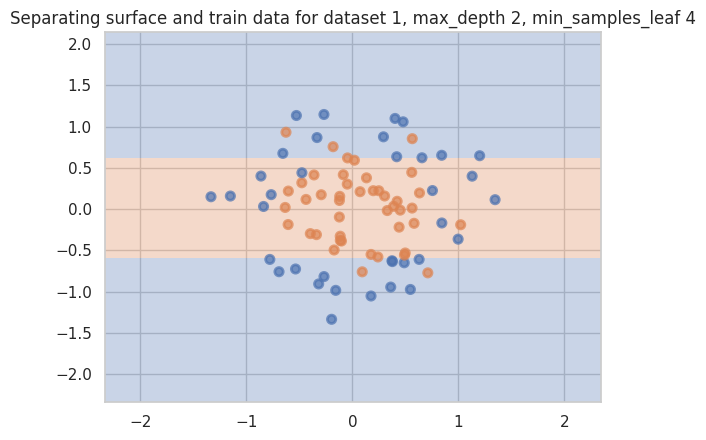

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 4: 0.65


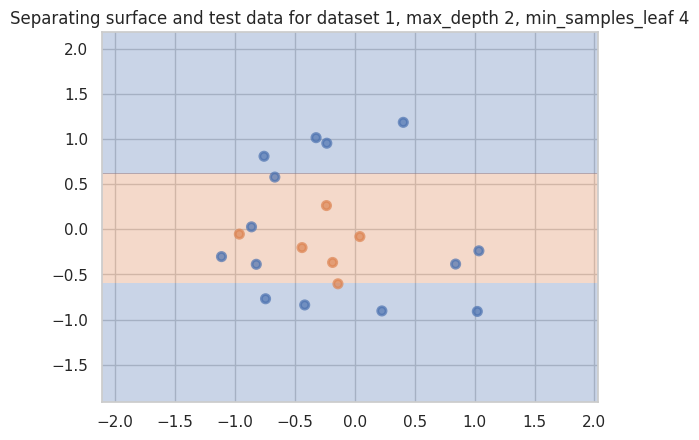

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 5: 0.80


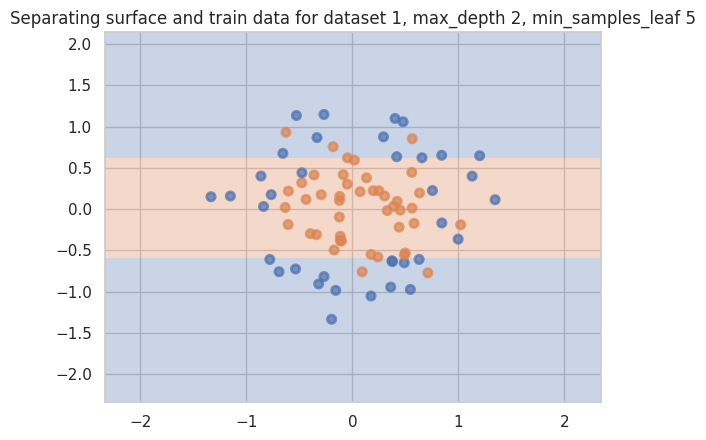

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 5: 0.65


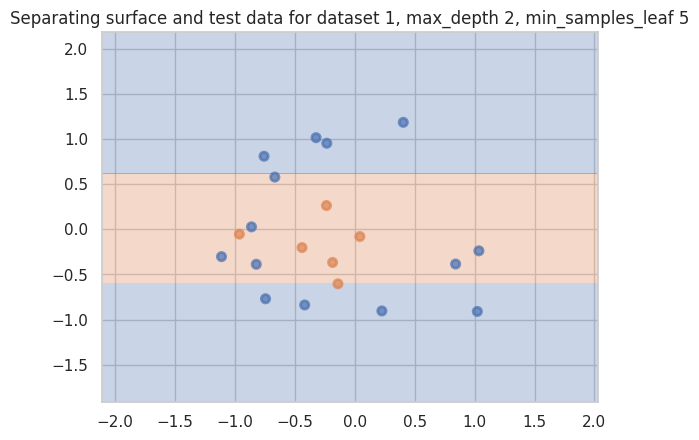

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 6: 0.80


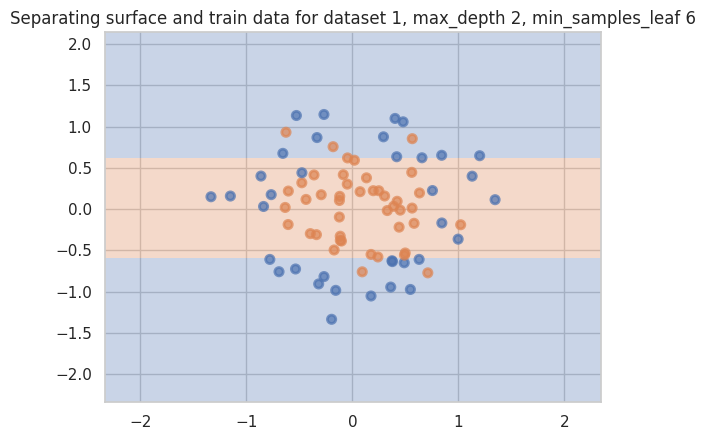

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 6: 0.65


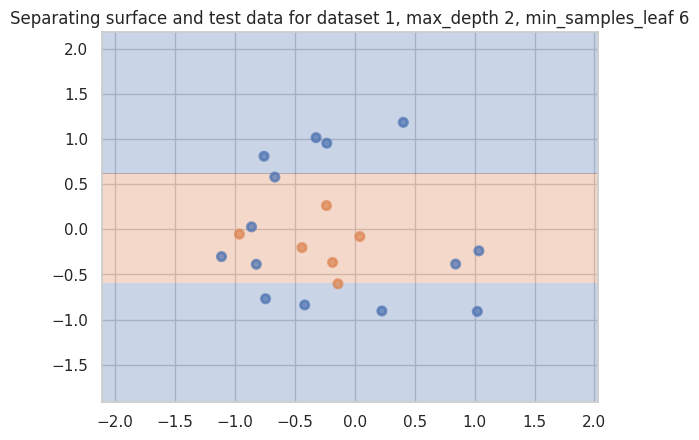

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 7: 0.80


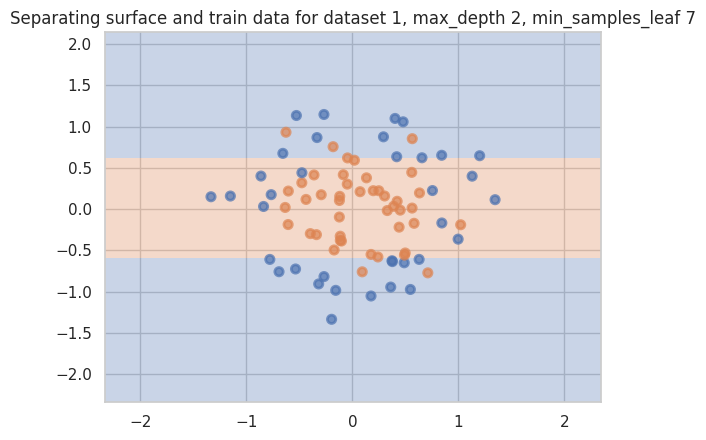

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 7: 0.65


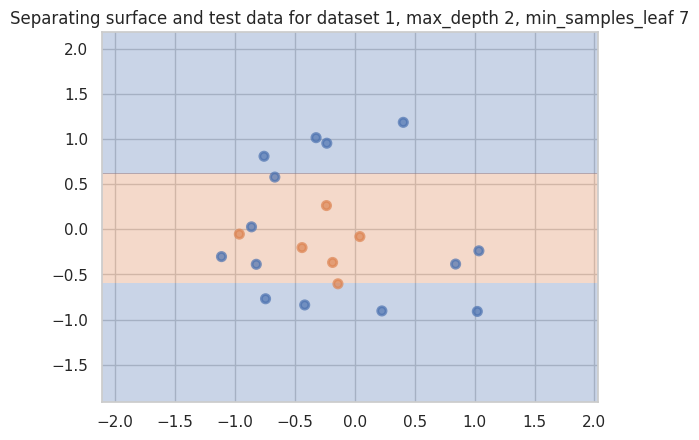

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 8: 0.80


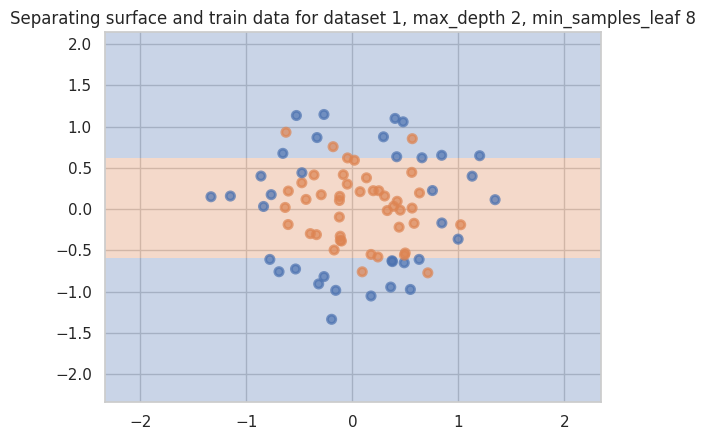

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 8: 0.65


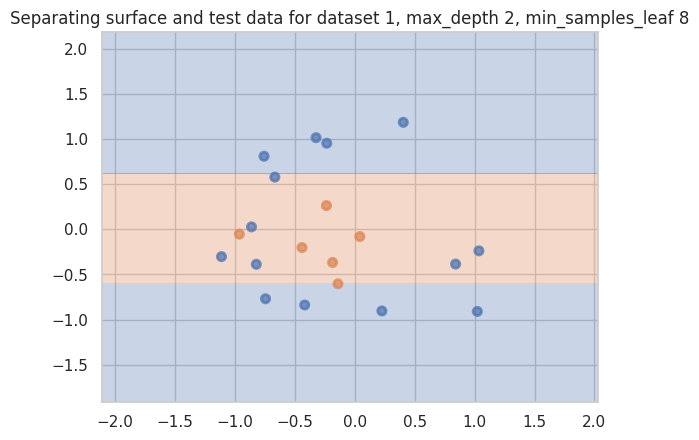

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 9: 0.80


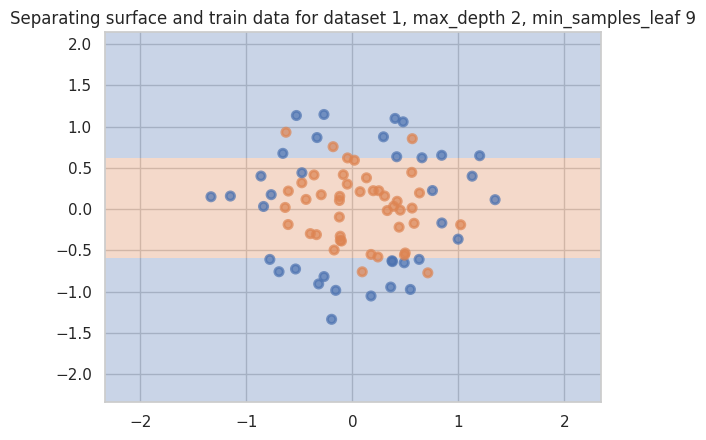

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 9: 0.65


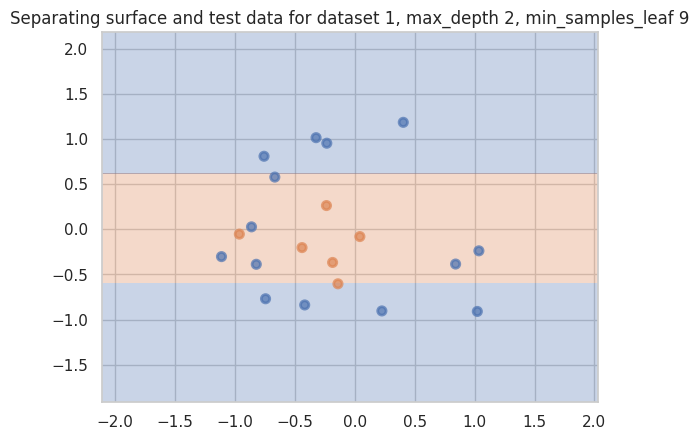

Accuracy on train for dataset 1, max_depth 2, min_samples_leaf 10: 0.80


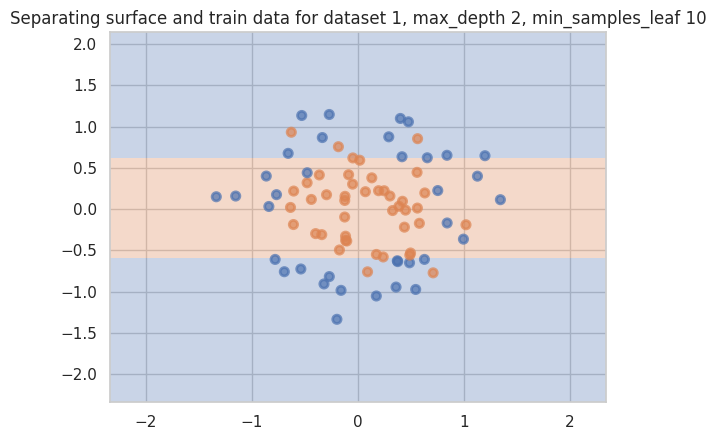

Accuracy on test for dataset 1, max_depth 2, min_samples_leaf 10: 0.65


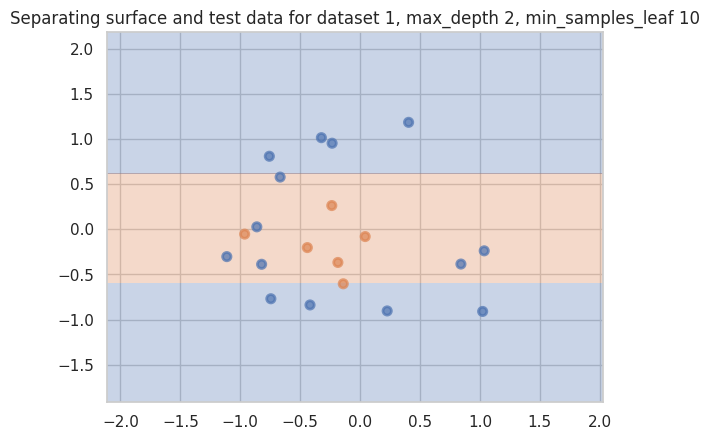

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 1: 0.88


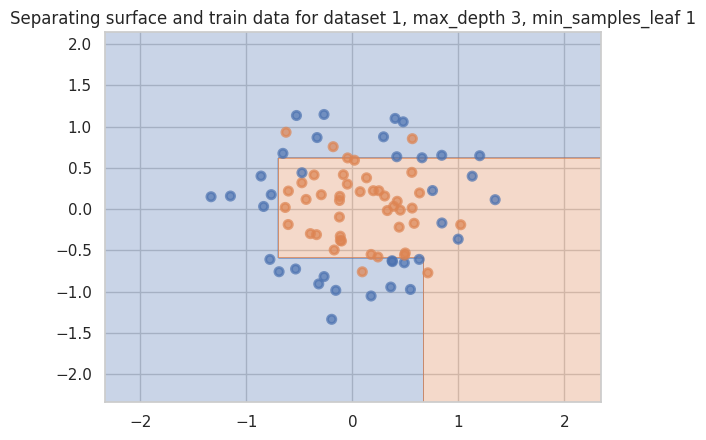

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 1: 0.70


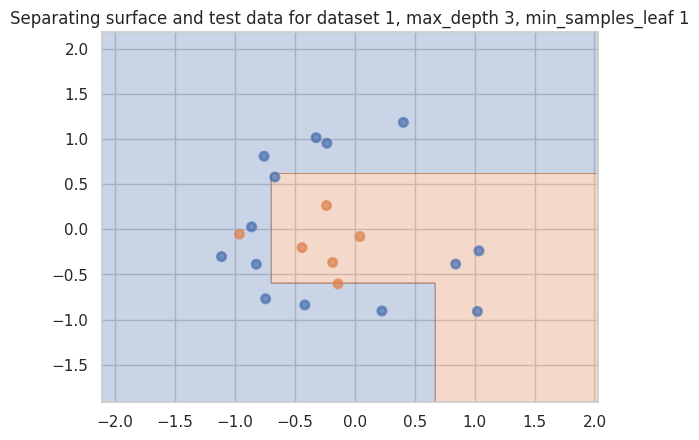

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 2: 0.86


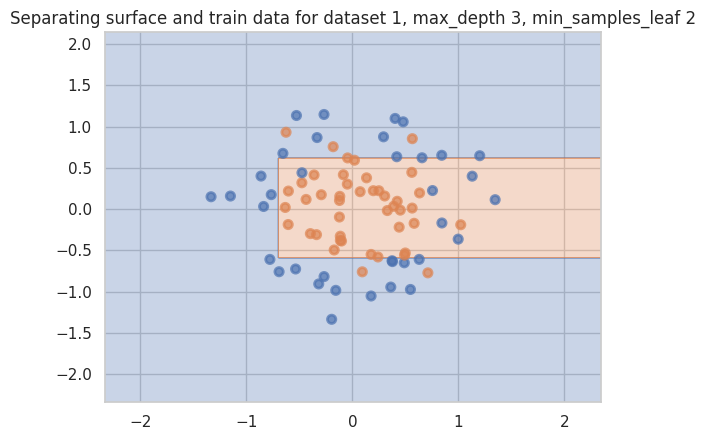

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 2: 0.75


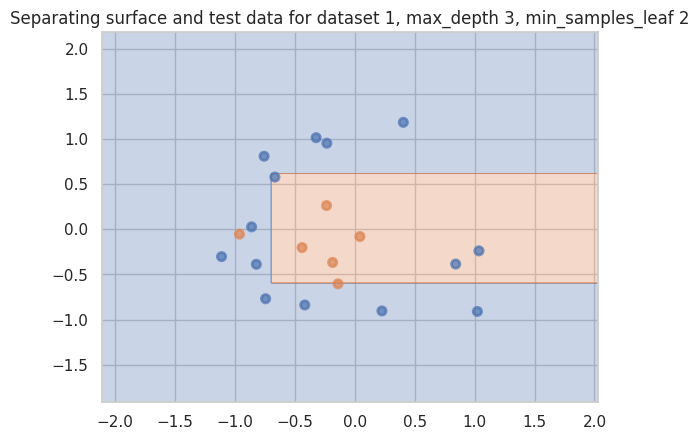

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 3: 0.86


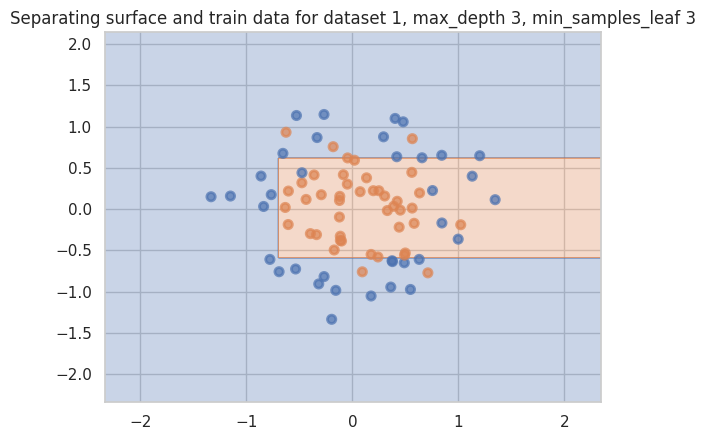

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 3: 0.75


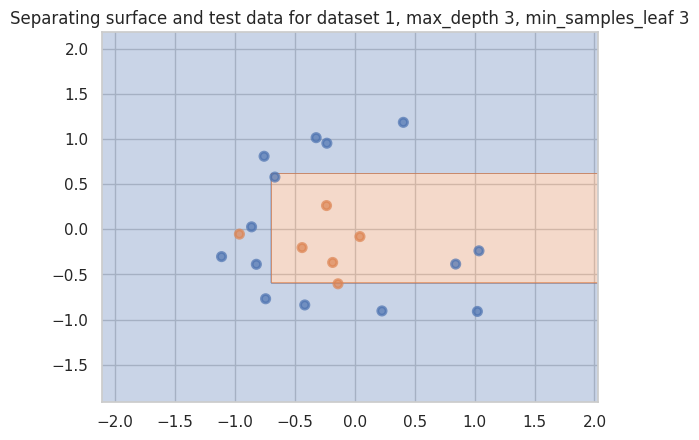

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 4: 0.86


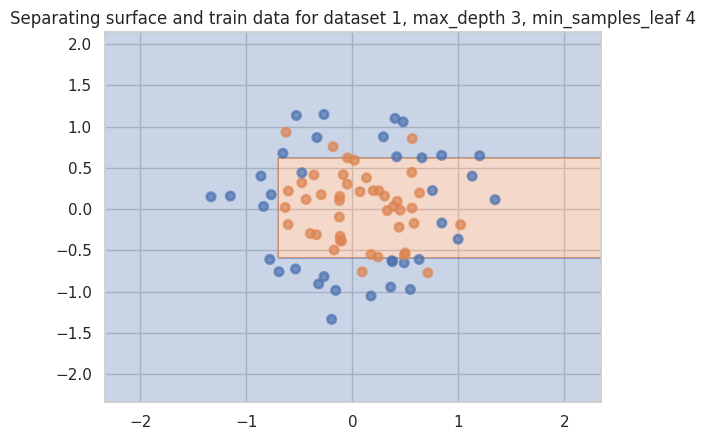

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 4: 0.75


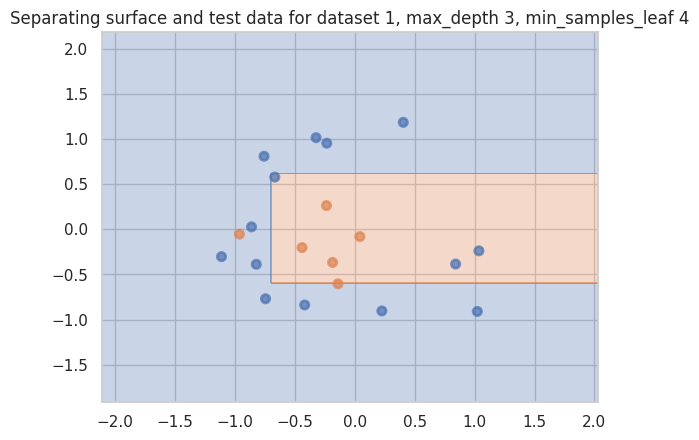

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 5: 0.86


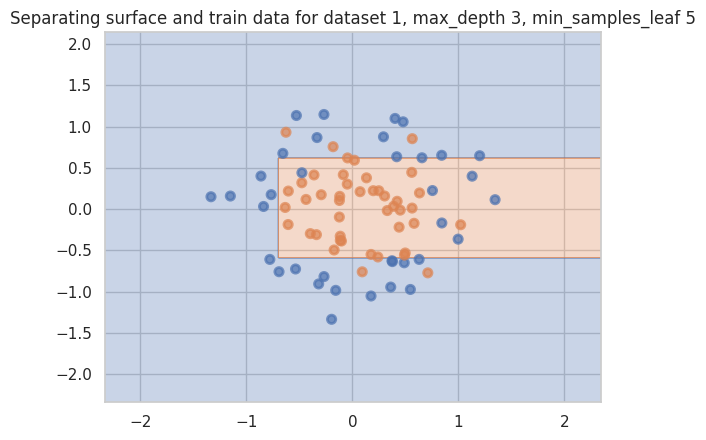

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 5: 0.75


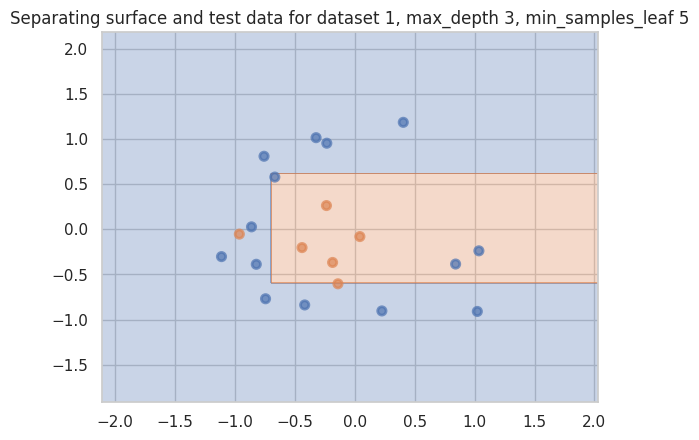

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 6: 0.85


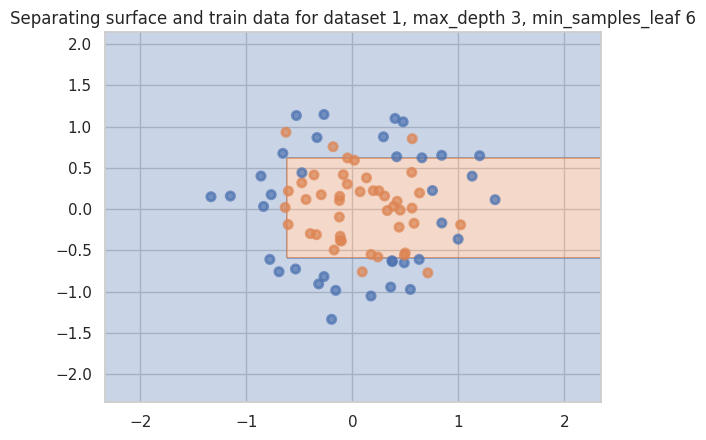

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 6: 0.80


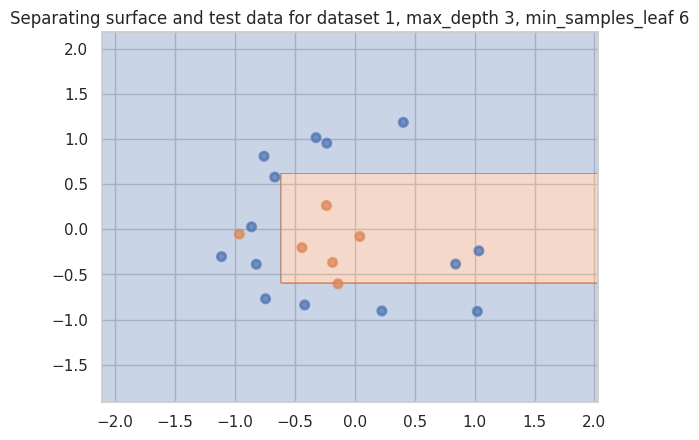

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 7: 0.84


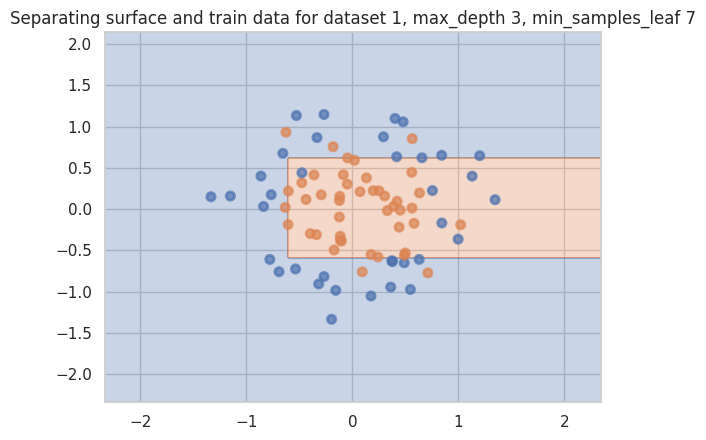

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 7: 0.80


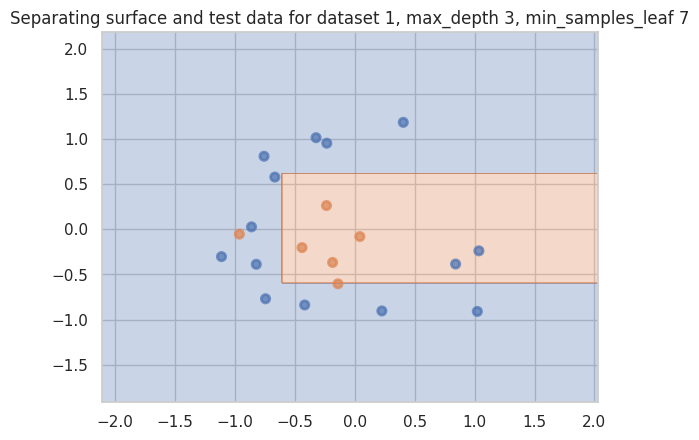

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 8: 0.82


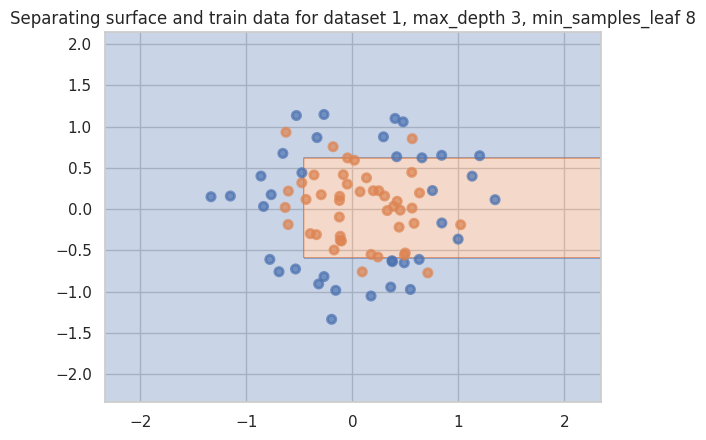

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 8: 0.80


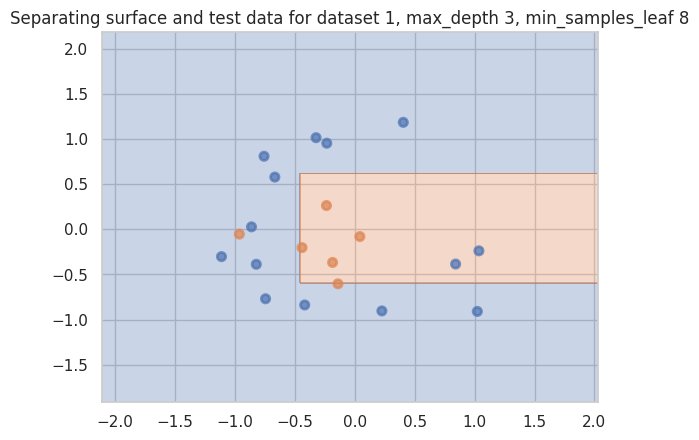

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 9: 0.82


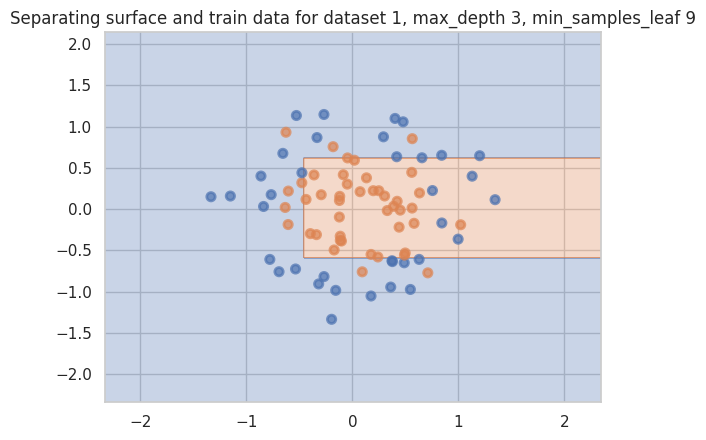

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 9: 0.80


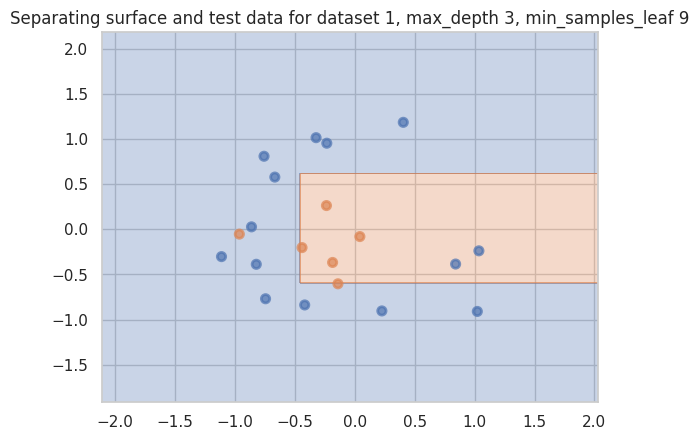

Accuracy on train for dataset 1, max_depth 3, min_samples_leaf 10: 0.82


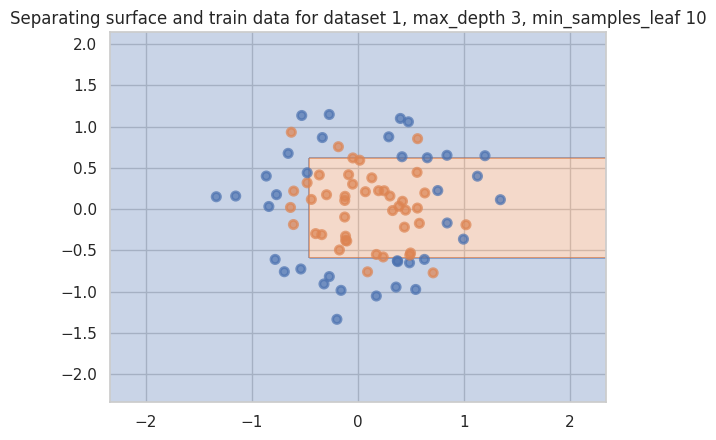

Accuracy on test for dataset 1, max_depth 3, min_samples_leaf 10: 0.80


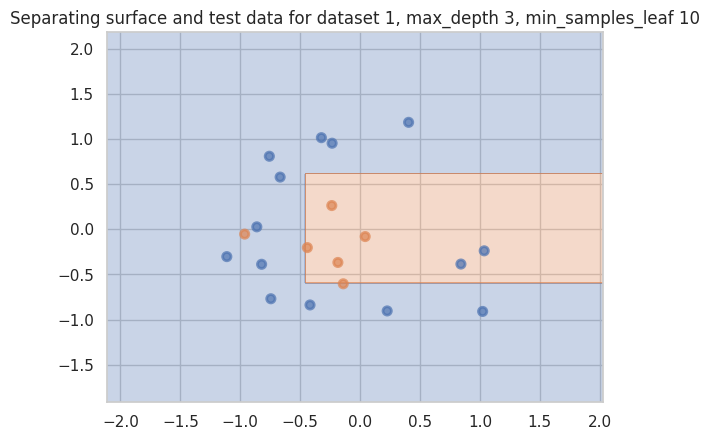

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 1: 0.96


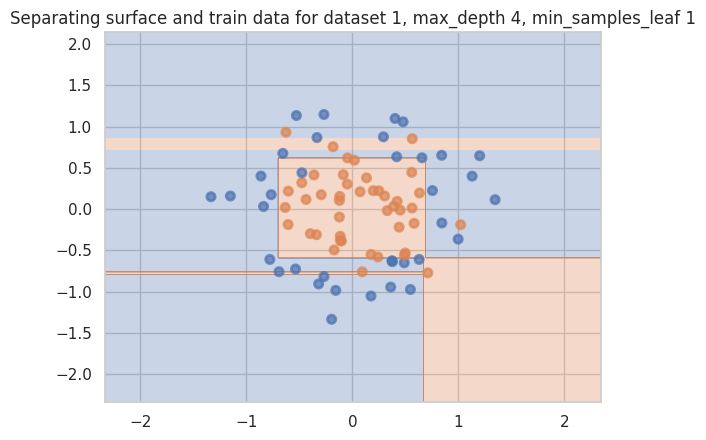

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 1: 0.70


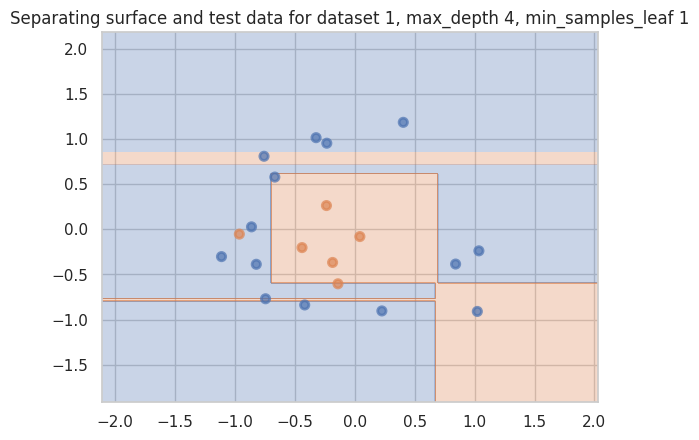

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 2: 0.94


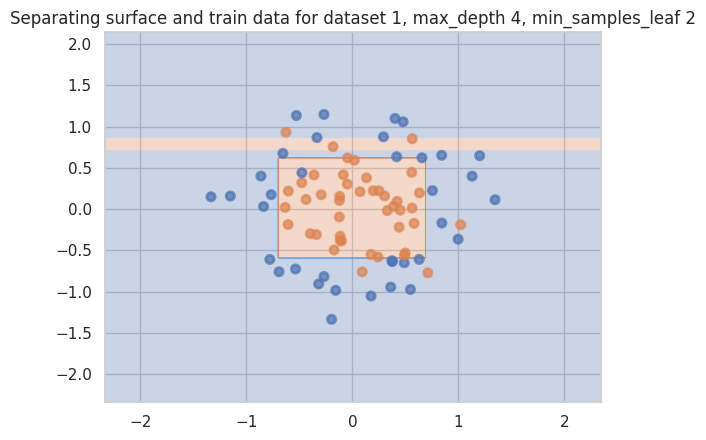

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 2: 0.80


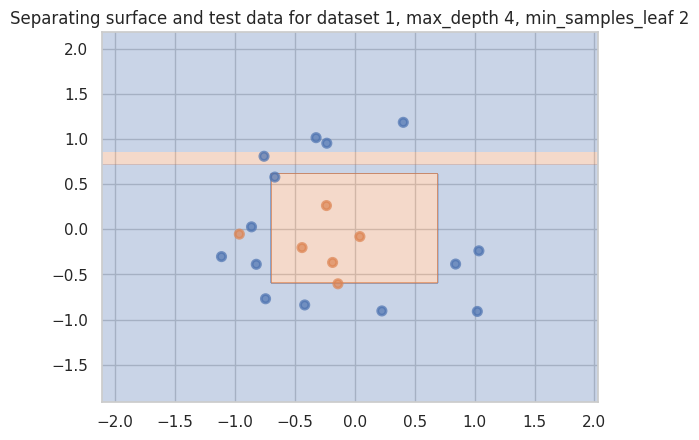

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 3: 0.93


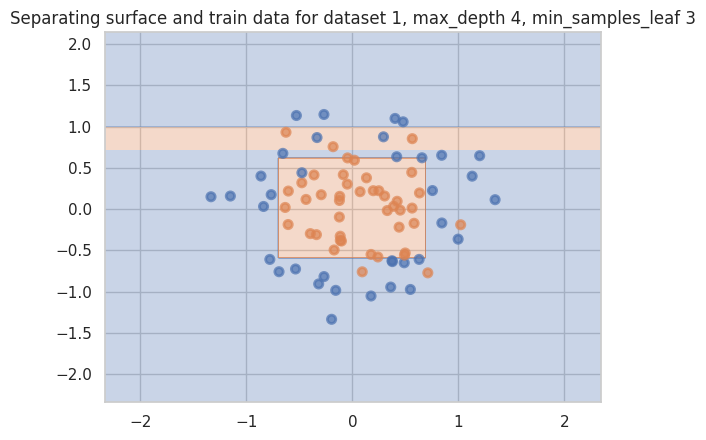

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 3: 0.75


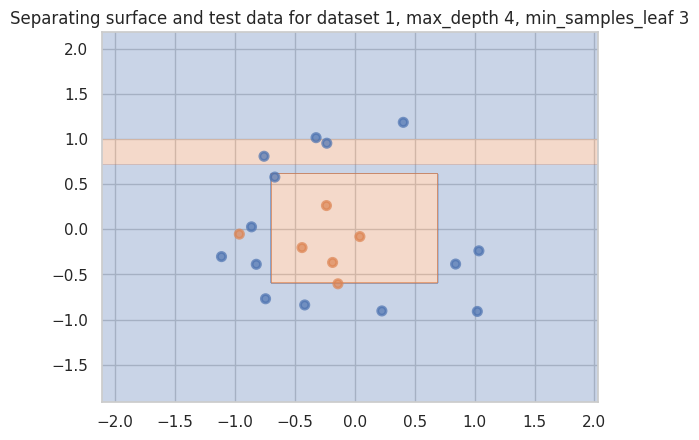

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 4: 0.93


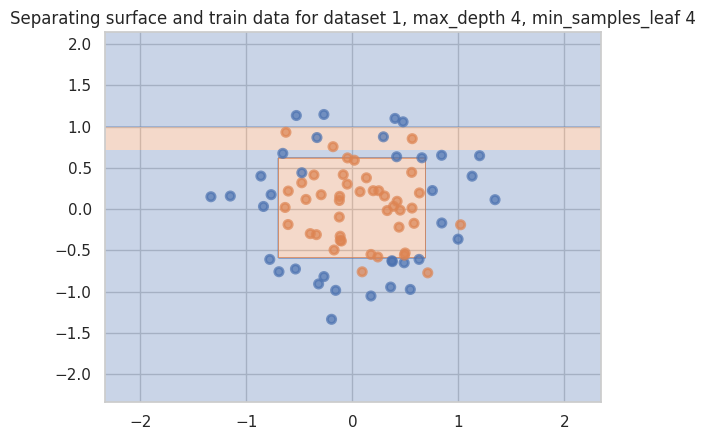

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 4: 0.75


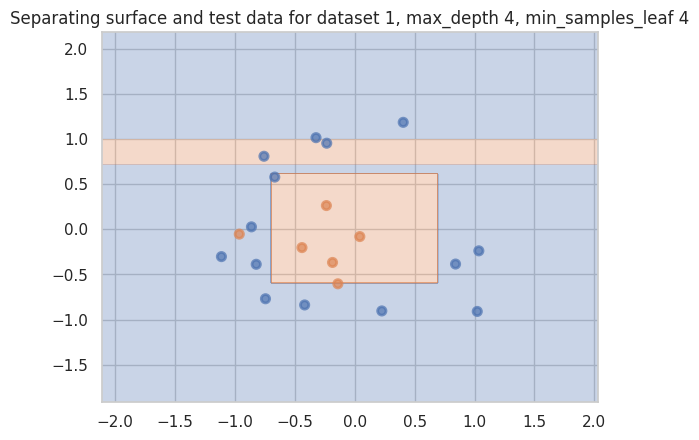

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 5: 0.91


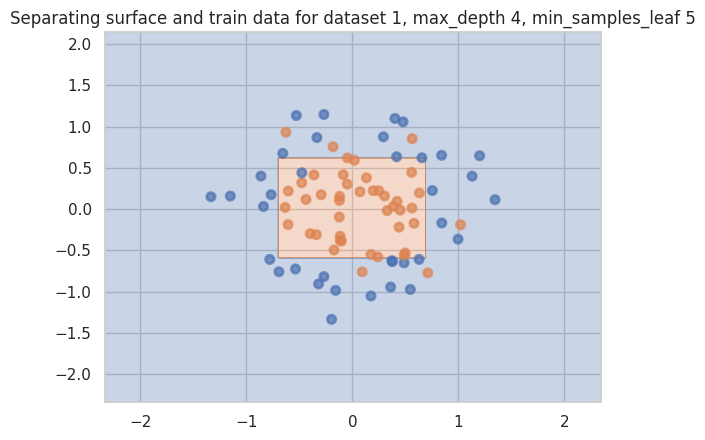

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 5: 0.85


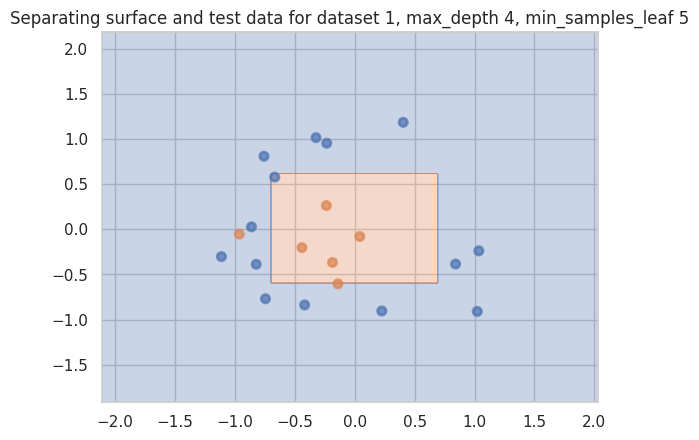

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 6: 0.90


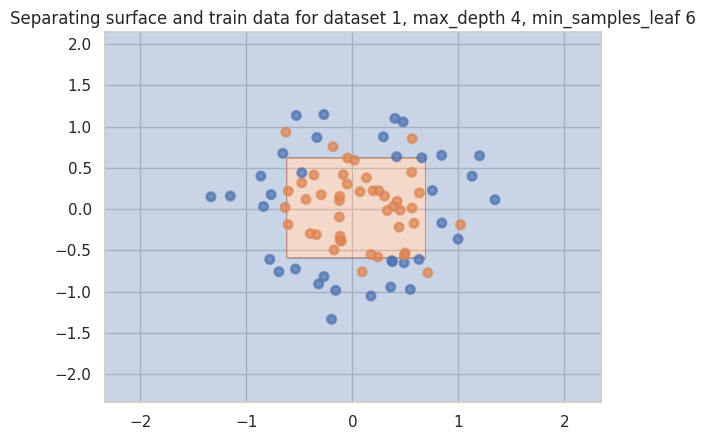

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 6: 0.90


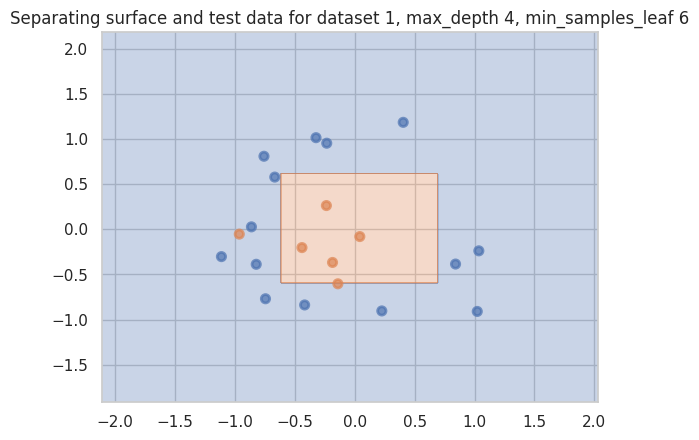

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 7: 0.88


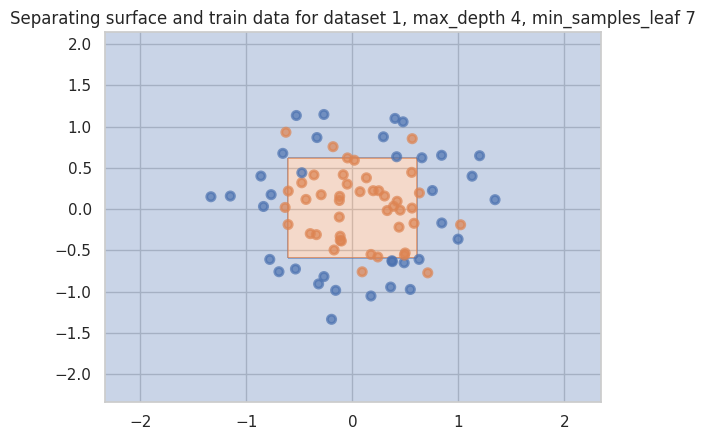

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 7: 0.90


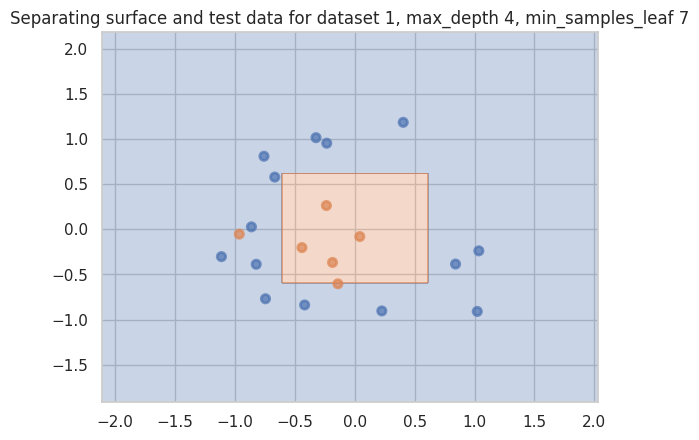

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 8: 0.85


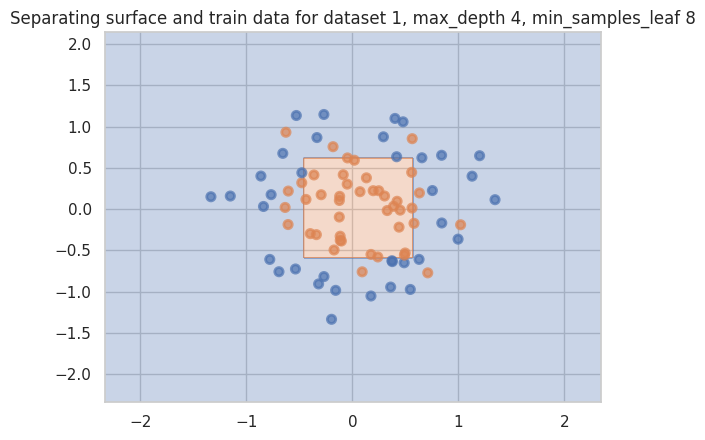

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 8: 0.90


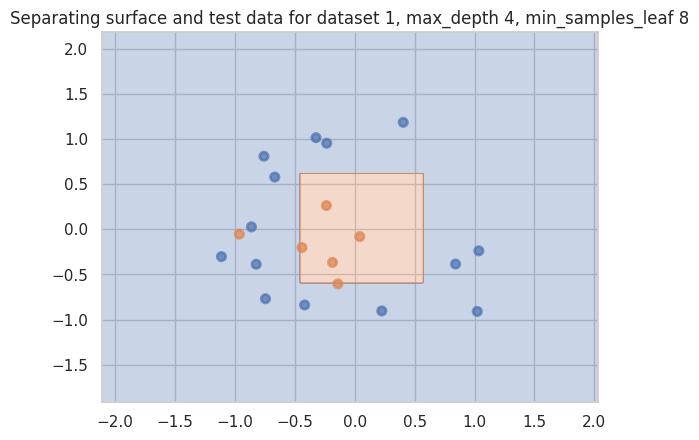

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 9: 0.84


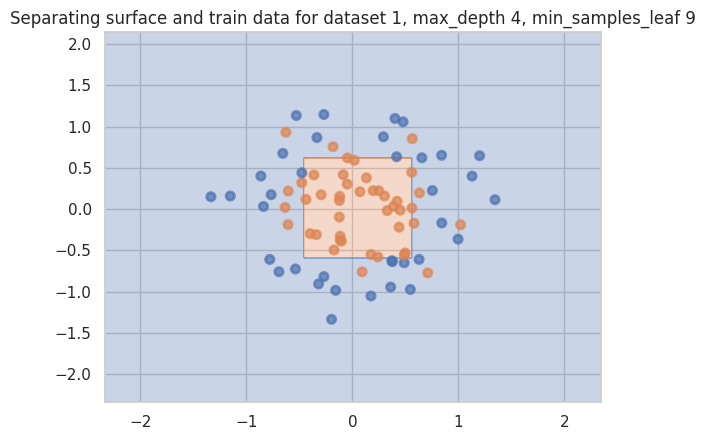

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 9: 0.90


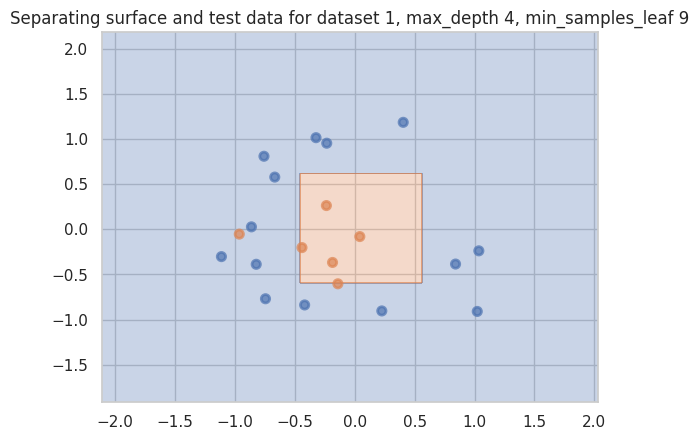

Accuracy on train for dataset 1, max_depth 4, min_samples_leaf 10: 0.82


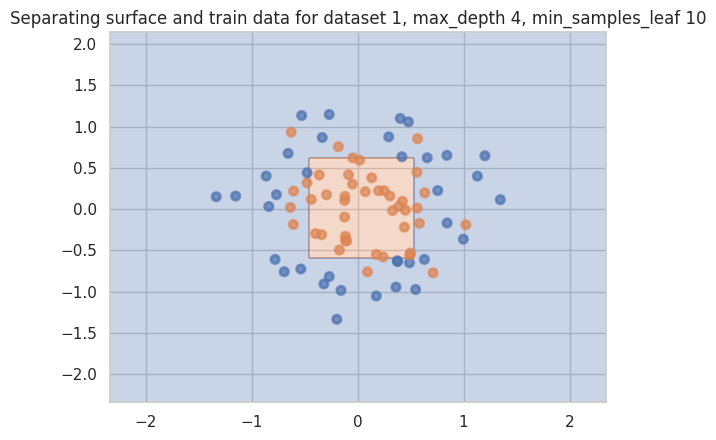

Accuracy on test for dataset 1, max_depth 4, min_samples_leaf 10: 0.90


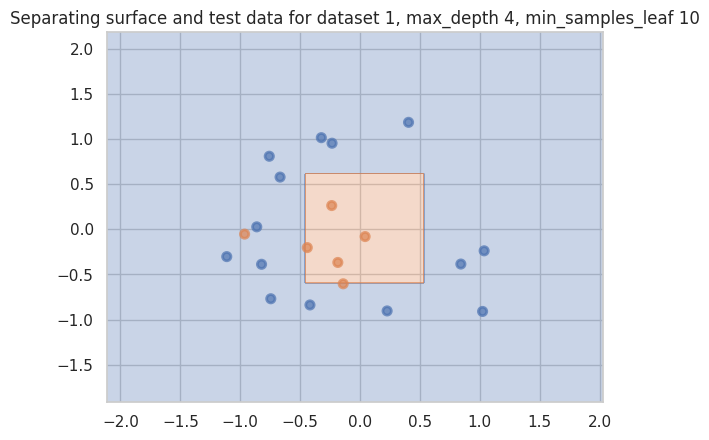

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 1: 0.97


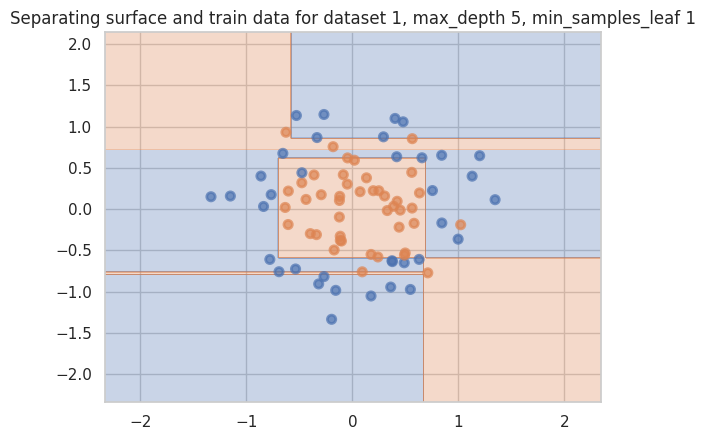

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 1: 0.70


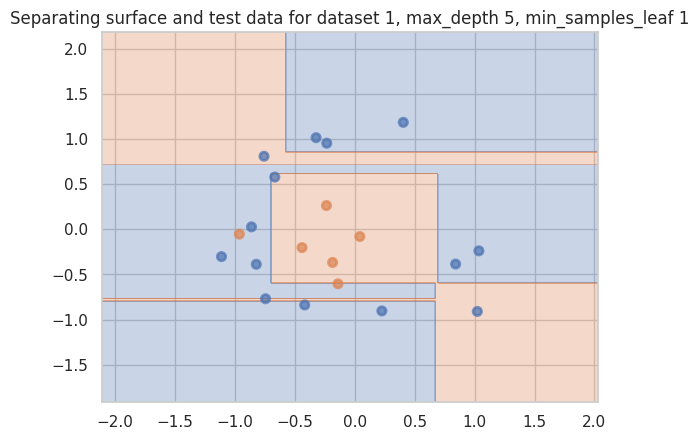

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 2: 0.94


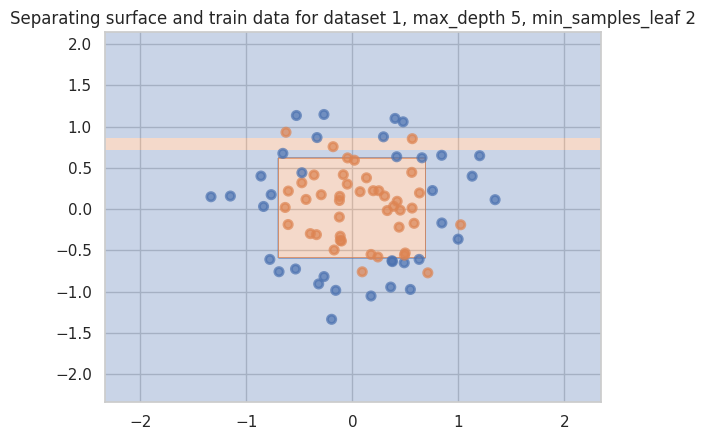

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 2: 0.80


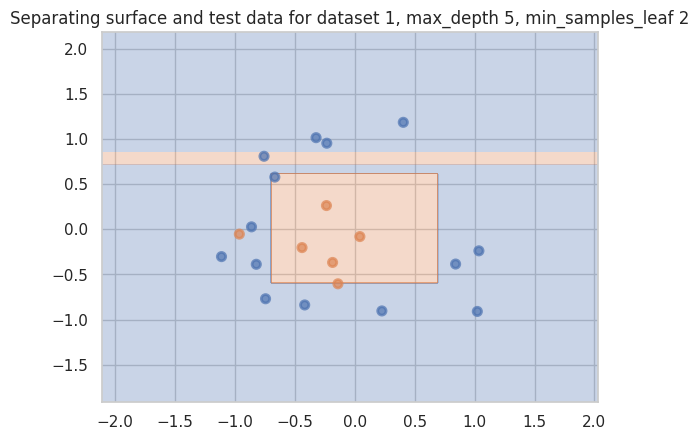

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 3: 0.93


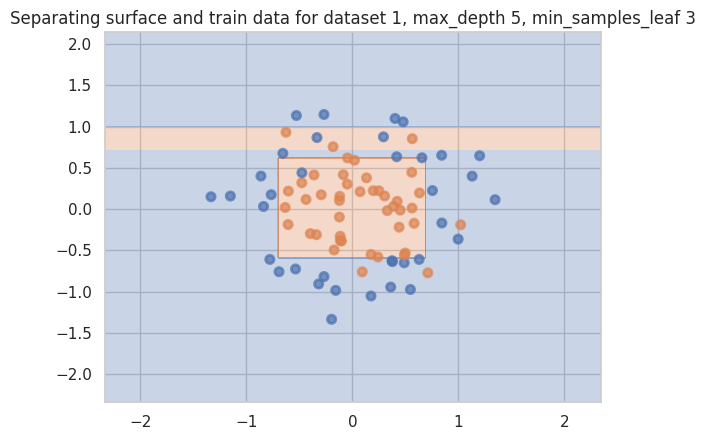

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 3: 0.75


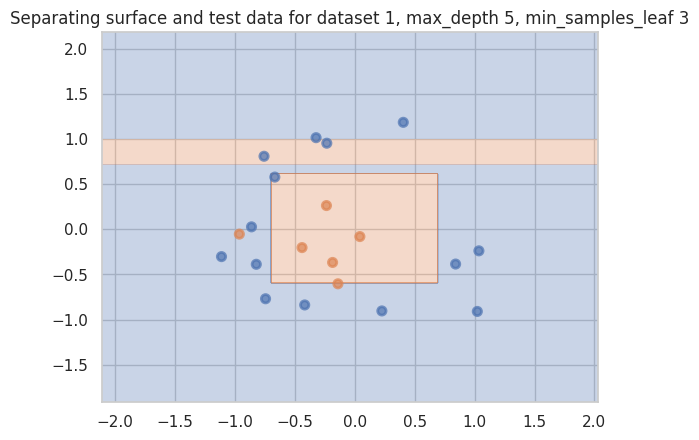

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 4: 0.93


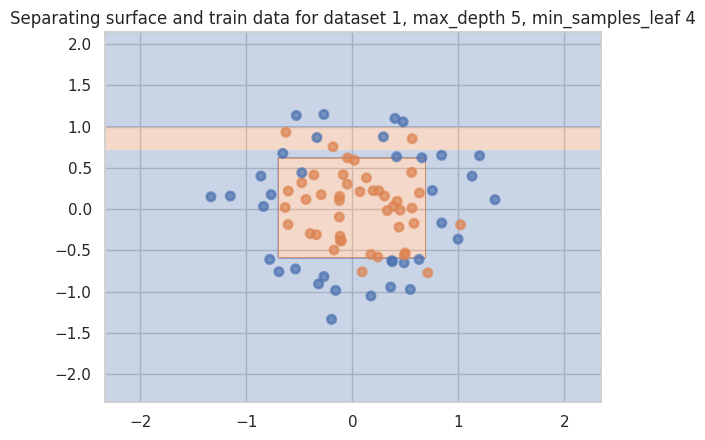

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 4: 0.75


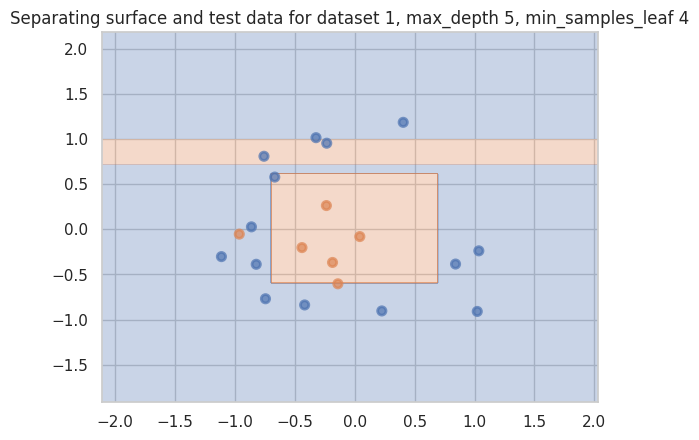

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 5: 0.91


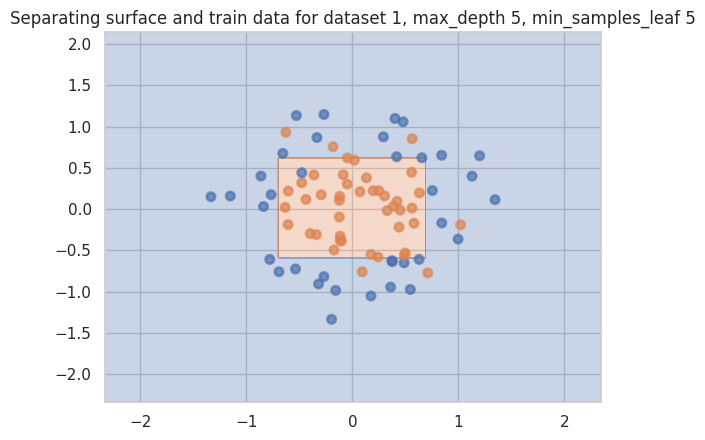

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 5: 0.85


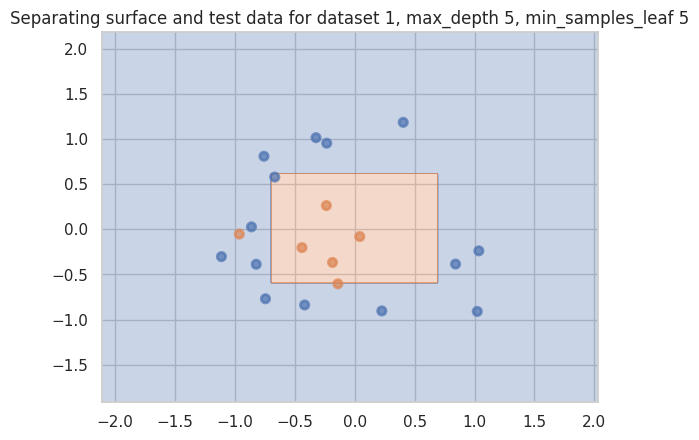

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 6: 0.90


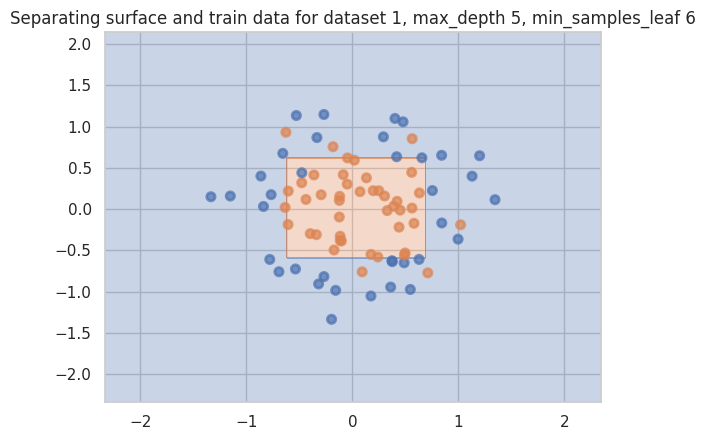

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 6: 0.90


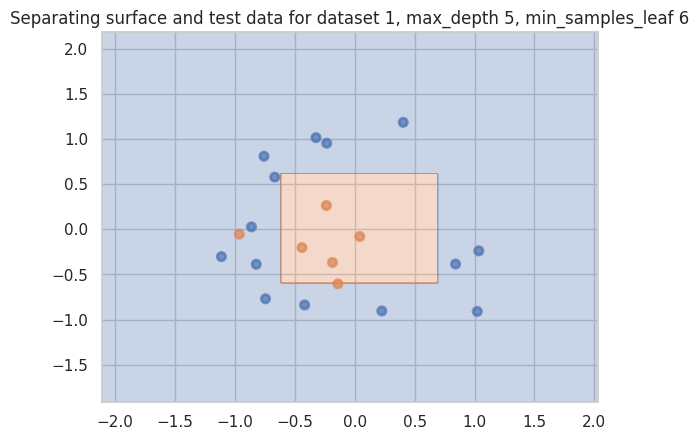

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 7: 0.88


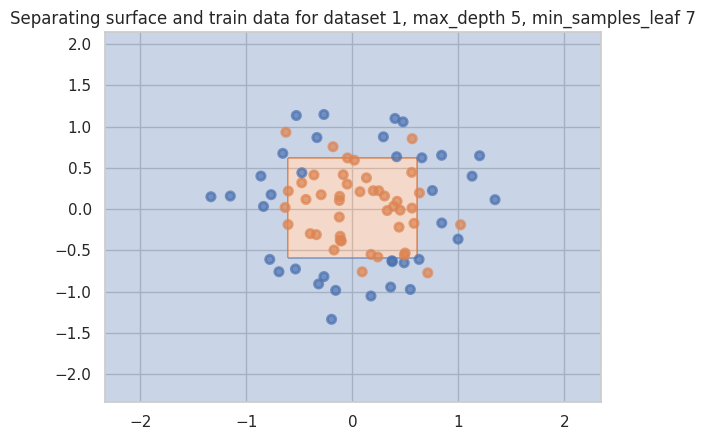

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 7: 0.90


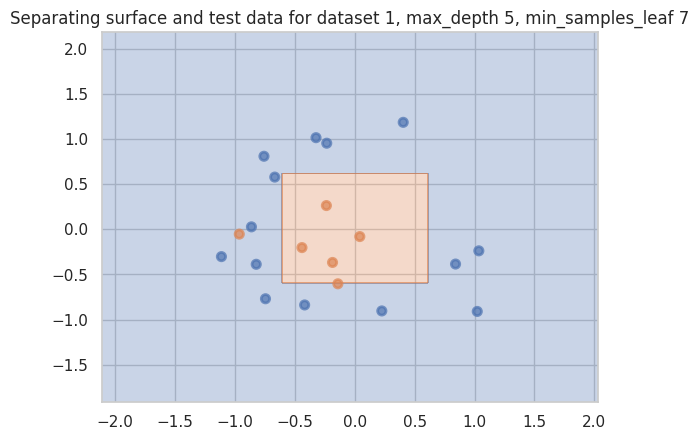

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 8: 0.85


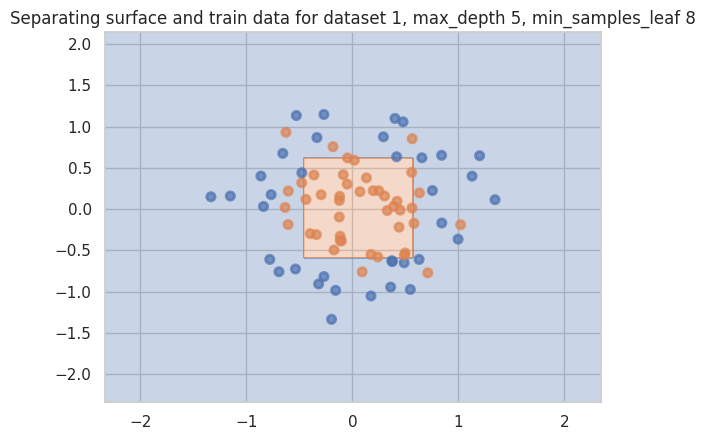

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 8: 0.90


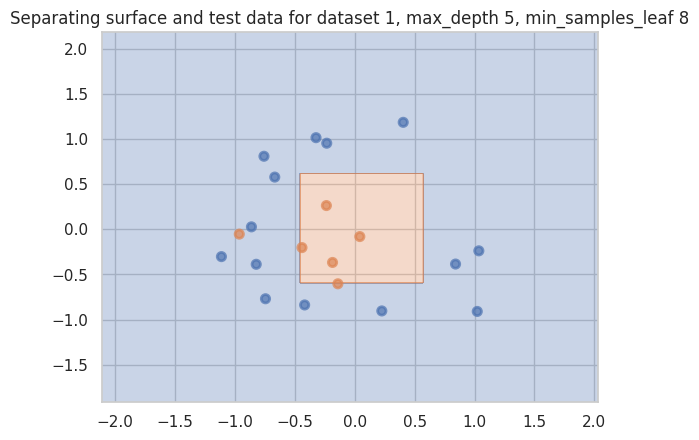

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 9: 0.84


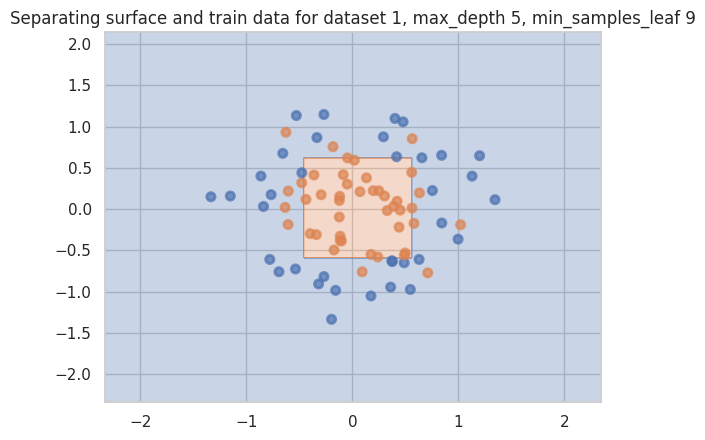

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 9: 0.90


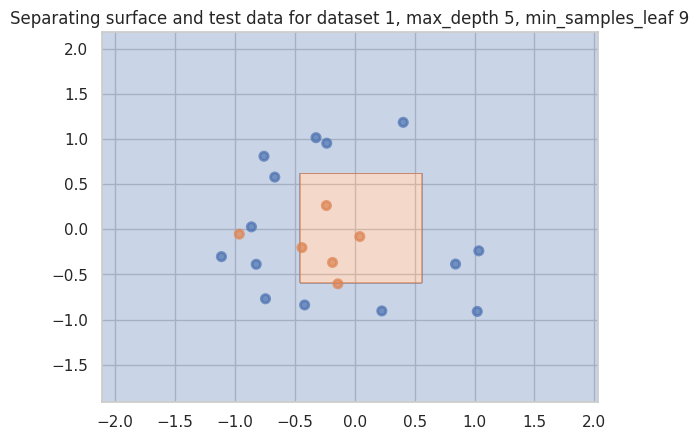

Accuracy on train for dataset 1, max_depth 5, min_samples_leaf 10: 0.82


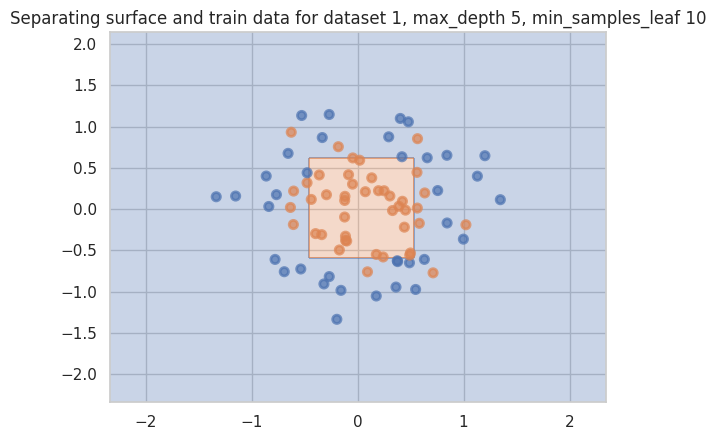

Accuracy on test for dataset 1, max_depth 5, min_samples_leaf 10: 0.90


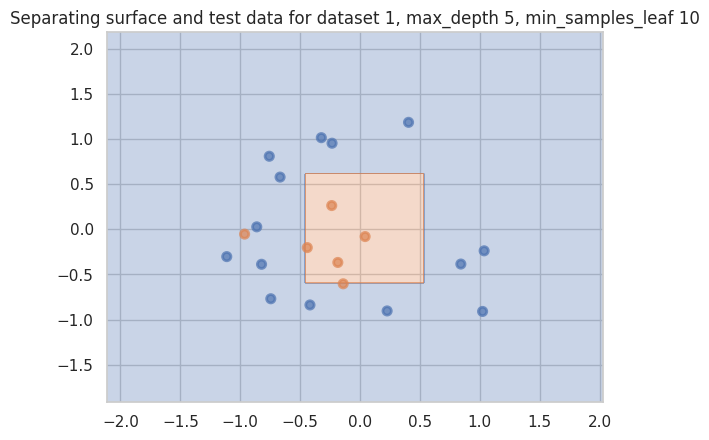

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 1: 1.00


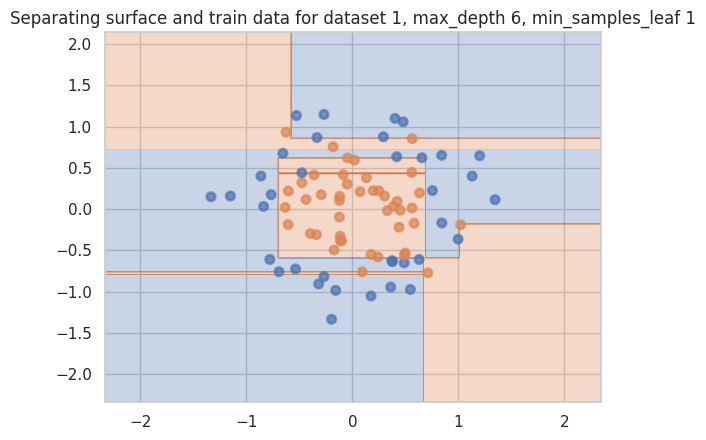

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 1: 0.65


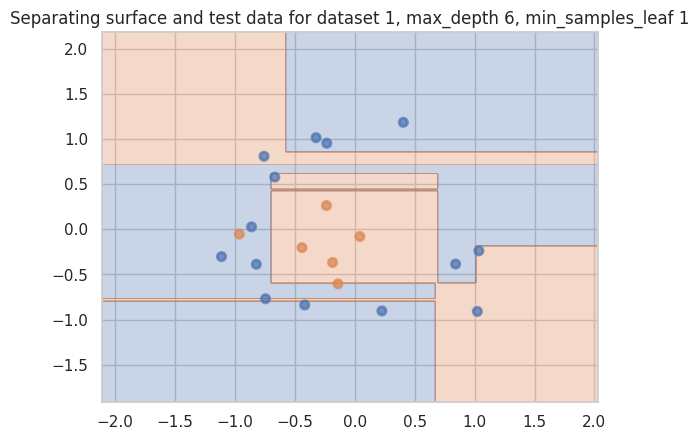

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 2: 0.94


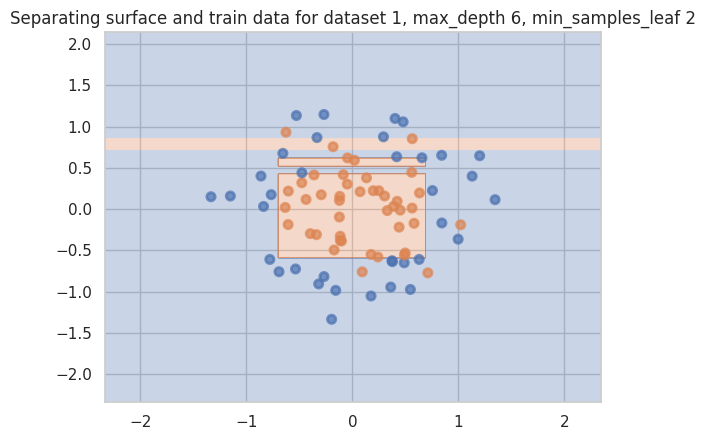

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 2: 0.80


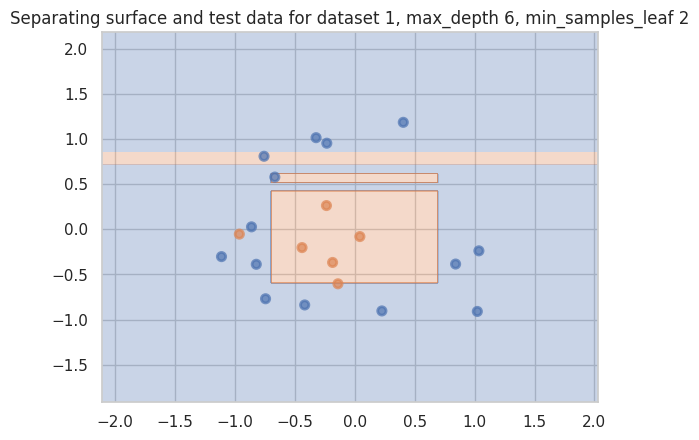

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 3: 0.94


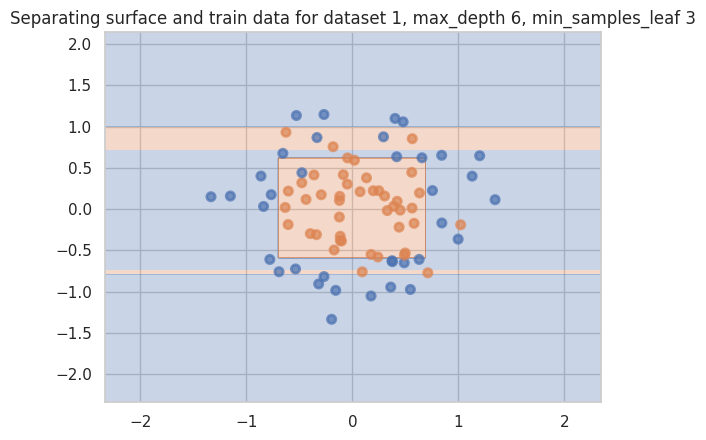

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 3: 0.70


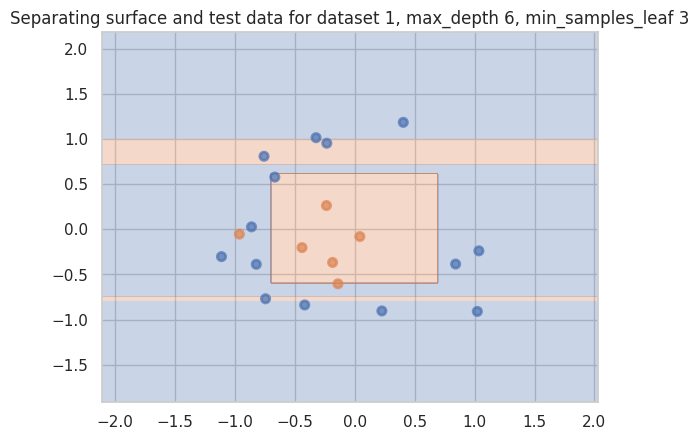

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 4: 0.93


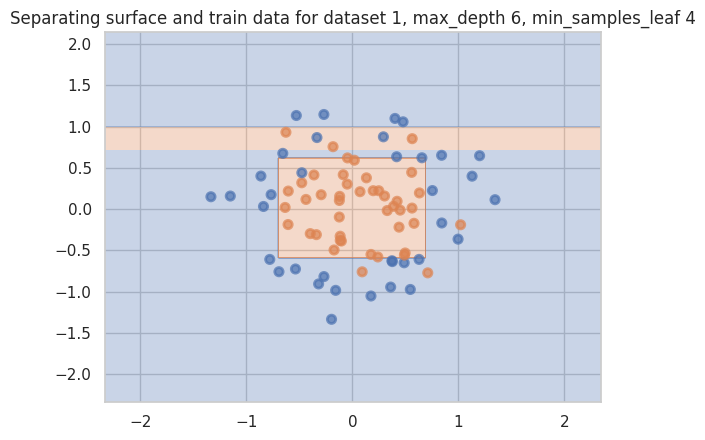

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 4: 0.75


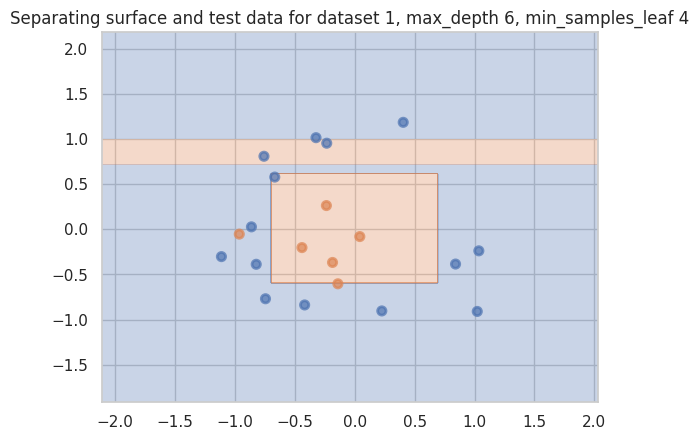

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 5: 0.91


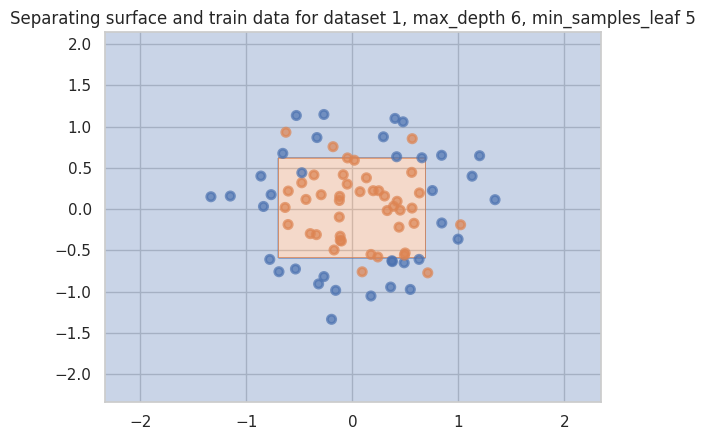

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 5: 0.85


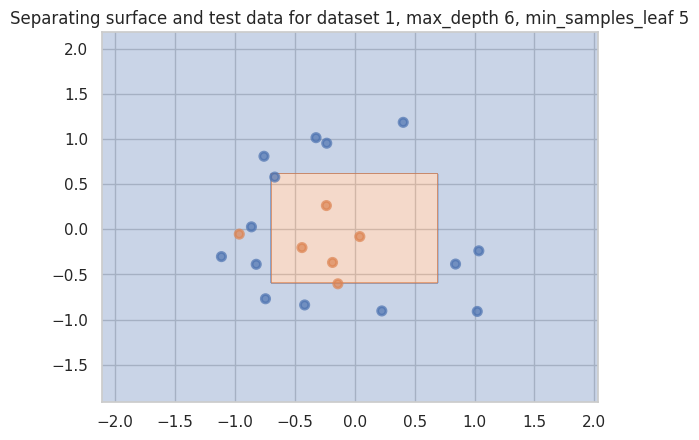

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 6: 0.90


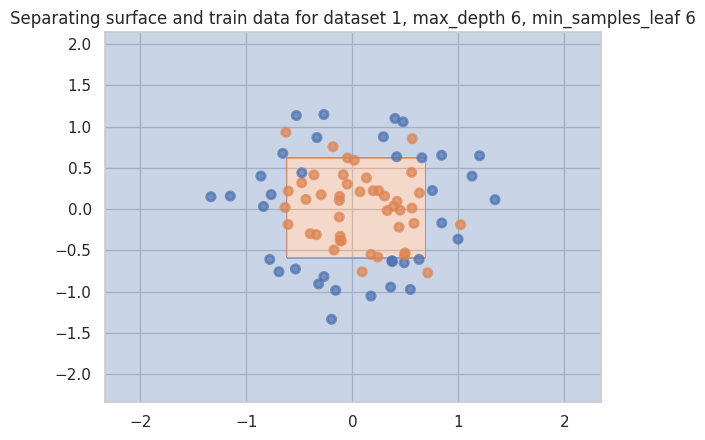

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 6: 0.90


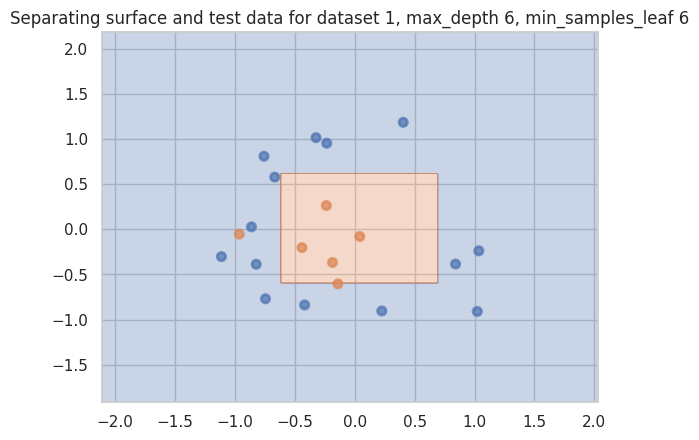

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 7: 0.88


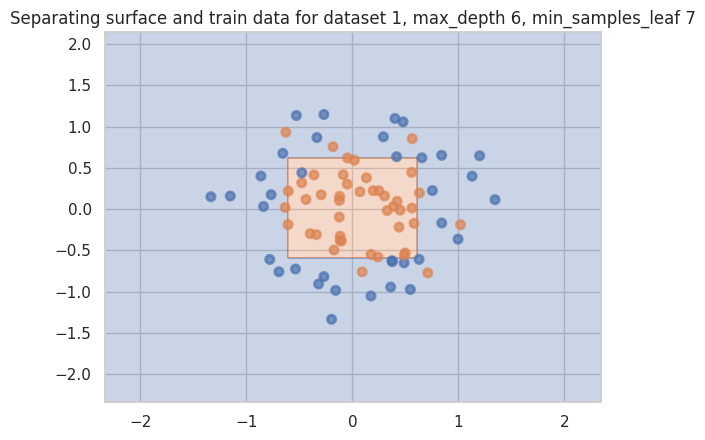

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 7: 0.90


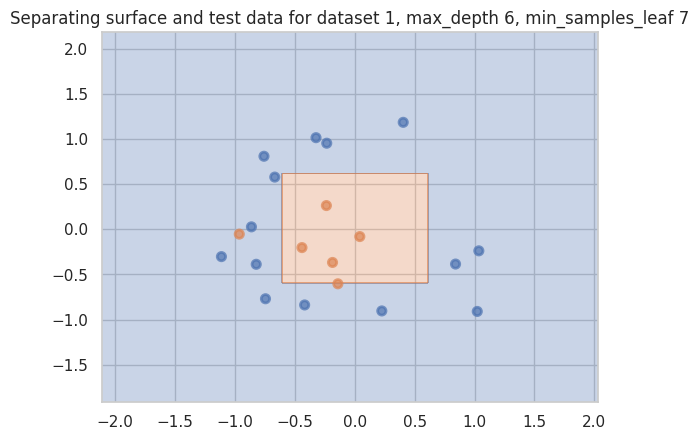

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 8: 0.85


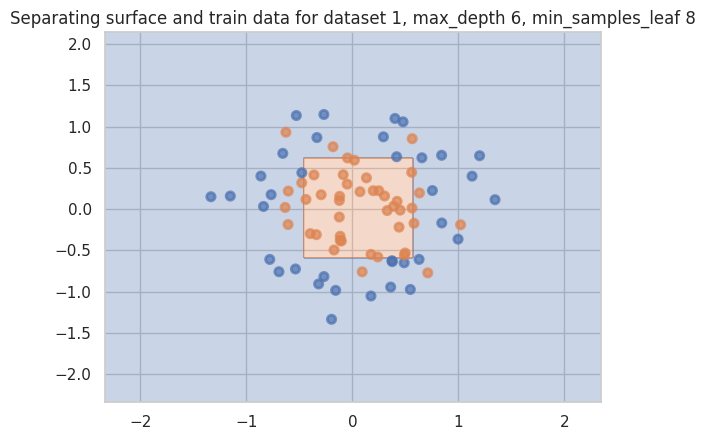

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 8: 0.90


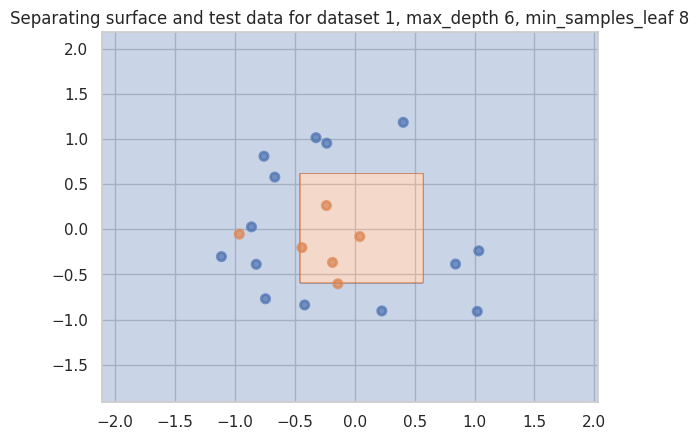

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 9: 0.84


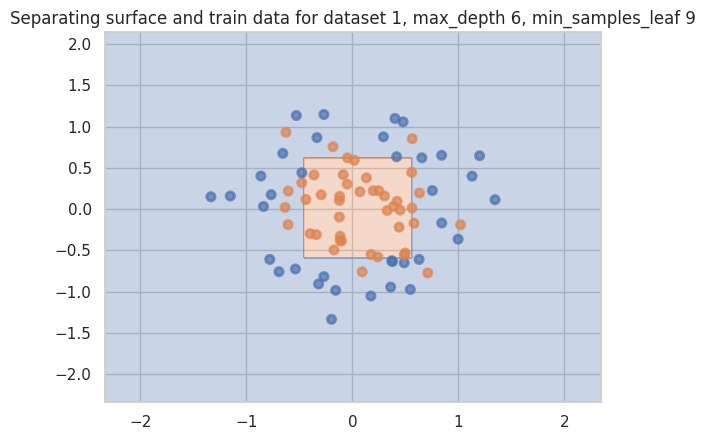

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 9: 0.90


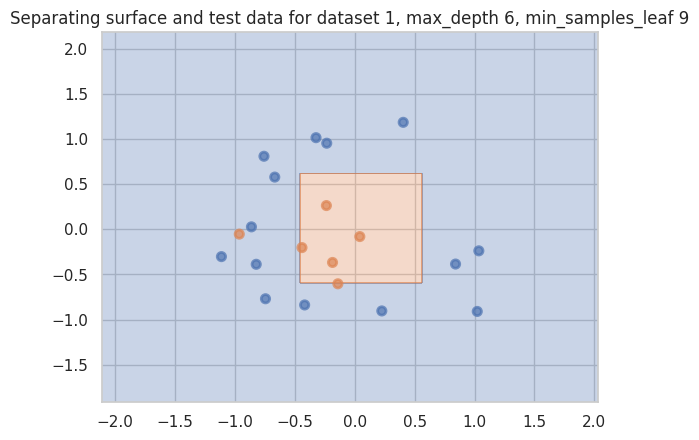

Accuracy on train for dataset 1, max_depth 6, min_samples_leaf 10: 0.82


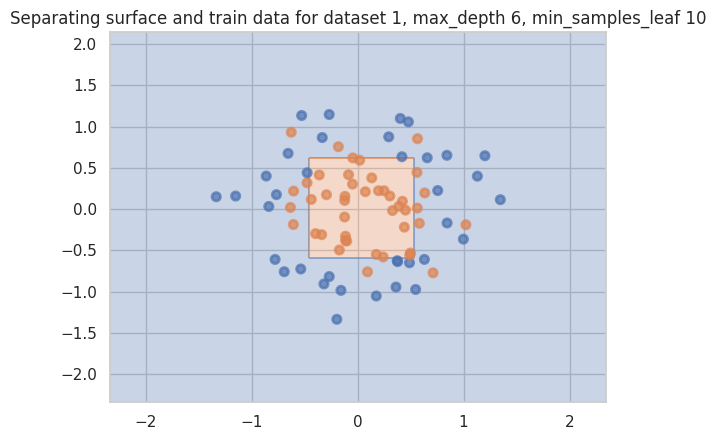

Accuracy on test for dataset 1, max_depth 6, min_samples_leaf 10: 0.90


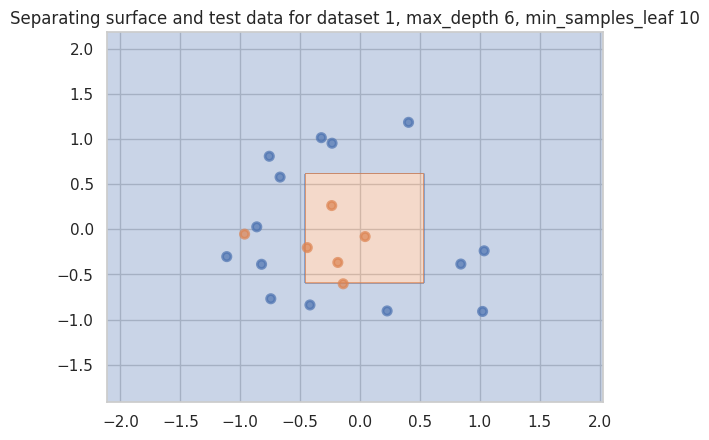

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 1: 1.00


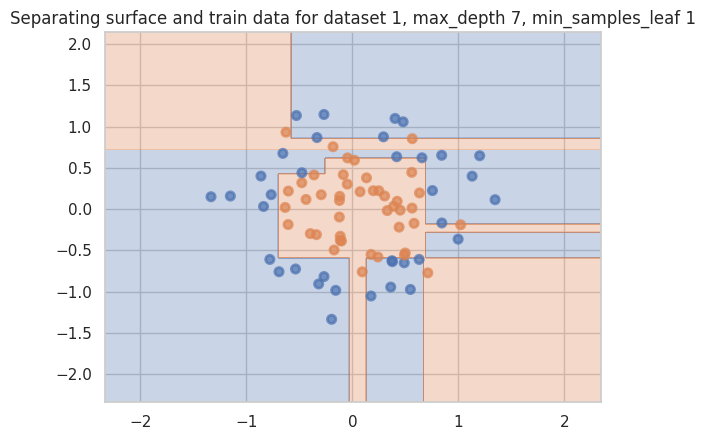

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 1: 0.75


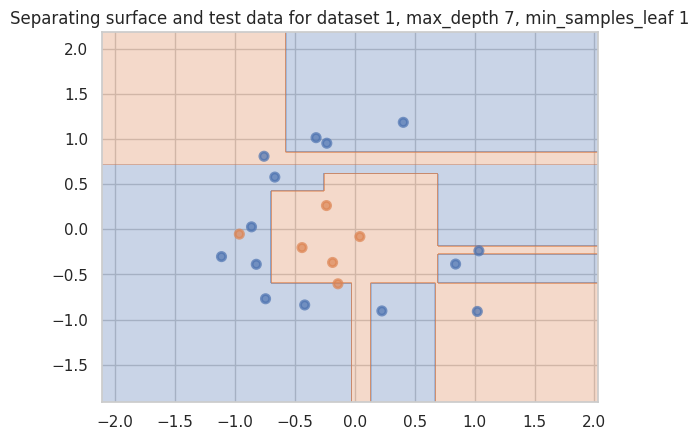

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 2: 0.94


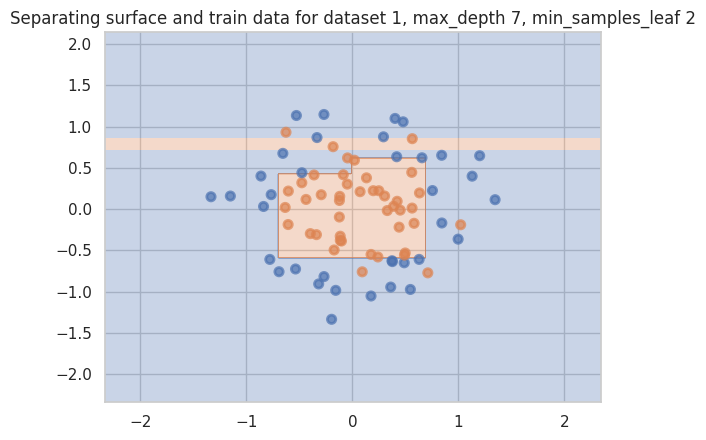

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 2: 0.85


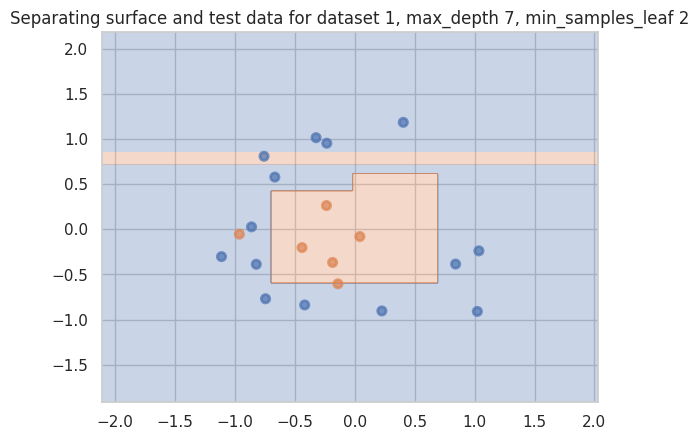

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 3: 0.94


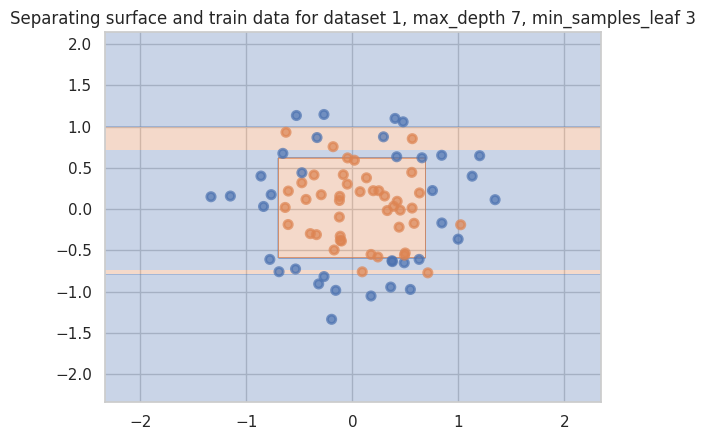

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 3: 0.70


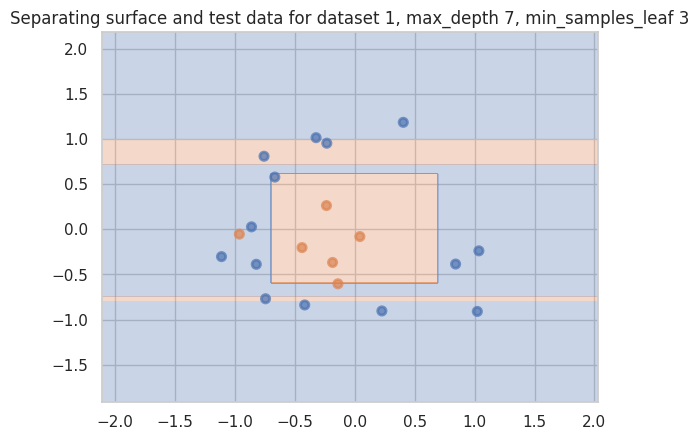

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 4: 0.93


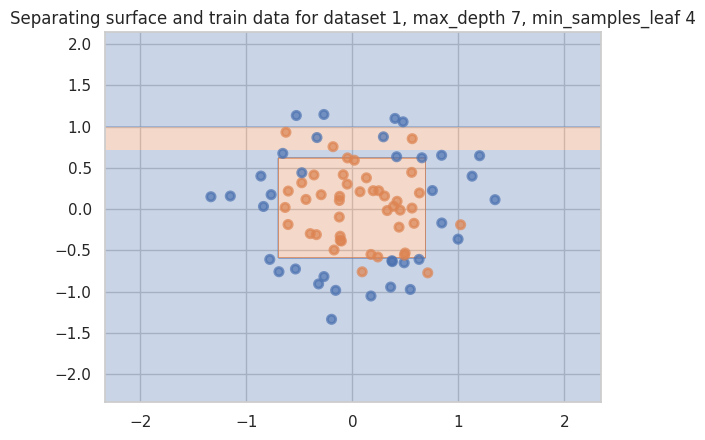

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 4: 0.75


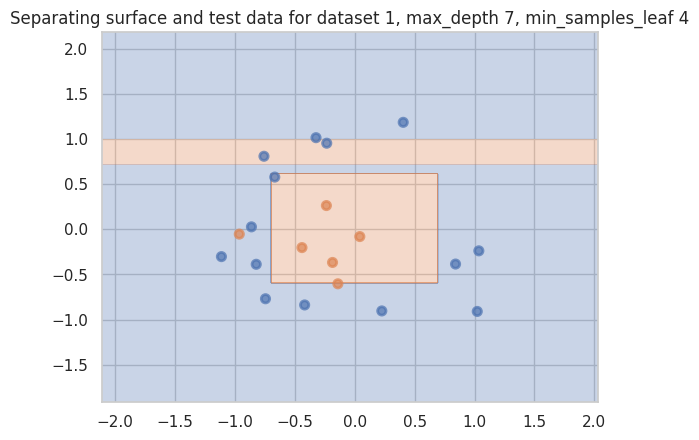

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 5: 0.91


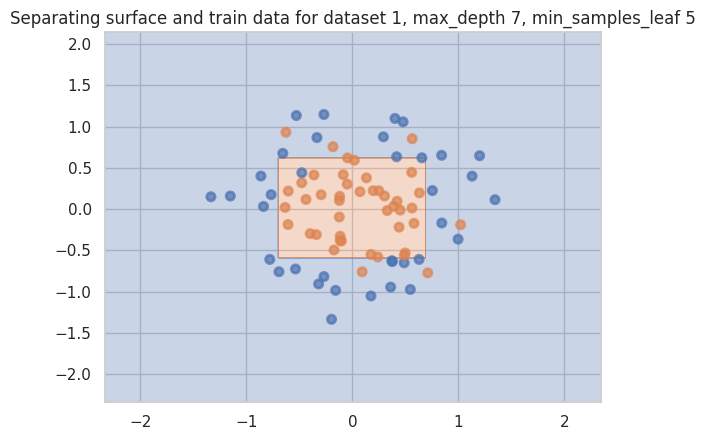

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 5: 0.85


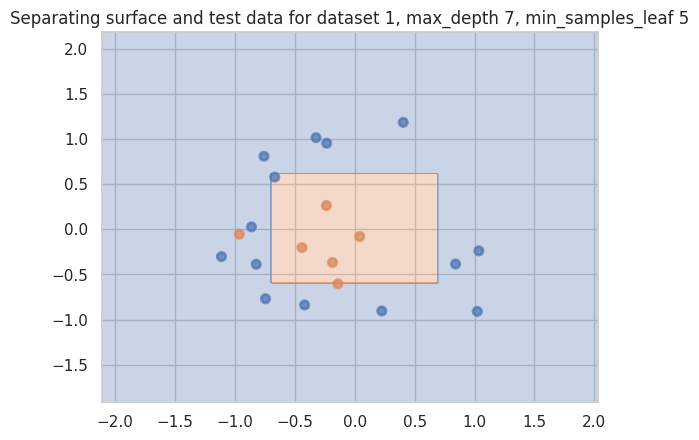

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 6: 0.90


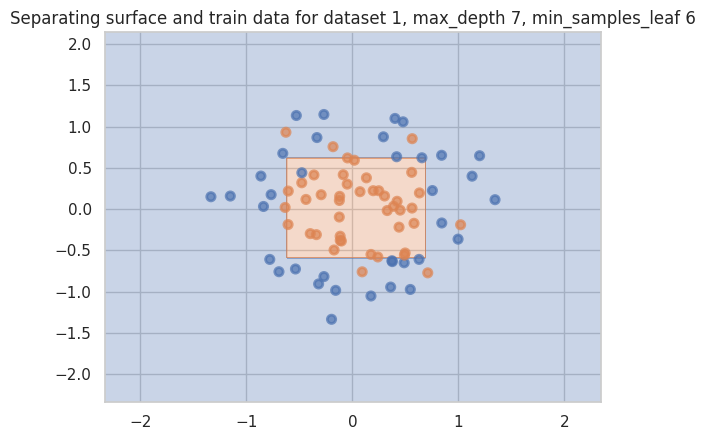

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 6: 0.90


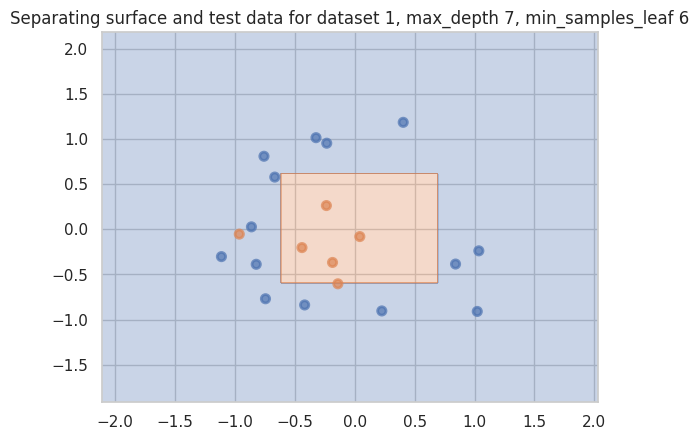

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 7: 0.88


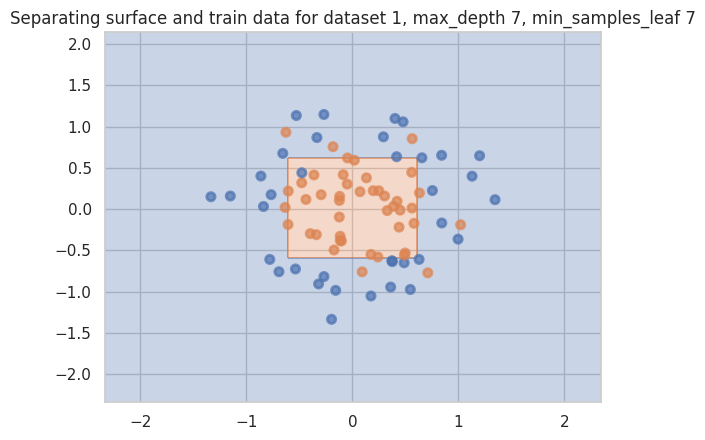

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 7: 0.90


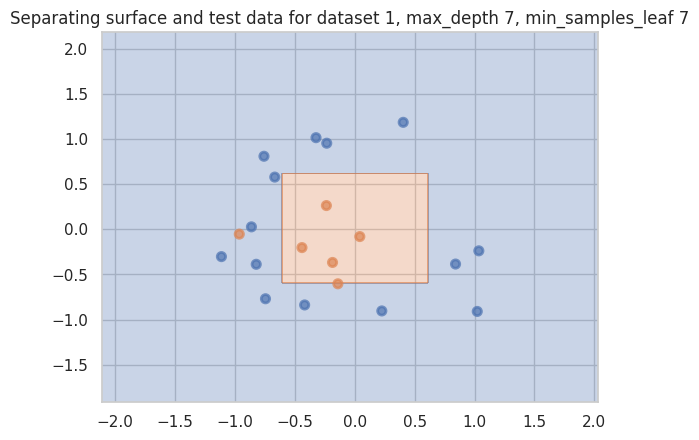

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 8: 0.85


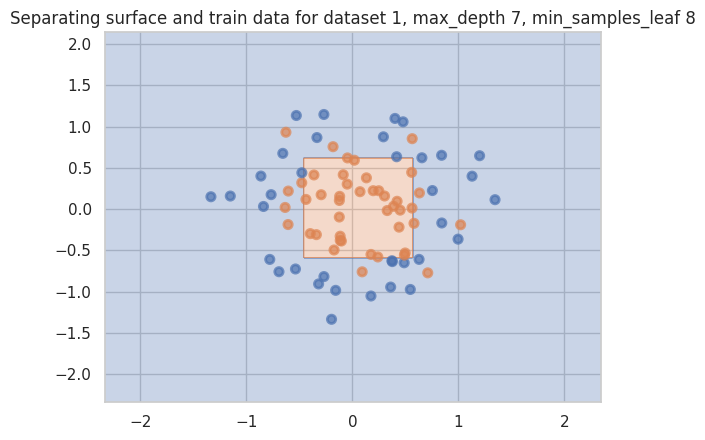

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 8: 0.90


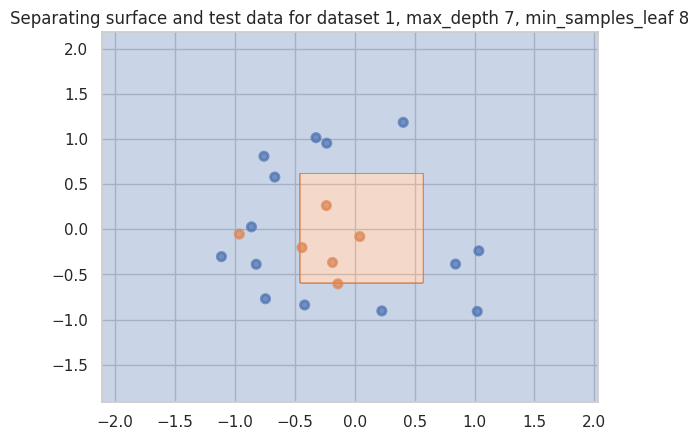

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 9: 0.84


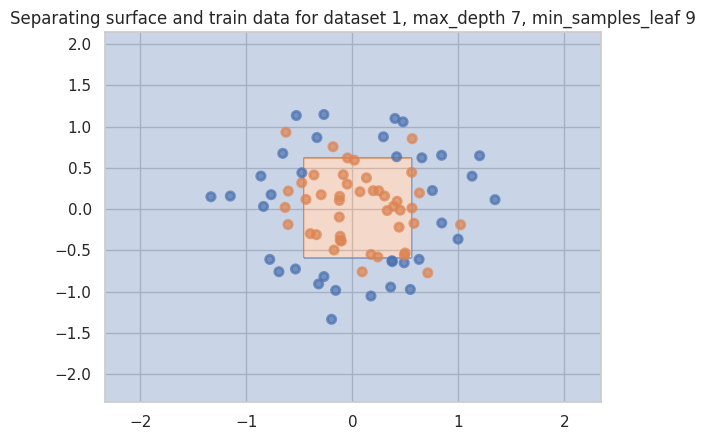

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 9: 0.90


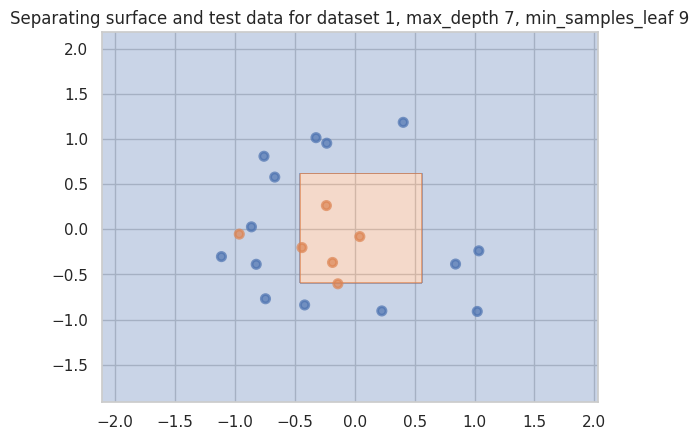

Accuracy on train for dataset 1, max_depth 7, min_samples_leaf 10: 0.82


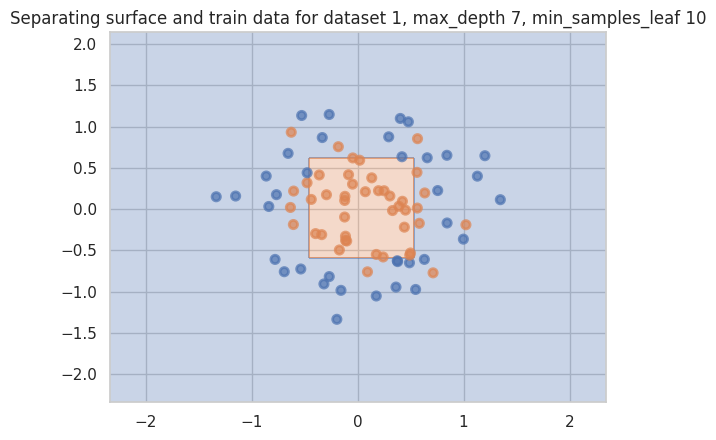

Accuracy on test for dataset 1, max_depth 7, min_samples_leaf 10: 0.90


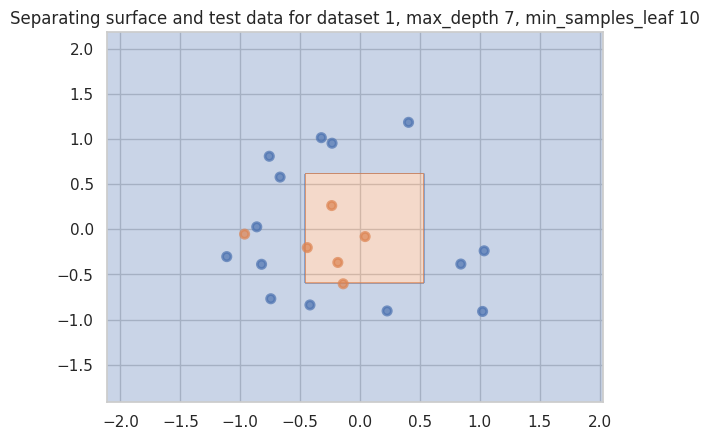

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 1: 1.00


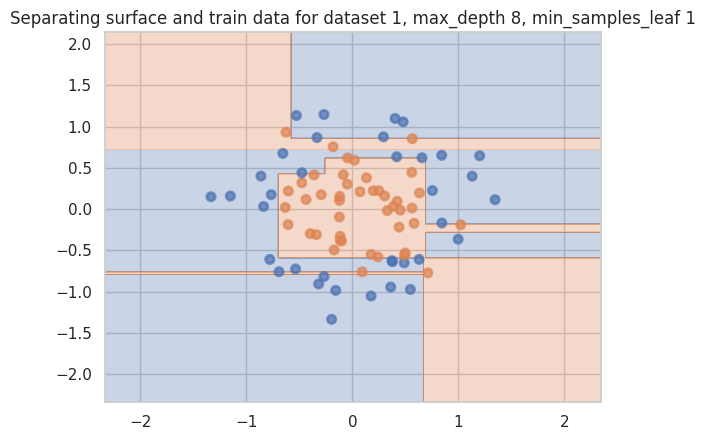

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 1: 0.70


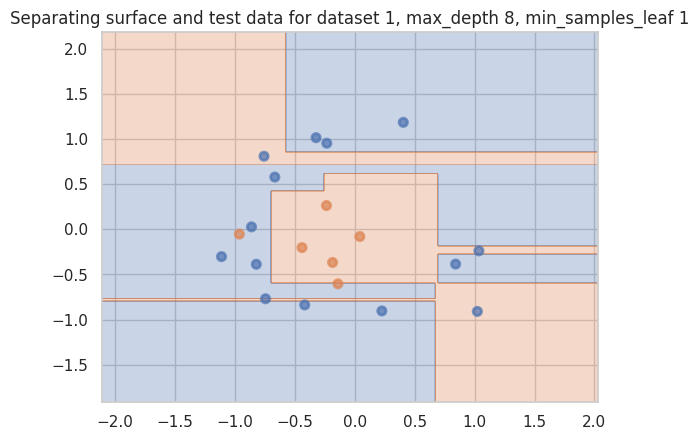

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 2: 0.94


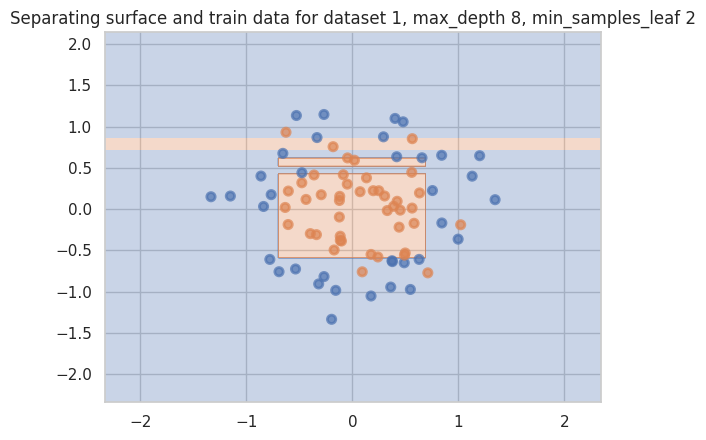

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 2: 0.80


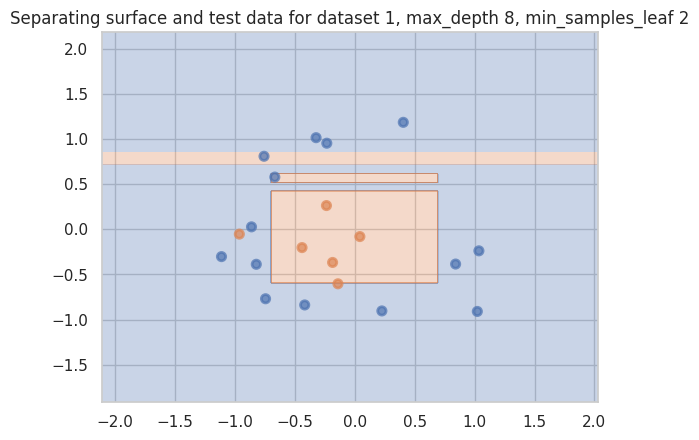

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 3: 0.94


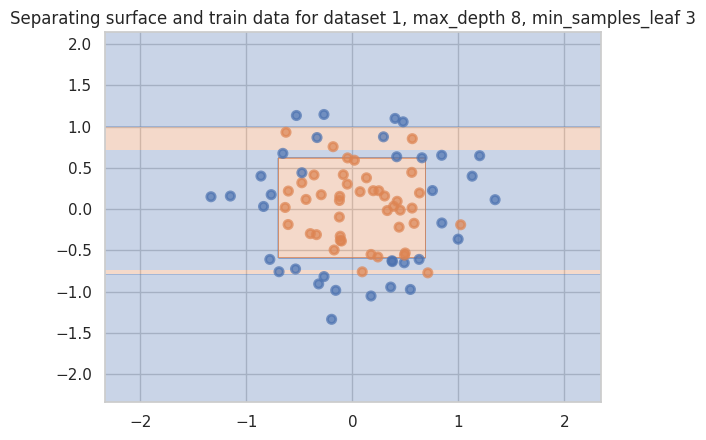

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 3: 0.70


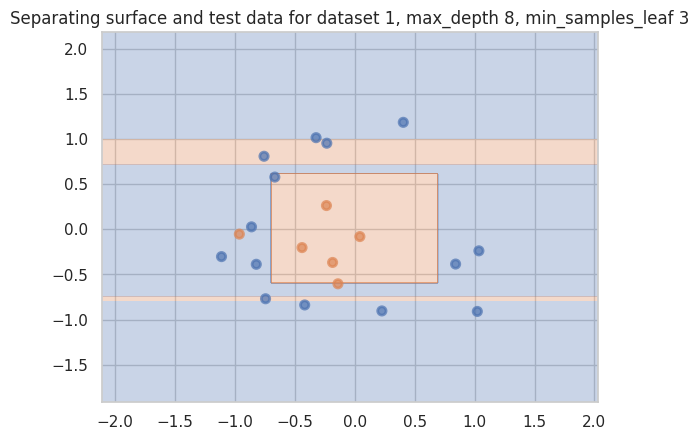

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 4: 0.93


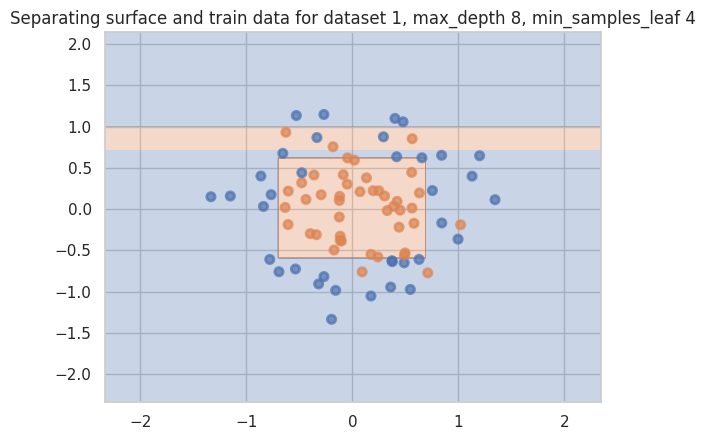

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 4: 0.75


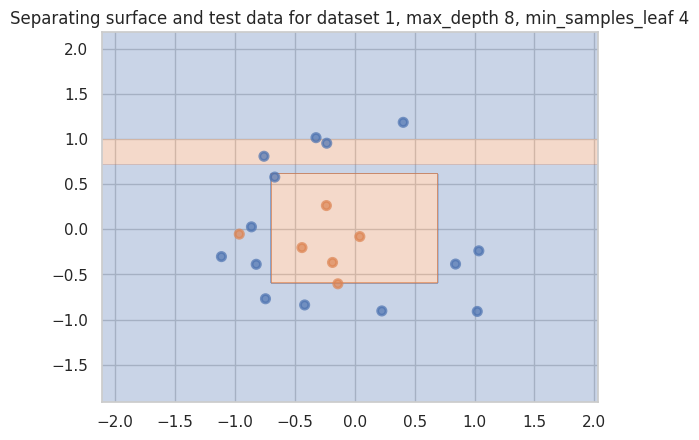

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 5: 0.91


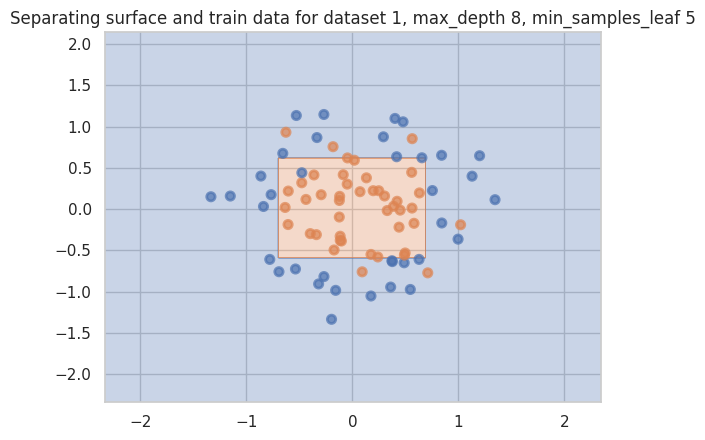

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 5: 0.85


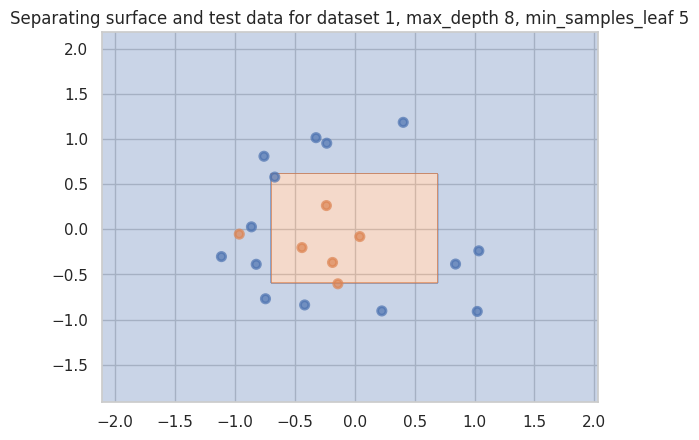

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 6: 0.90


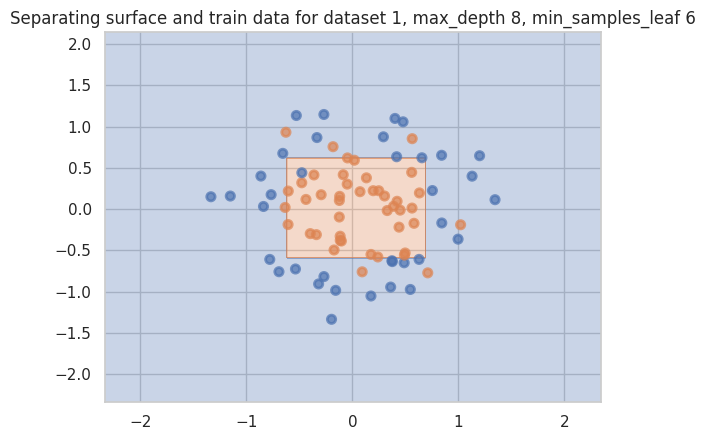

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 6: 0.90


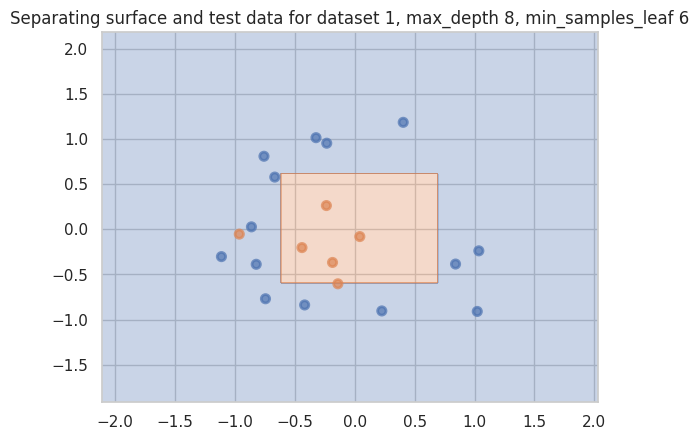

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 7: 0.88


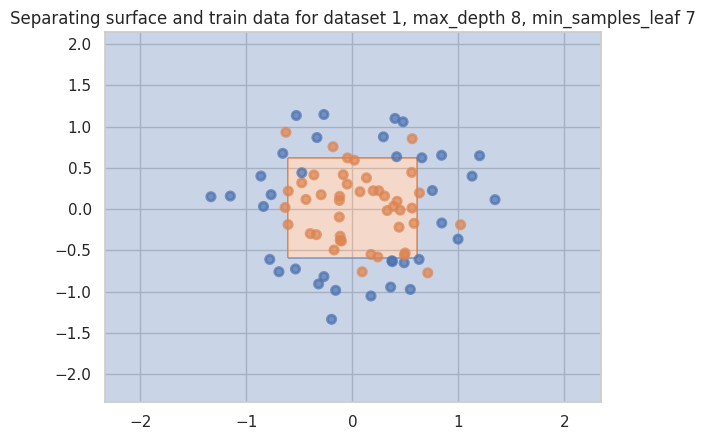

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 7: 0.90


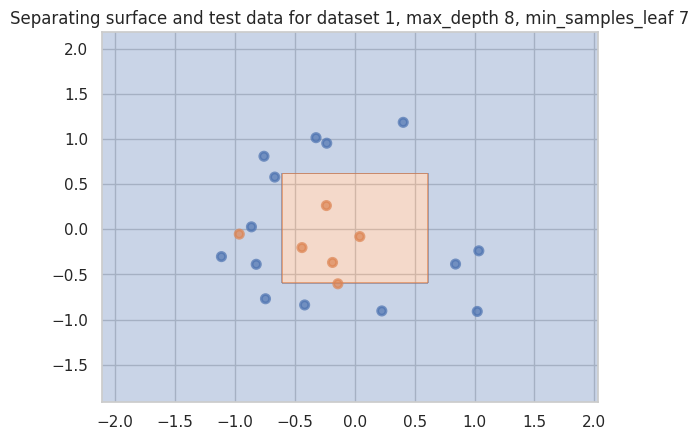

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 8: 0.85


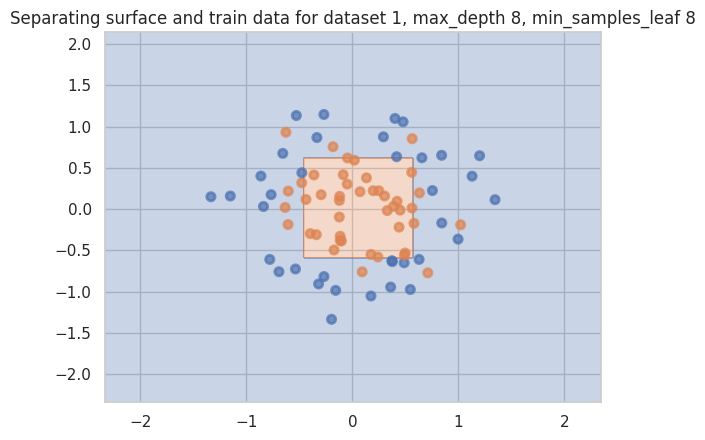

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 8: 0.90


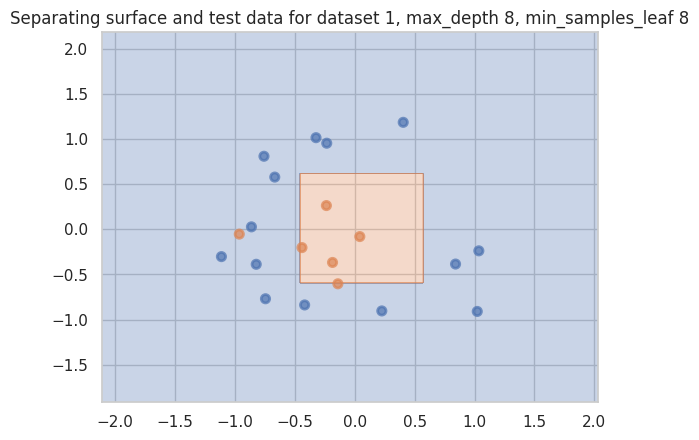

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 9: 0.84


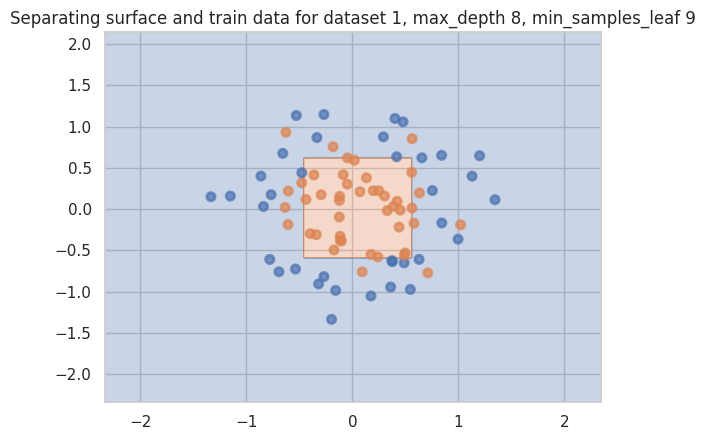

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 9: 0.90


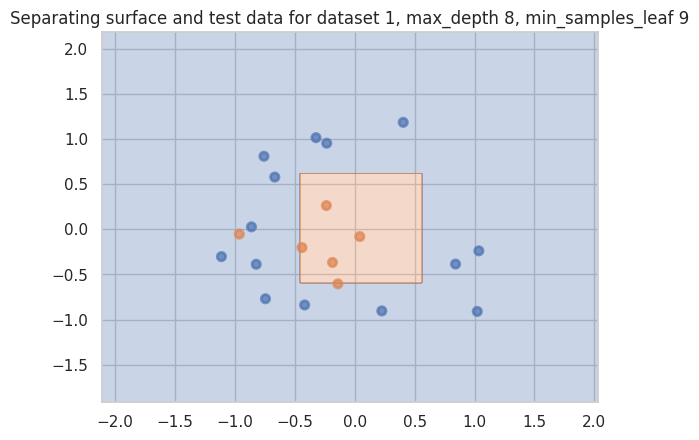

Accuracy on train for dataset 1, max_depth 8, min_samples_leaf 10: 0.82


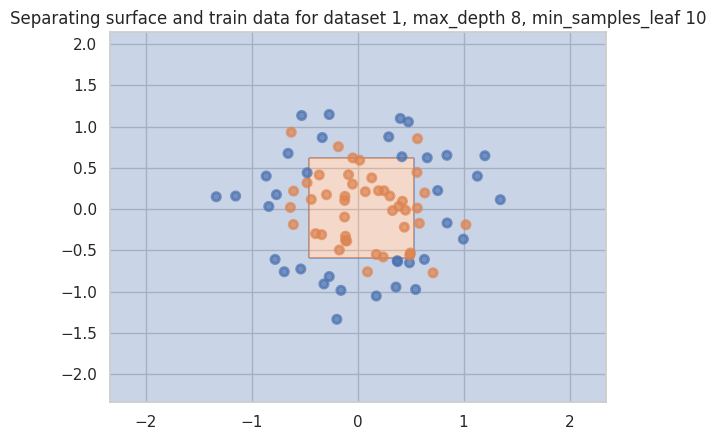

Accuracy on test for dataset 1, max_depth 8, min_samples_leaf 10: 0.90


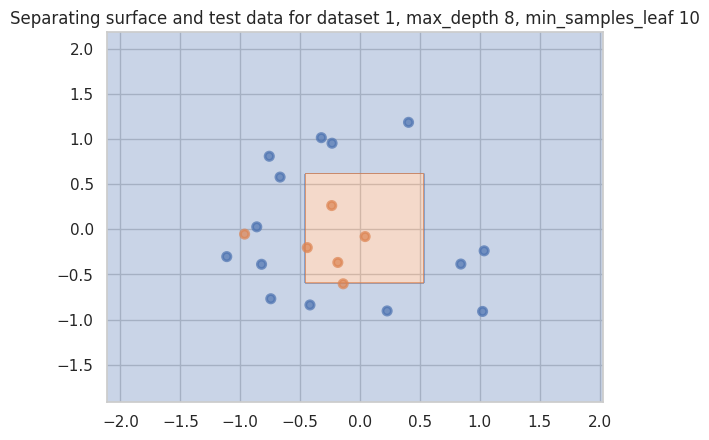

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 1: 1.00


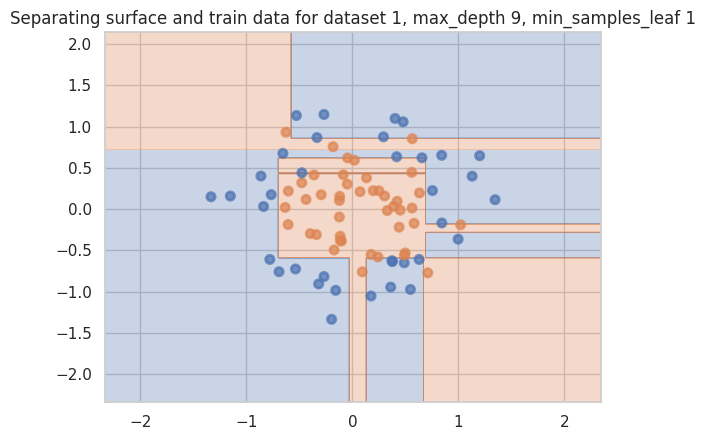

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 1: 0.70


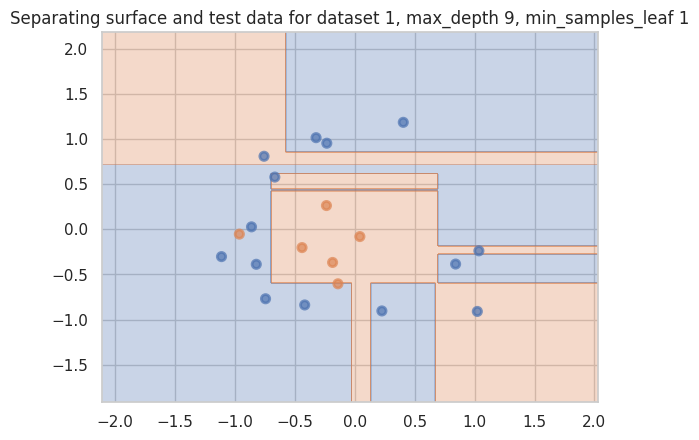

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 2: 0.94


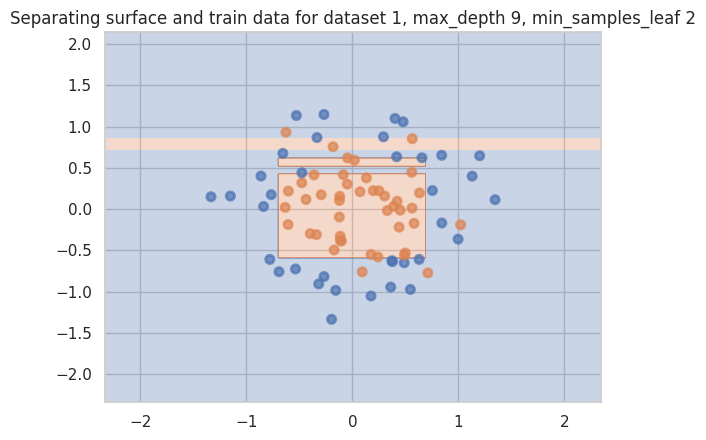

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 2: 0.80


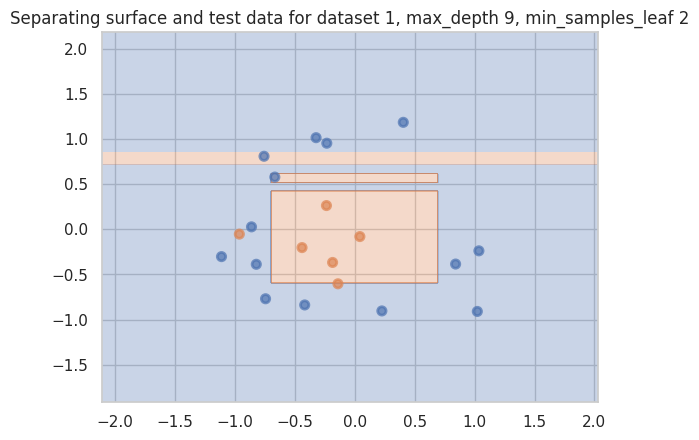

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 3: 0.93


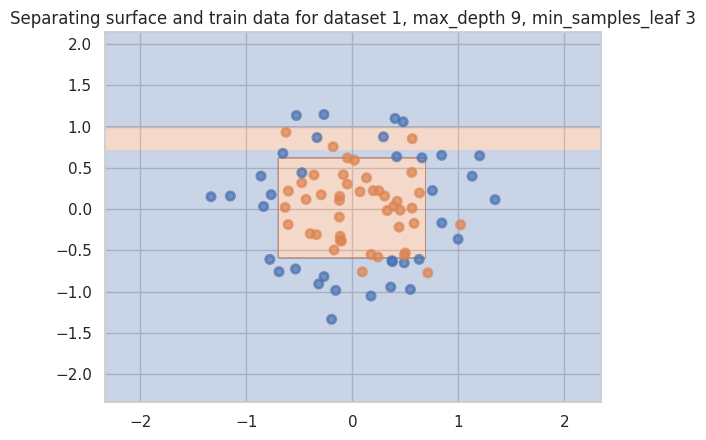

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 3: 0.75


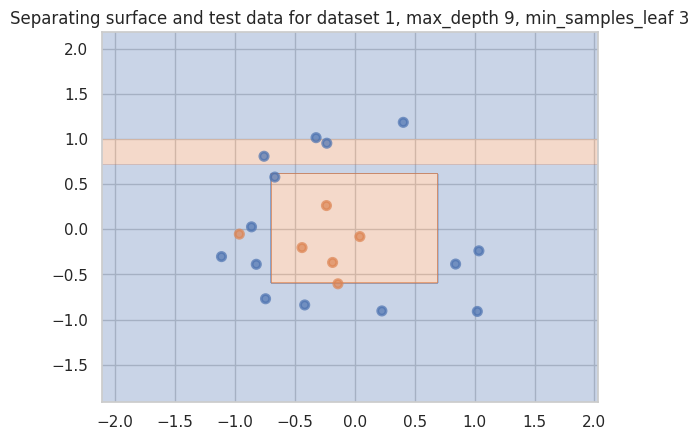

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 4: 0.93


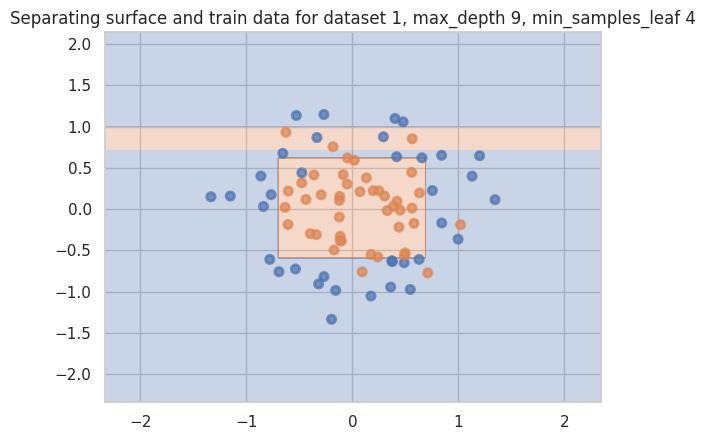

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 4: 0.75


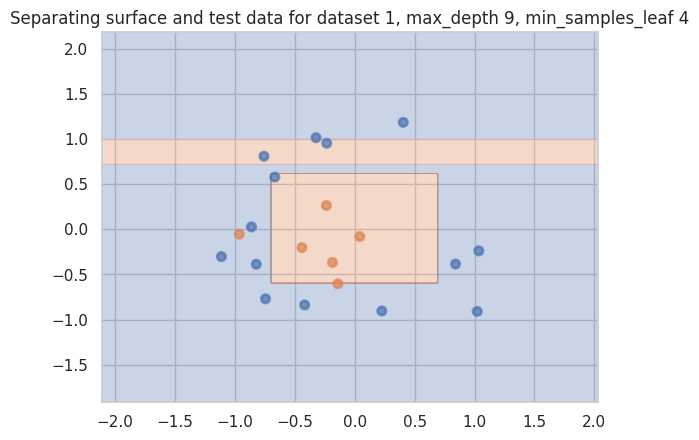

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 5: 0.91


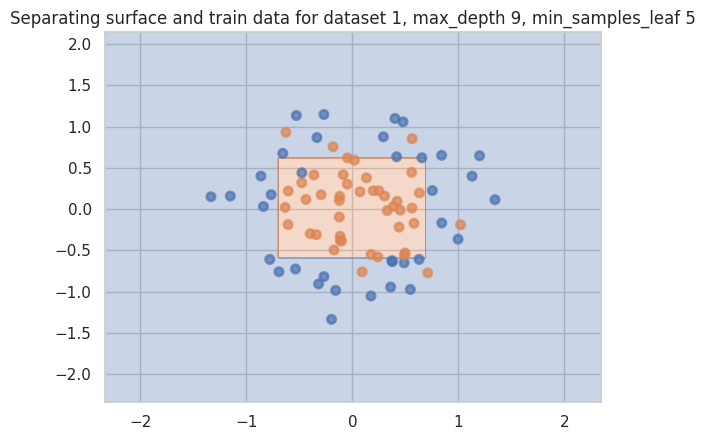

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 5: 0.85


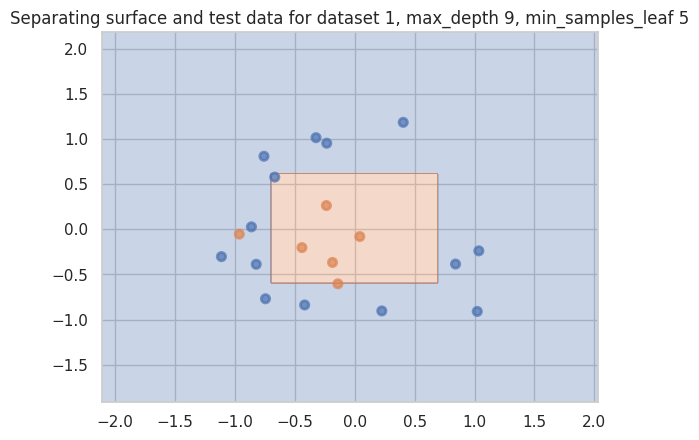

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 6: 0.90


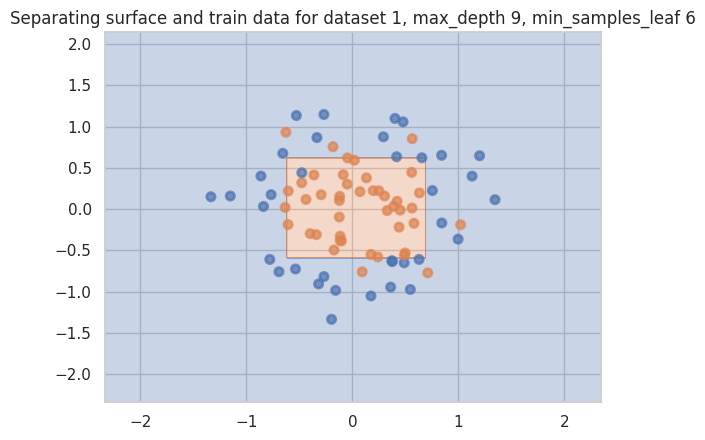

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 6: 0.90


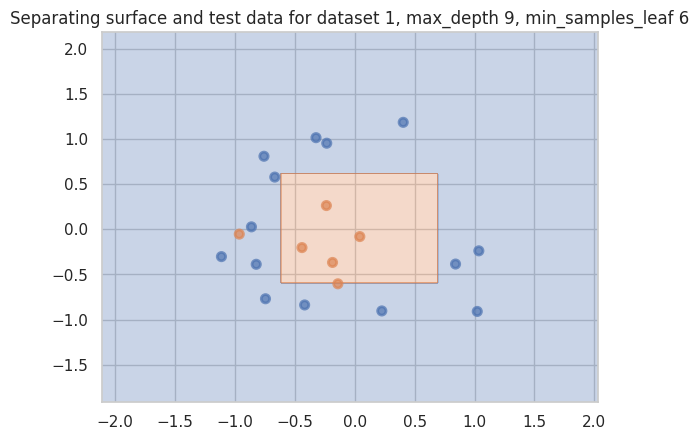

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 7: 0.88


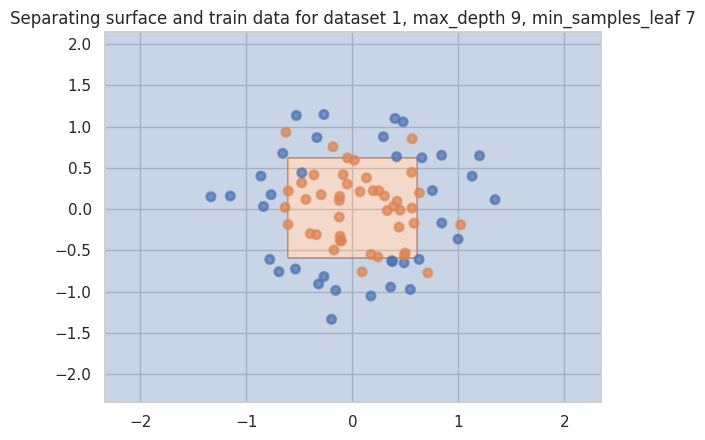

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 7: 0.90


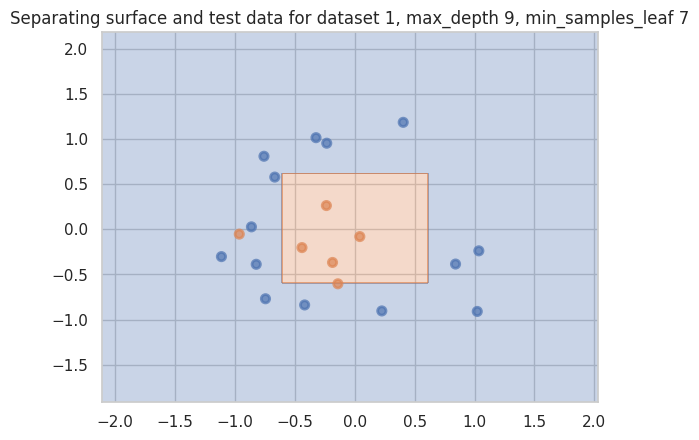

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 8: 0.85


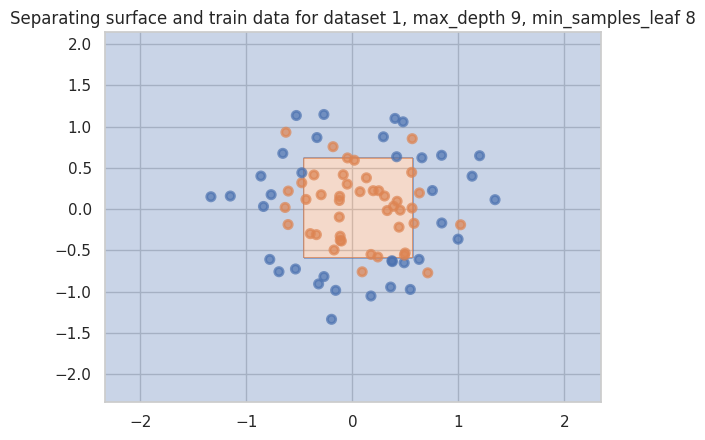

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 8: 0.90


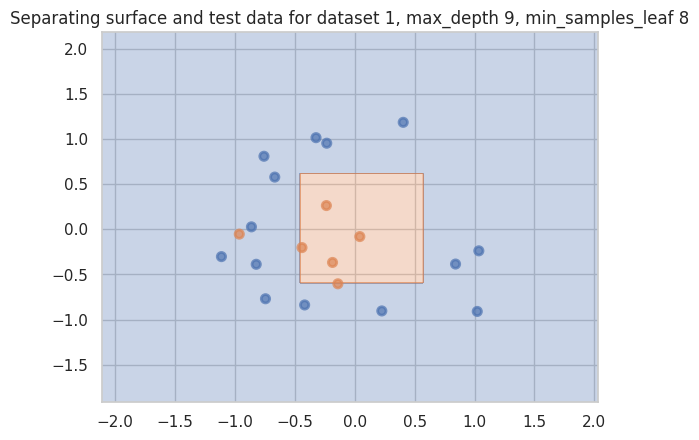

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 9: 0.84


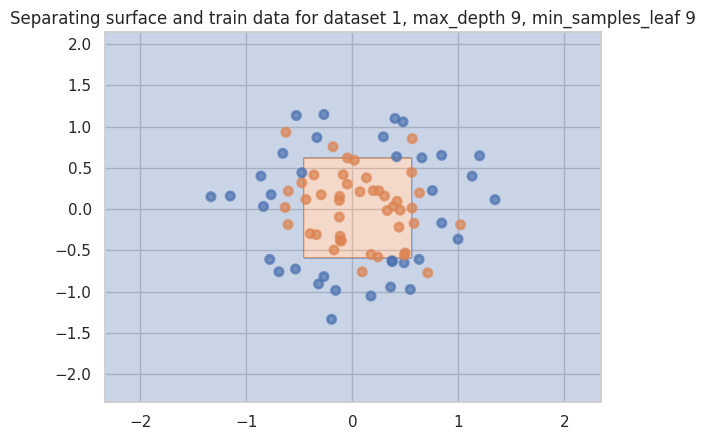

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 9: 0.90


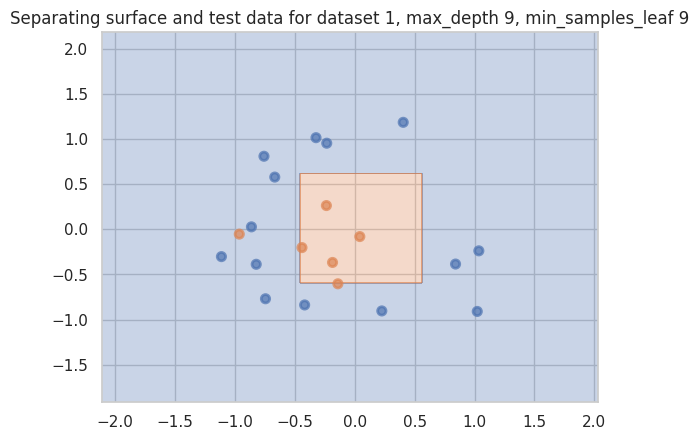

Accuracy on train for dataset 1, max_depth 9, min_samples_leaf 10: 0.82


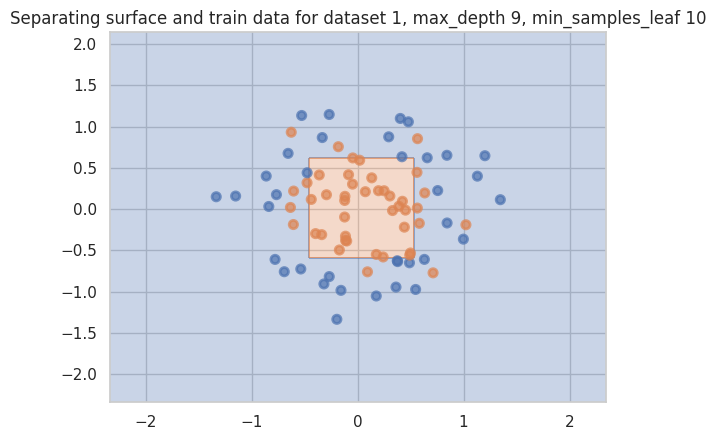

Accuracy on test for dataset 1, max_depth 9, min_samples_leaf 10: 0.90


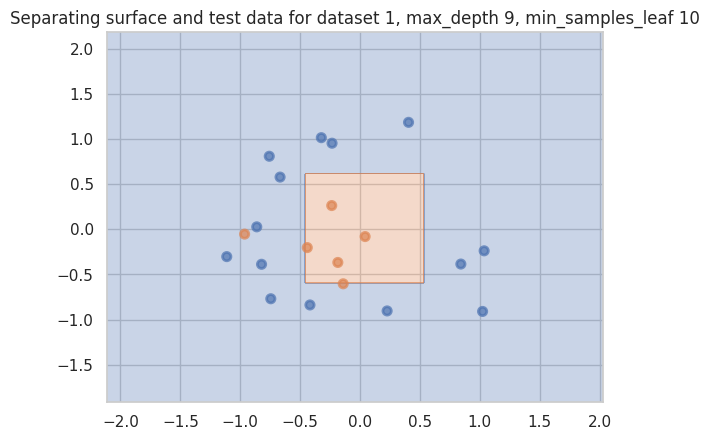

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 1: 1.00


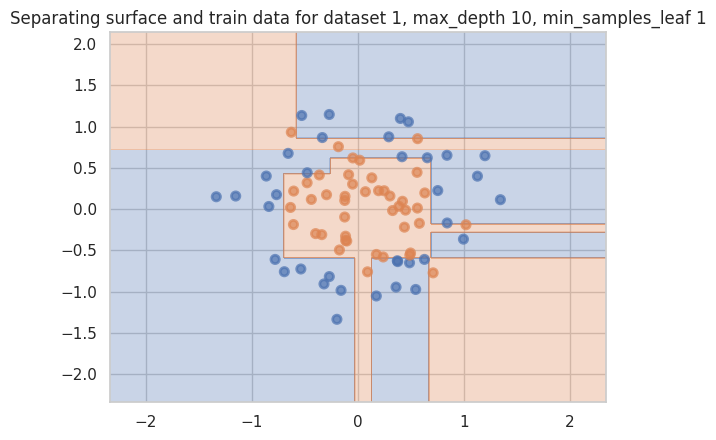

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 1: 0.75


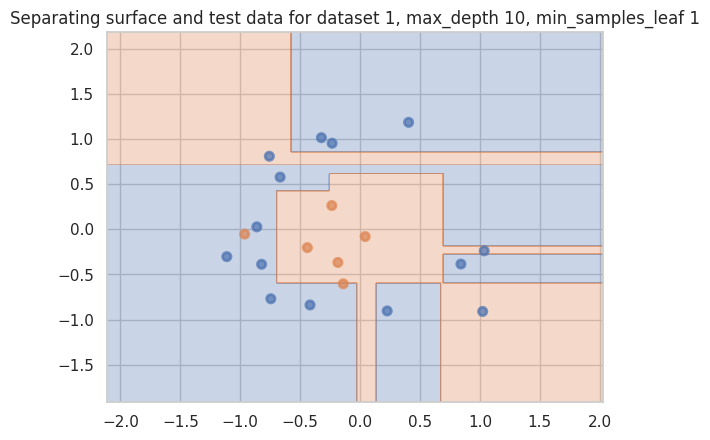

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 2: 0.94


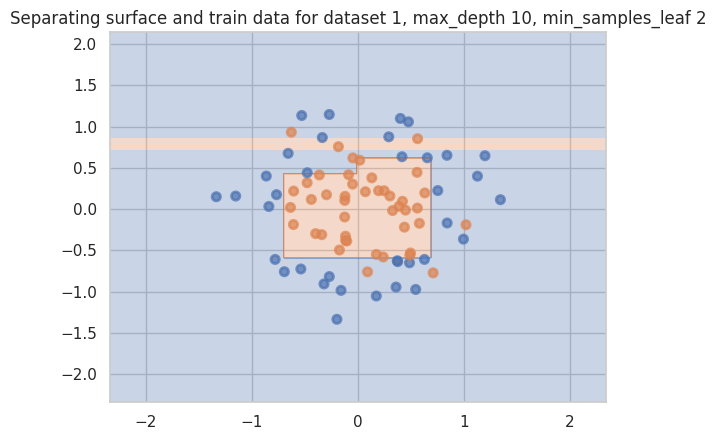

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 2: 0.85


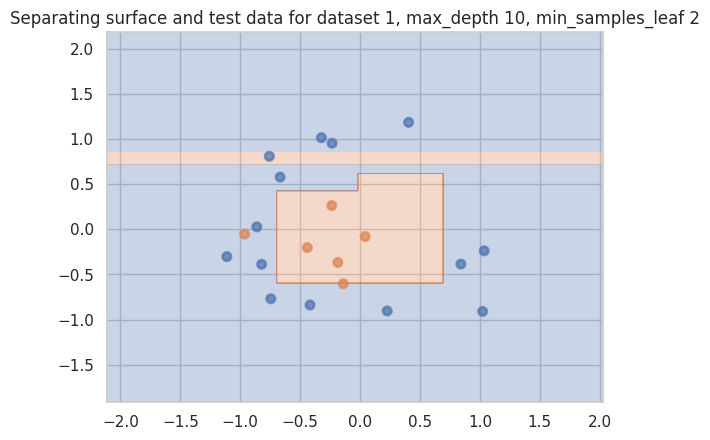

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 3: 0.94


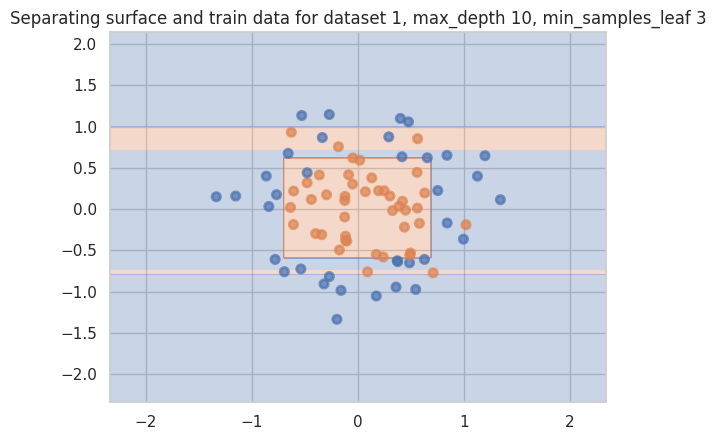

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 3: 0.70


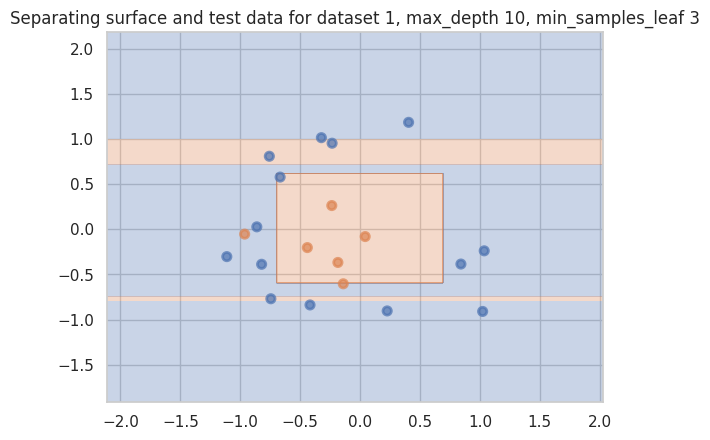

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 4: 0.93


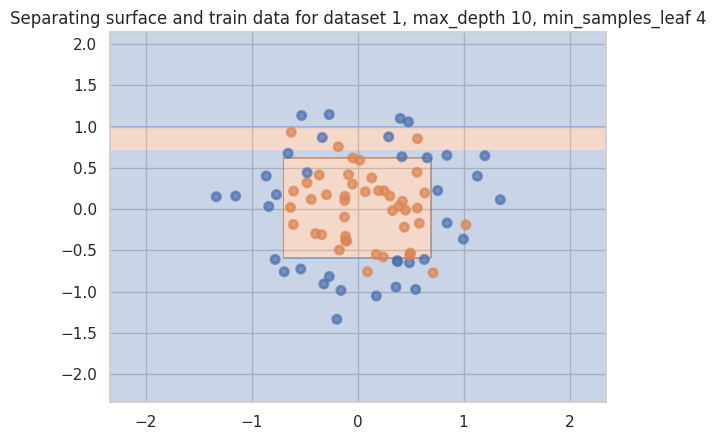

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 4: 0.75


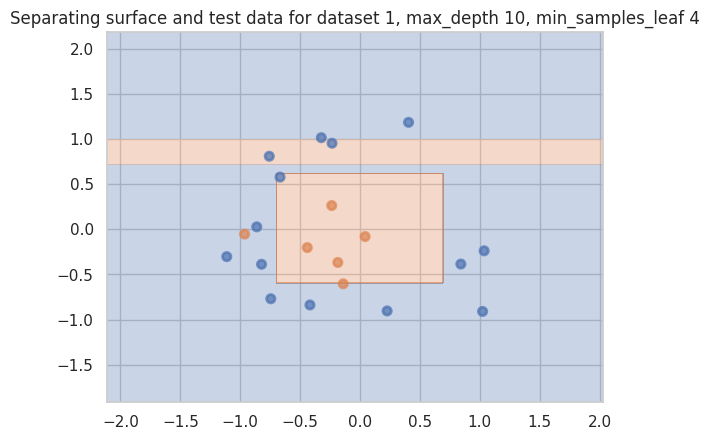

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 5: 0.91


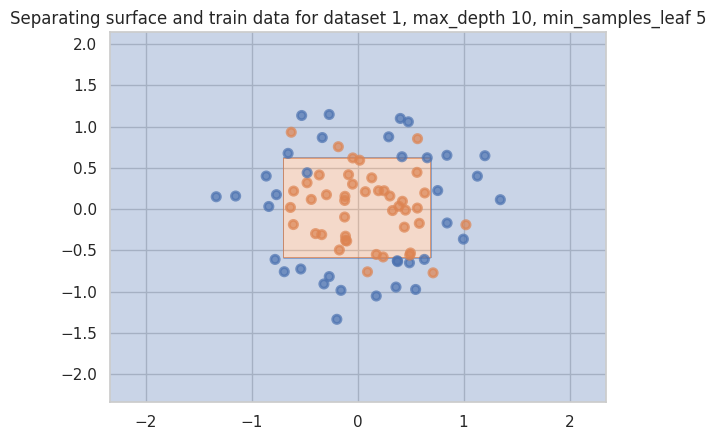

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 5: 0.85


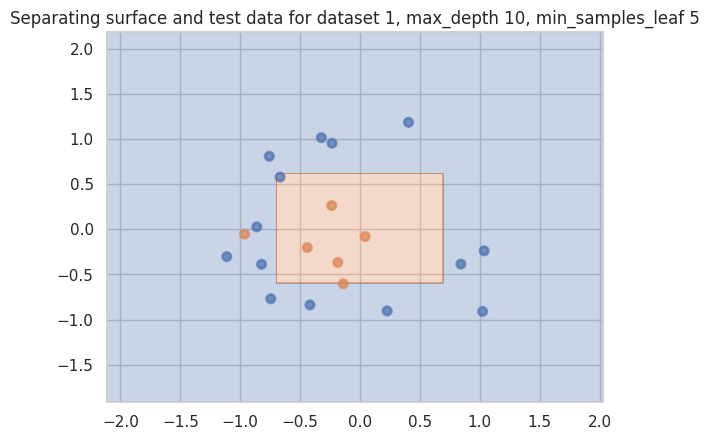

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 6: 0.90


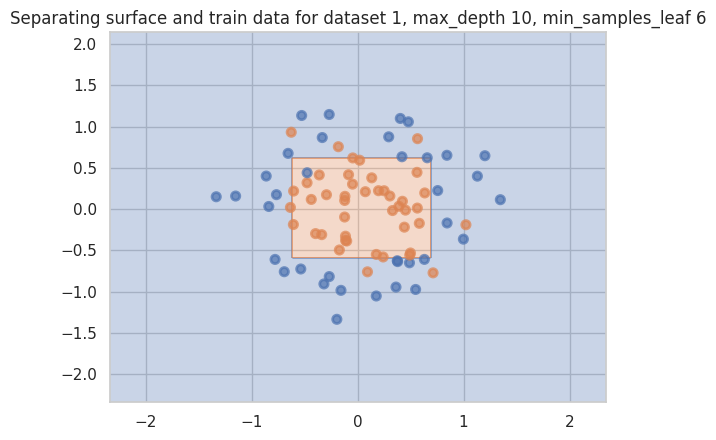

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 6: 0.90


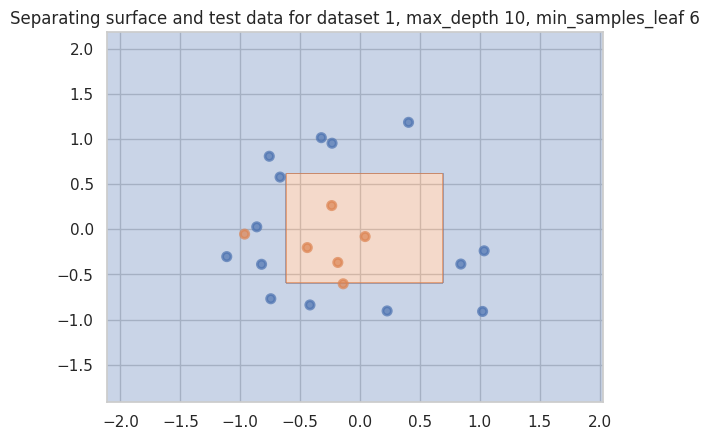

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 7: 0.88


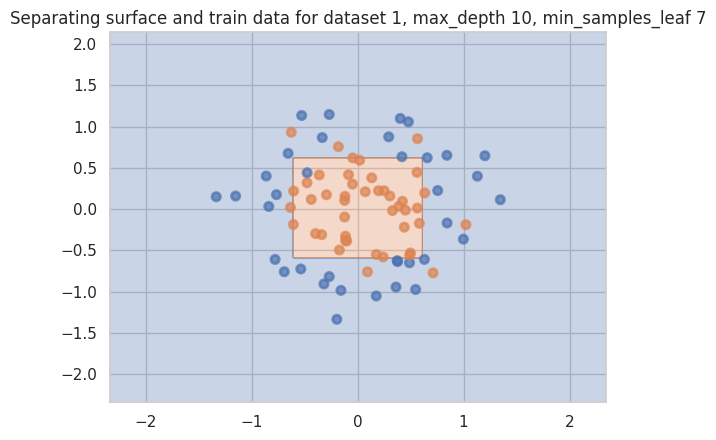

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 7: 0.90


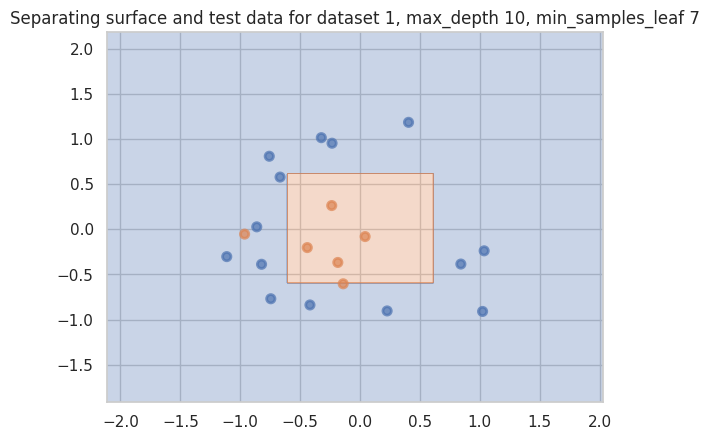

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 8: 0.85


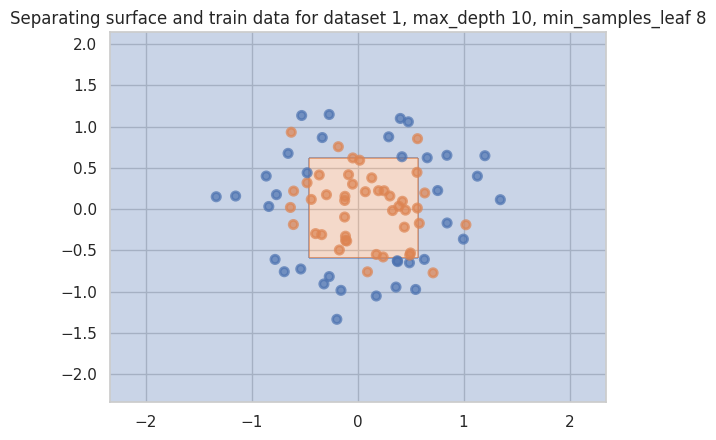

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 8: 0.90


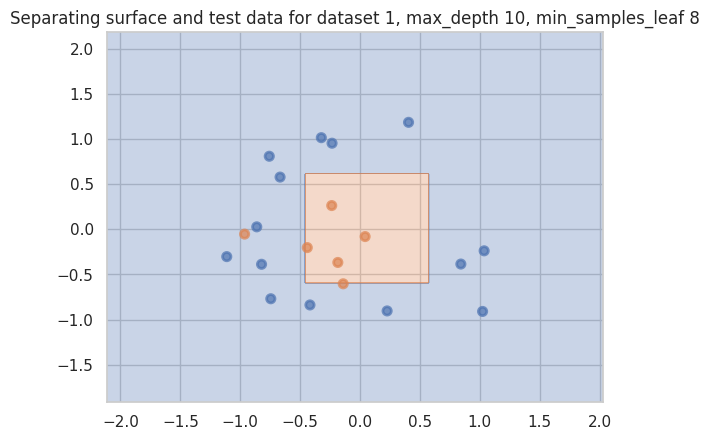

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 9: 0.84


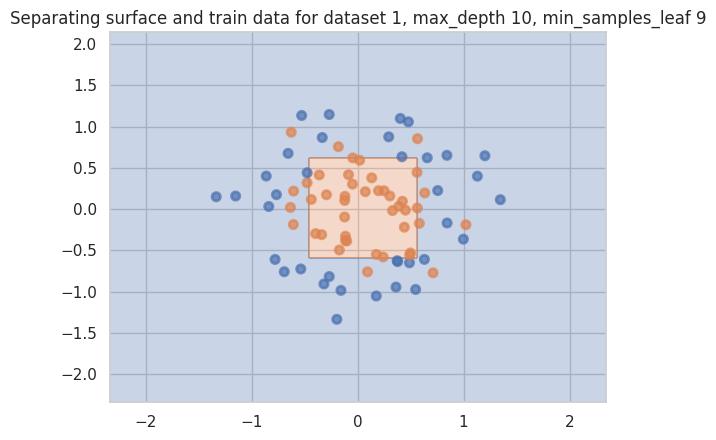

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 9: 0.90


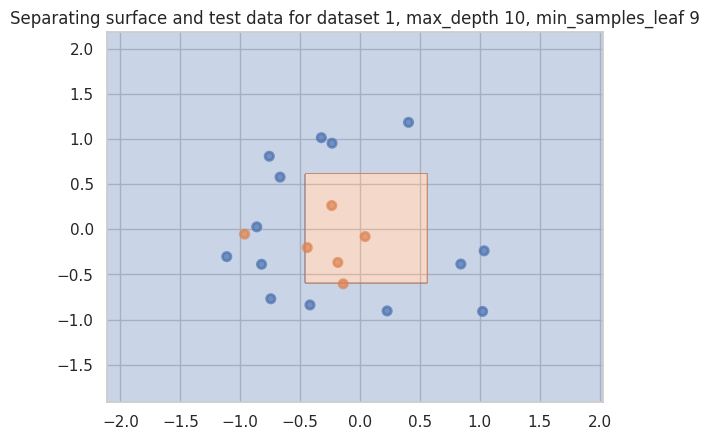

Accuracy on train for dataset 1, max_depth 10, min_samples_leaf 10: 0.82


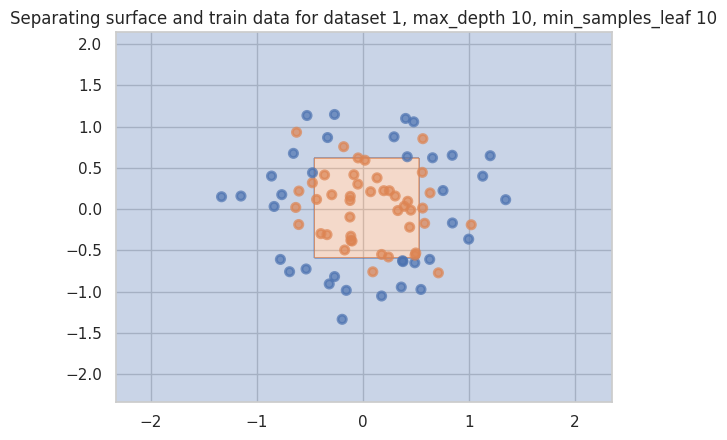

Accuracy on test for dataset 1, max_depth 10, min_samples_leaf 10: 0.90


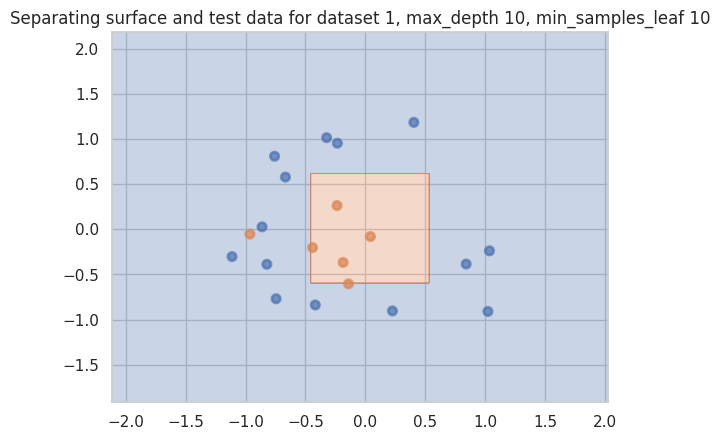

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 1: 0.91


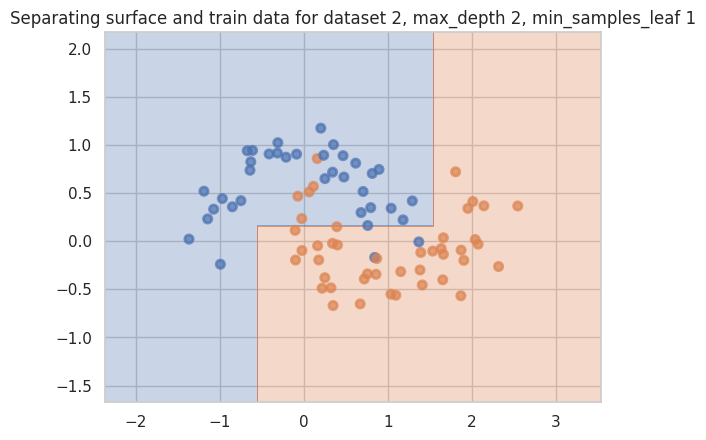

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 1: 1.00


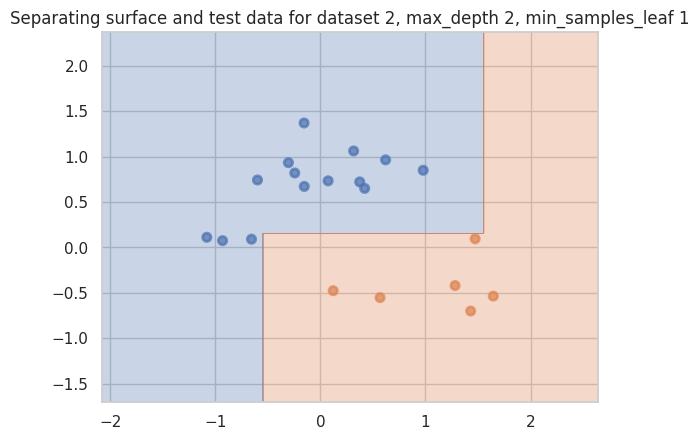

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 2: 0.91


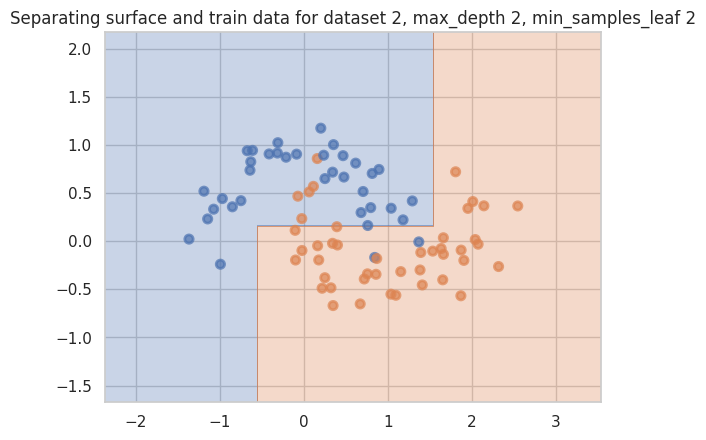

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 2: 1.00


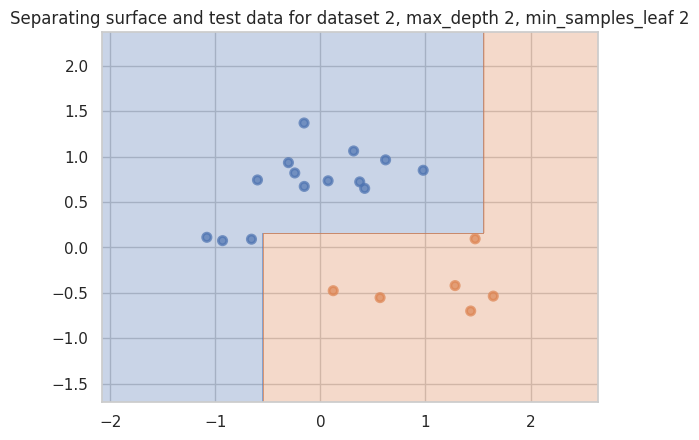

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 3: 0.90


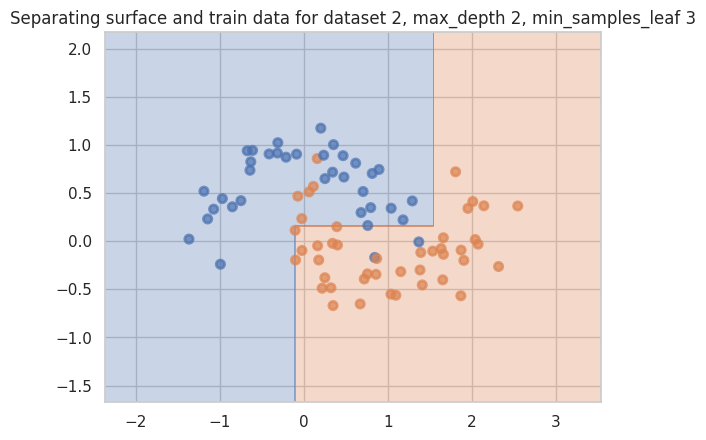

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 3: 1.00


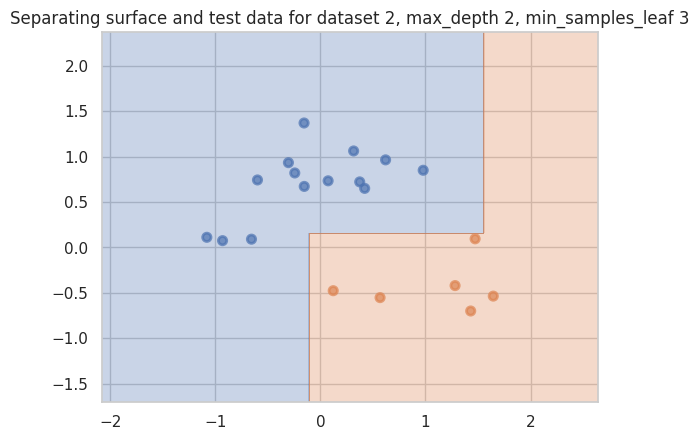

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 4: 0.89


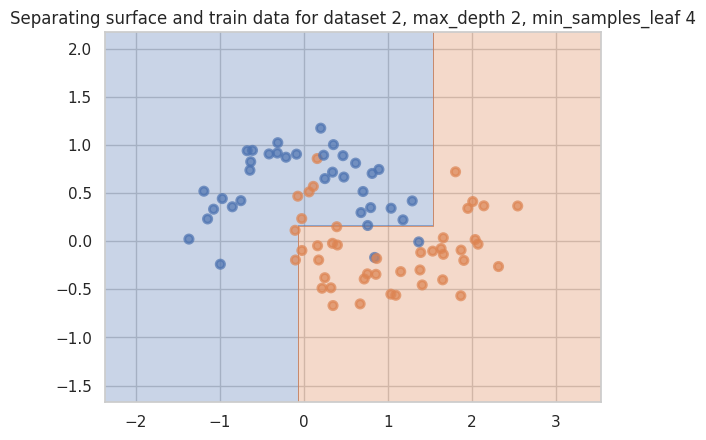

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 4: 1.00


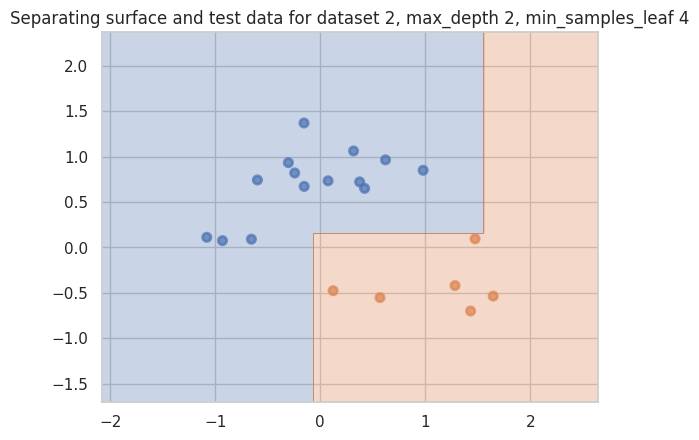

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 5: 0.89


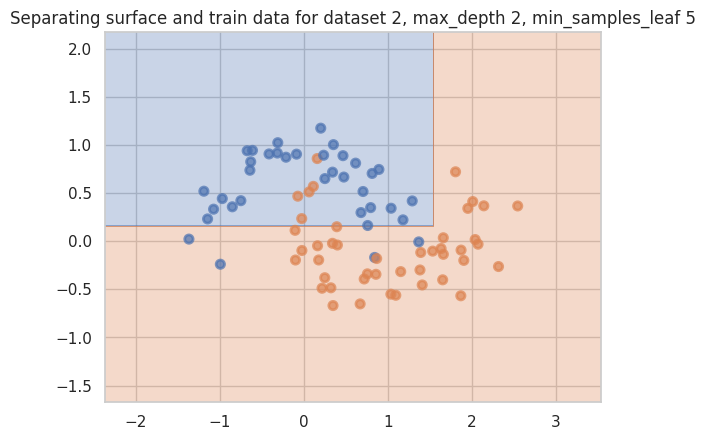

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 5: 0.85


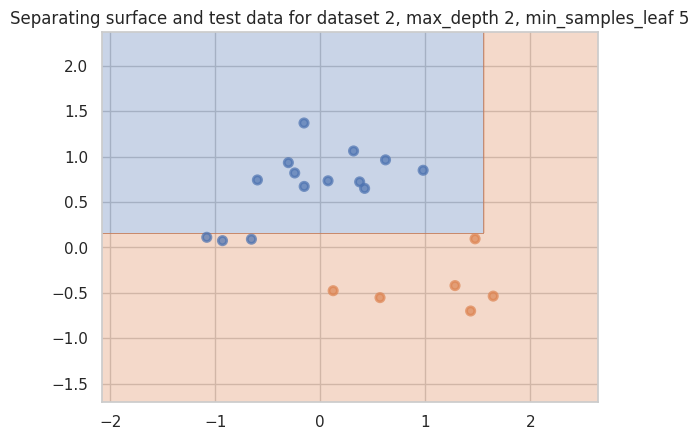

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 6: 0.88


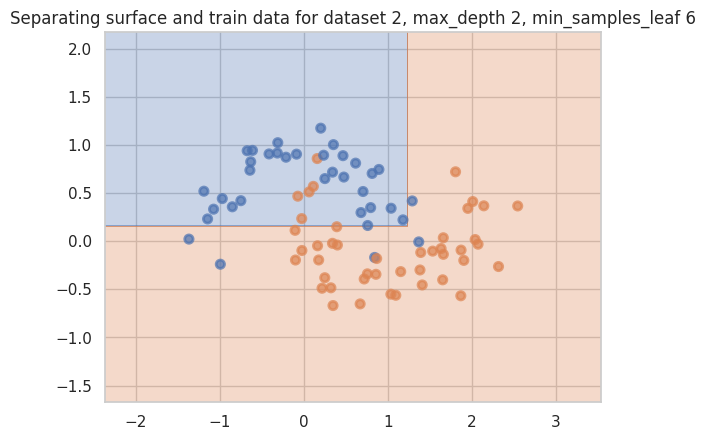

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 6: 0.85


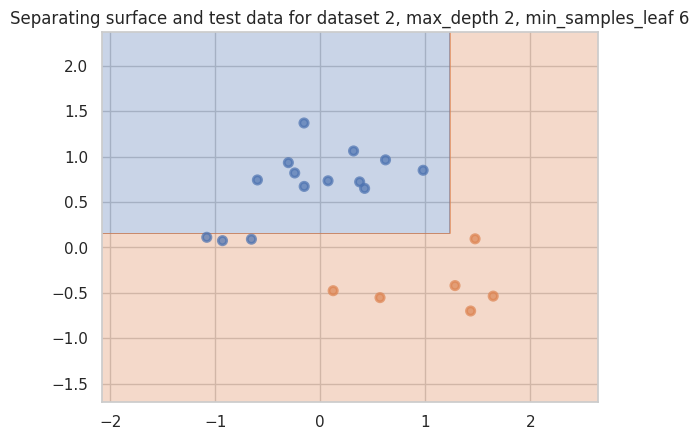

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 7: 0.86


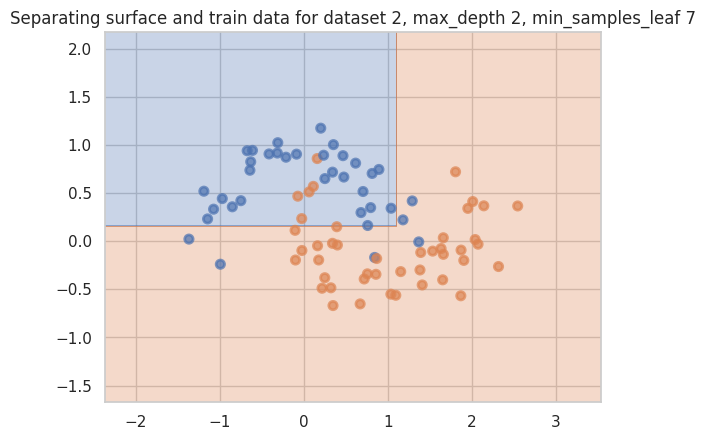

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 7: 0.85


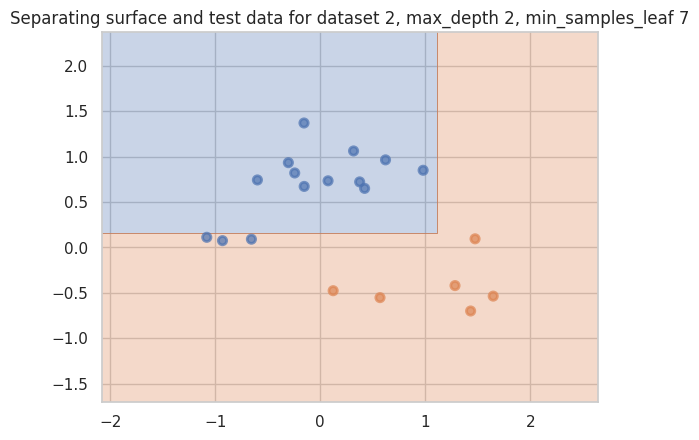

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 8: 0.85


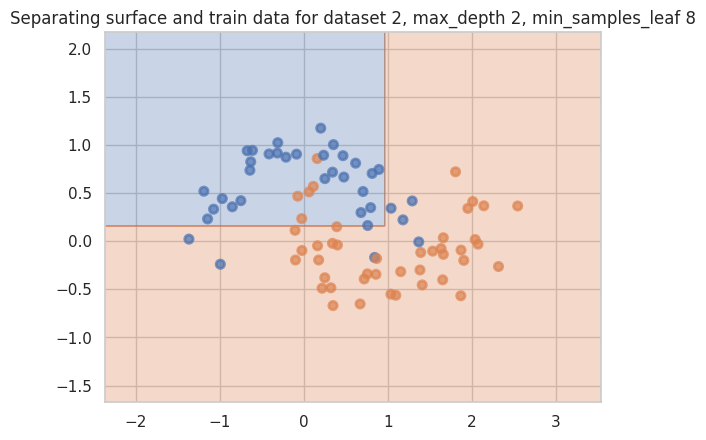

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 8: 0.80


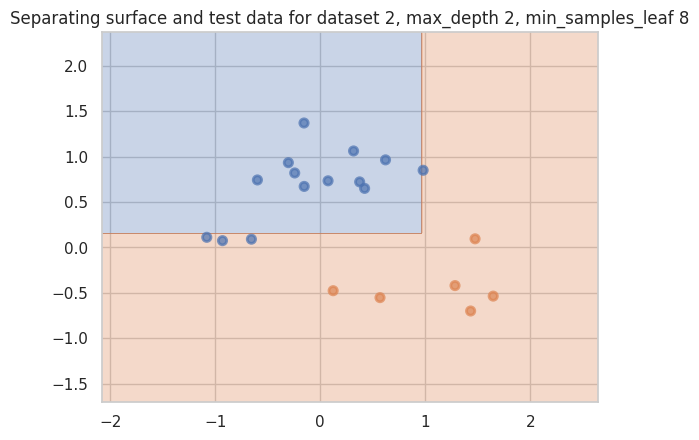

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 9: 0.82


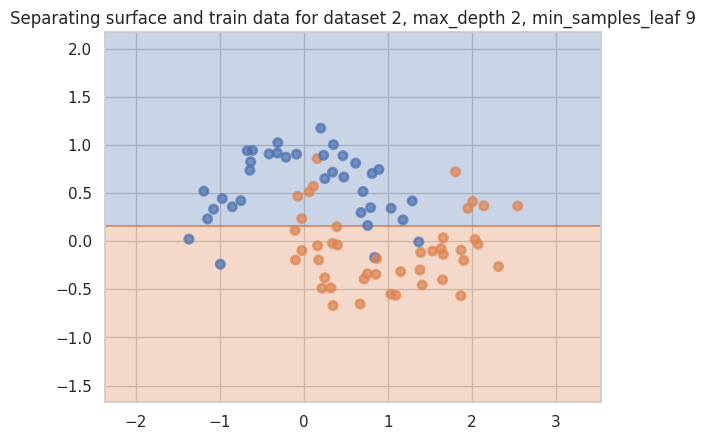

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 9: 0.85


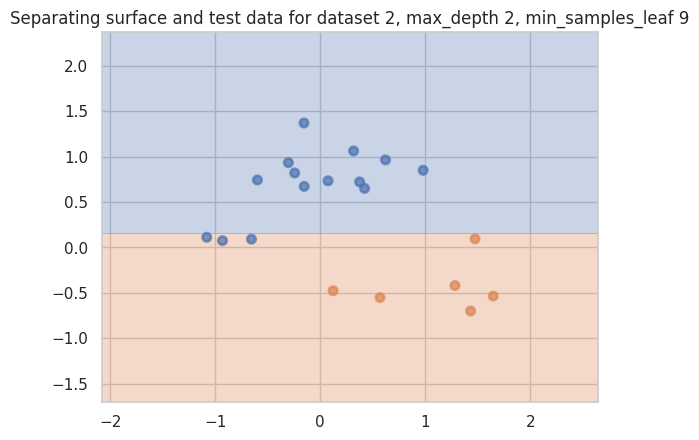

Accuracy on train for dataset 2, max_depth 2, min_samples_leaf 10: 0.82


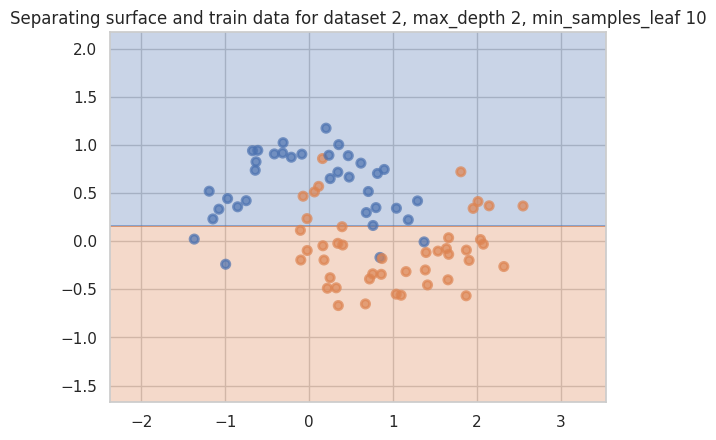

Accuracy on test for dataset 2, max_depth 2, min_samples_leaf 10: 0.85


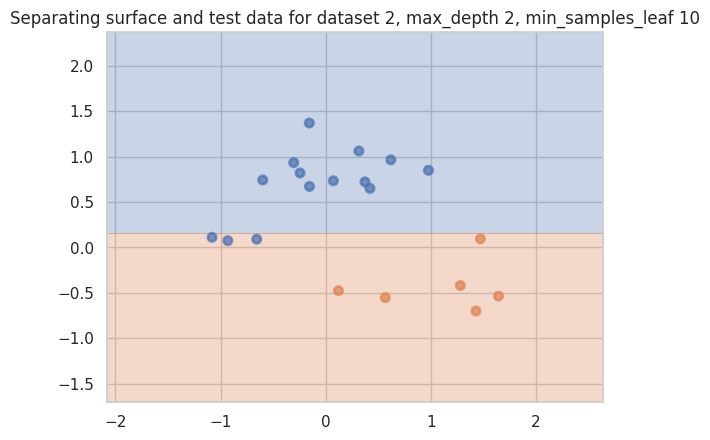

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 1: 0.91


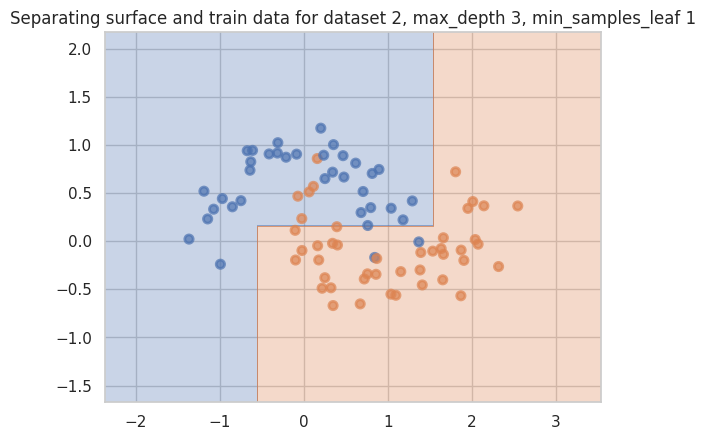

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 1: 1.00


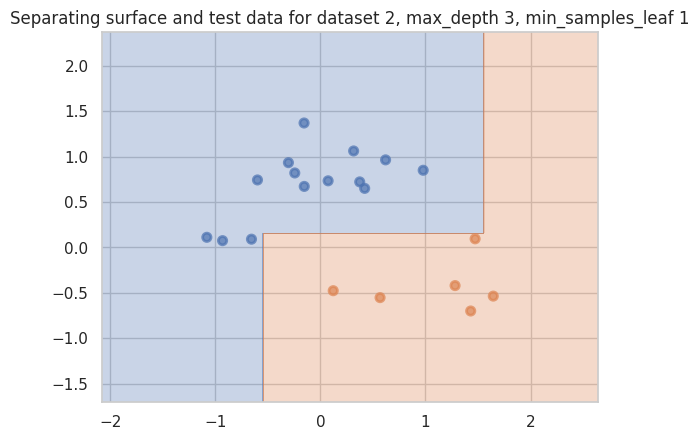

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 2: 0.91


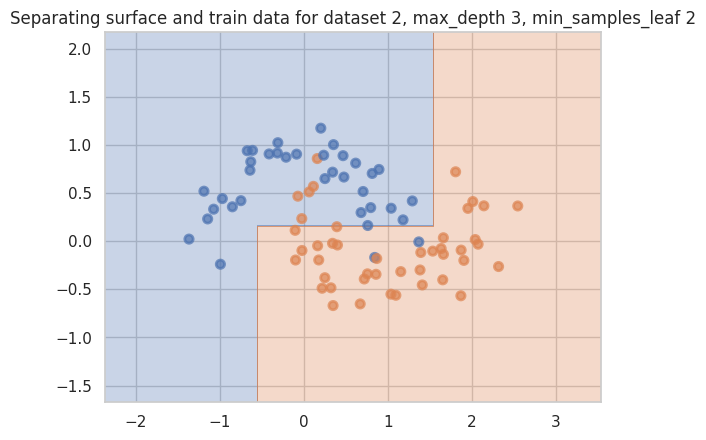

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 2: 1.00


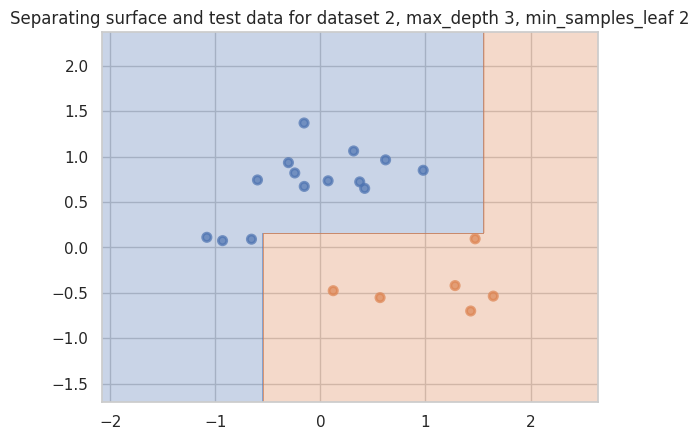

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 3: 0.90


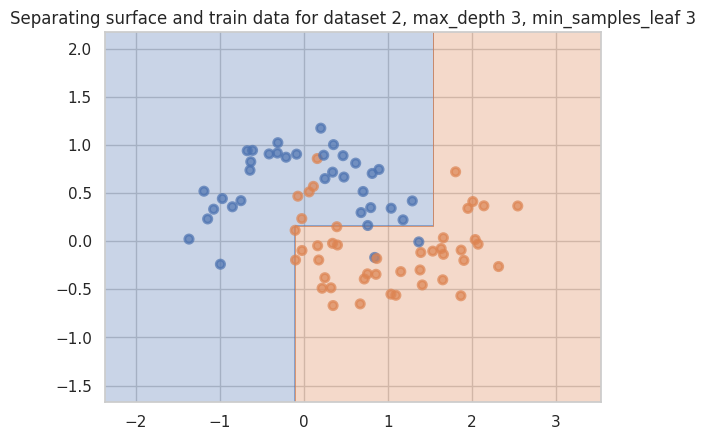

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 3: 1.00


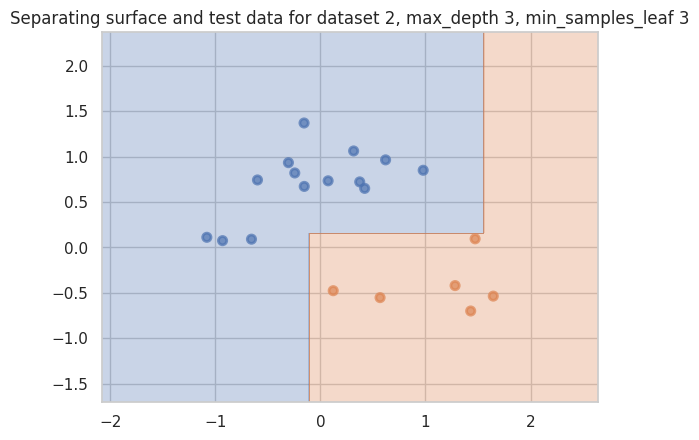

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 4: 0.89


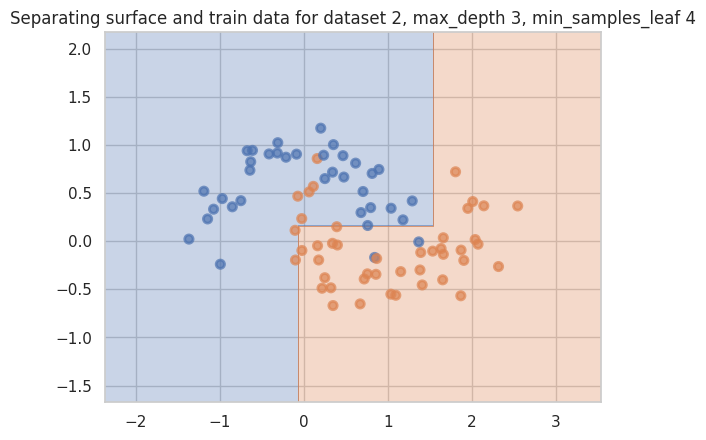

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 4: 1.00


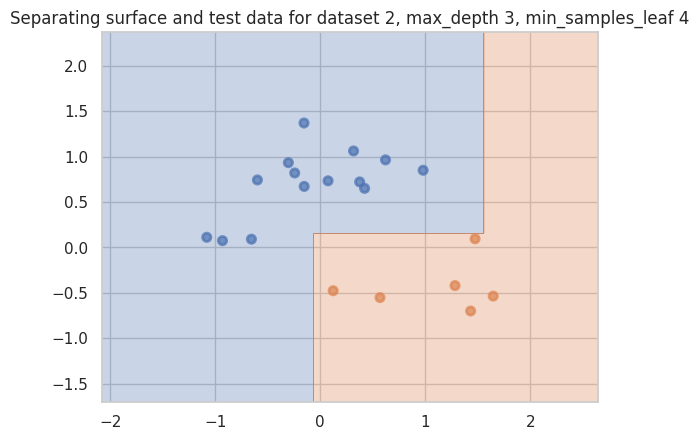

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 5: 0.89


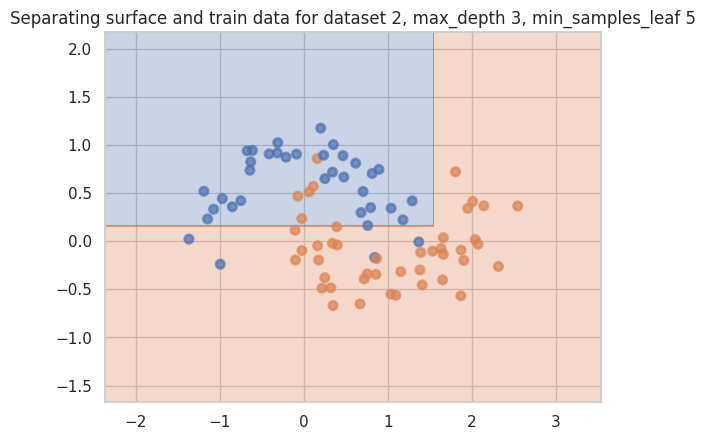

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 5: 0.85


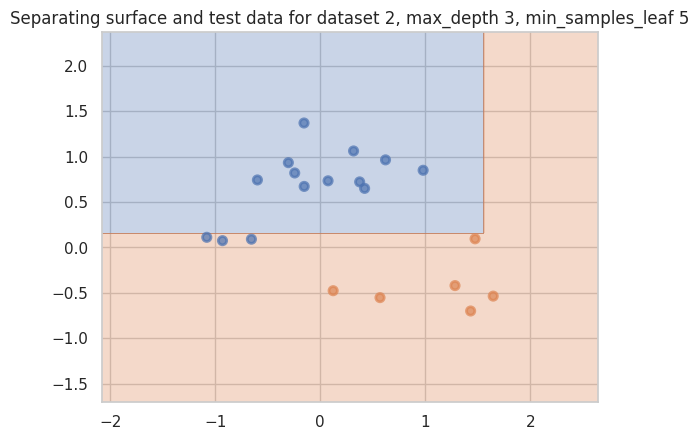

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 6: 0.88


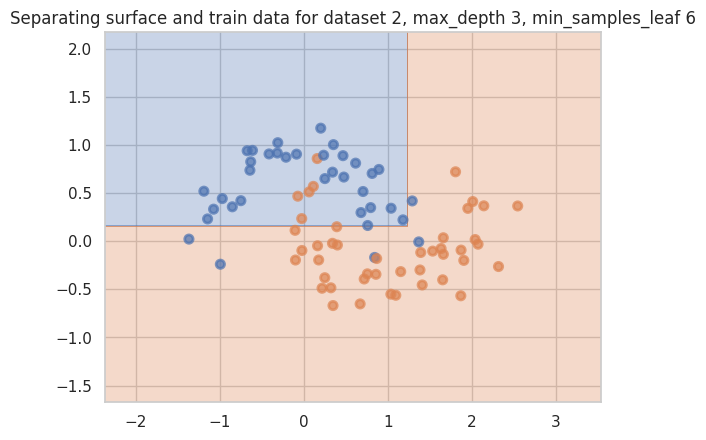

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 6: 0.85


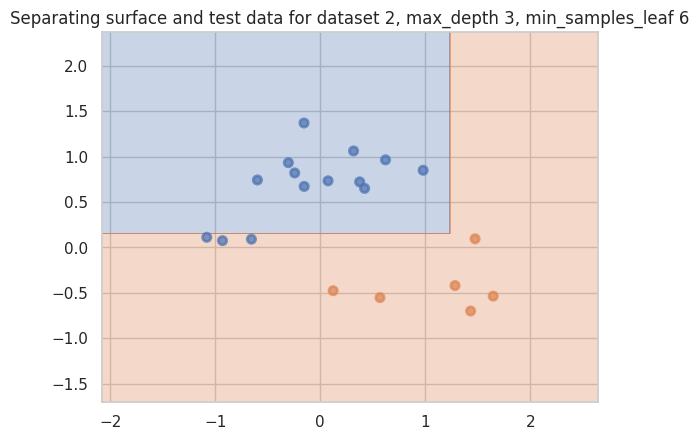

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 7: 0.86


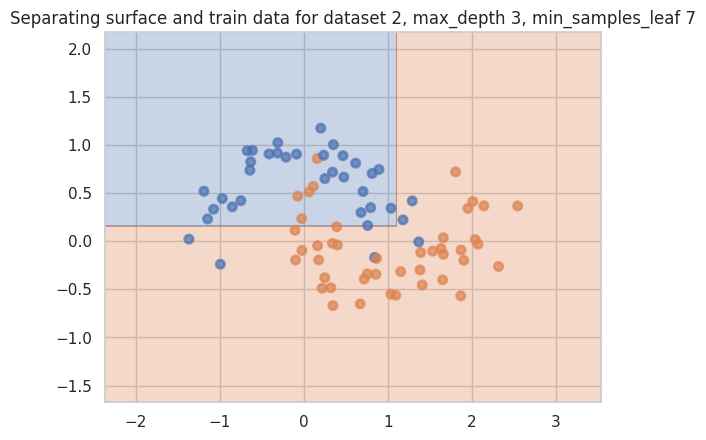

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 7: 0.85


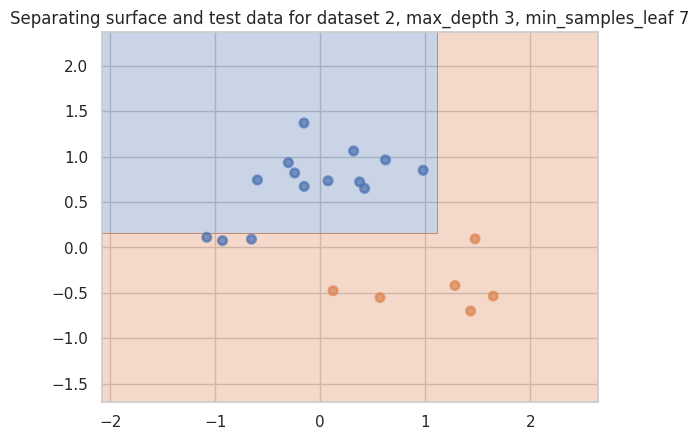

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 8: 0.85


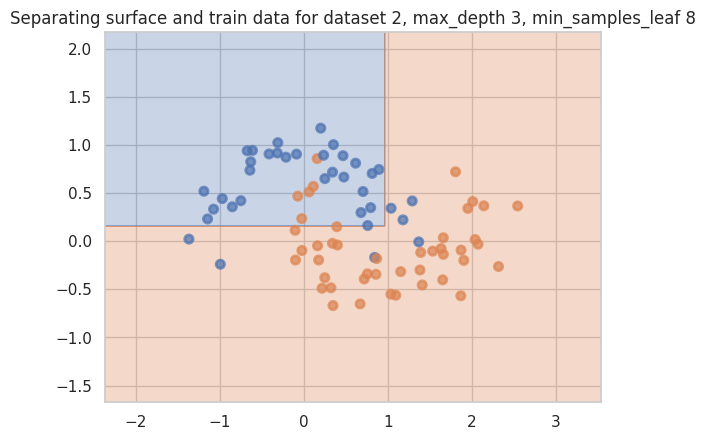

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 8: 0.80


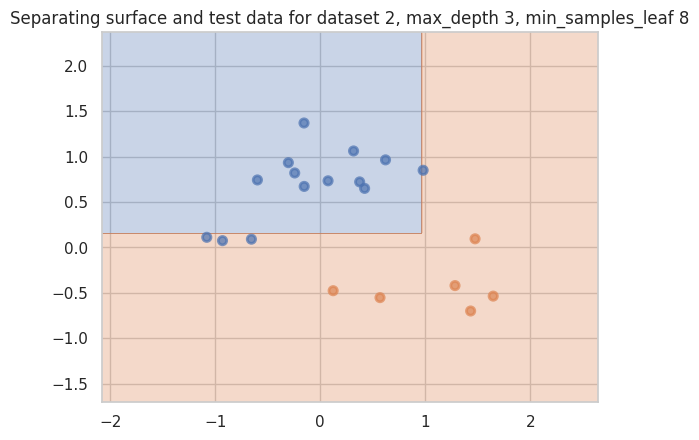

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 9: 0.84


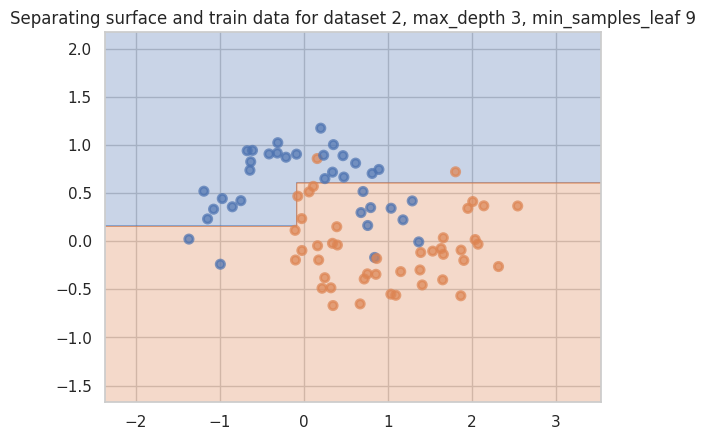

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 9: 0.85


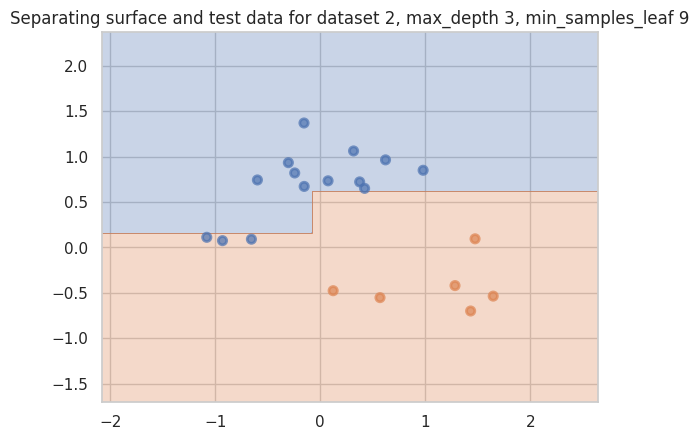

Accuracy on train for dataset 2, max_depth 3, min_samples_leaf 10: 0.84


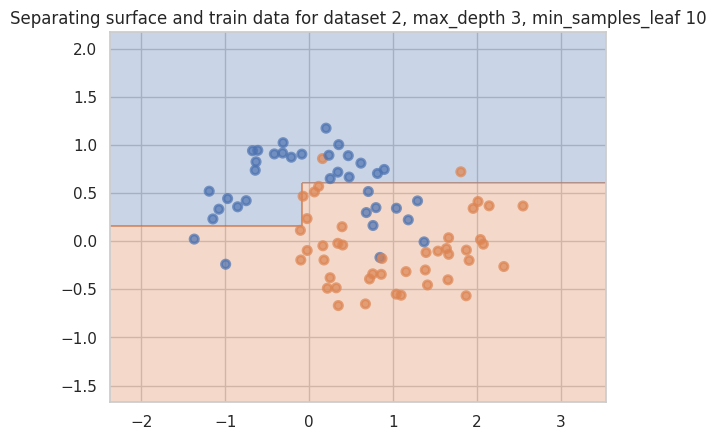

Accuracy on test for dataset 2, max_depth 3, min_samples_leaf 10: 0.85


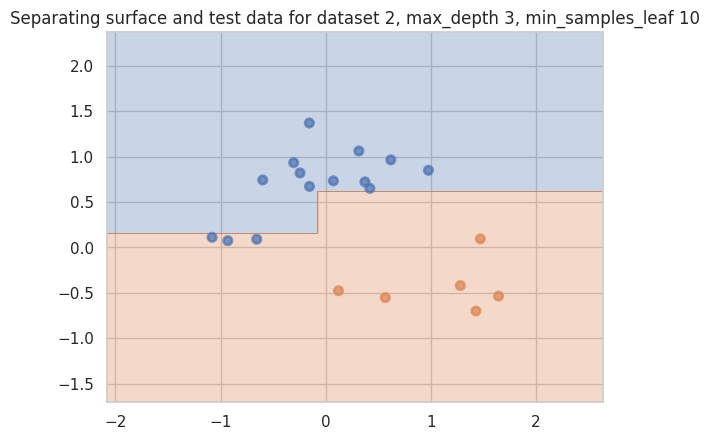

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 1: 0.99


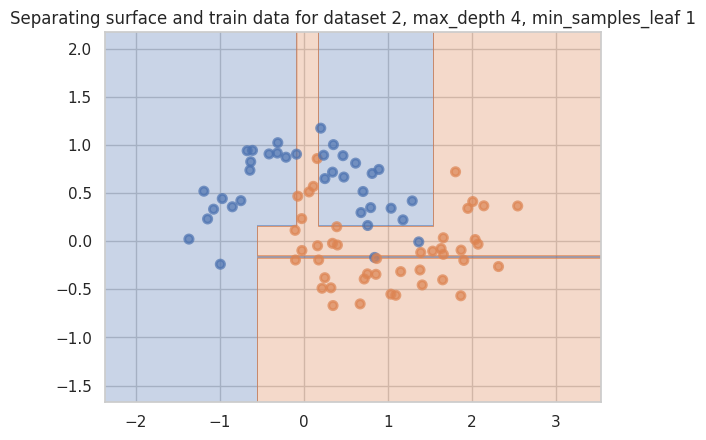

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 1: 0.95


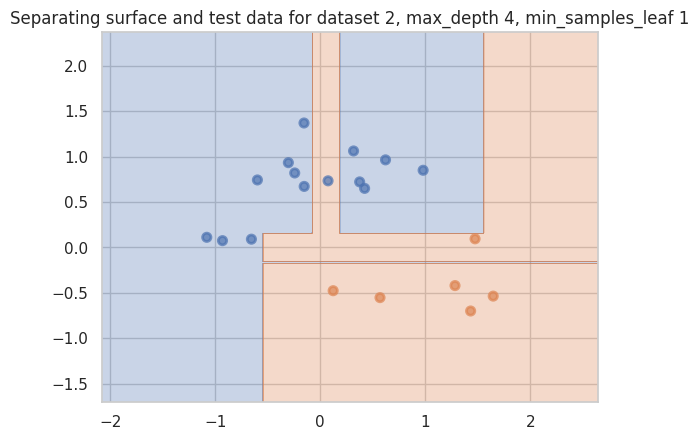

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 2: 0.97


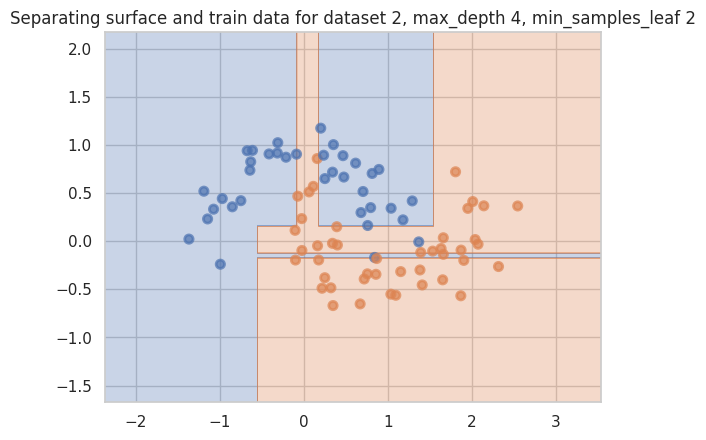

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 2: 0.95


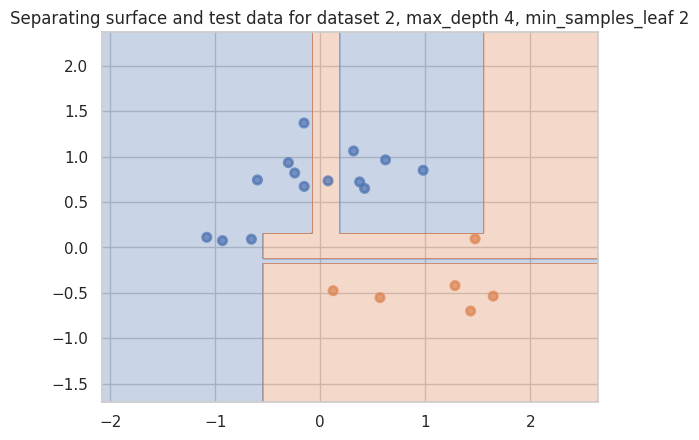

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 3: 0.96


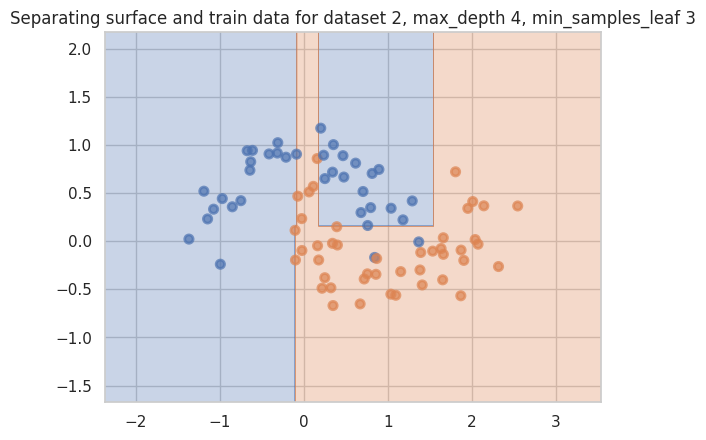

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 3: 0.95


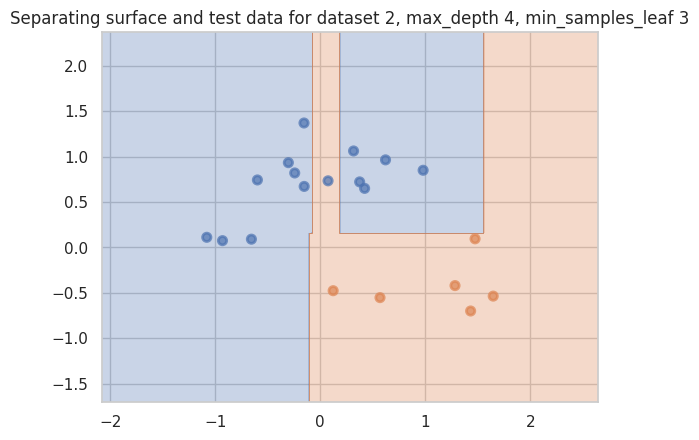

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 4: 0.95


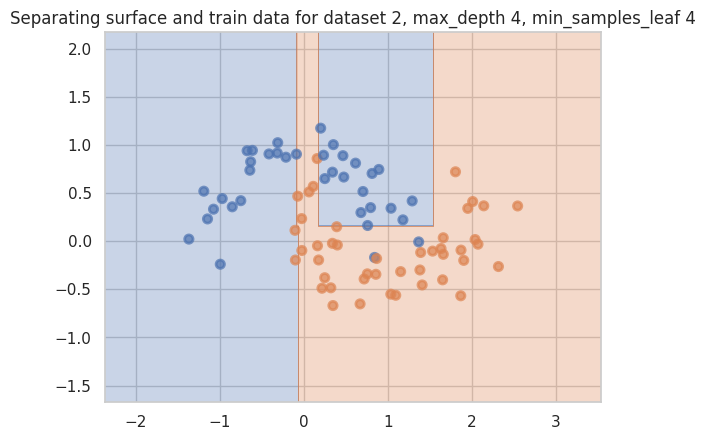

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 4: 0.95


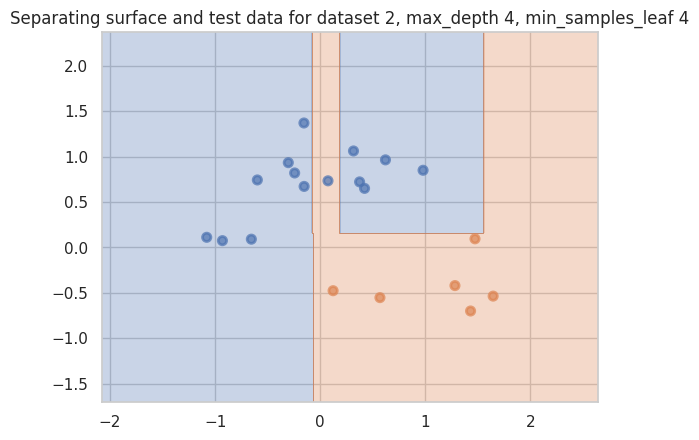

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 5: 0.95


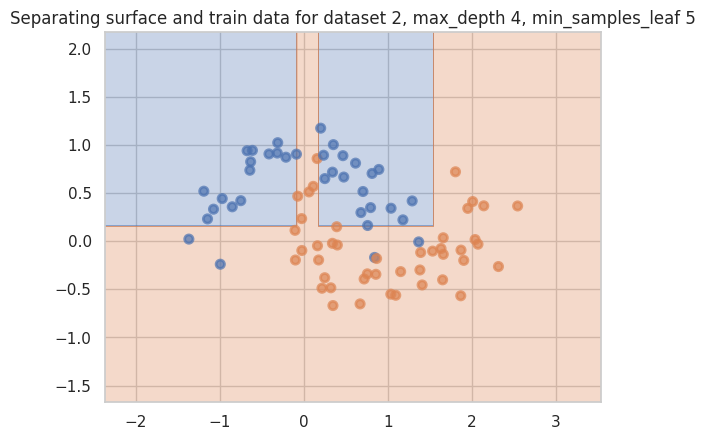

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 5: 0.80


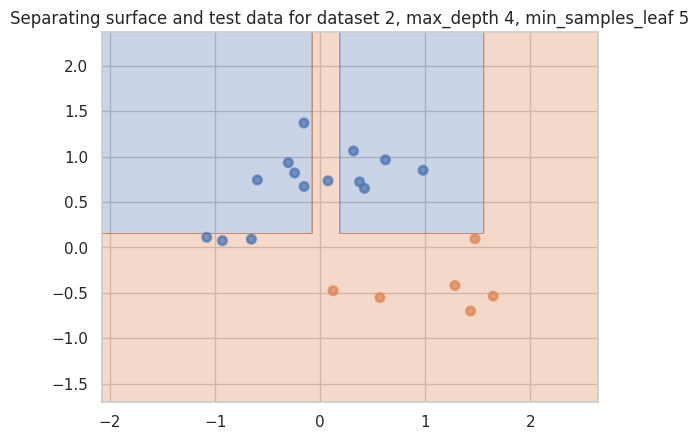

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 6: 0.93


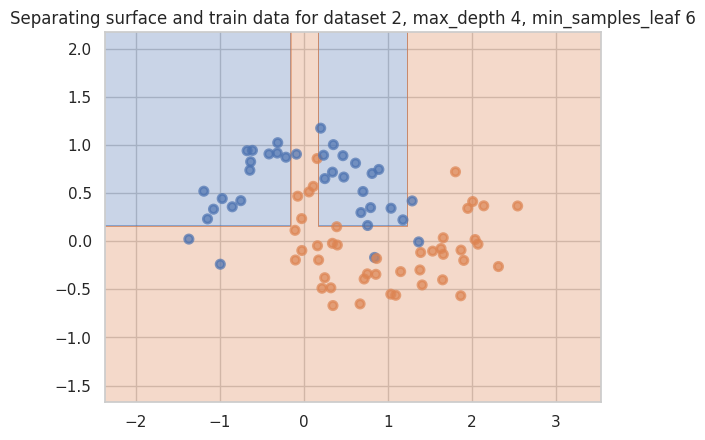

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 6: 0.80


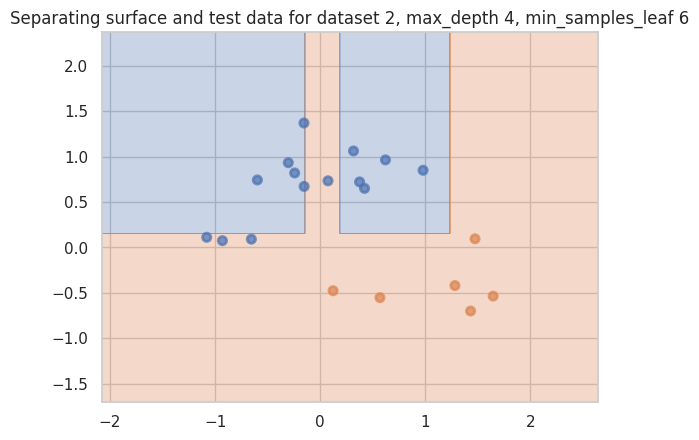

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 7: 0.90


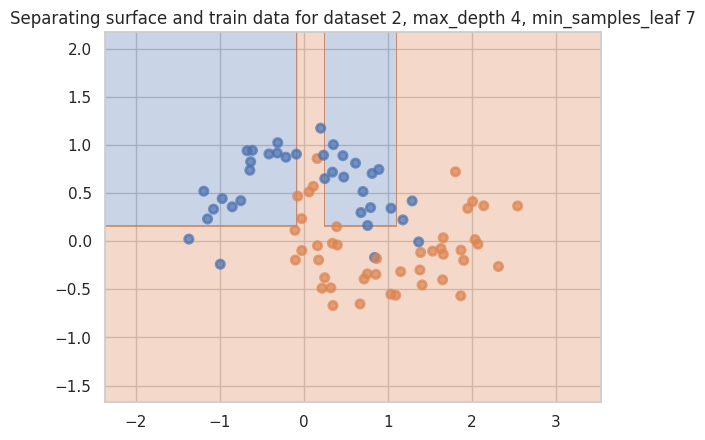

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 7: 0.80


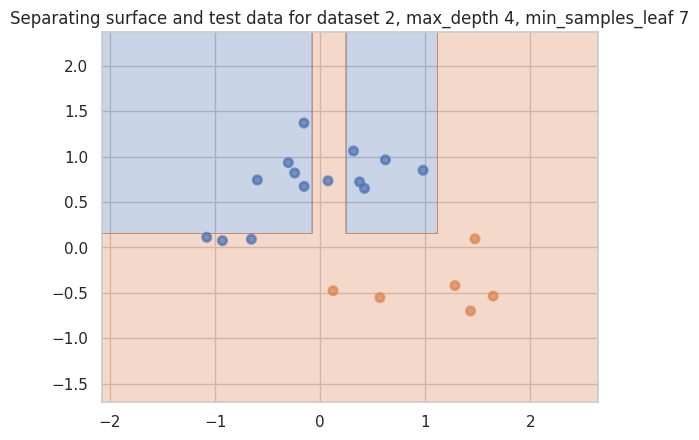

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 8: 0.88


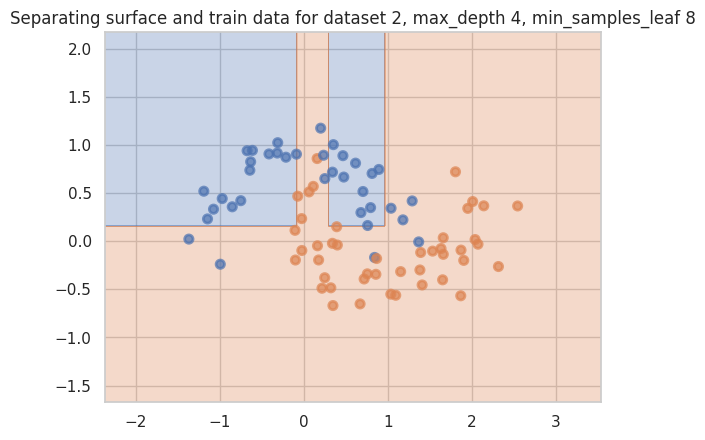

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 8: 0.75


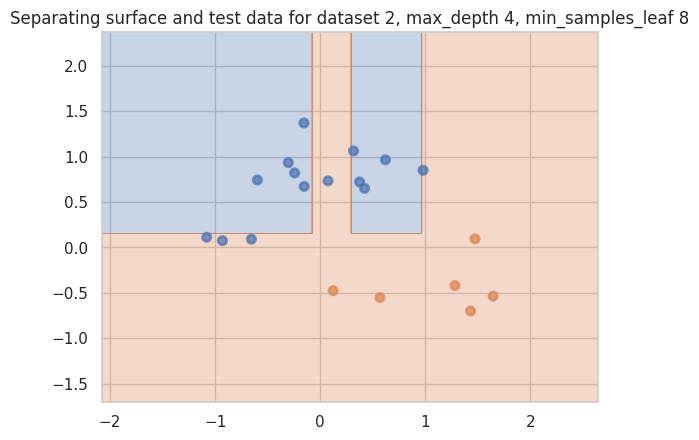

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 9: 0.84


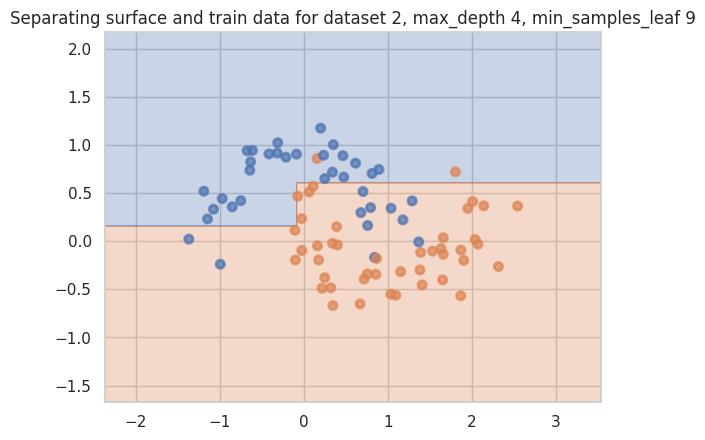

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 9: 0.85


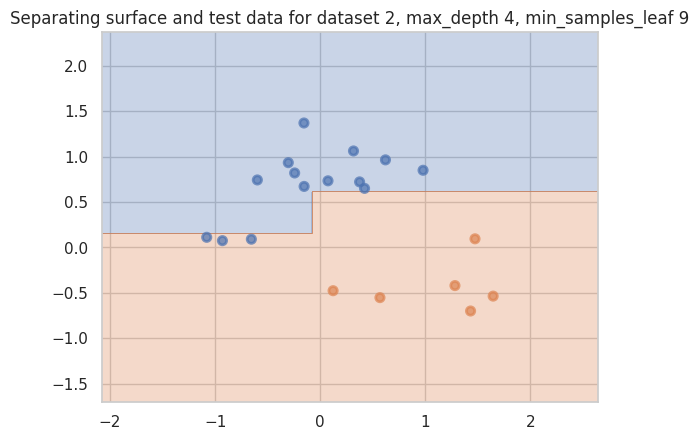

Accuracy on train for dataset 2, max_depth 4, min_samples_leaf 10: 0.84


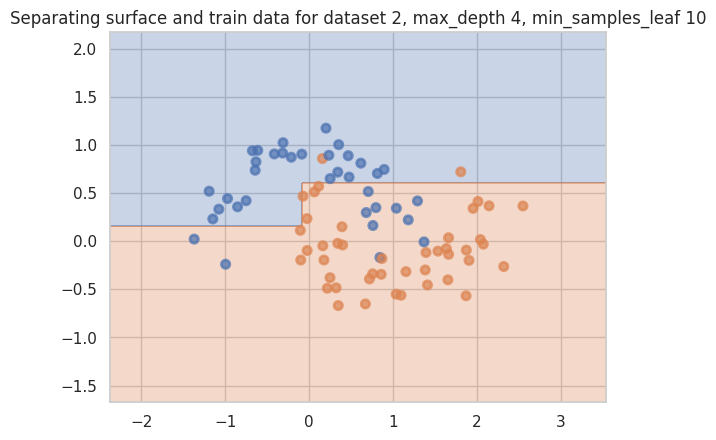

Accuracy on test for dataset 2, max_depth 4, min_samples_leaf 10: 0.85


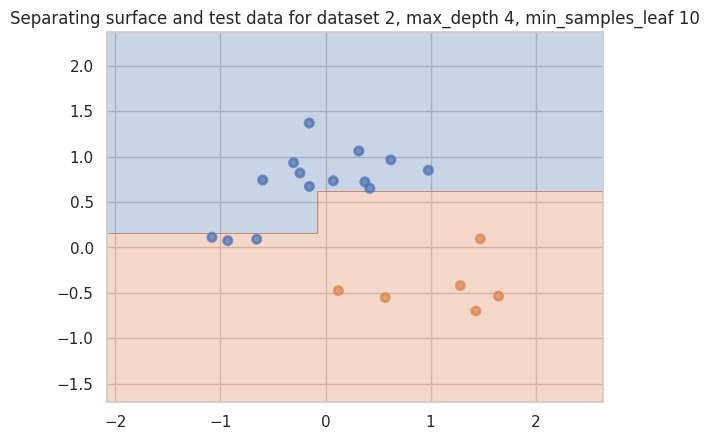

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 1: 0.99


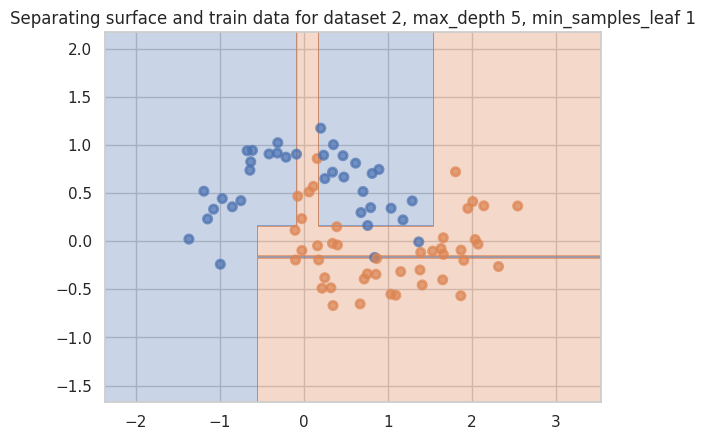

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 1: 0.95


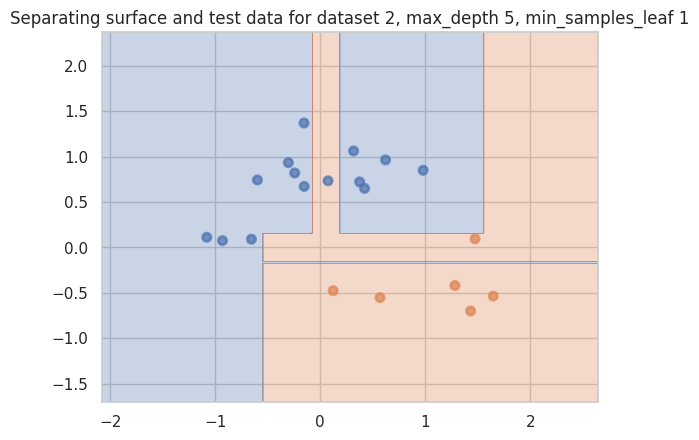

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 2: 0.97


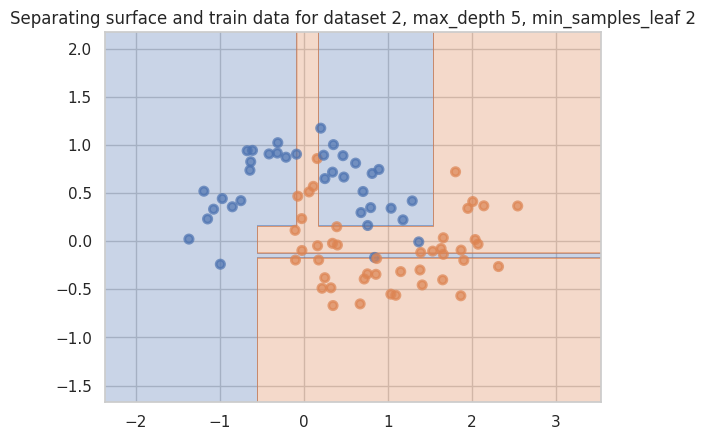

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 2: 0.95


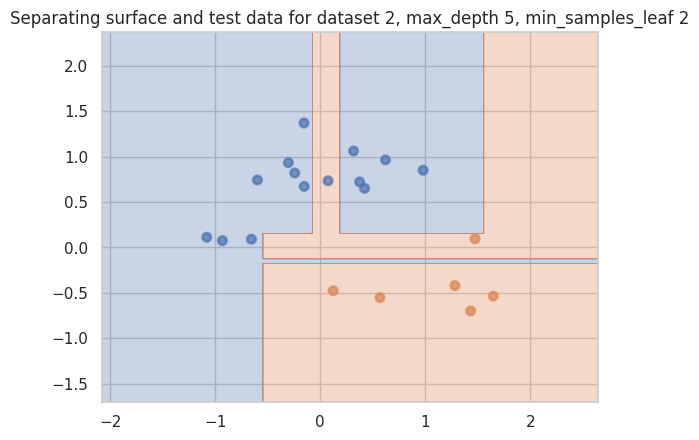

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 3: 0.96


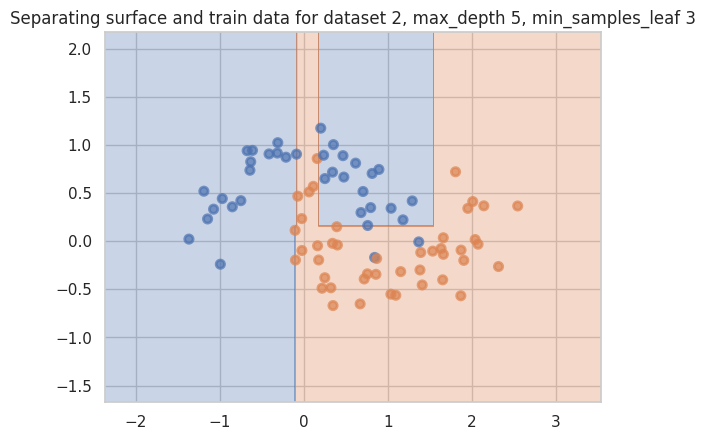

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 3: 0.95


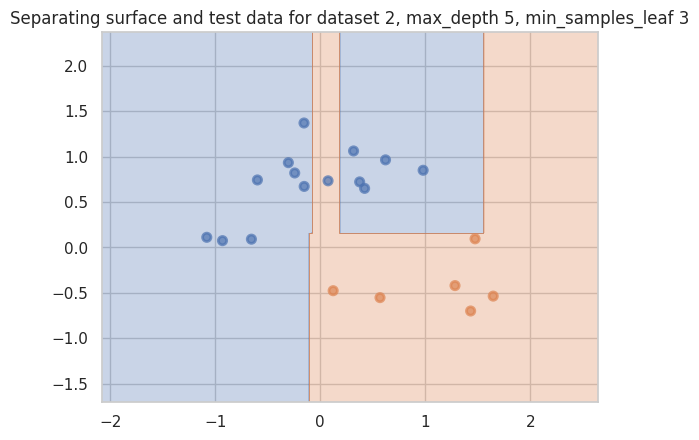

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 4: 0.95


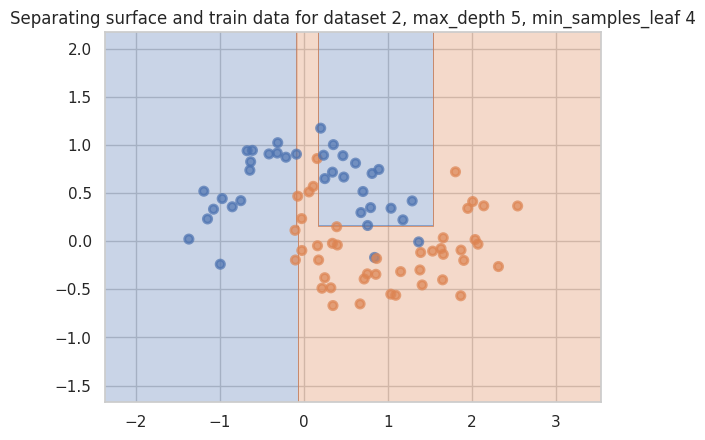

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 4: 0.95


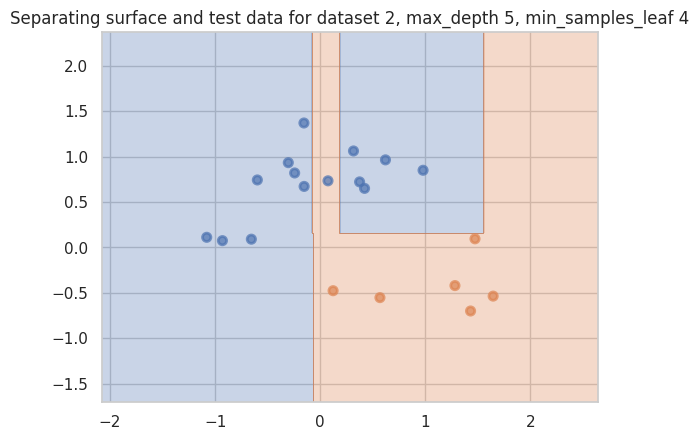

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 5: 0.95


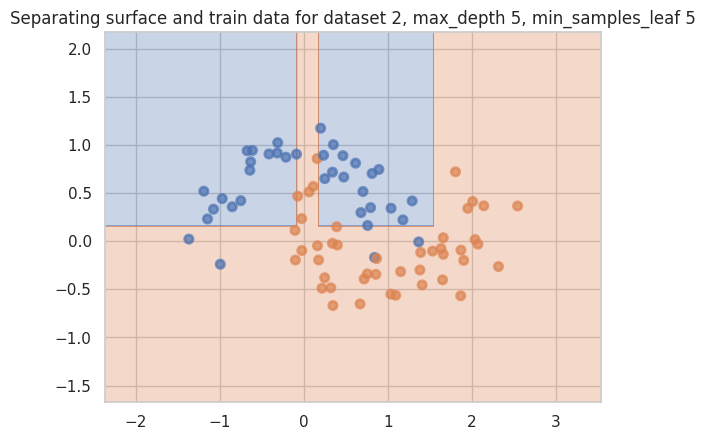

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 5: 0.80


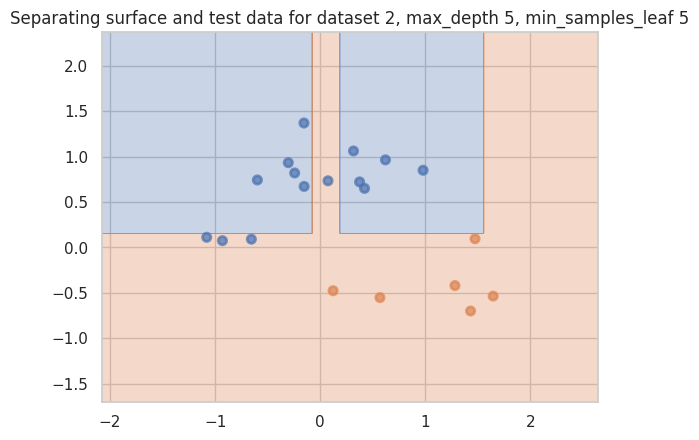

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 6: 0.93


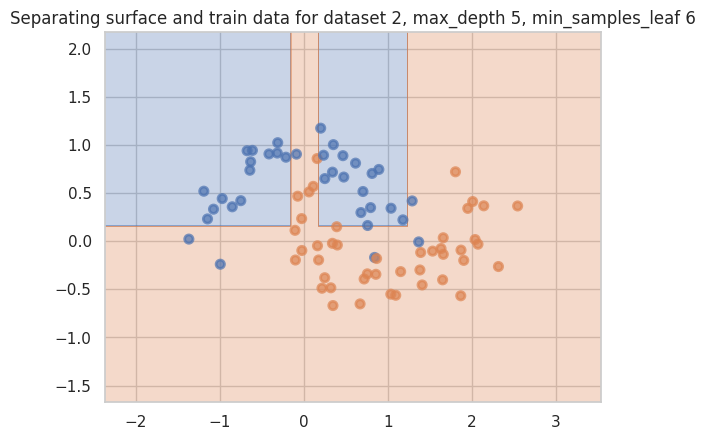

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 6: 0.80


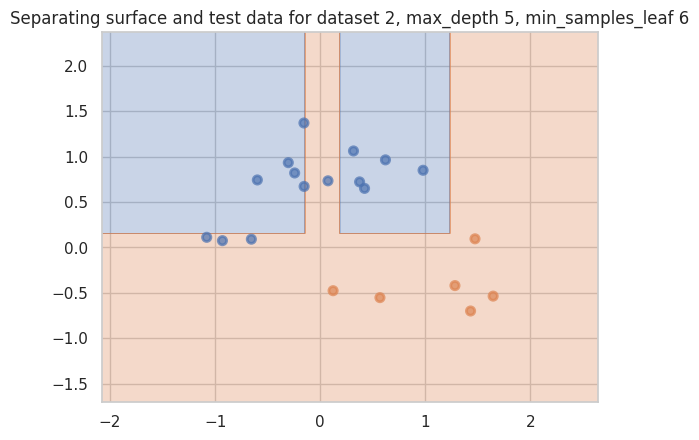

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 7: 0.90


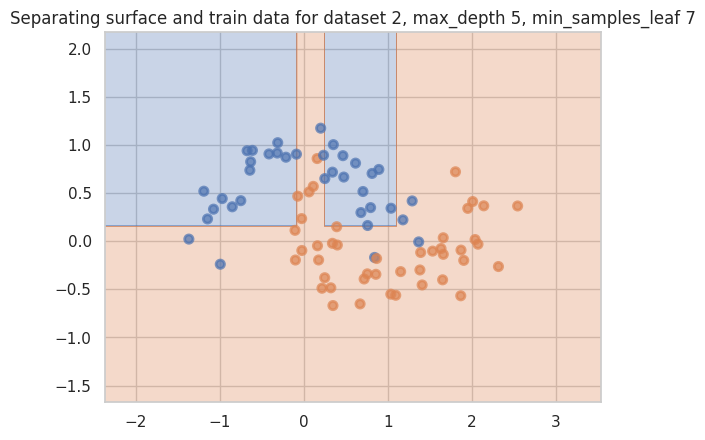

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 7: 0.80


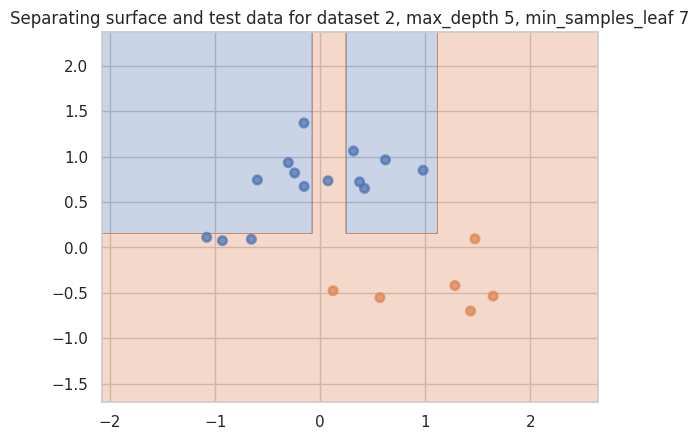

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 8: 0.88


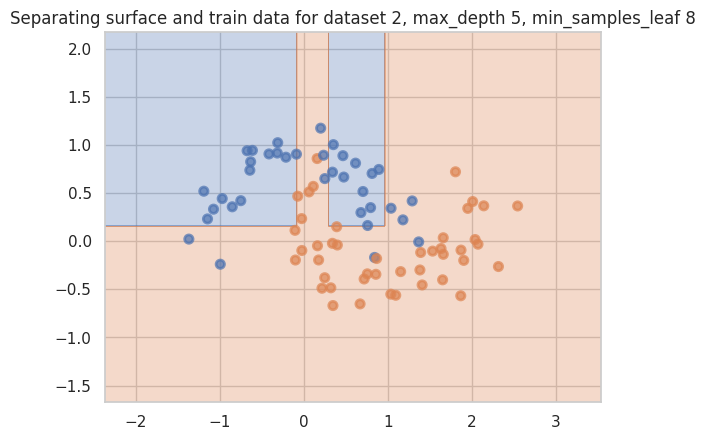

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 8: 0.75


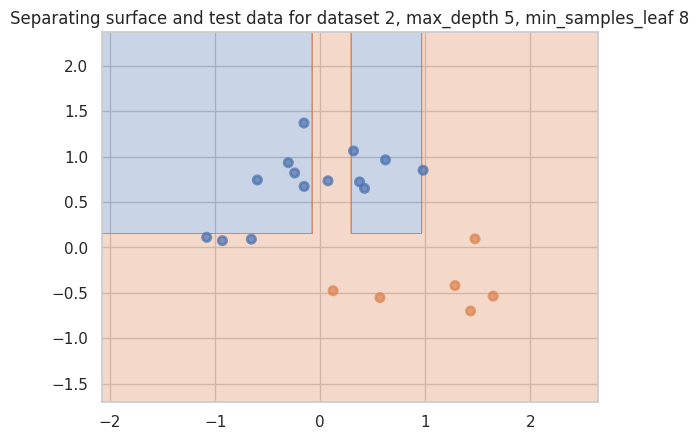

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 9: 0.84


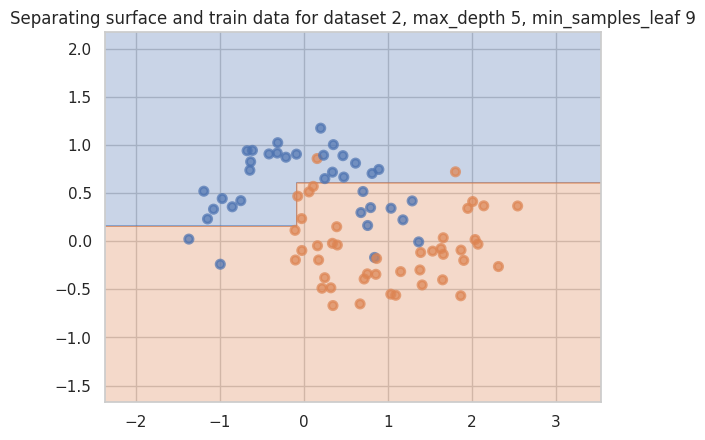

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 9: 0.85


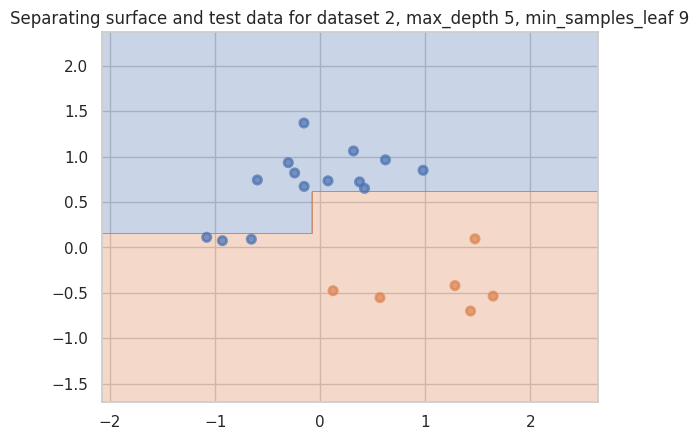

Accuracy on train for dataset 2, max_depth 5, min_samples_leaf 10: 0.84


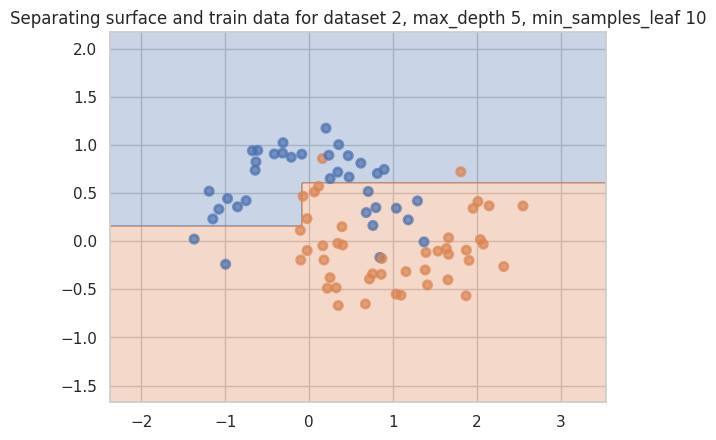

Accuracy on test for dataset 2, max_depth 5, min_samples_leaf 10: 0.85


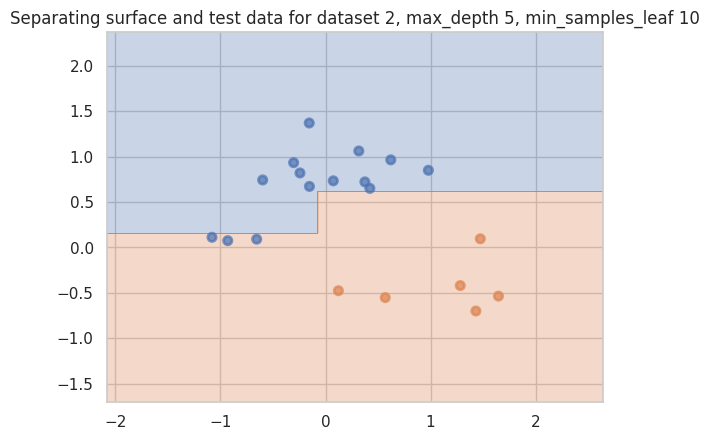

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 1: 1.00


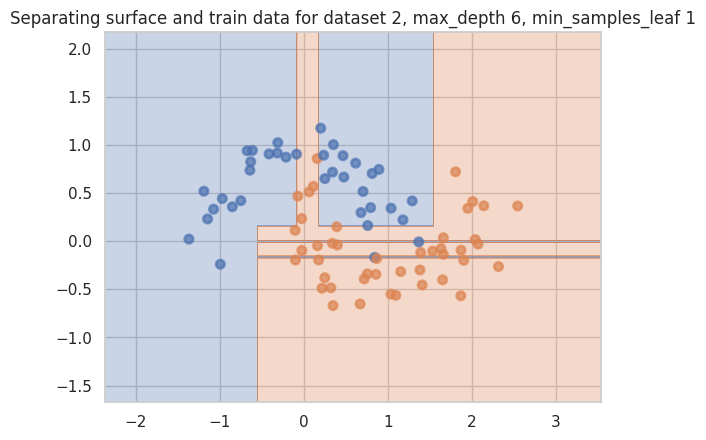

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 1: 0.95


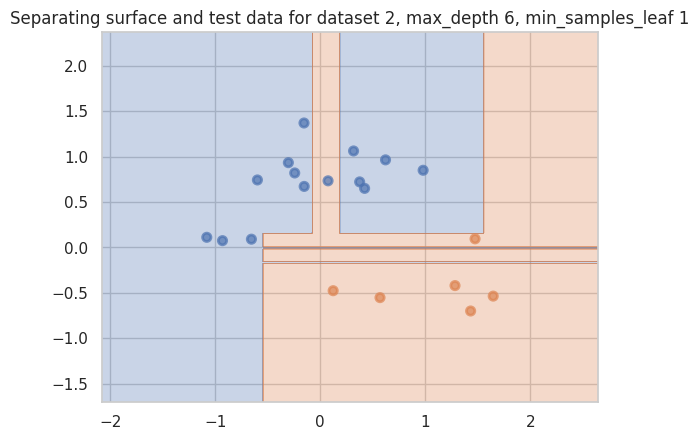

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 2: 0.97


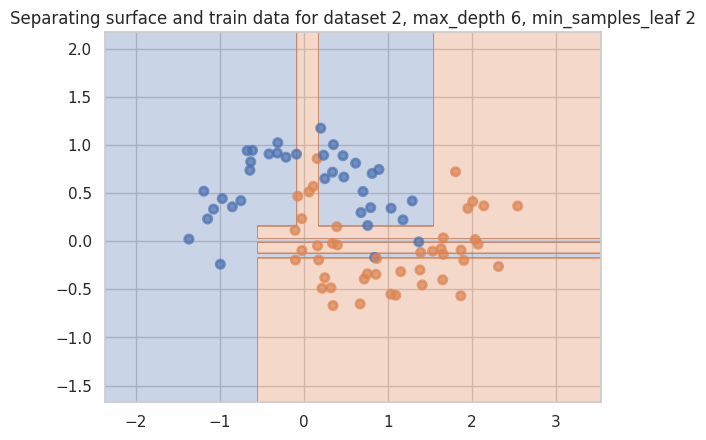

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 2: 0.95


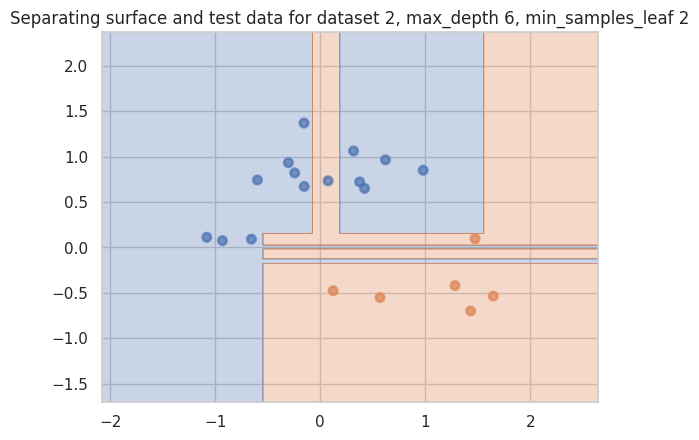

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 3: 0.96


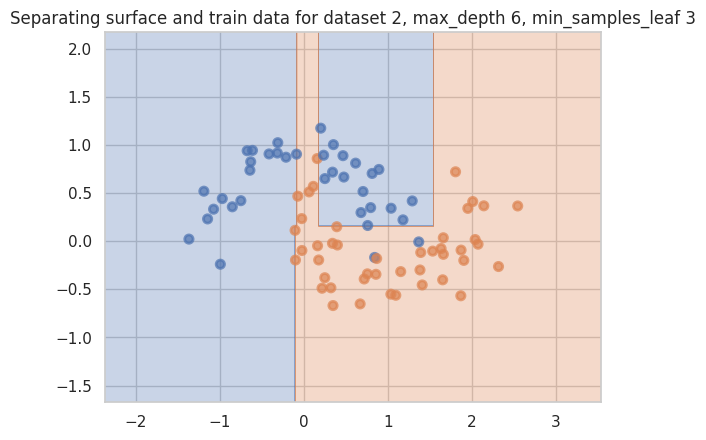

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 3: 0.95


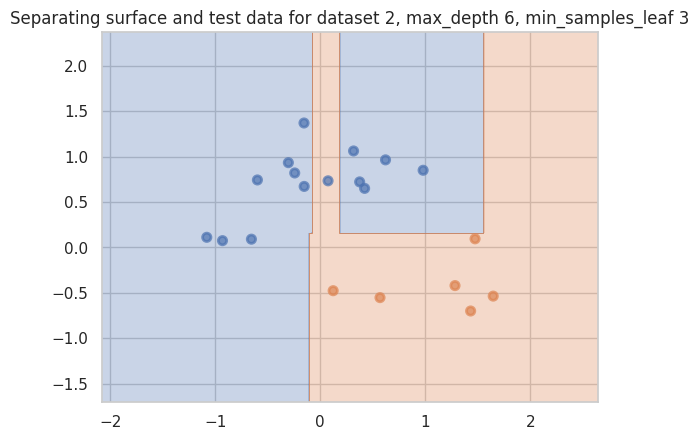

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 4: 0.95


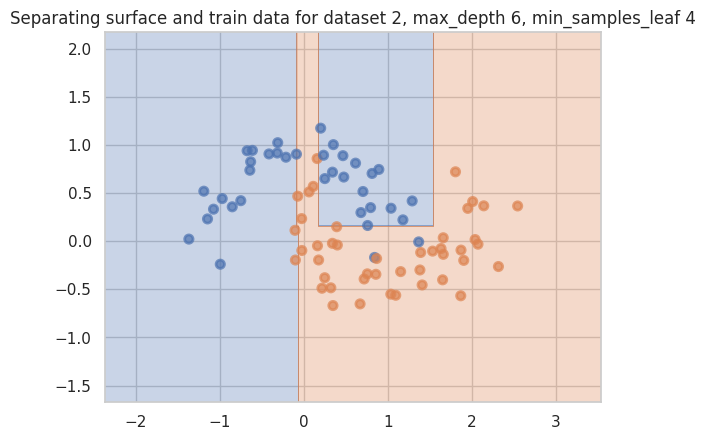

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 4: 0.95


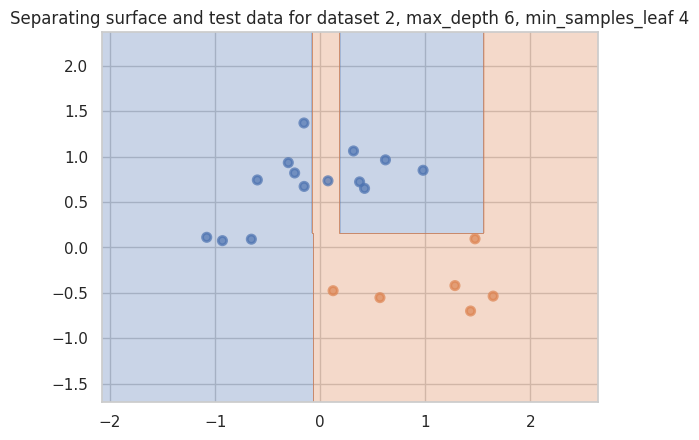

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 5: 0.95


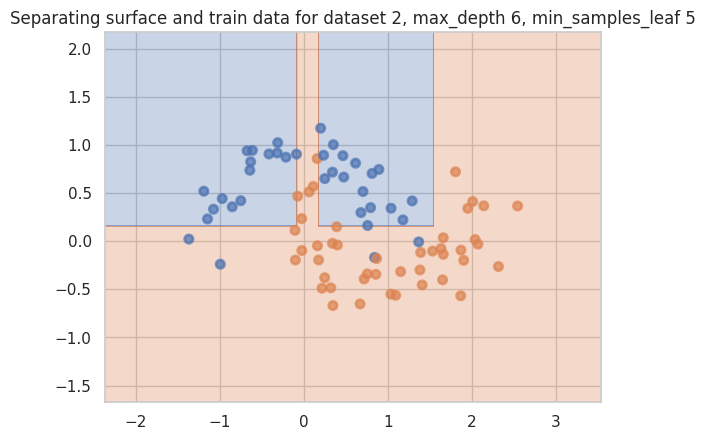

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 5: 0.80


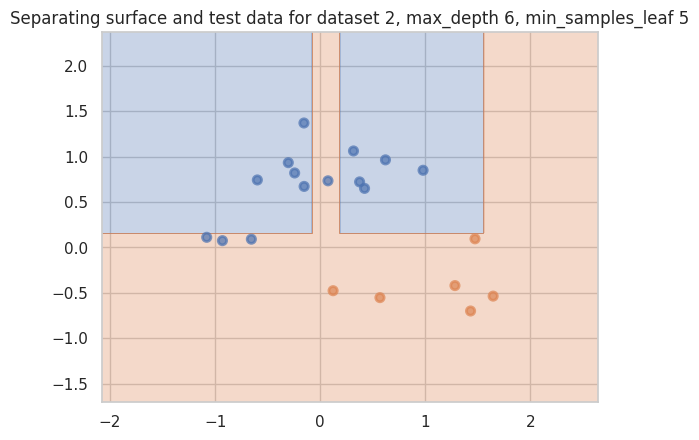

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 6: 0.93


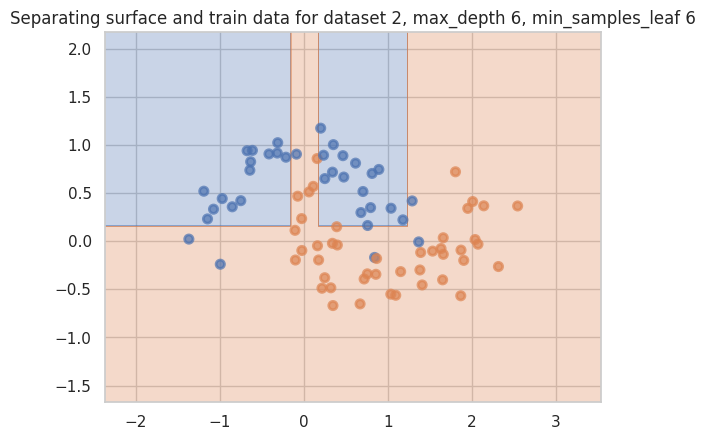

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 6: 0.80


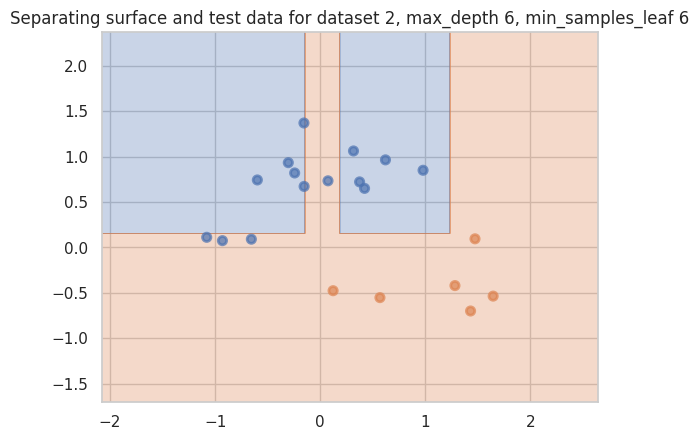

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 7: 0.90


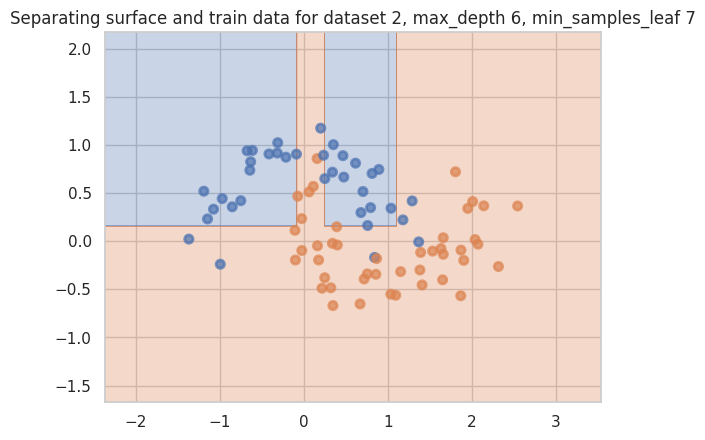

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 7: 0.80


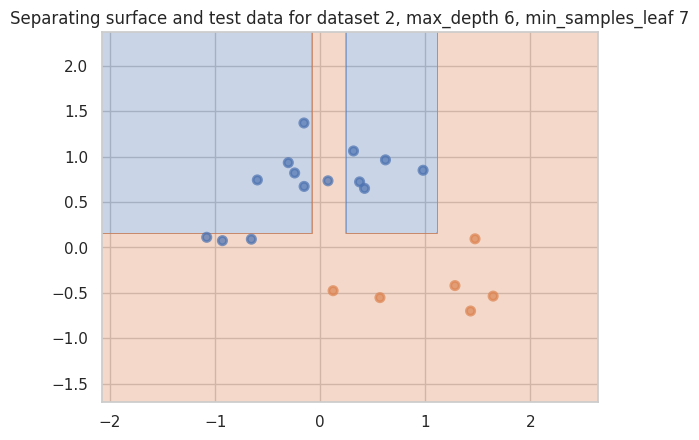

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 8: 0.88


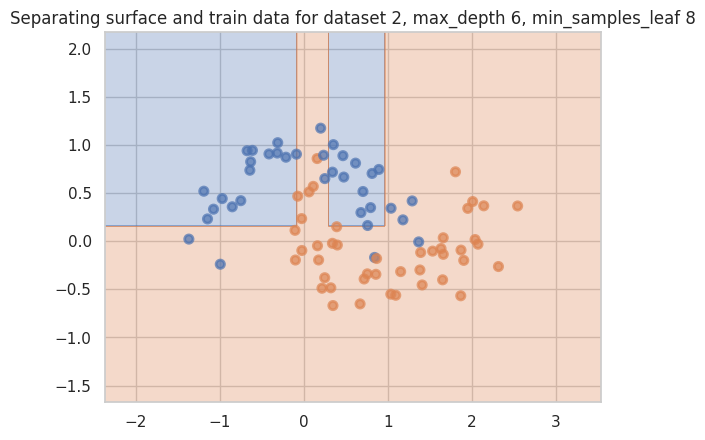

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 8: 0.75


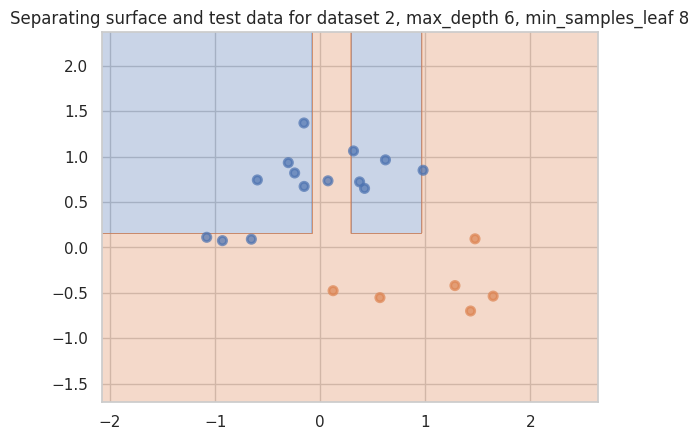

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 9: 0.84


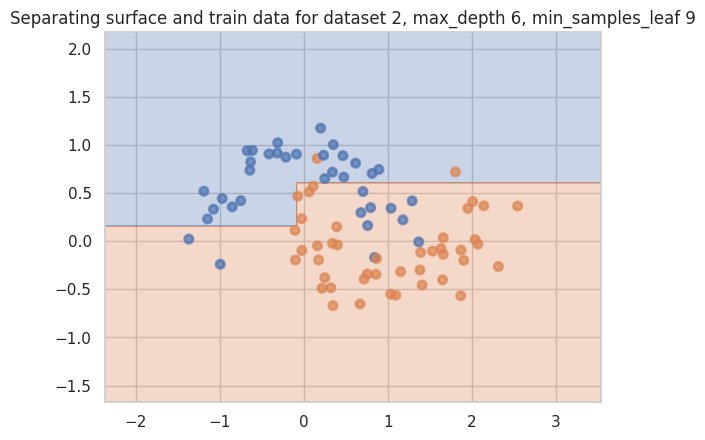

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 9: 0.85


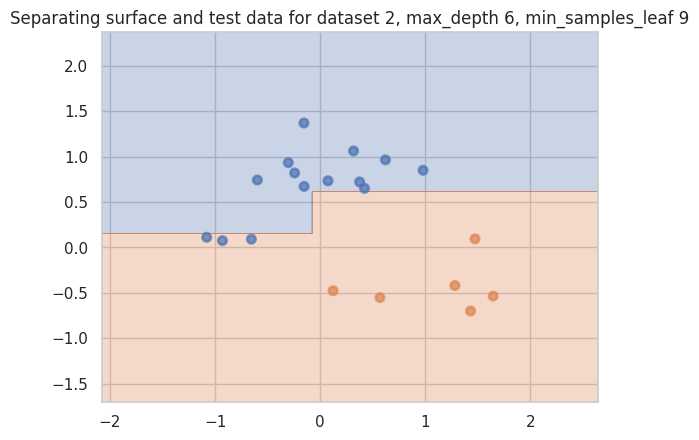

Accuracy on train for dataset 2, max_depth 6, min_samples_leaf 10: 0.84


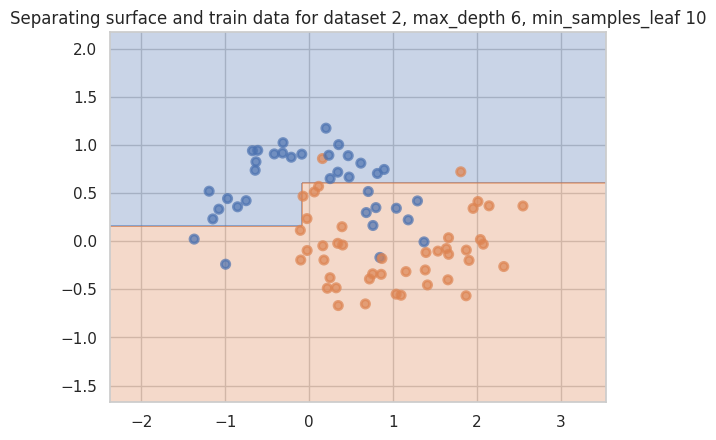

Accuracy on test for dataset 2, max_depth 6, min_samples_leaf 10: 0.85


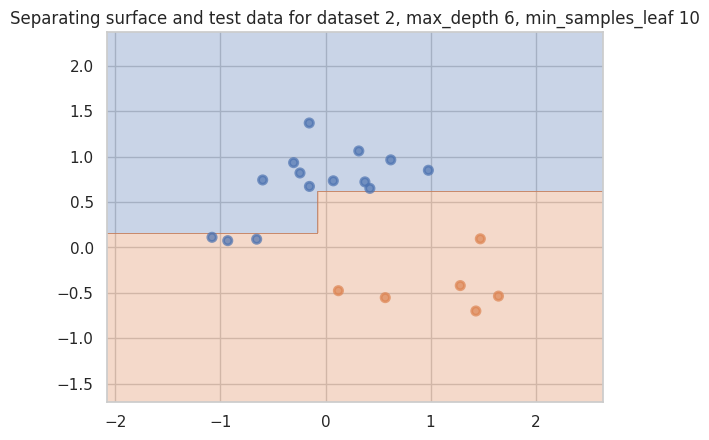

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 1: 1.00


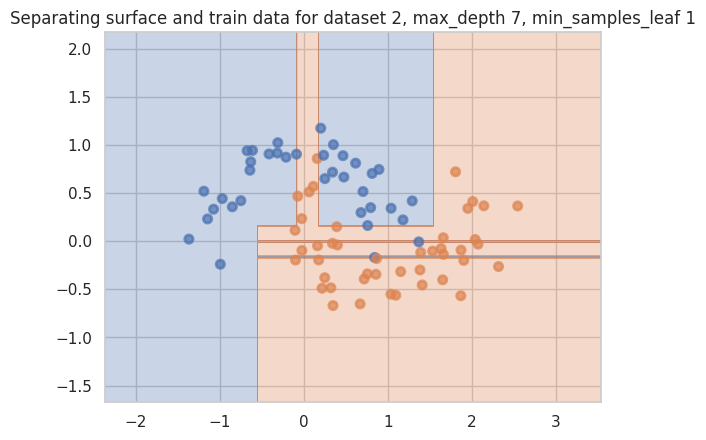

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 1: 0.95


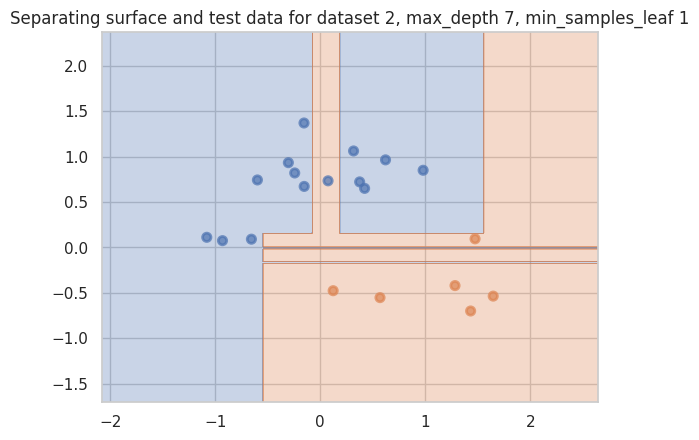

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 2: 0.97


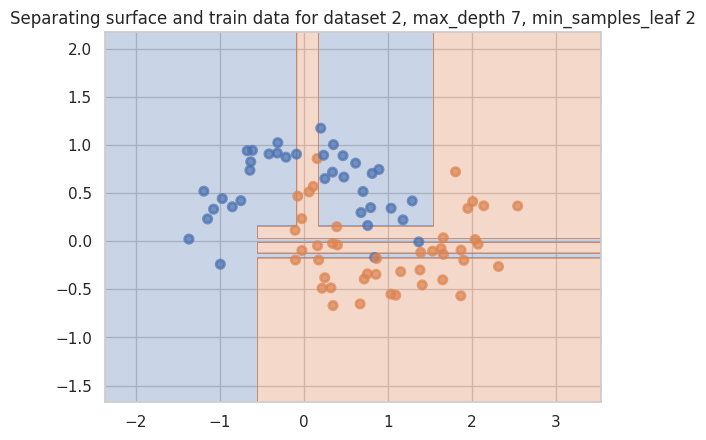

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 2: 0.95


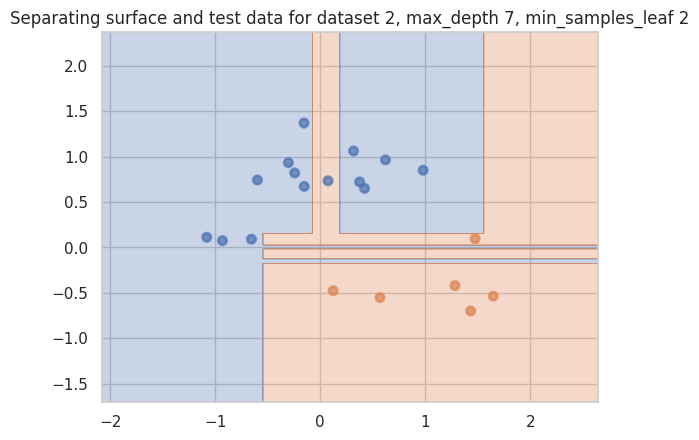

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 3: 0.96


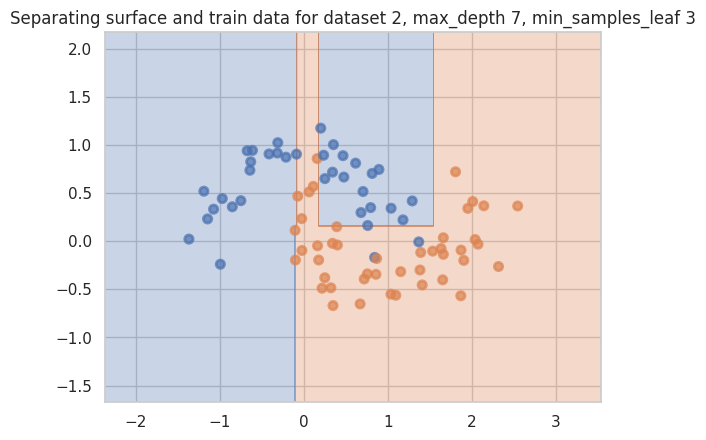

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 3: 0.95


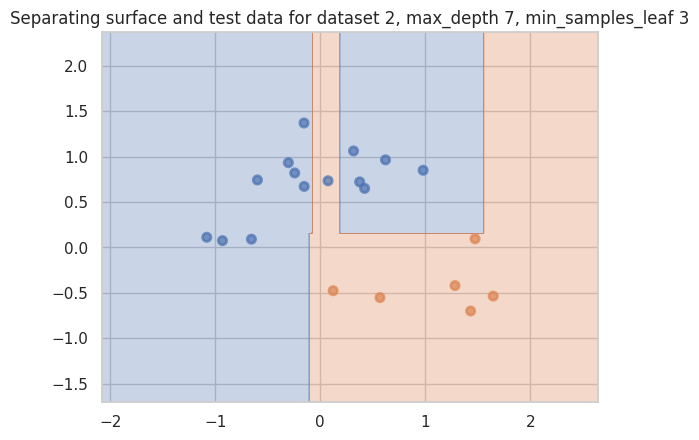

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 4: 0.95


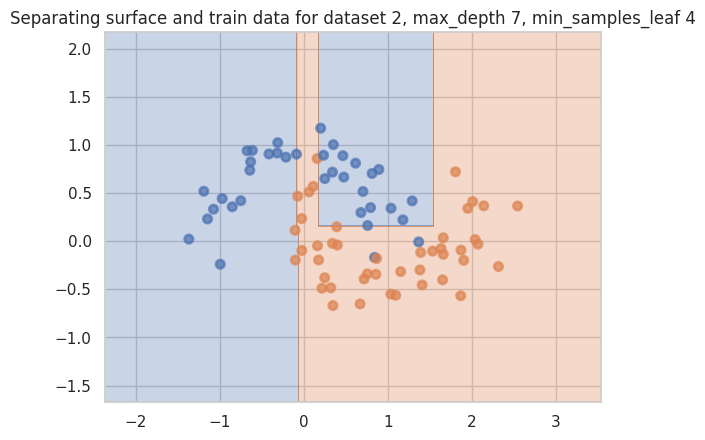

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 4: 0.95


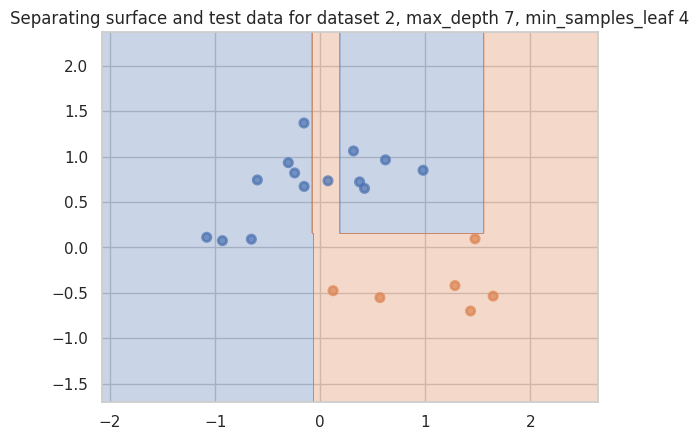

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 5: 0.95


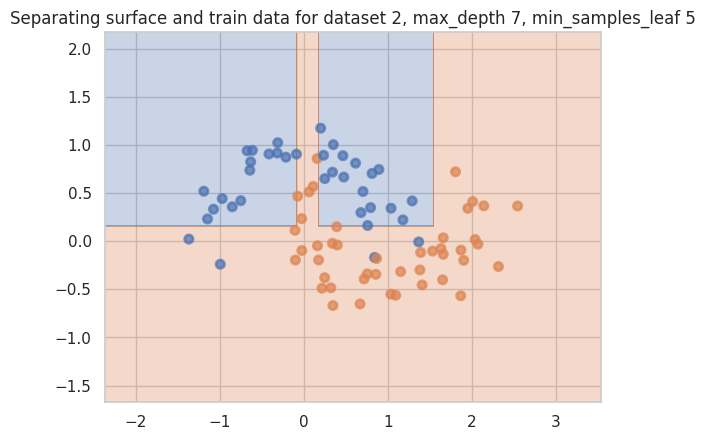

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 5: 0.80


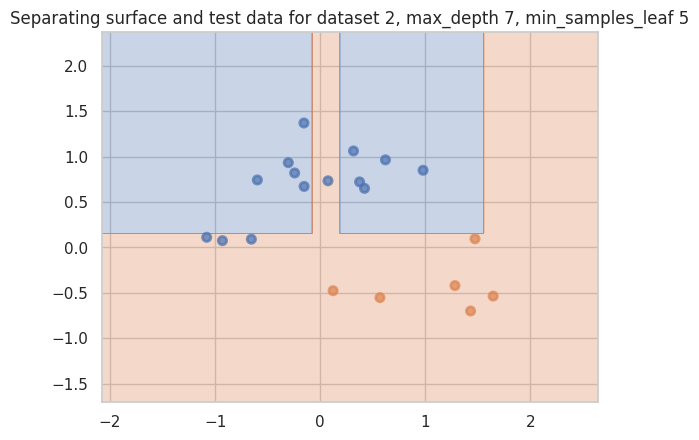

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 6: 0.93


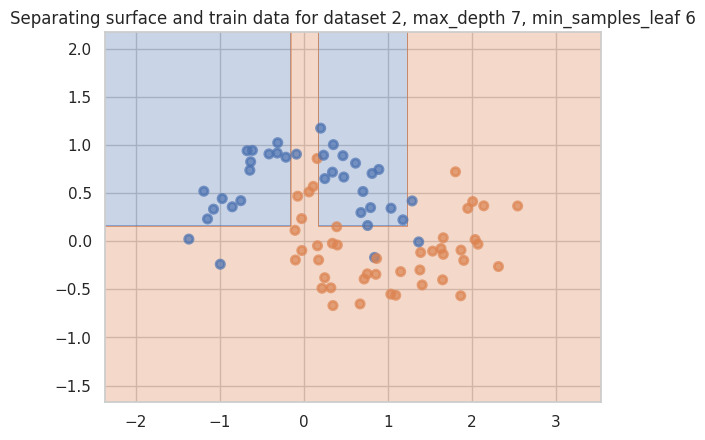

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 6: 0.80


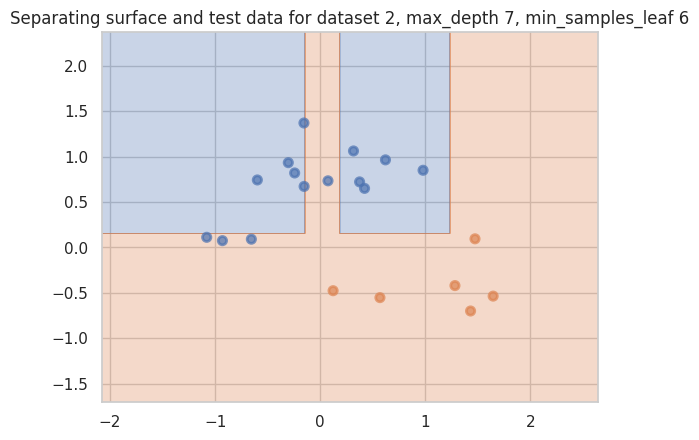

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 7: 0.90


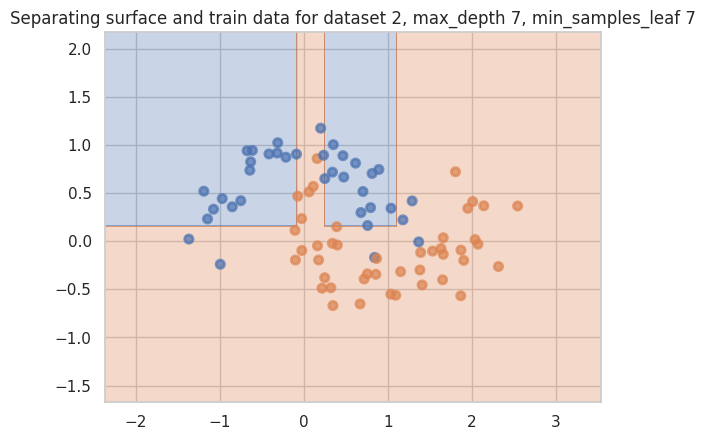

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 7: 0.80


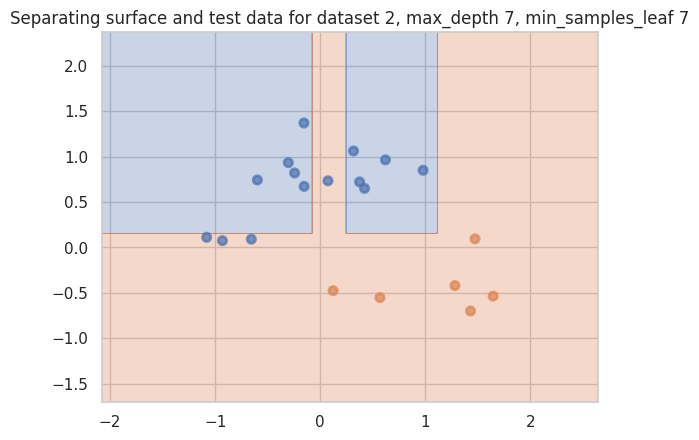

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 8: 0.88


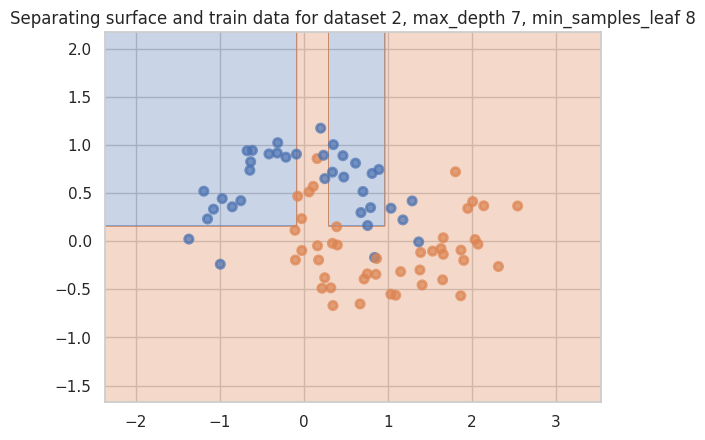

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 8: 0.75


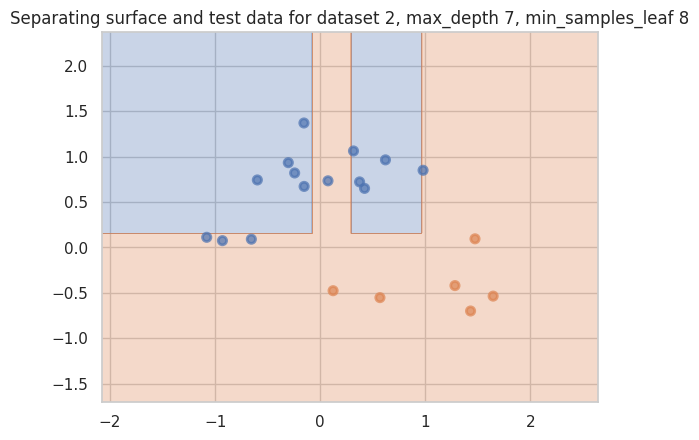

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 9: 0.84


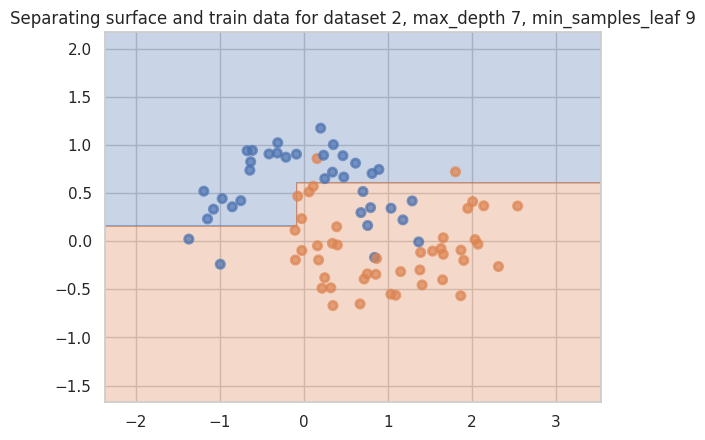

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 9: 0.85


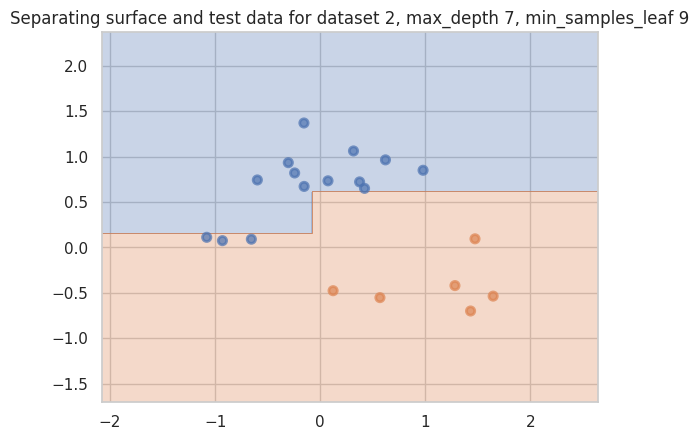

Accuracy on train for dataset 2, max_depth 7, min_samples_leaf 10: 0.84


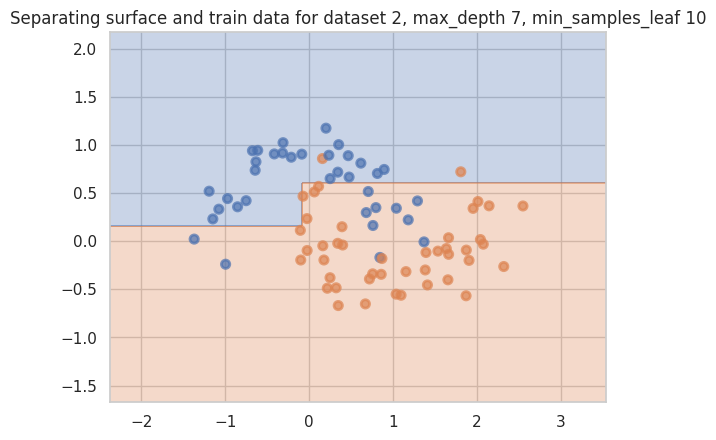

Accuracy on test for dataset 2, max_depth 7, min_samples_leaf 10: 0.85


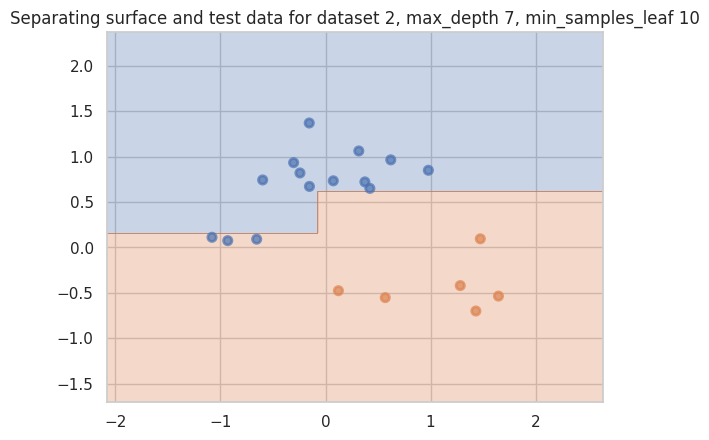

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 1: 1.00


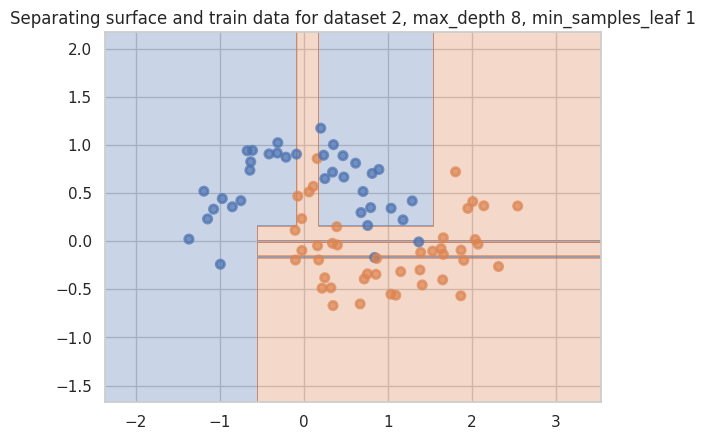

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 1: 0.95


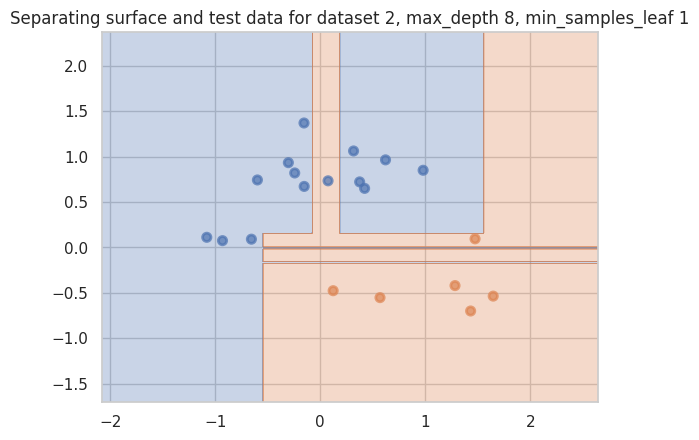

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 2: 0.97


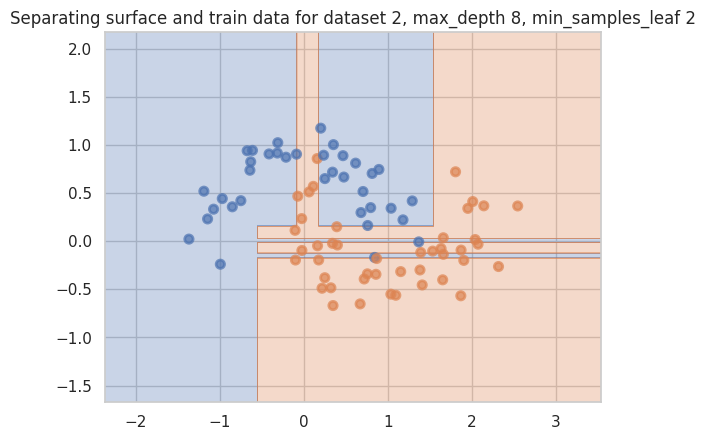

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 2: 0.95


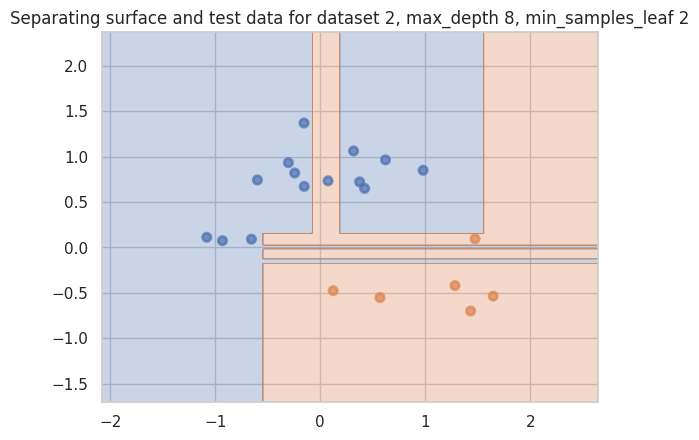

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 3: 0.96


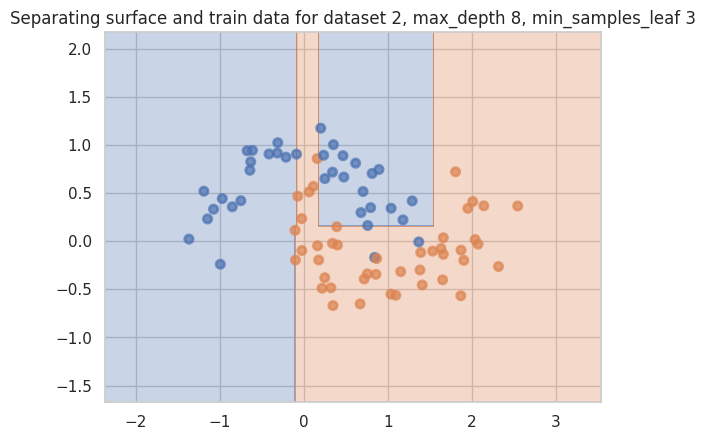

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 3: 0.95


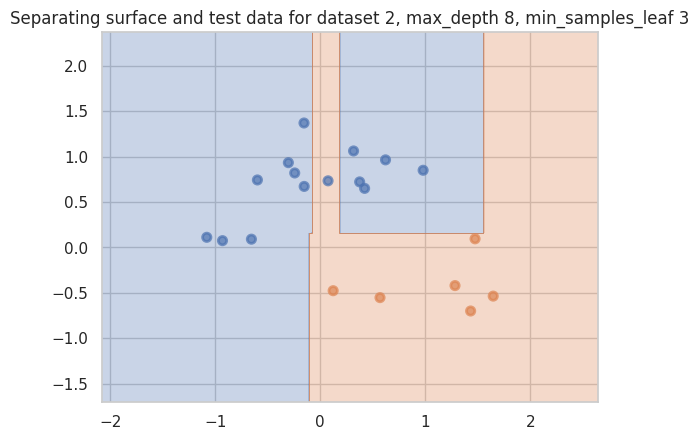

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 4: 0.95


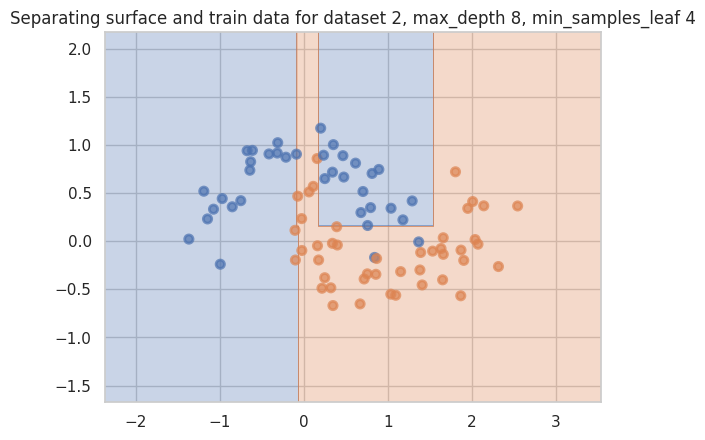

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 4: 0.95


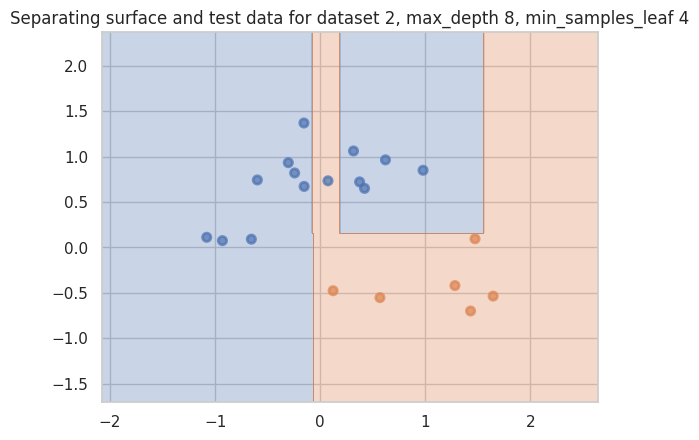

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 5: 0.95


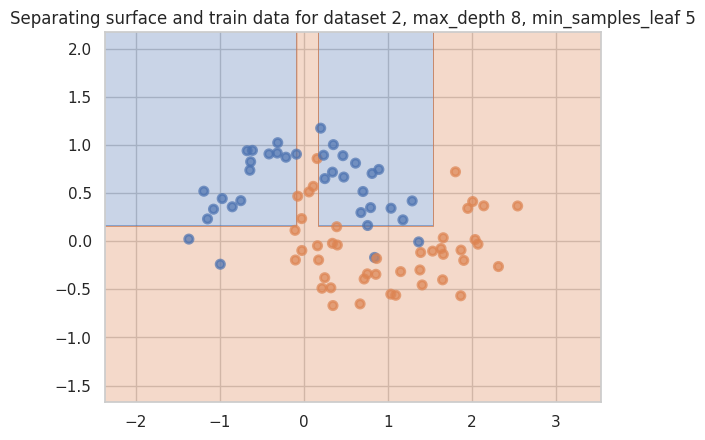

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 5: 0.80


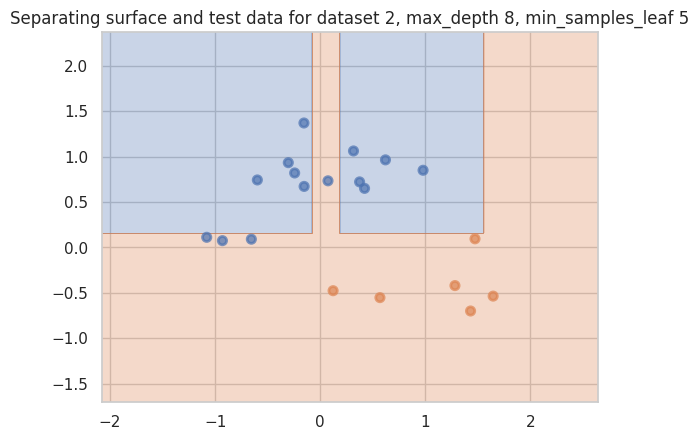

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 6: 0.93


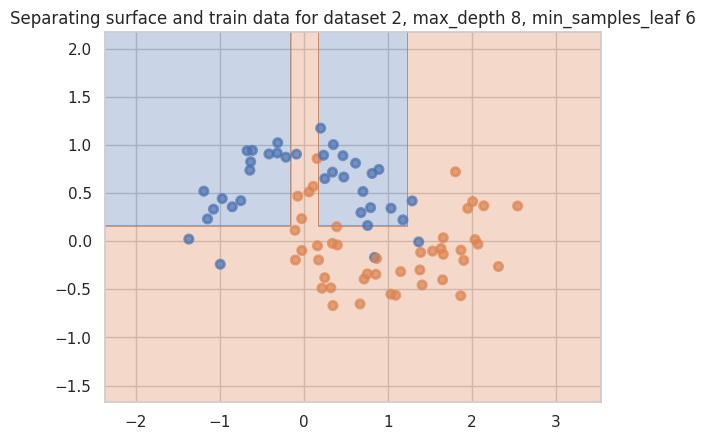

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 6: 0.80


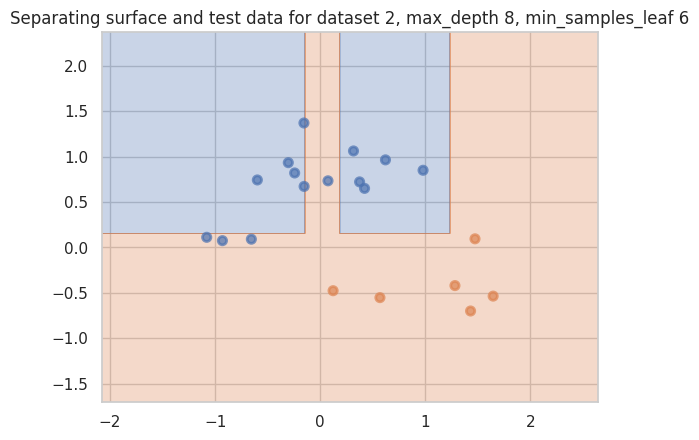

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 7: 0.90


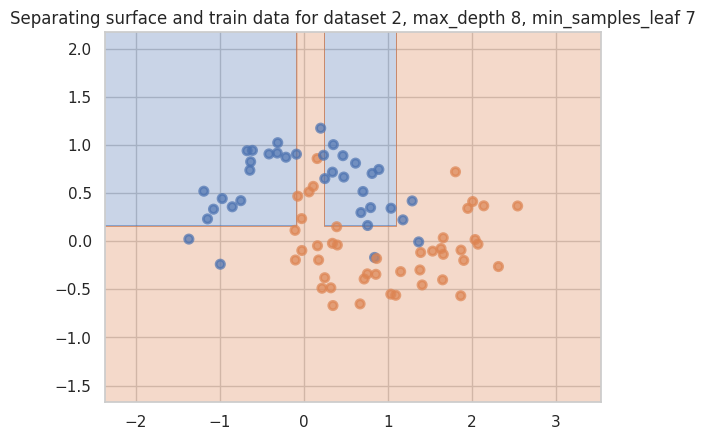

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 7: 0.80


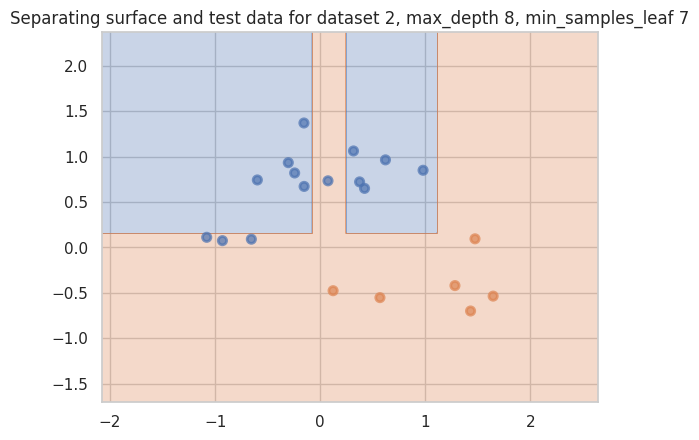

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 8: 0.88


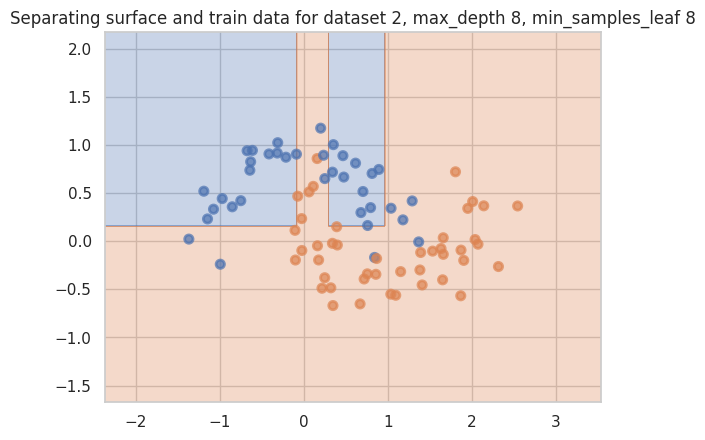

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 8: 0.75


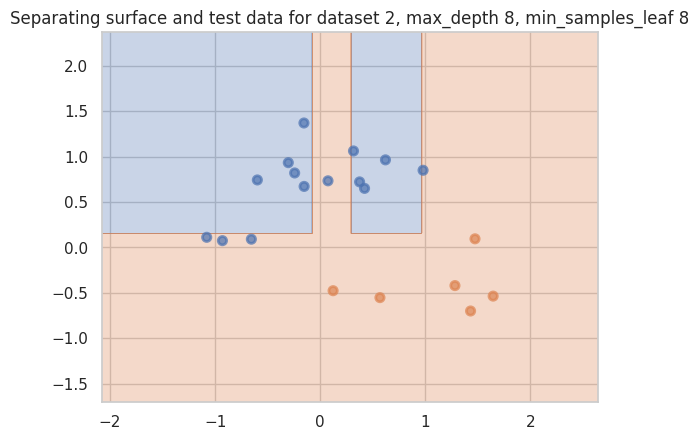

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 9: 0.84


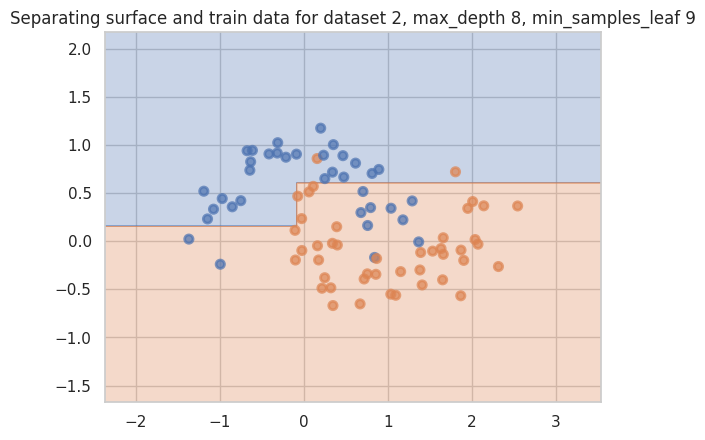

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 9: 0.85


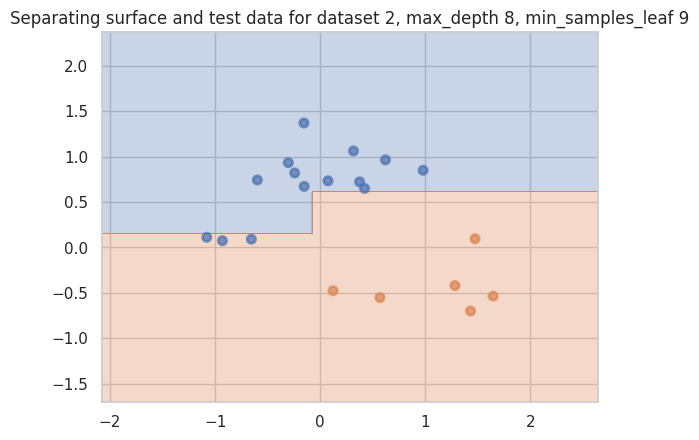

Accuracy on train for dataset 2, max_depth 8, min_samples_leaf 10: 0.84


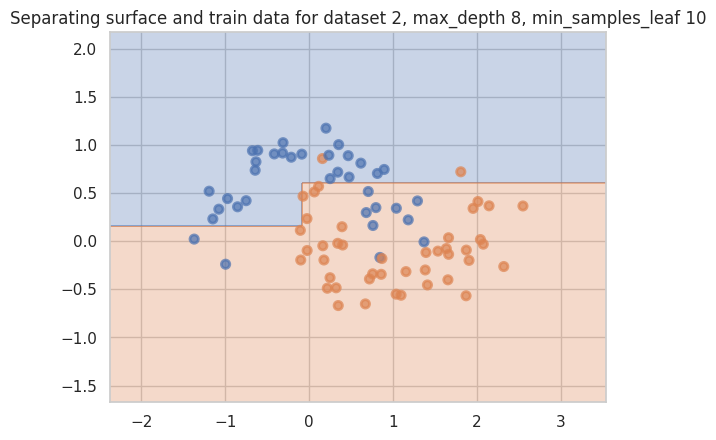

Accuracy on test for dataset 2, max_depth 8, min_samples_leaf 10: 0.85


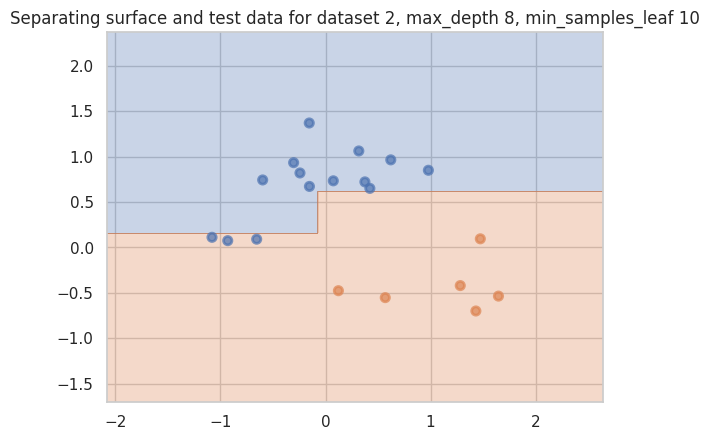

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 1: 1.00


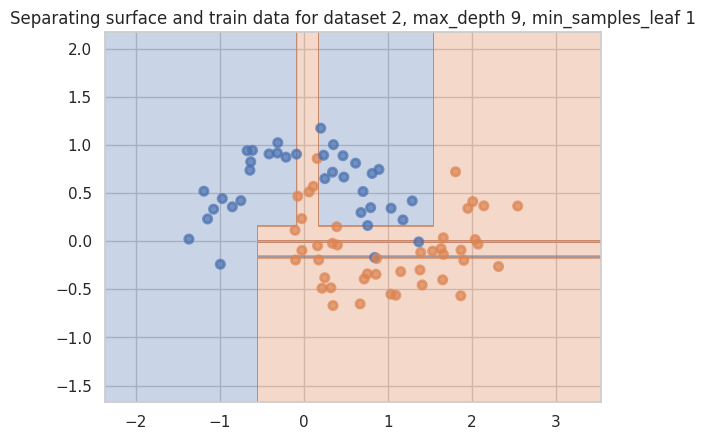

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 1: 0.95


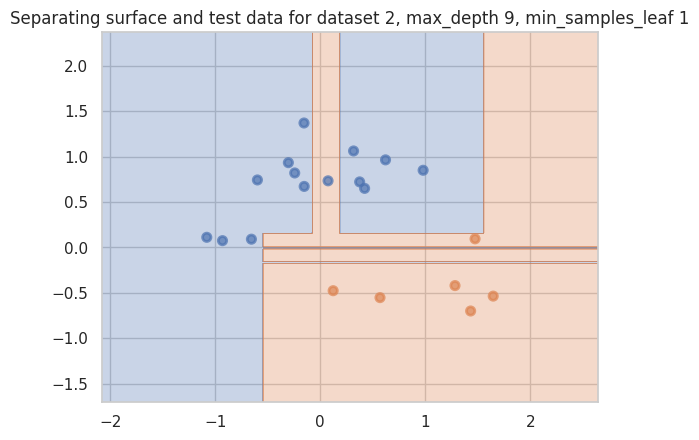

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 2: 0.97


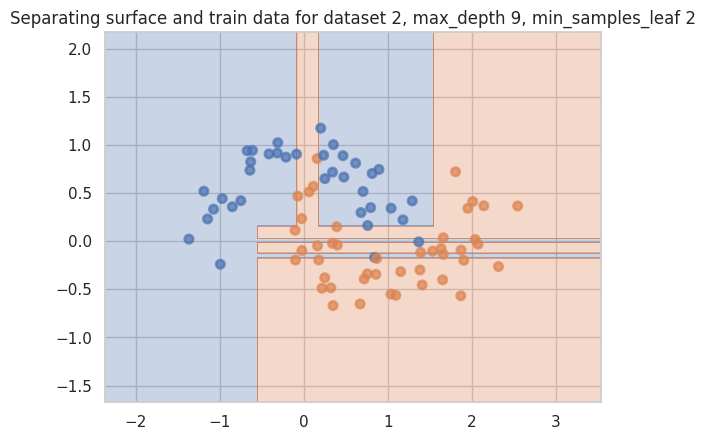

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 2: 0.95


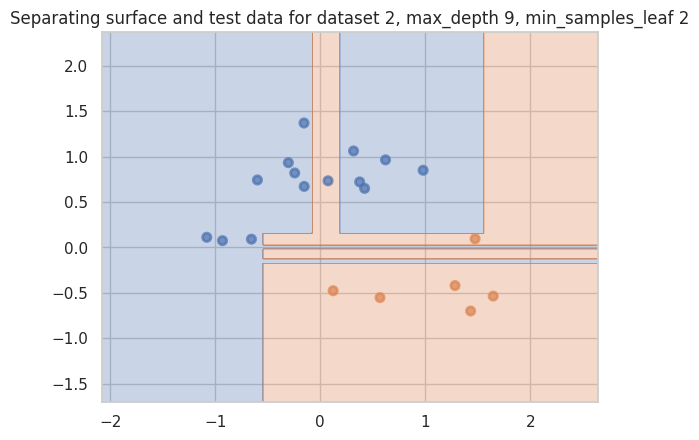

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 3: 0.96


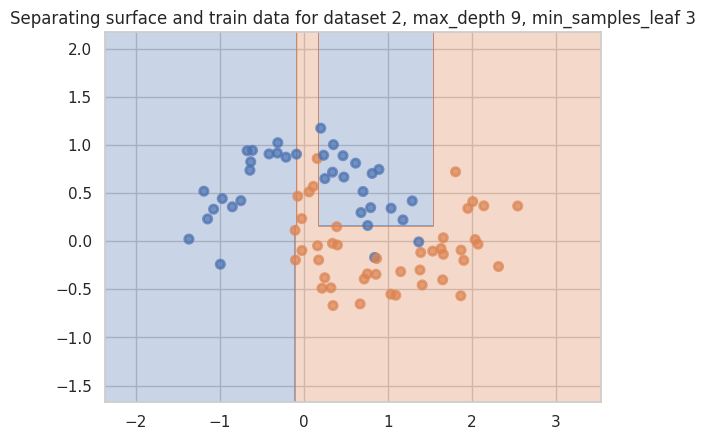

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 3: 0.95


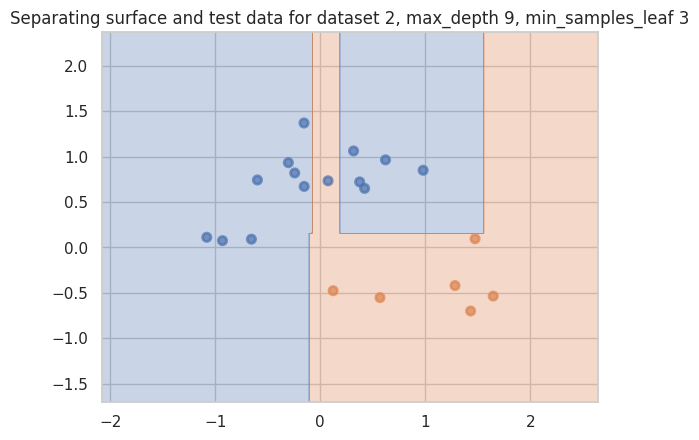

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 4: 0.95


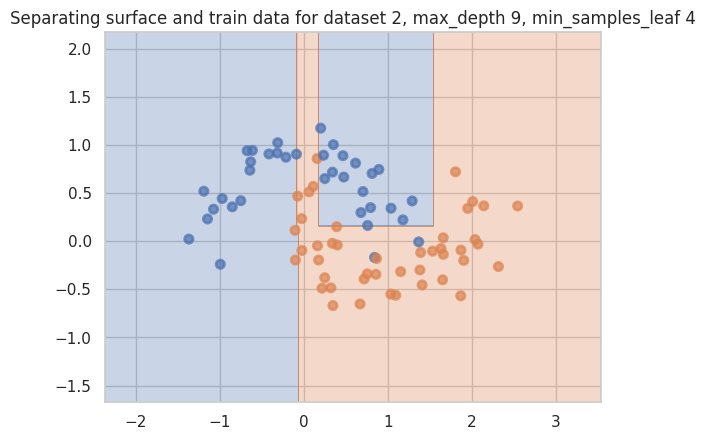

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 4: 0.95


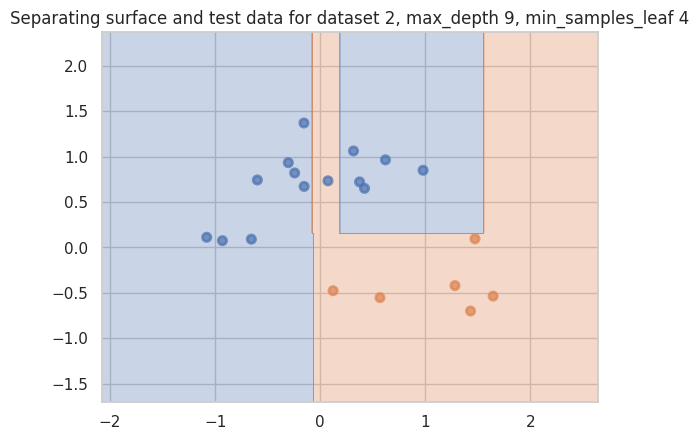

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 5: 0.95


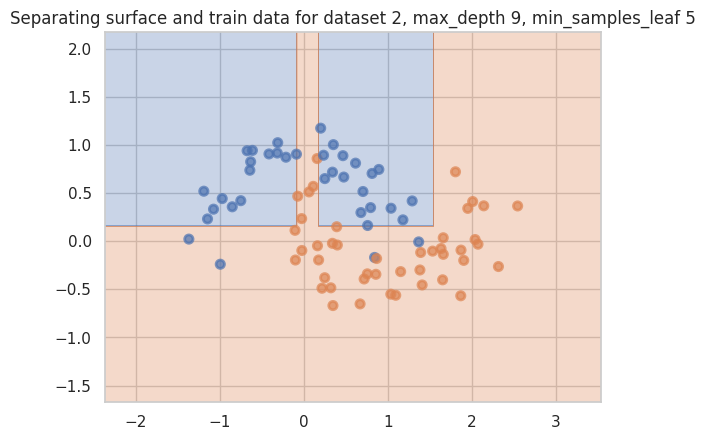

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 5: 0.80


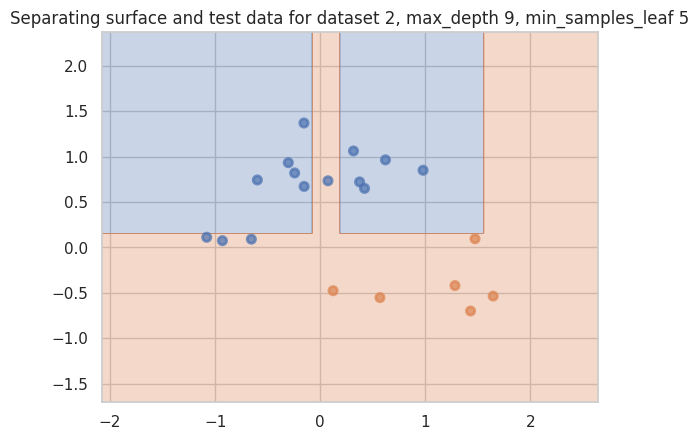

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 6: 0.93


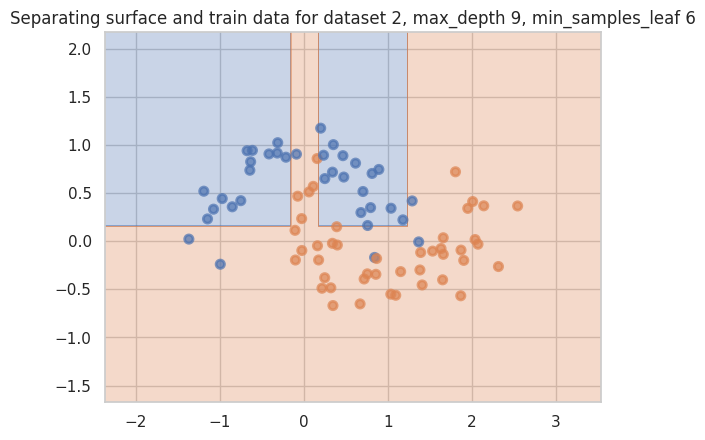

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 6: 0.80


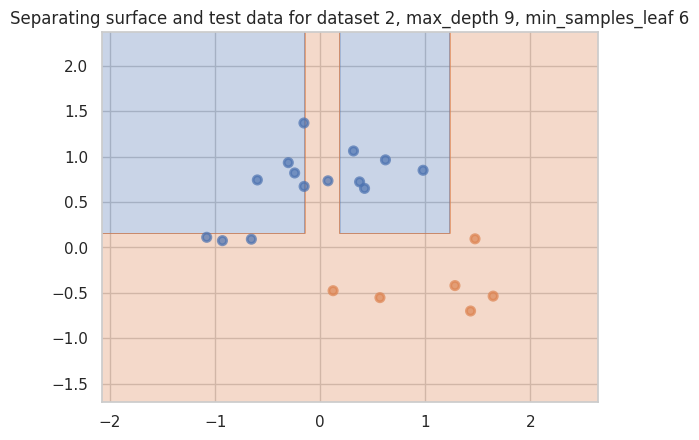

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 7: 0.90


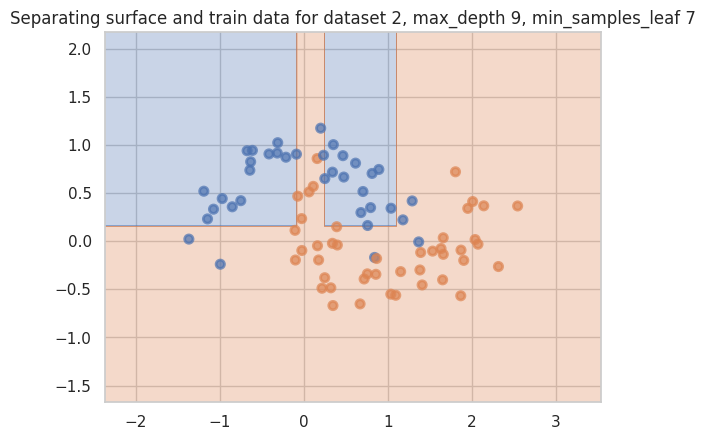

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 7: 0.80


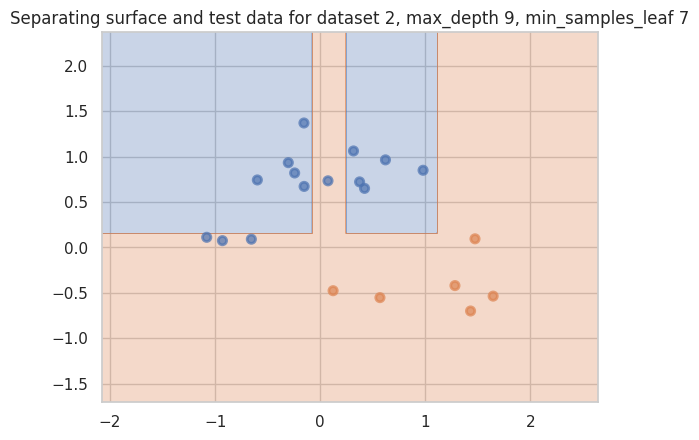

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 8: 0.88


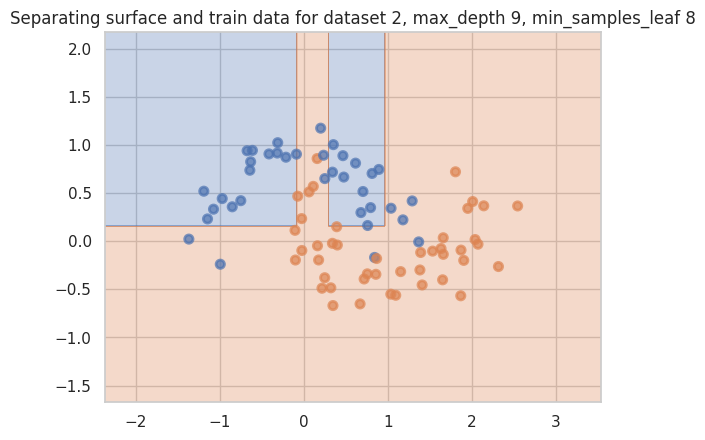

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 8: 0.75


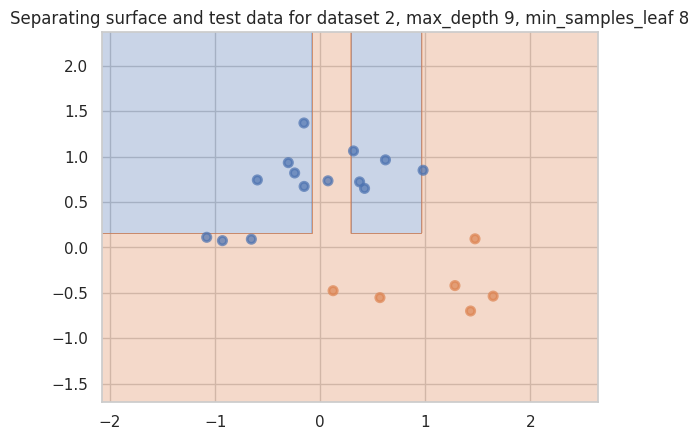

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 9: 0.84


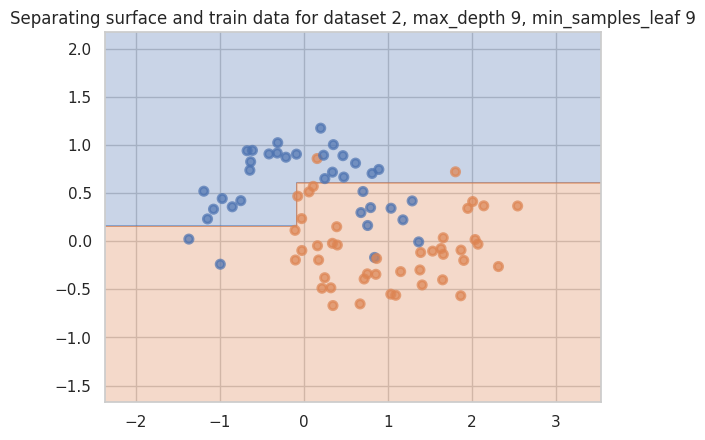

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 9: 0.85


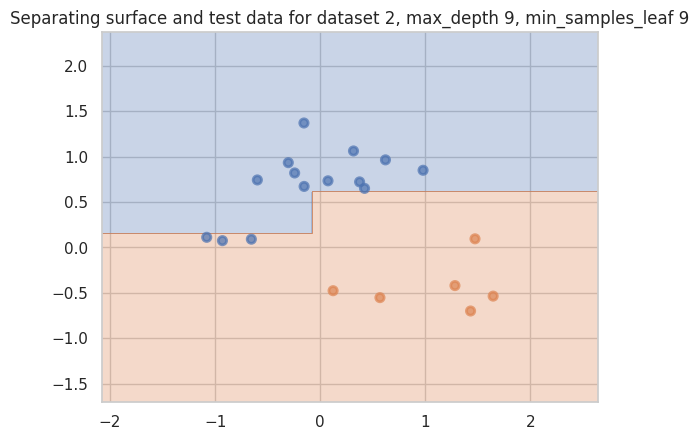

Accuracy on train for dataset 2, max_depth 9, min_samples_leaf 10: 0.84


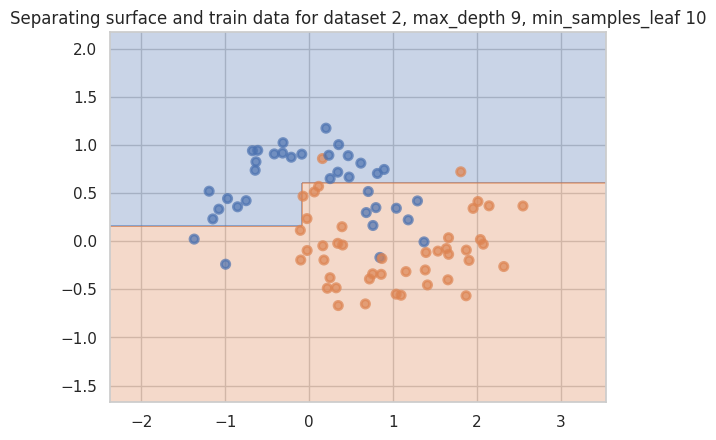

Accuracy on test for dataset 2, max_depth 9, min_samples_leaf 10: 0.85


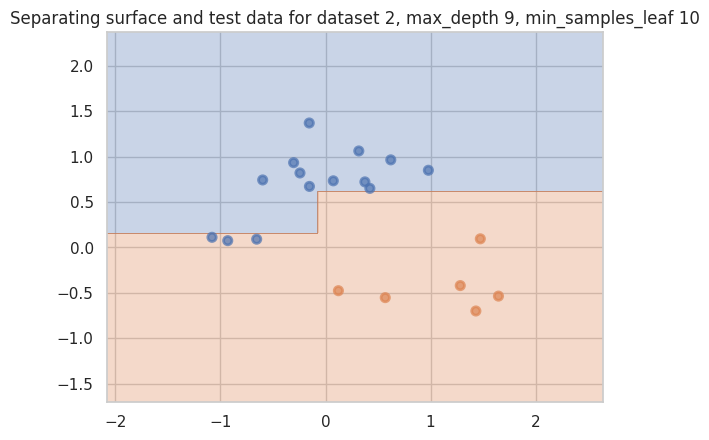

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 1: 1.00


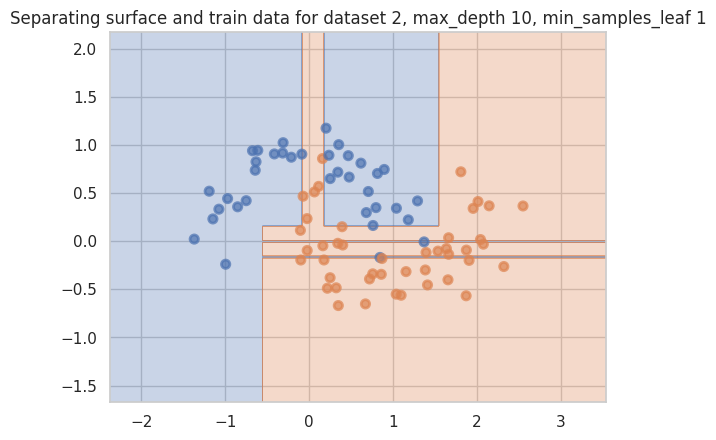

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 1: 0.95


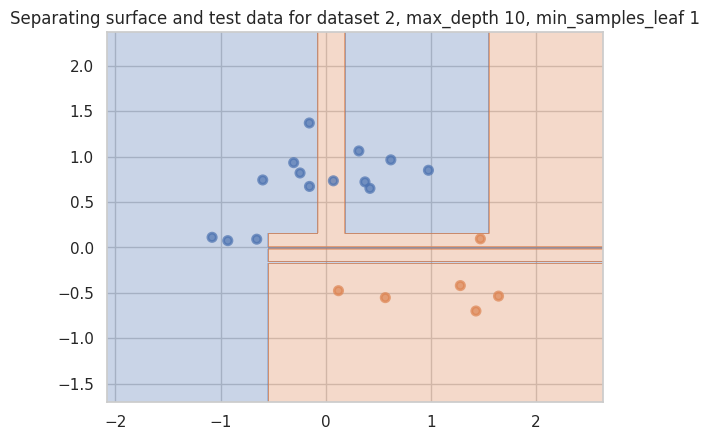

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 2: 0.97


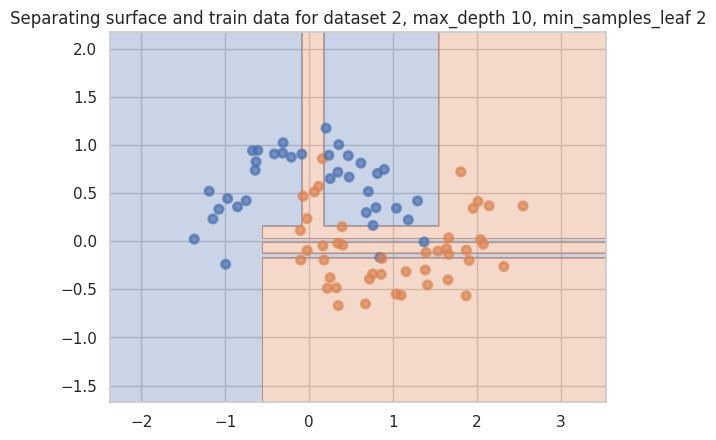

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 2: 0.95


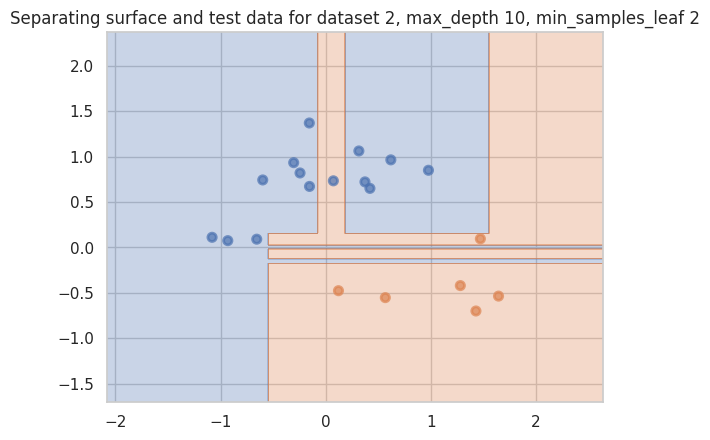

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 3: 0.96


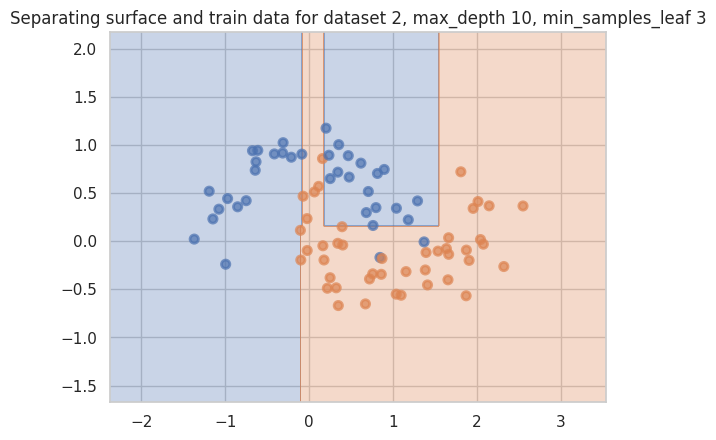

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 3: 0.95


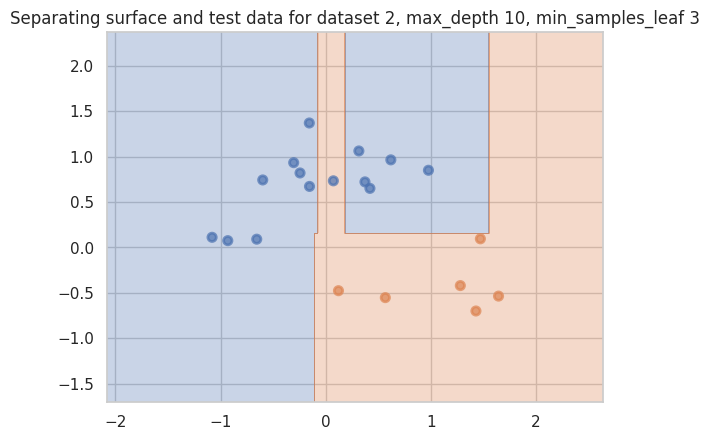

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 4: 0.95


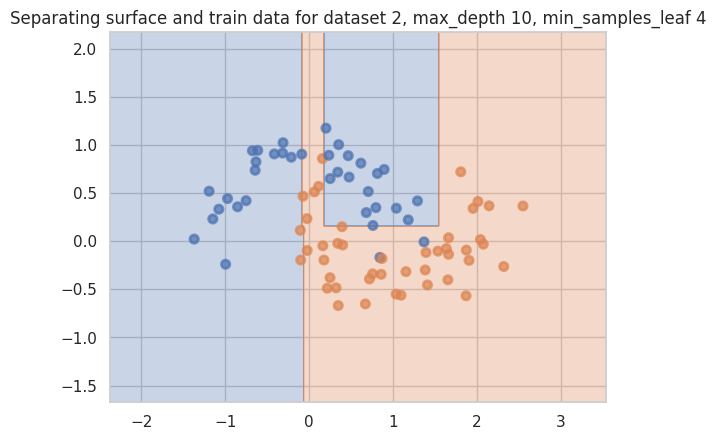

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 4: 0.95


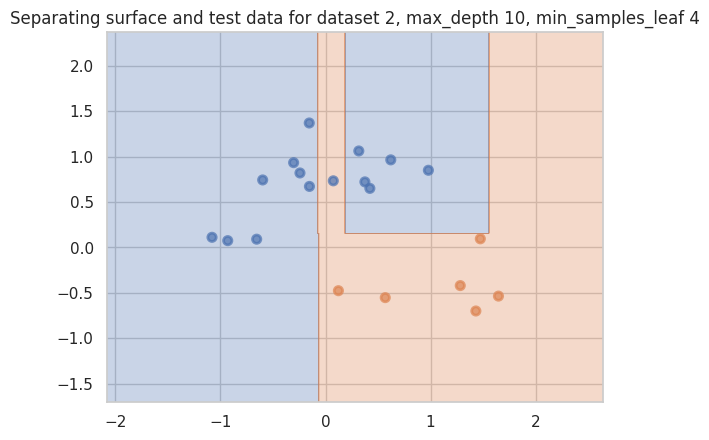

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 5: 0.95


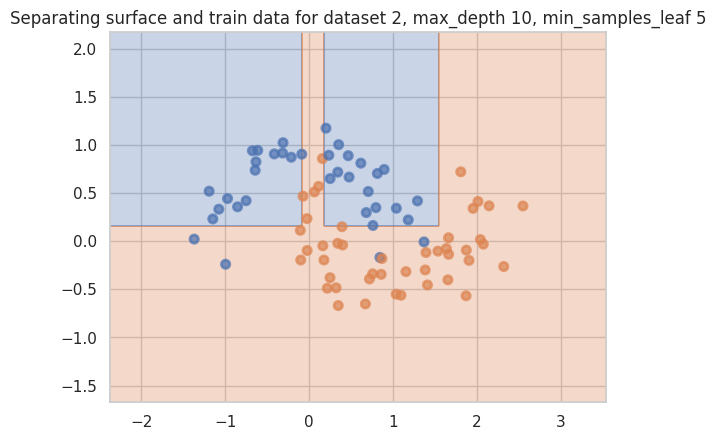

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 5: 0.80


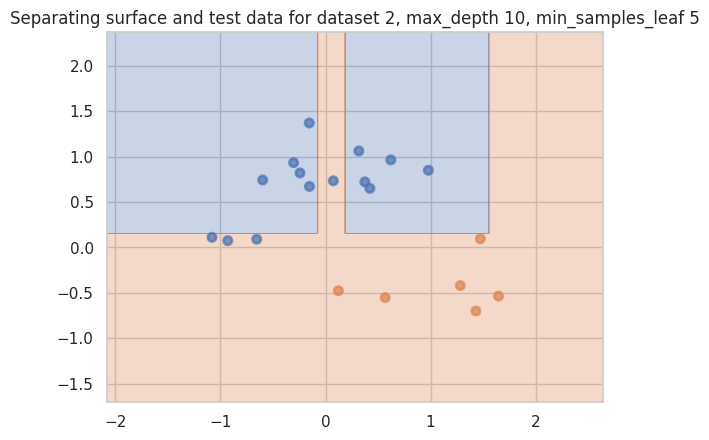

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 6: 0.93


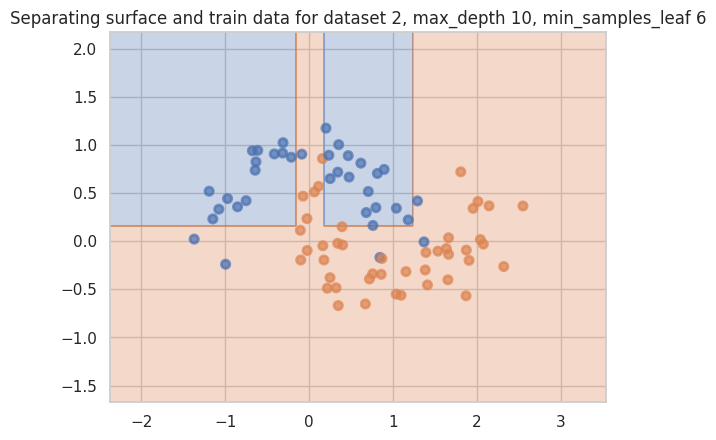

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 6: 0.80


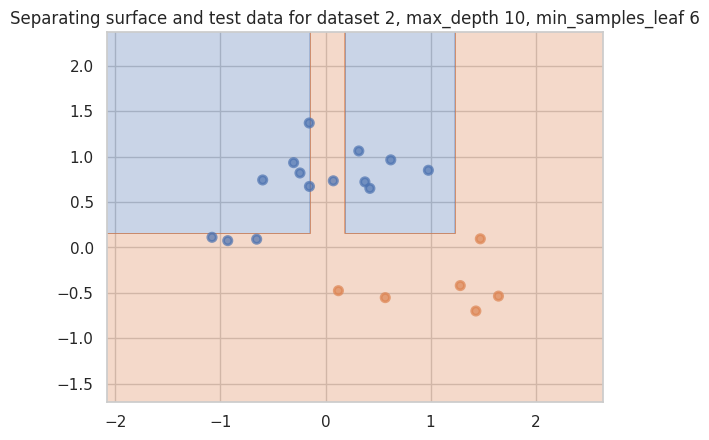

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 7: 0.90


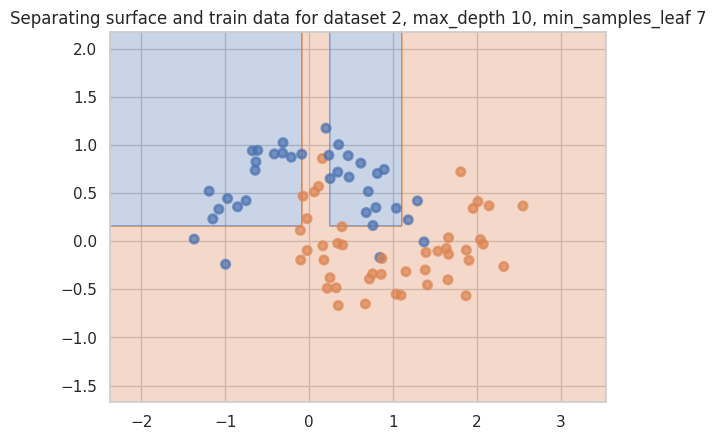

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 7: 0.80


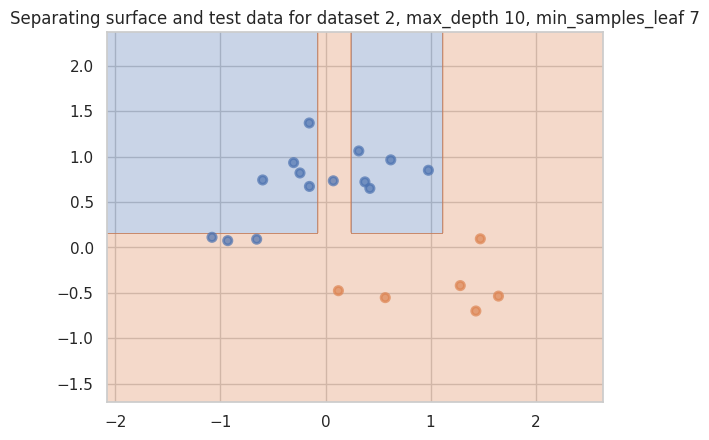

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 8: 0.88


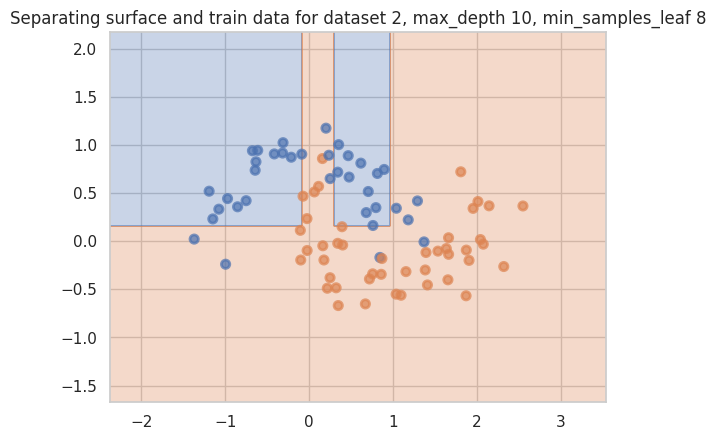

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 8: 0.75


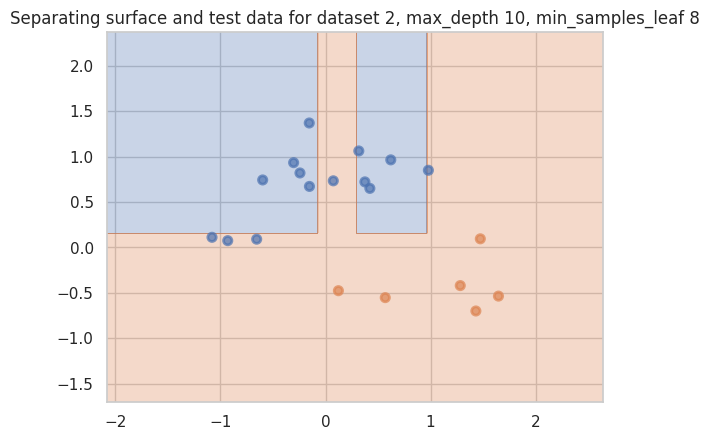

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 9: 0.84


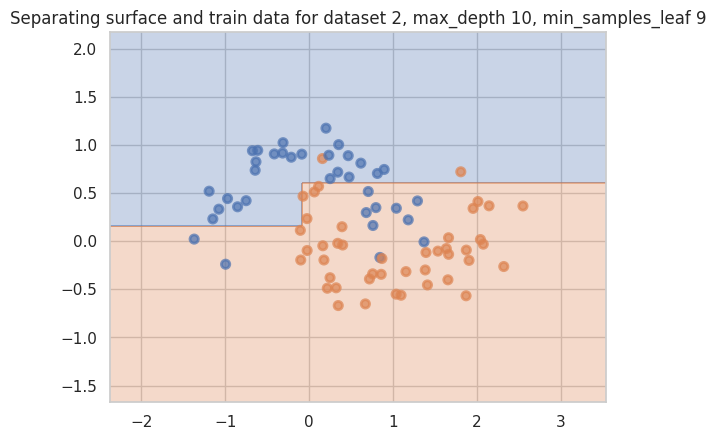

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 9: 0.85


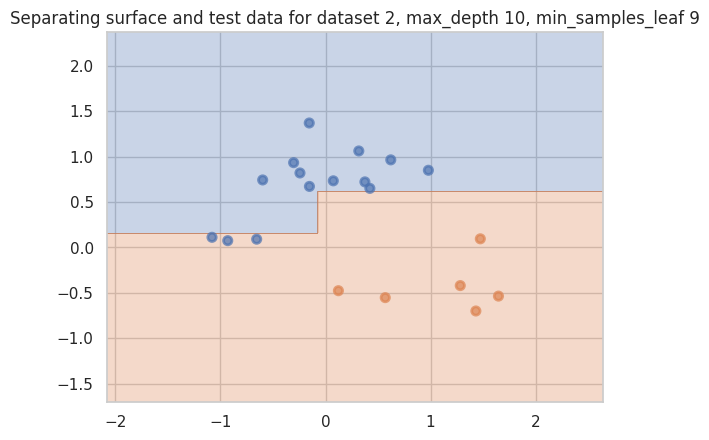

Accuracy on train for dataset 2, max_depth 10, min_samples_leaf 10: 0.84


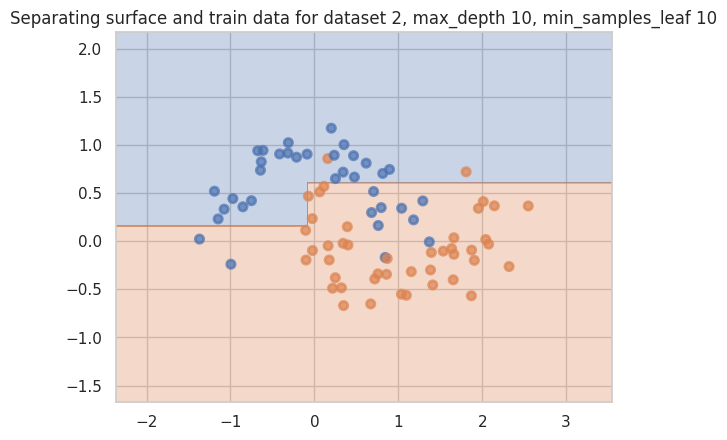

Accuracy on test for dataset 2, max_depth 10, min_samples_leaf 10: 0.85


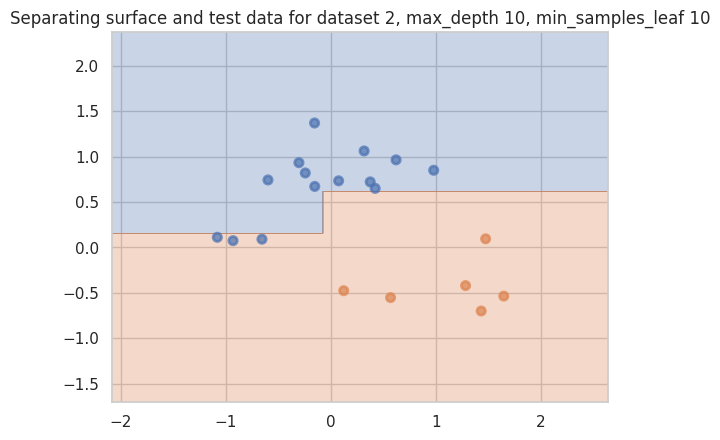

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 1: 0.90


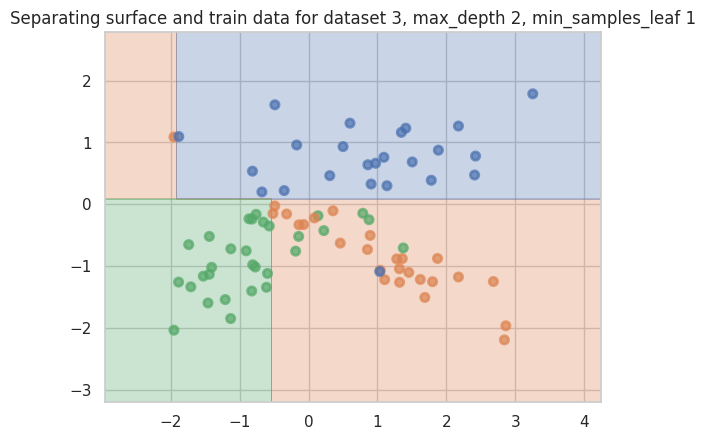

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 1: 0.75


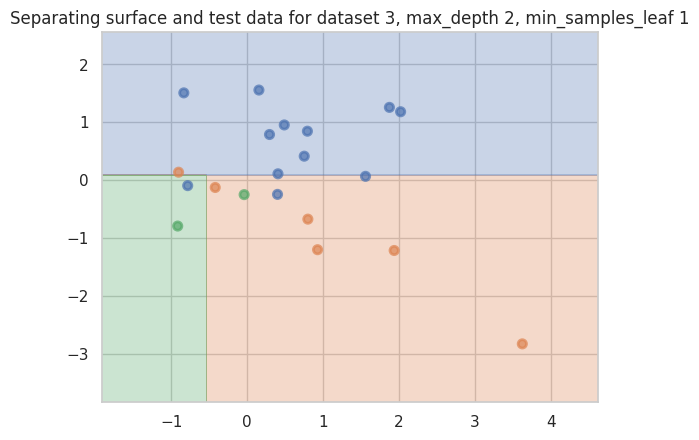

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 2: 0.89


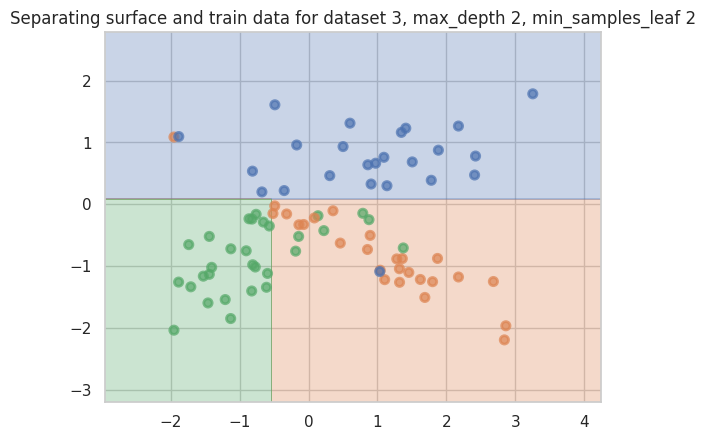

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 2: 0.75


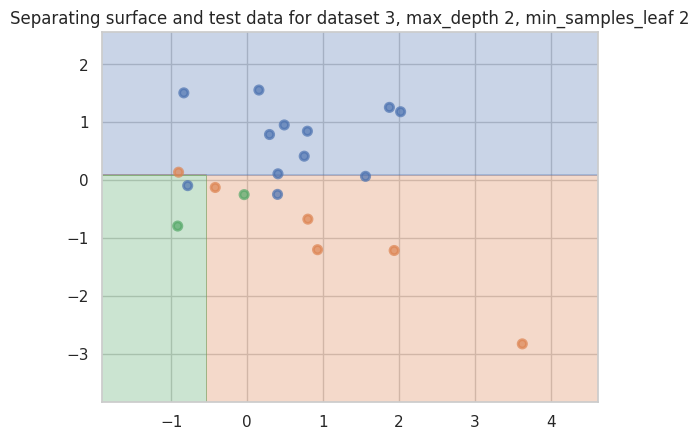

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 3: 0.89


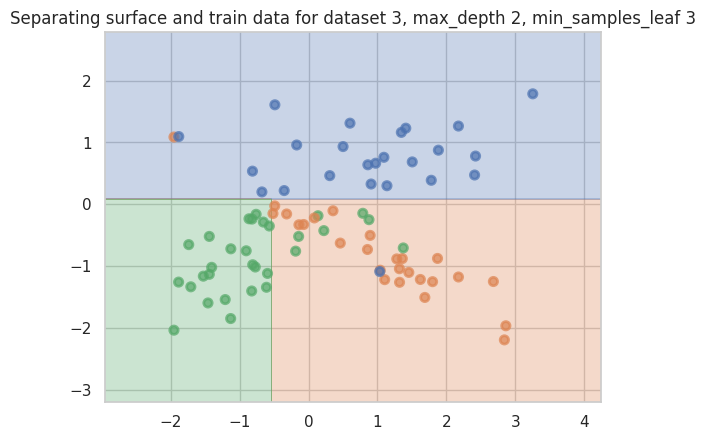

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 3: 0.75


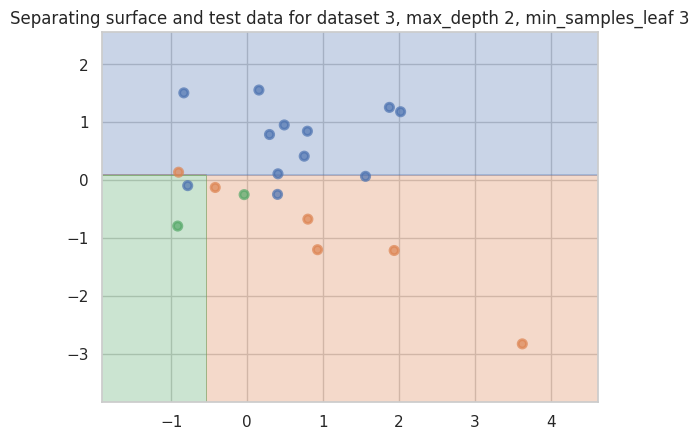

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 4: 0.89


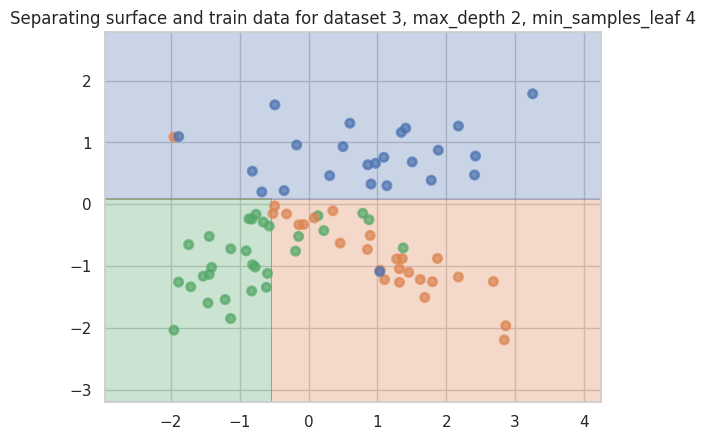

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 4: 0.75


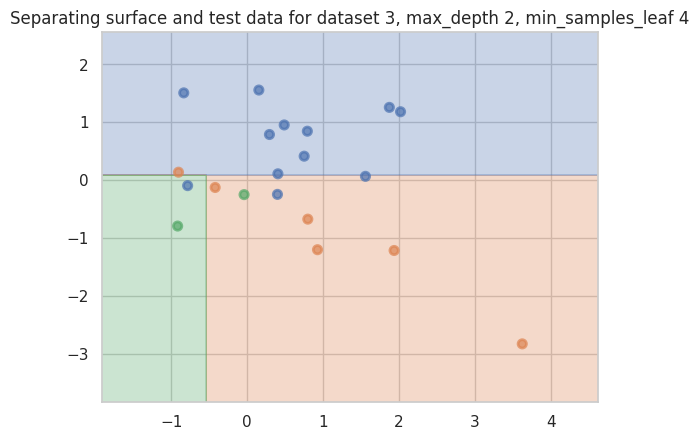

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 5: 0.89


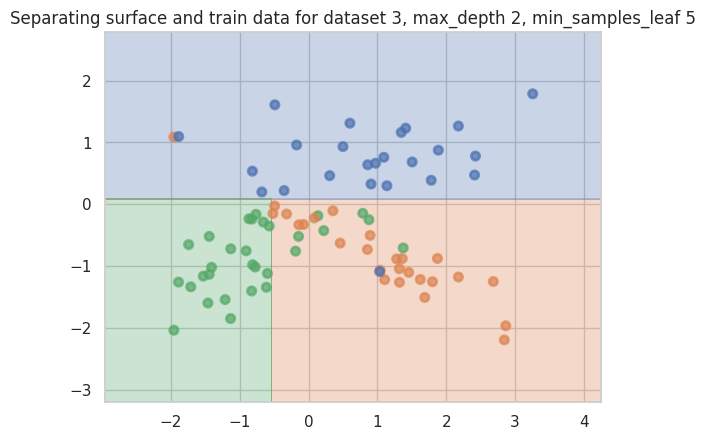

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 5: 0.75


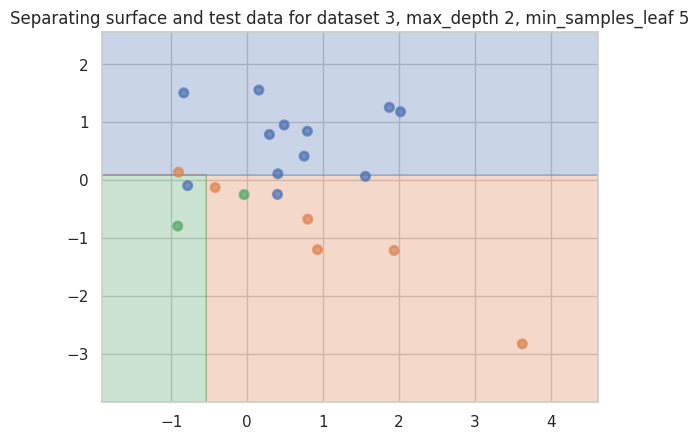

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 6: 0.89


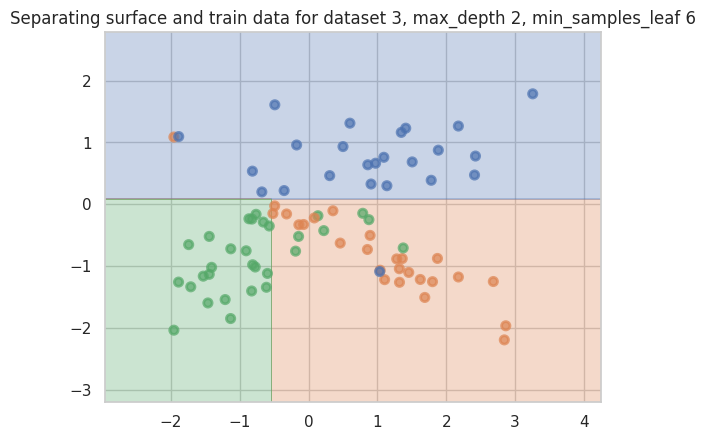

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 6: 0.75


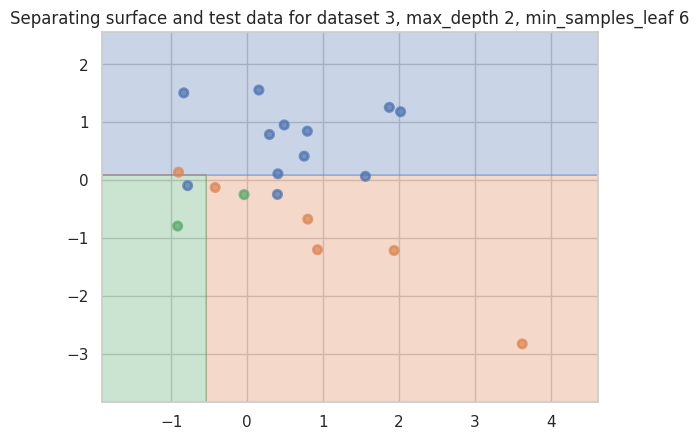

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 7: 0.89


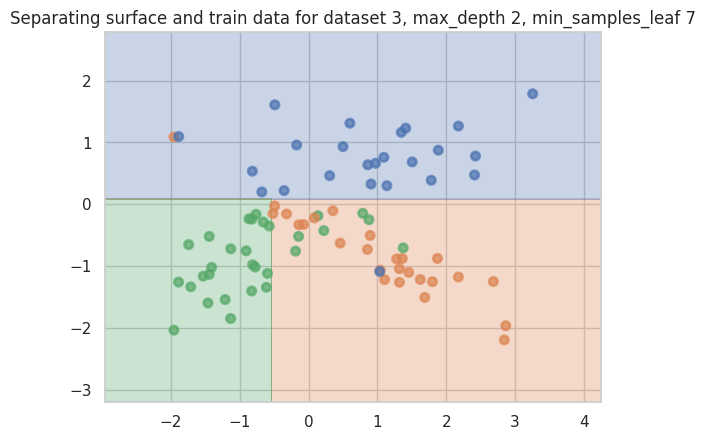

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 7: 0.75


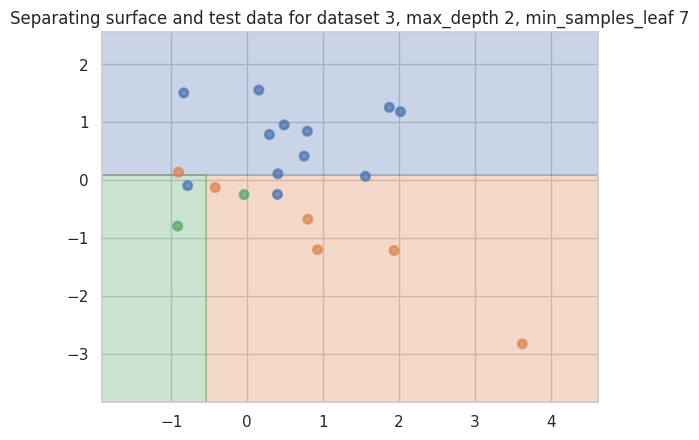

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 8: 0.89


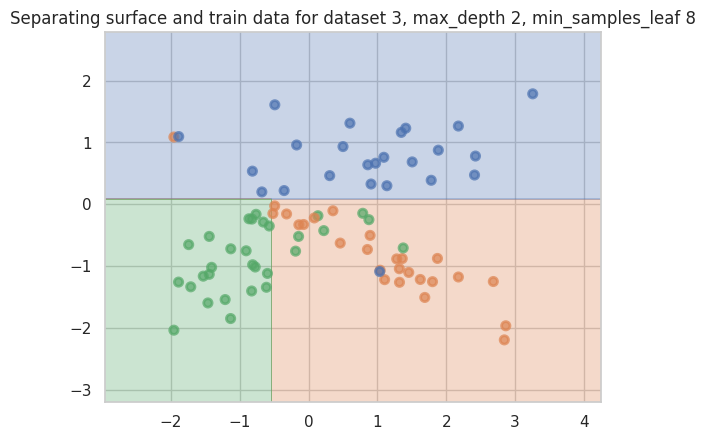

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 8: 0.75


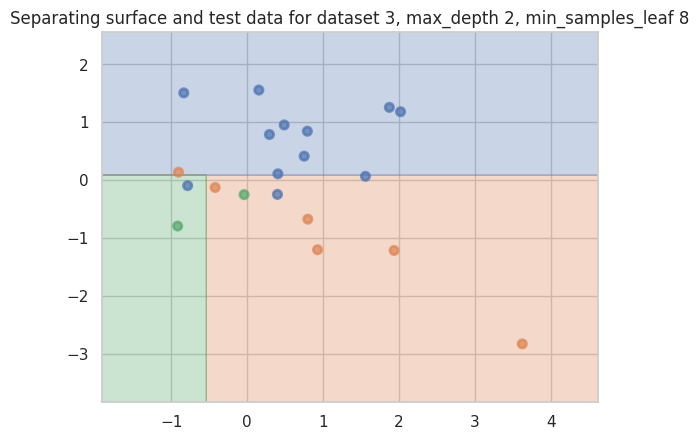

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 9: 0.89


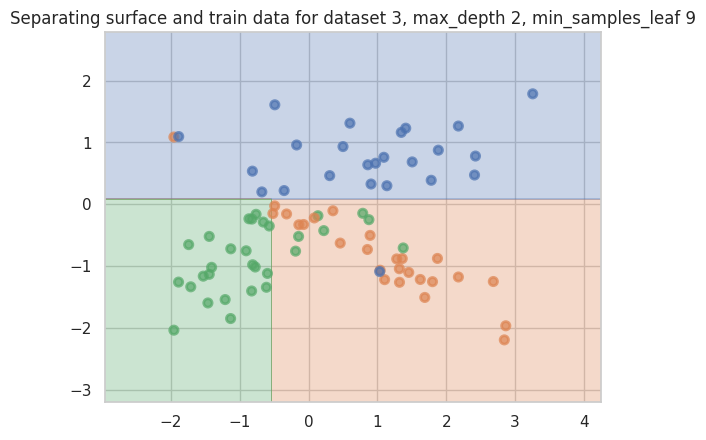

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 9: 0.75


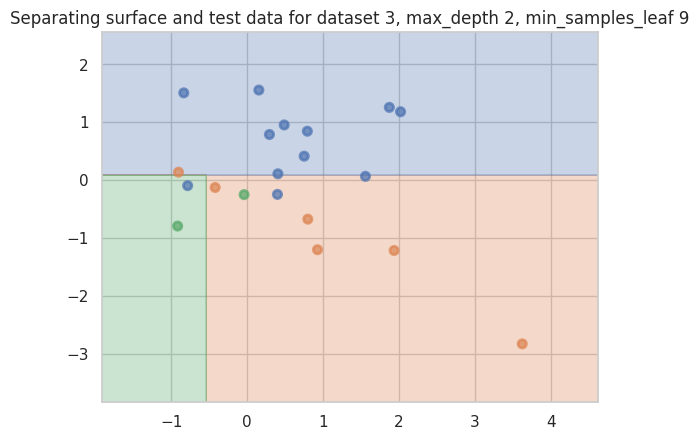

Accuracy on train for dataset 3, max_depth 2, min_samples_leaf 10: 0.89


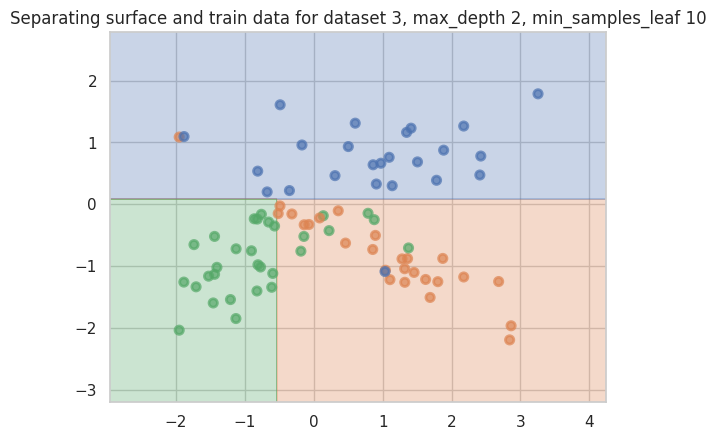

Accuracy on test for dataset 3, max_depth 2, min_samples_leaf 10: 0.75


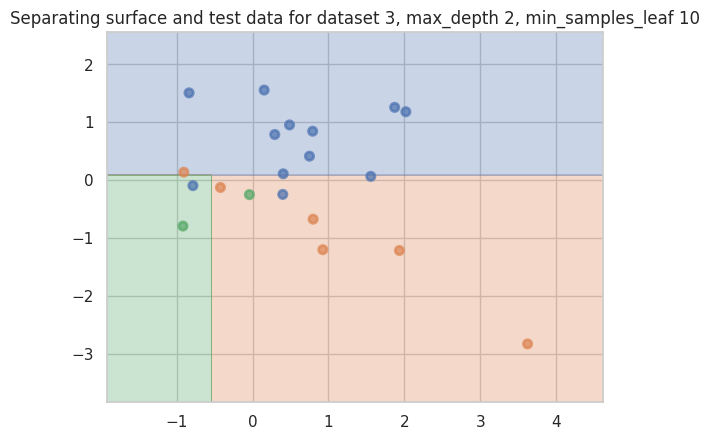

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 1: 0.90


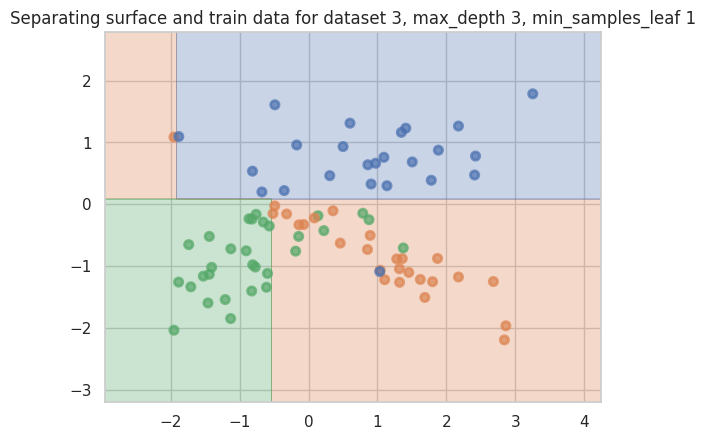

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 1: 0.75


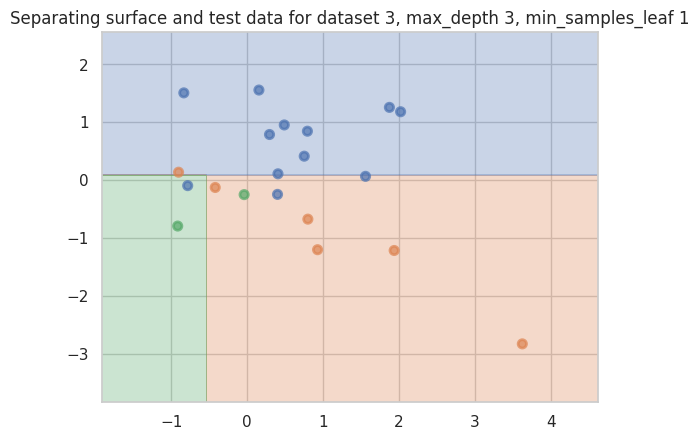

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 2: 0.89


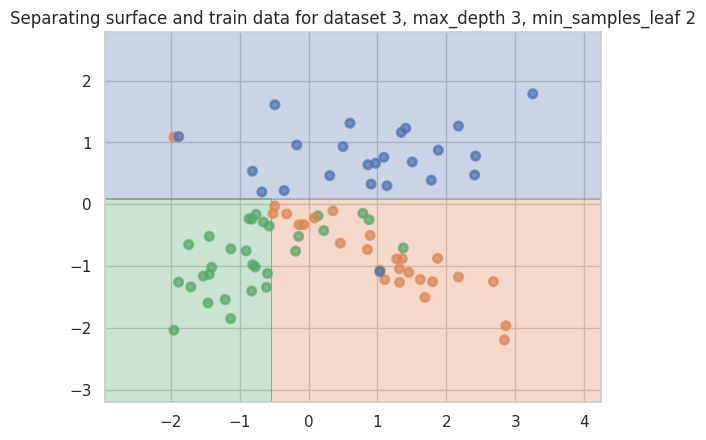

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 2: 0.75


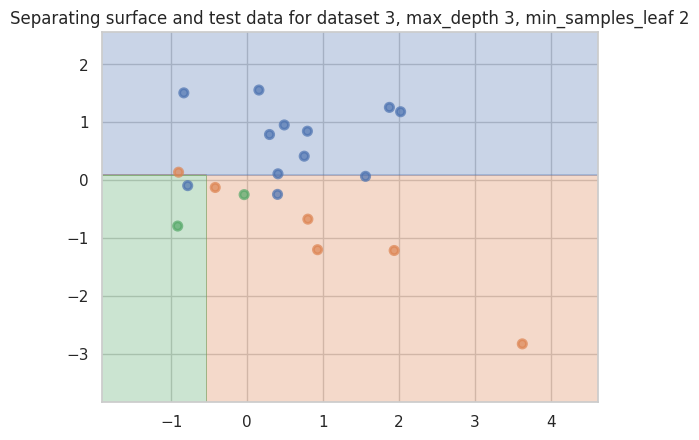

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 3: 0.89


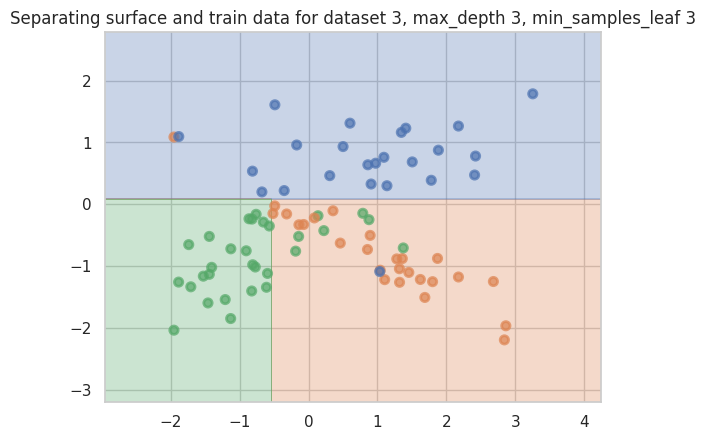

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 3: 0.75


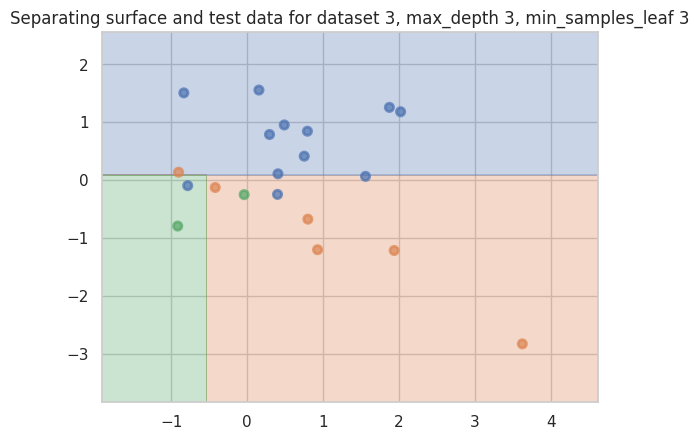

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 4: 0.89


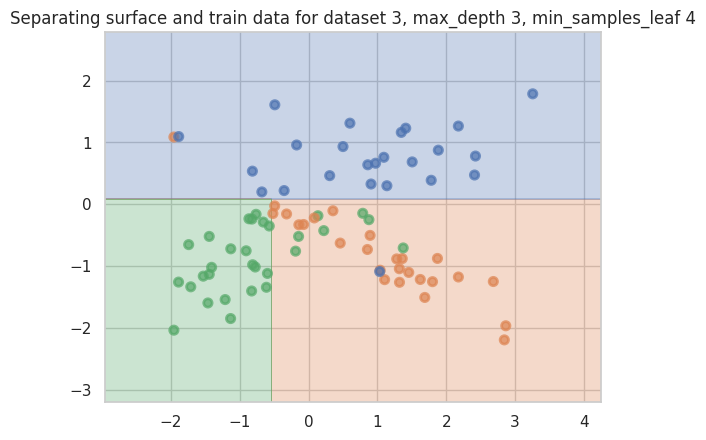

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 4: 0.75


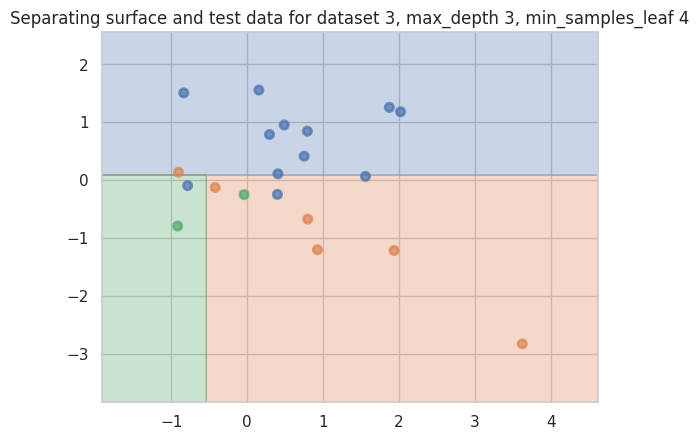

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 5: 0.89


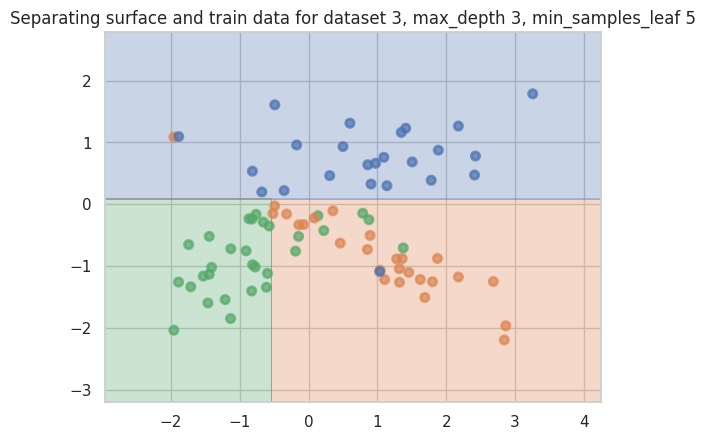

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 5: 0.75


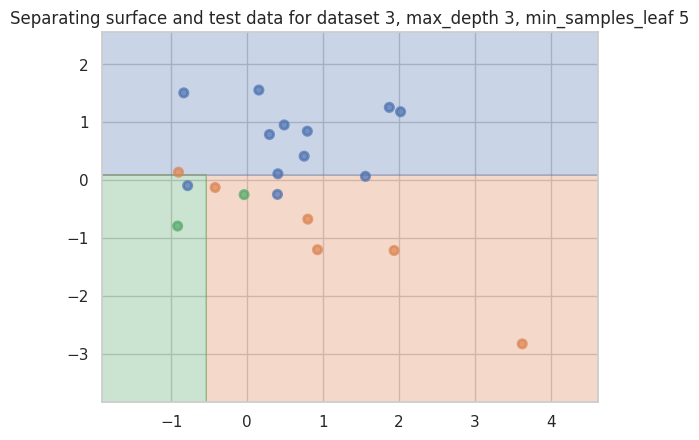

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 6: 0.89


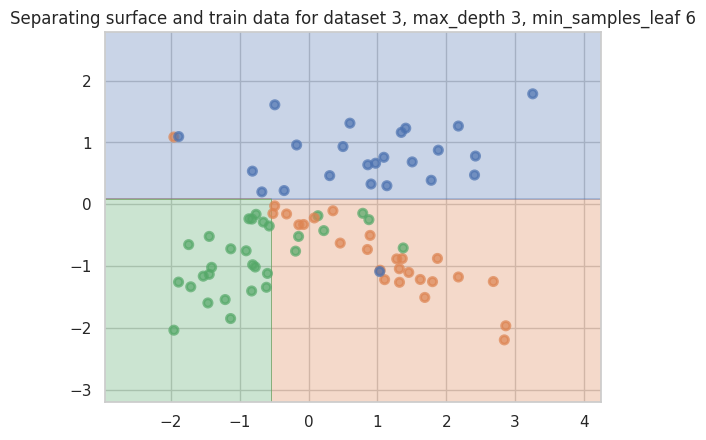

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 6: 0.75


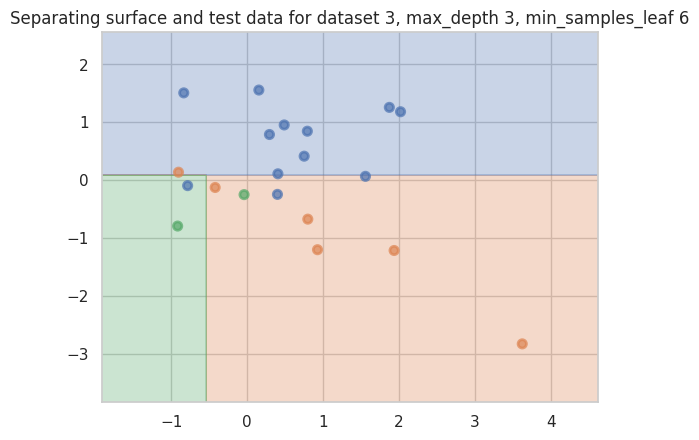

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 7: 0.89


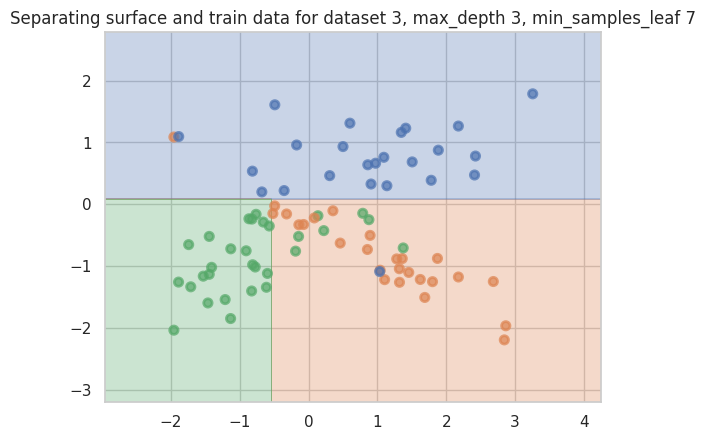

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 7: 0.75


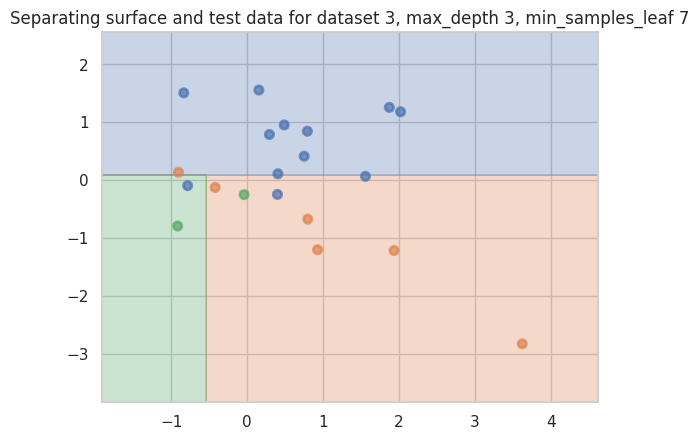

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 8: 0.89


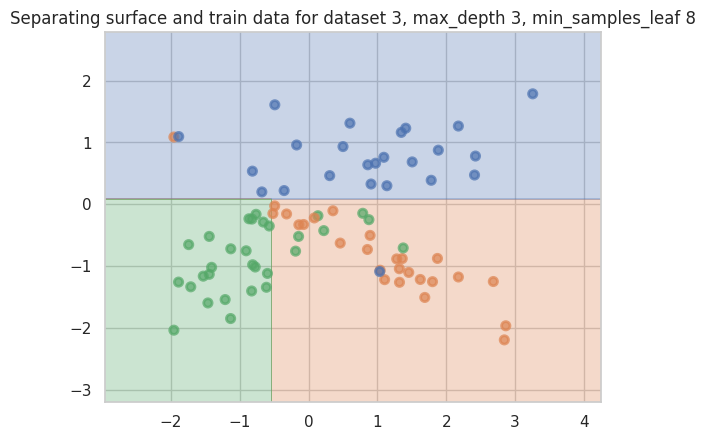

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 8: 0.75


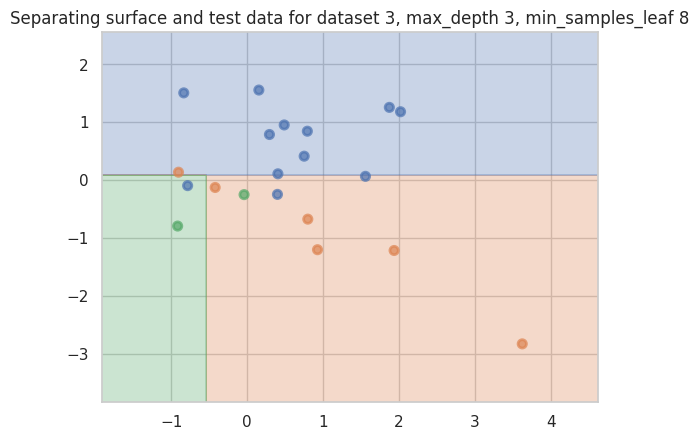

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 9: 0.89


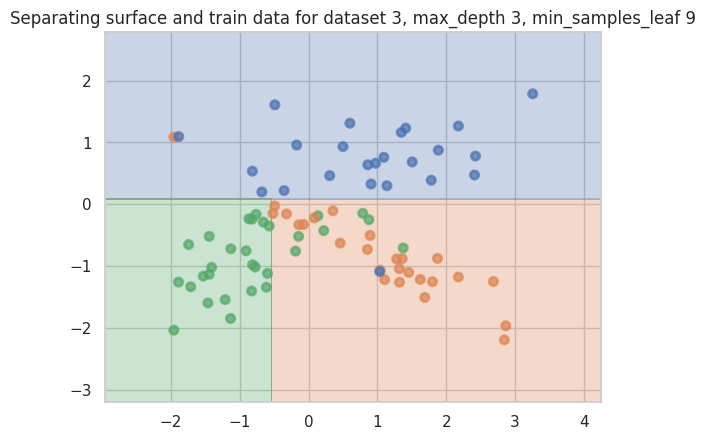

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 9: 0.75


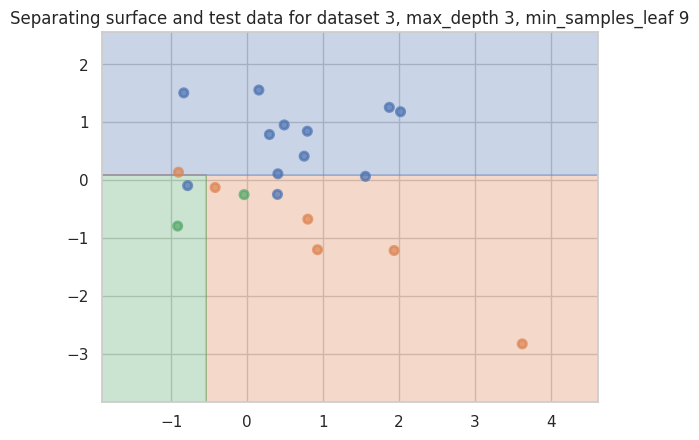

Accuracy on train for dataset 3, max_depth 3, min_samples_leaf 10: 0.89


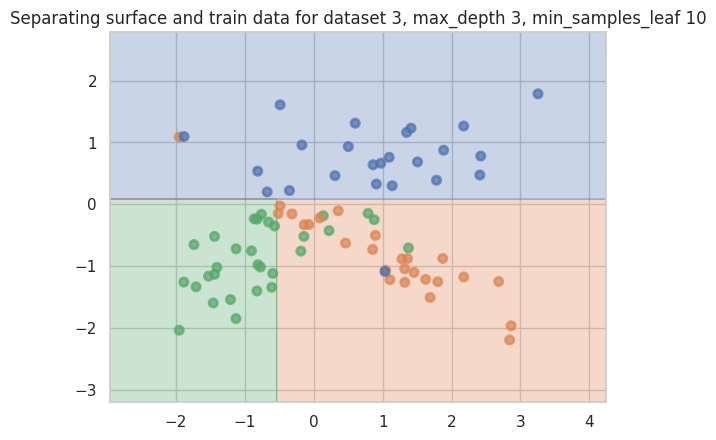

Accuracy on test for dataset 3, max_depth 3, min_samples_leaf 10: 0.75


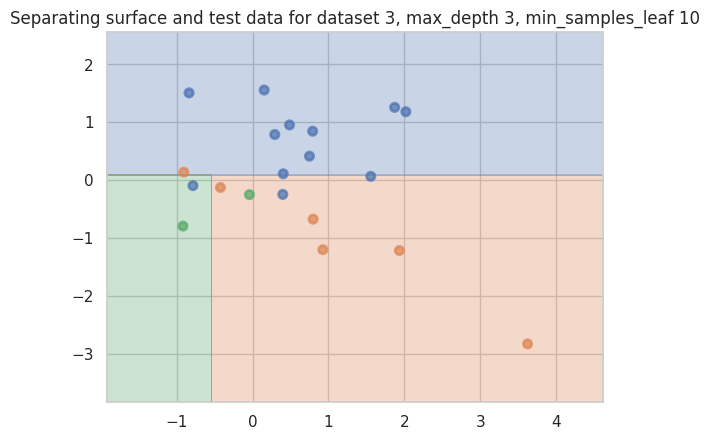

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 1: 0.91


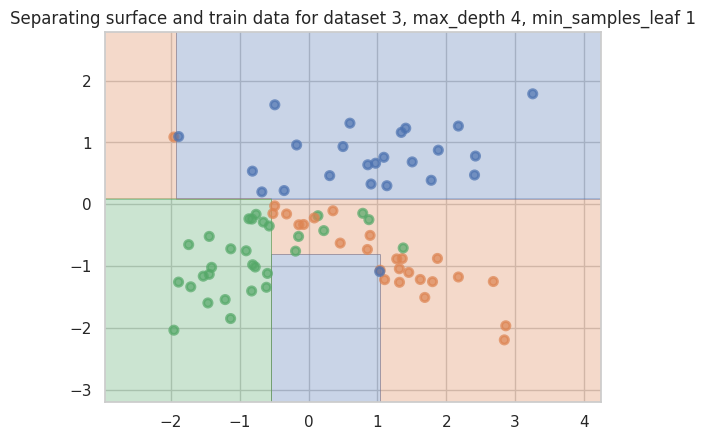

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 1: 0.70


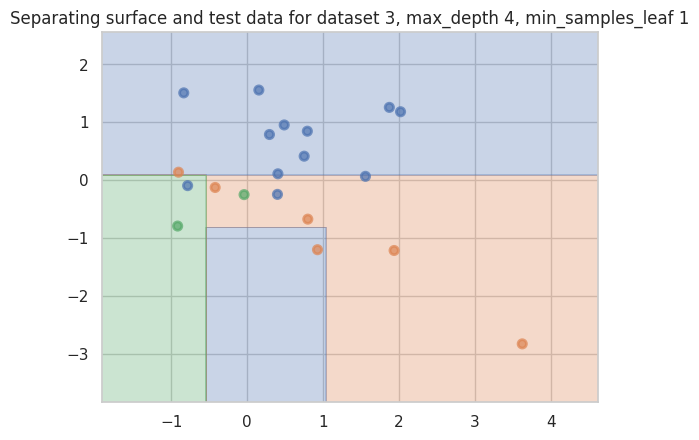

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 2: 0.89


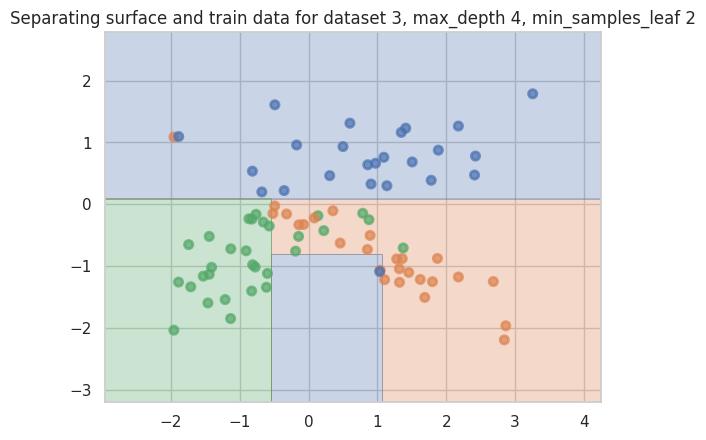

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 2: 0.70


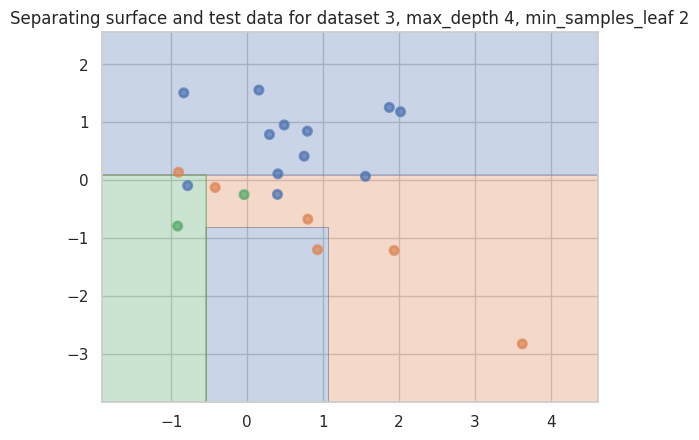

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 3: 0.89


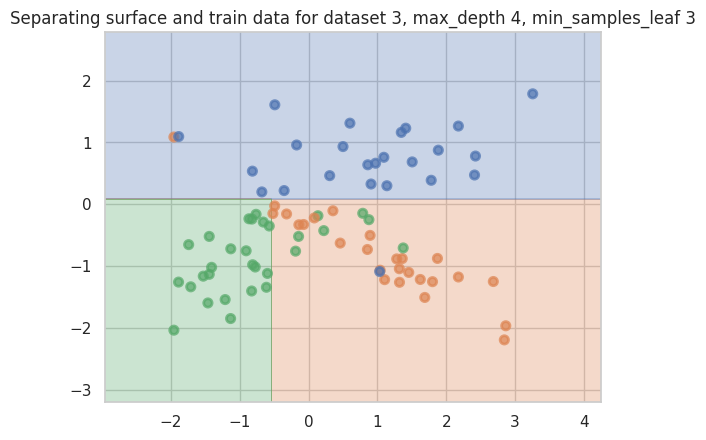

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 3: 0.75


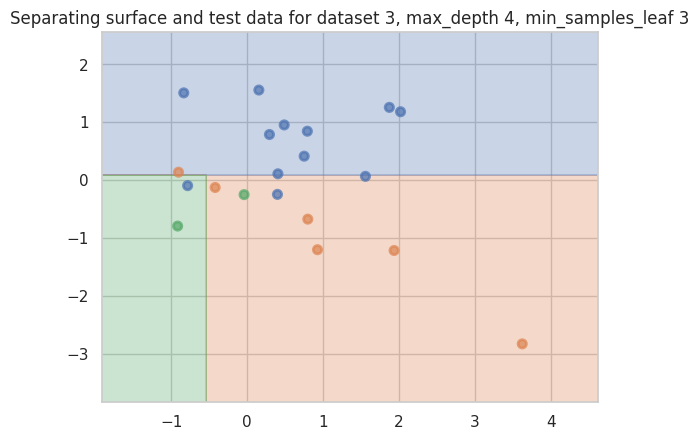

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 4: 0.90


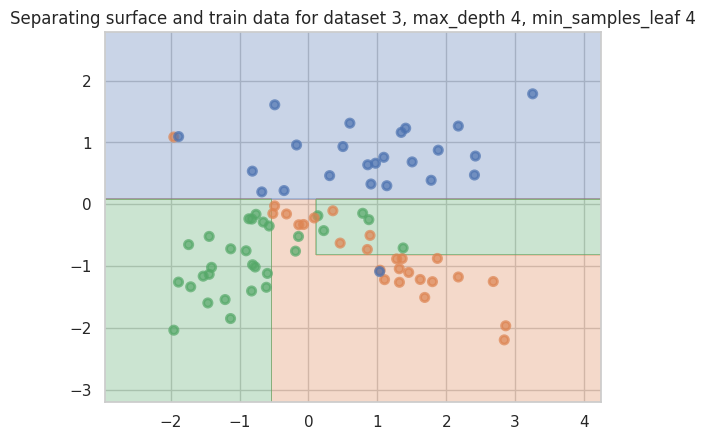

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 4: 0.70


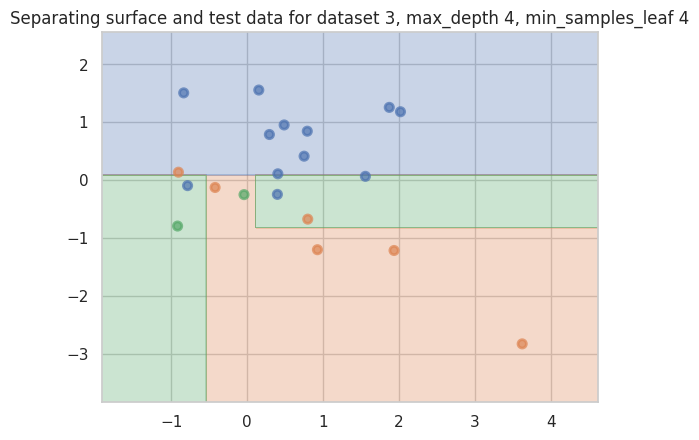

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 5: 0.90


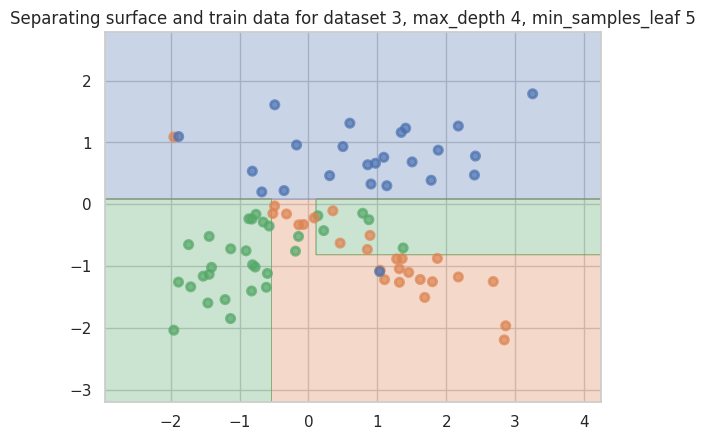

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 5: 0.70


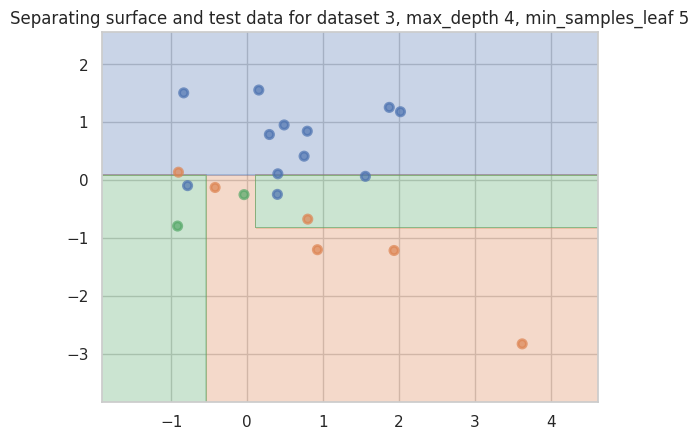

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 6: 0.90


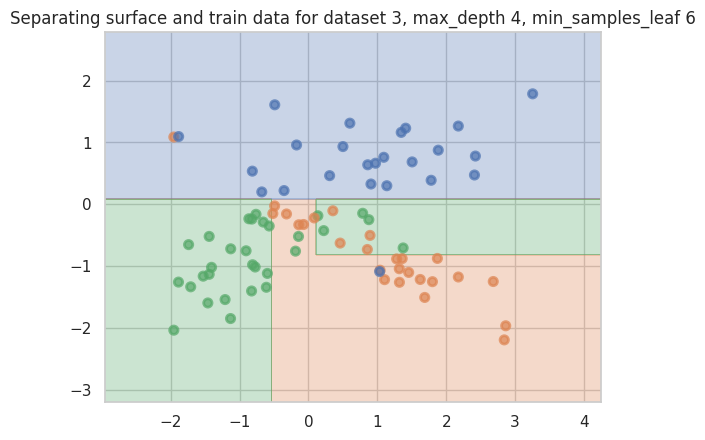

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 6: 0.70


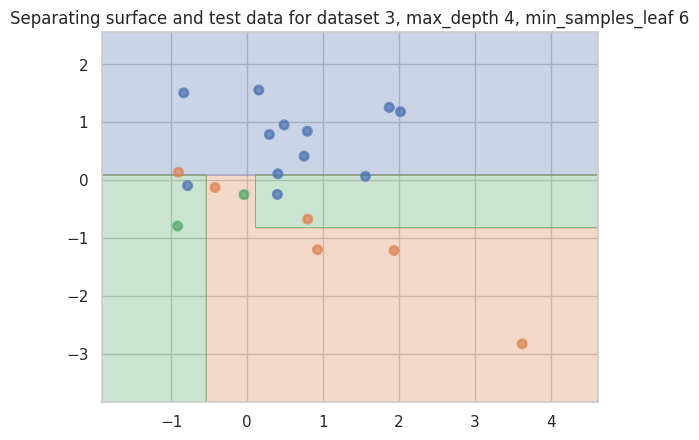

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 7: 0.90


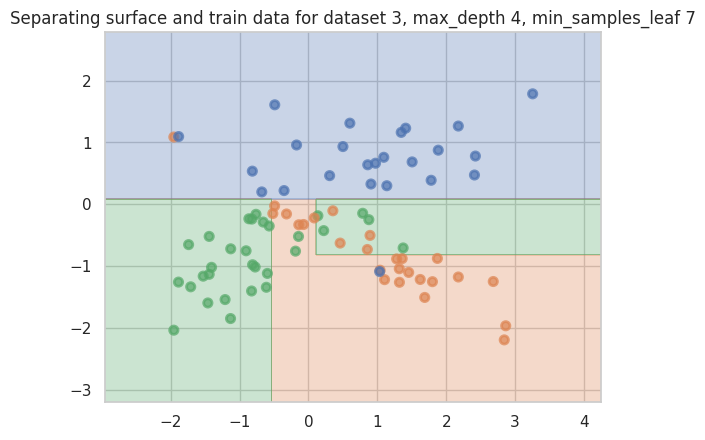

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 7: 0.70


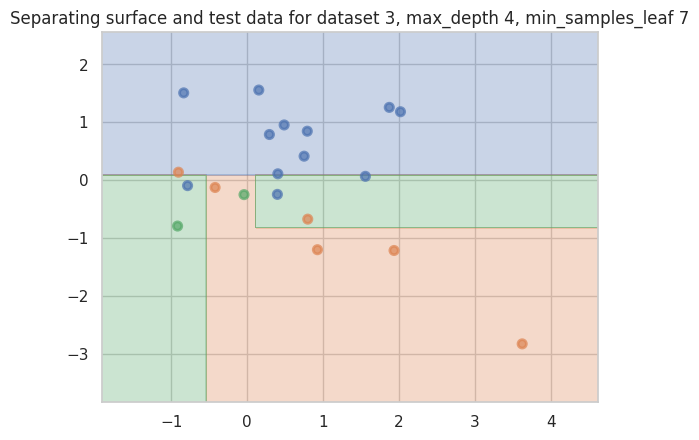

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 8: 0.90


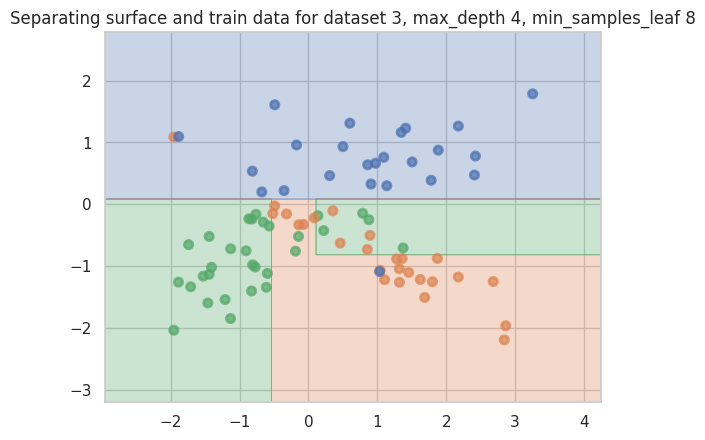

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 8: 0.70


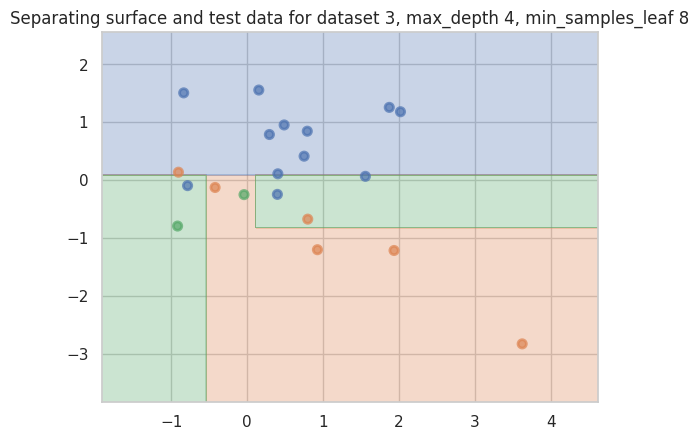

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 9: 0.89


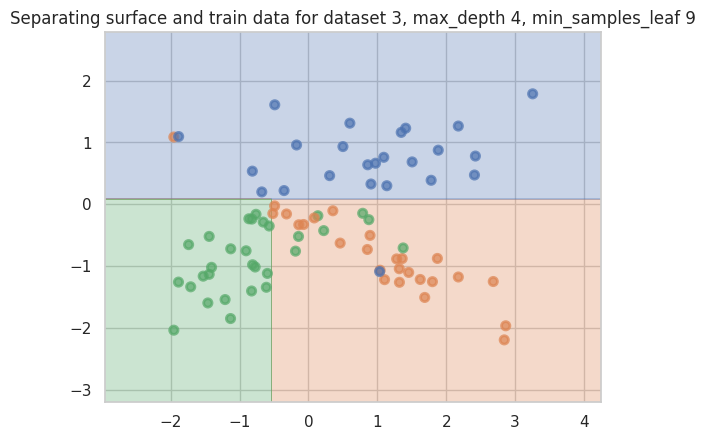

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 9: 0.75


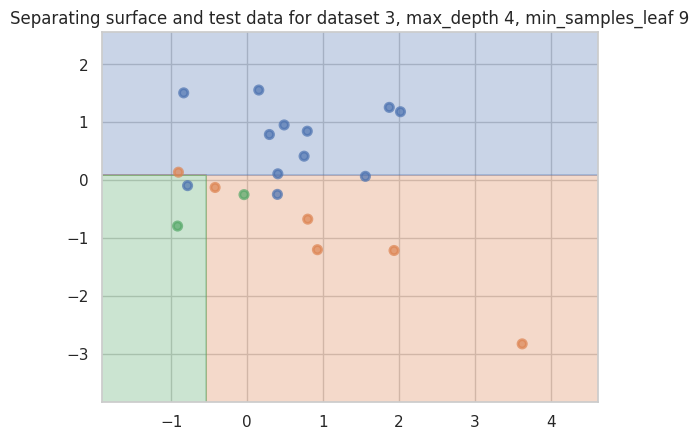

Accuracy on train for dataset 3, max_depth 4, min_samples_leaf 10: 0.89


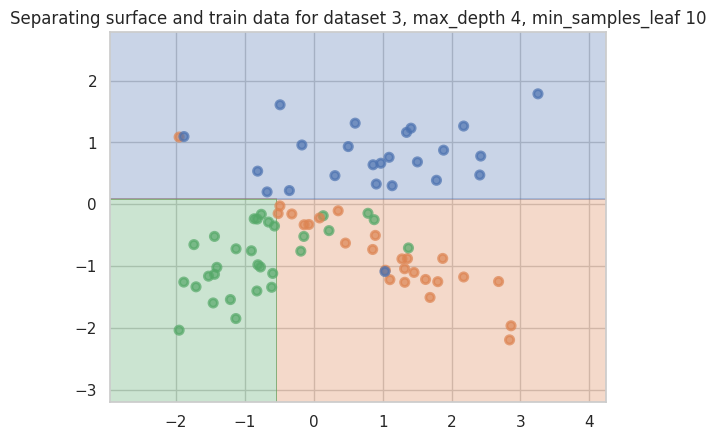

Accuracy on test for dataset 3, max_depth 4, min_samples_leaf 10: 0.75


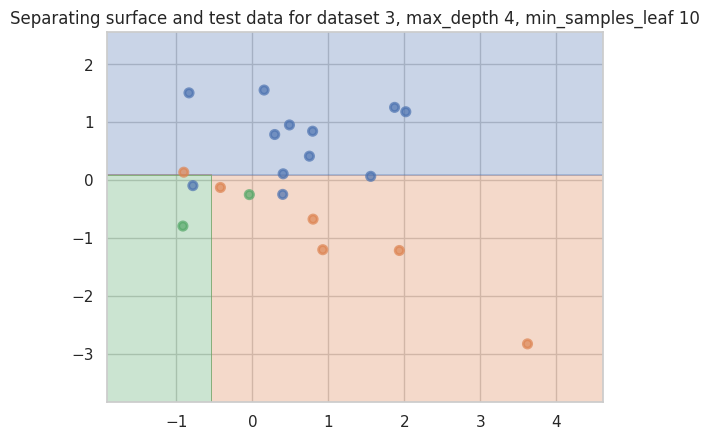

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 1: 0.94


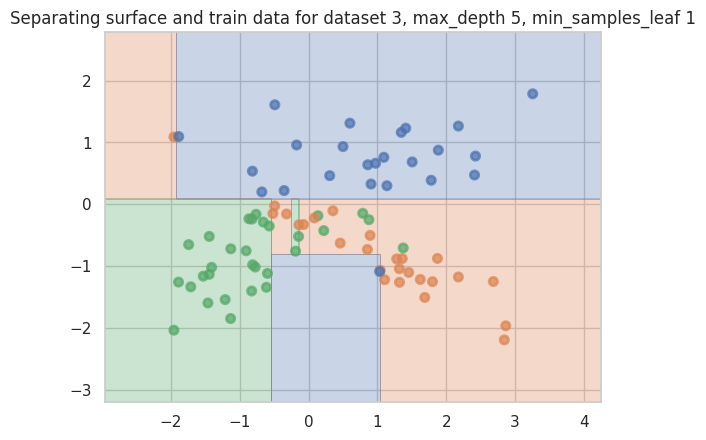

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 1: 0.70


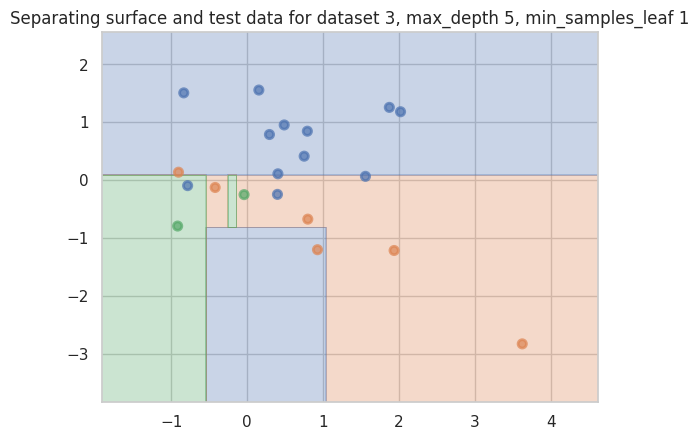

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 2: 0.91


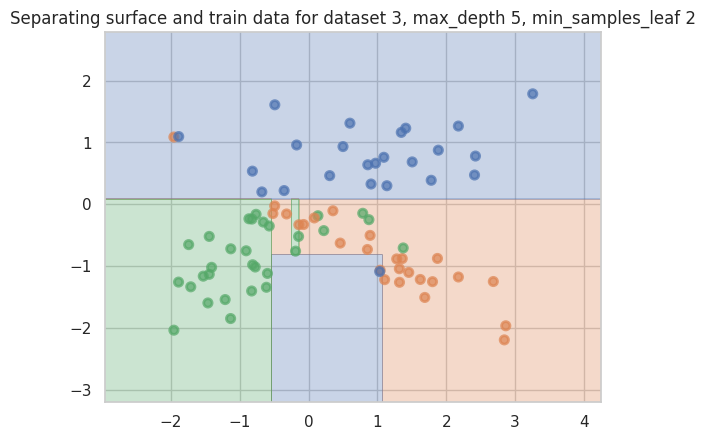

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 2: 0.70


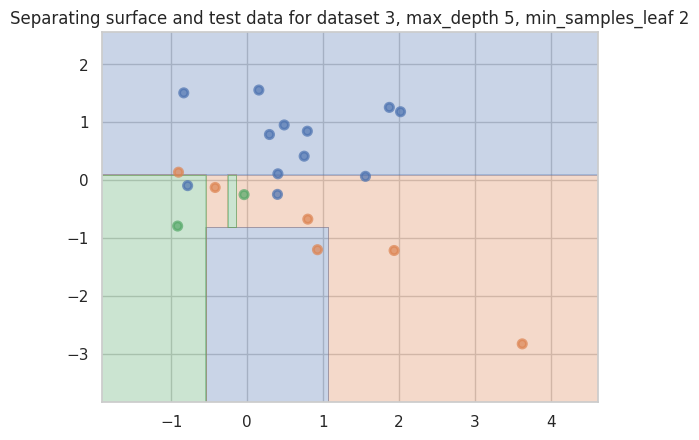

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 3: 0.90


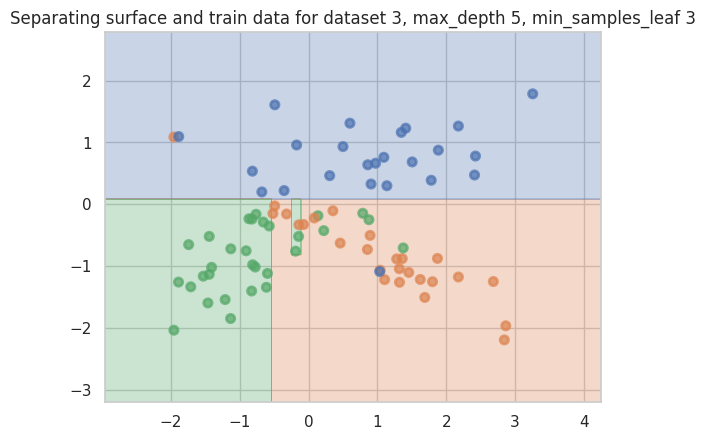

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 3: 0.75


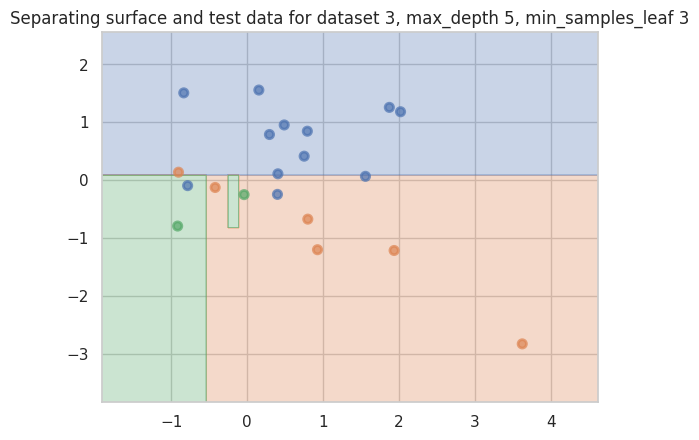

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 4: 0.93


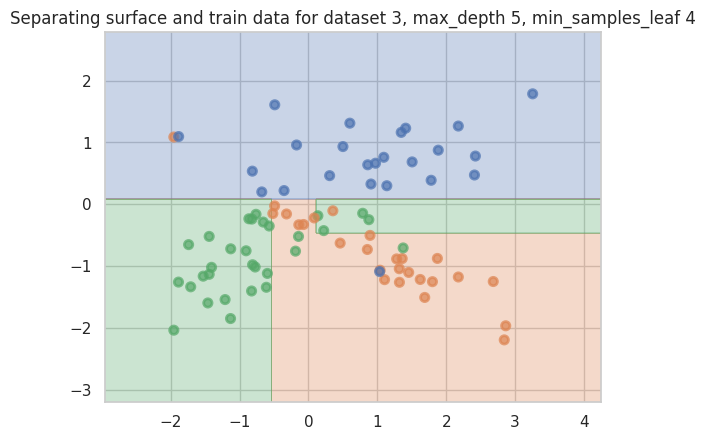

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 4: 0.75


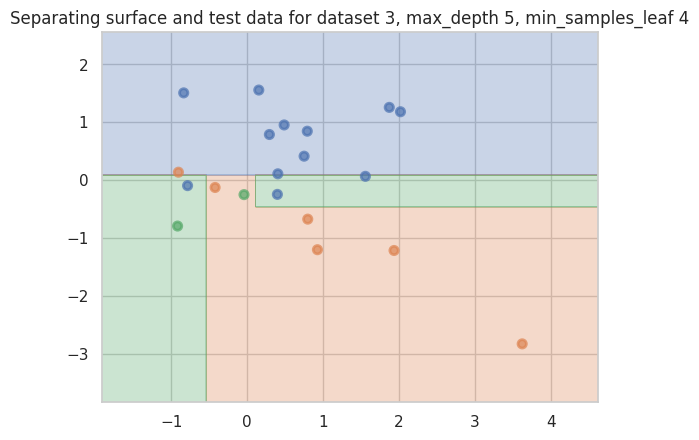

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 5: 0.90


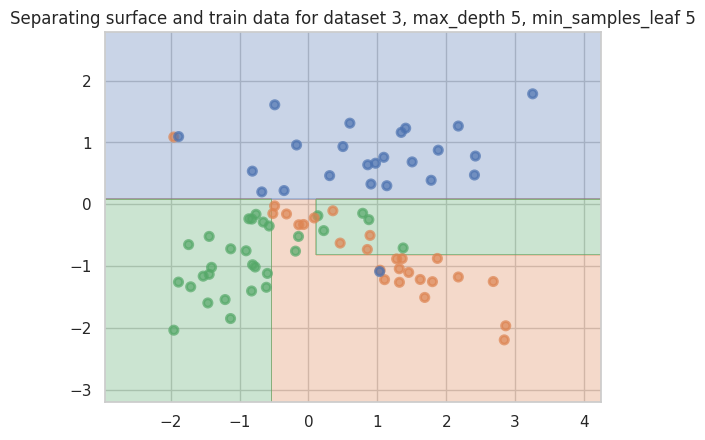

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 5: 0.70


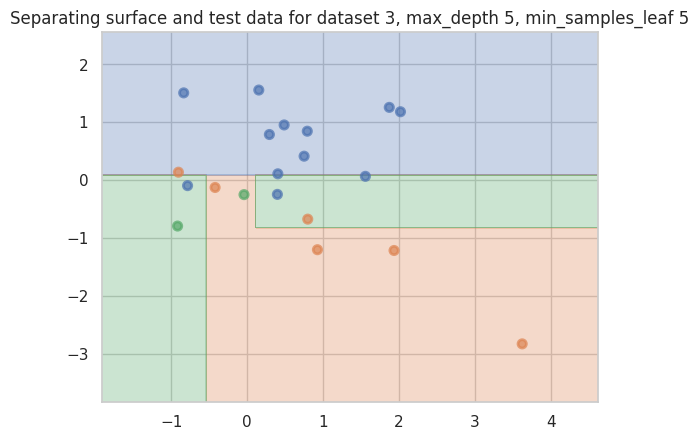

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 6: 0.90


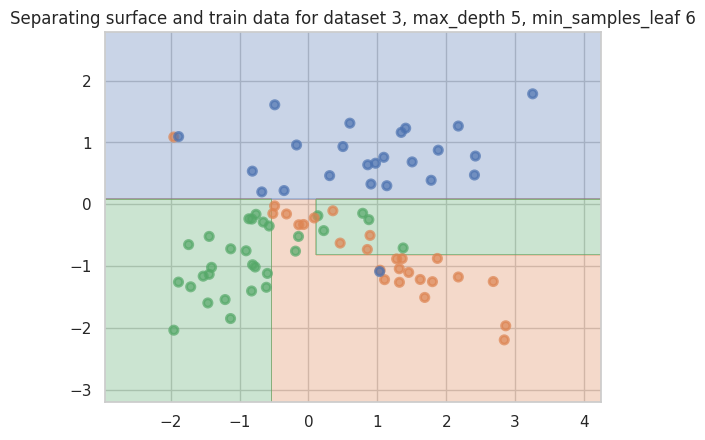

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 6: 0.70


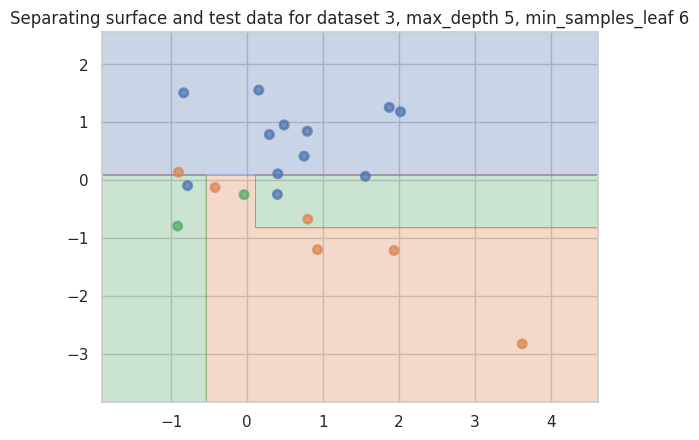

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 7: 0.90


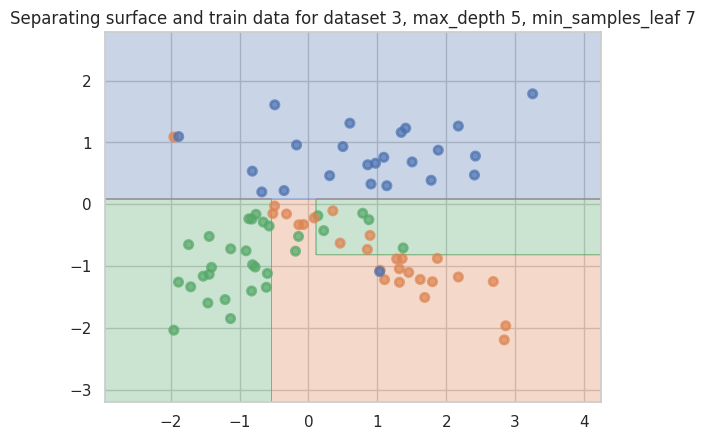

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 7: 0.70


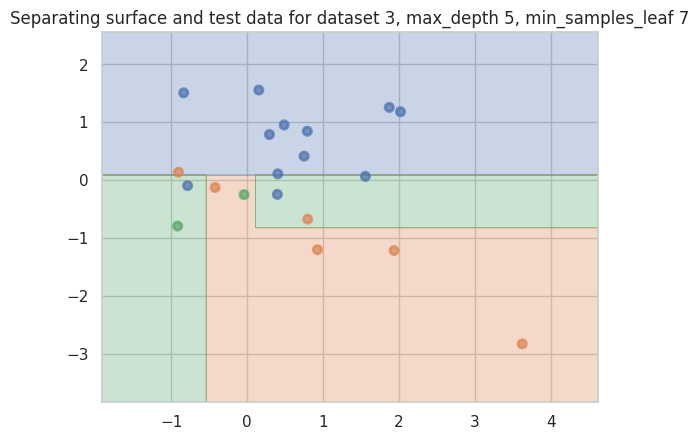

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 8: 0.90


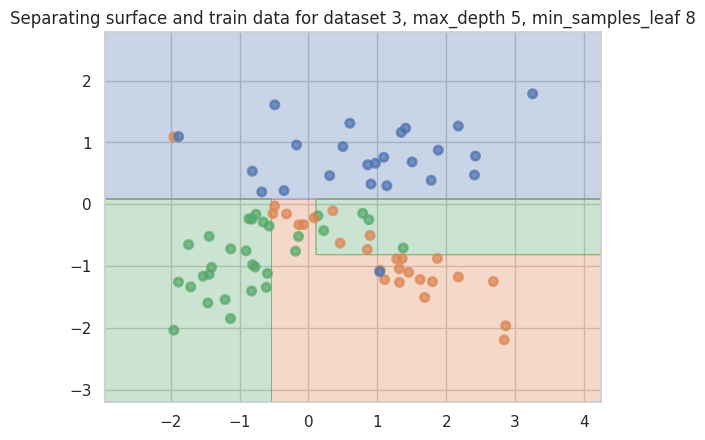

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 8: 0.70


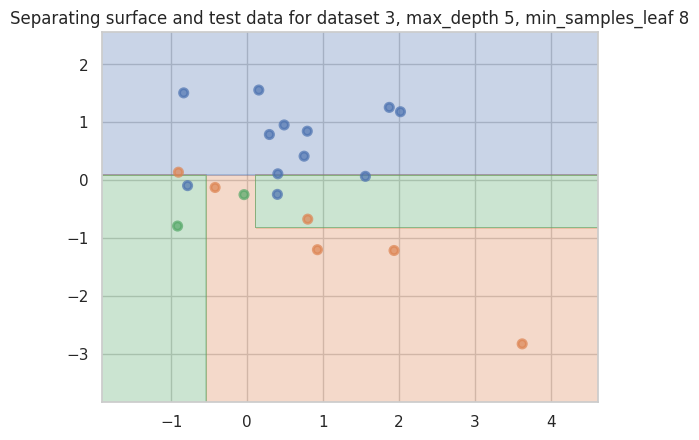

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 9: 0.89


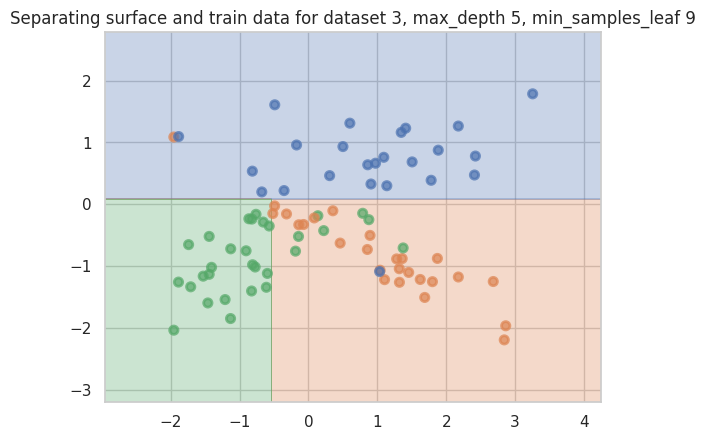

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 9: 0.75


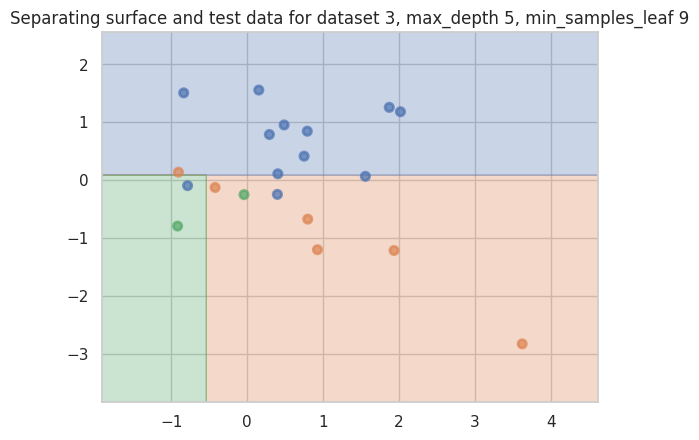

Accuracy on train for dataset 3, max_depth 5, min_samples_leaf 10: 0.89


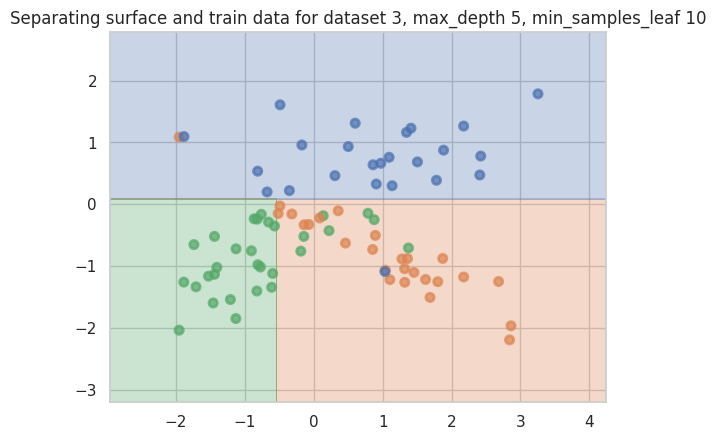

Accuracy on test for dataset 3, max_depth 5, min_samples_leaf 10: 0.75


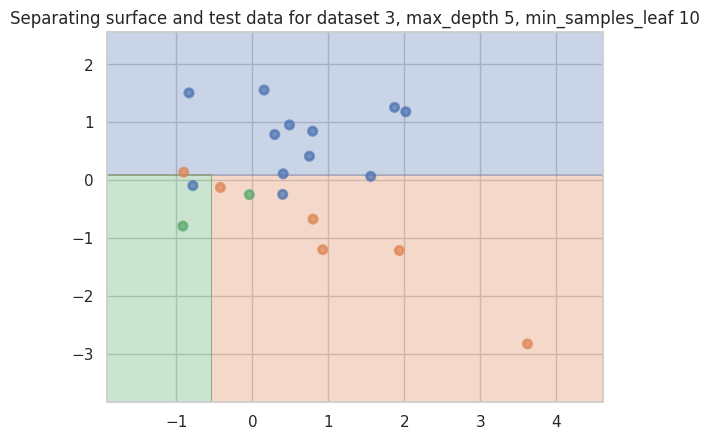

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 1: 0.95


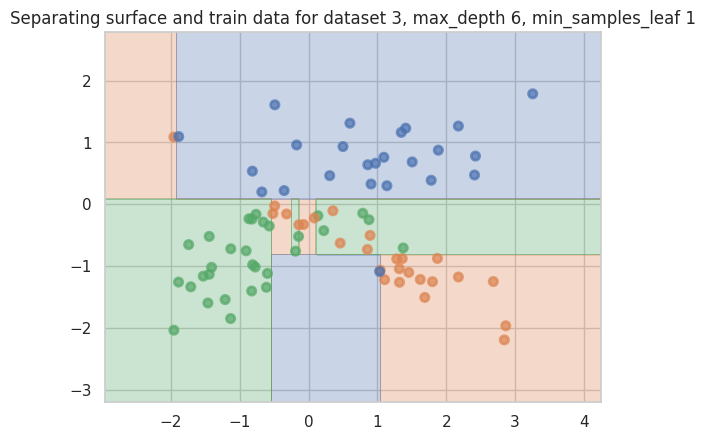

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 1: 0.65


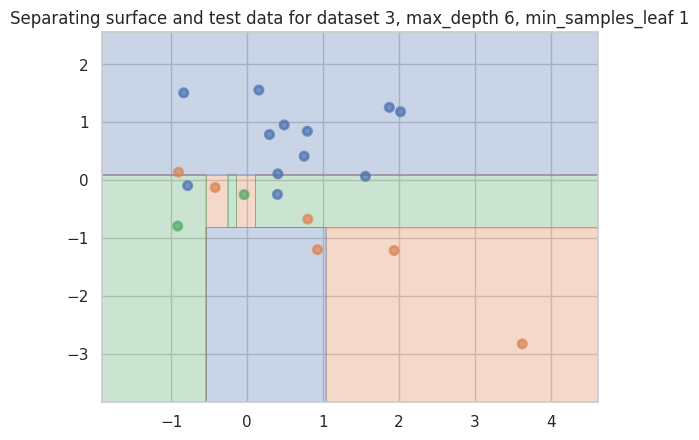

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 2: 0.93


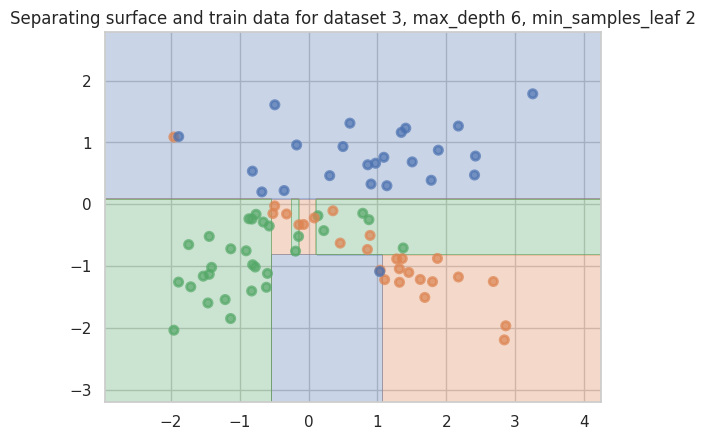

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 2: 0.65


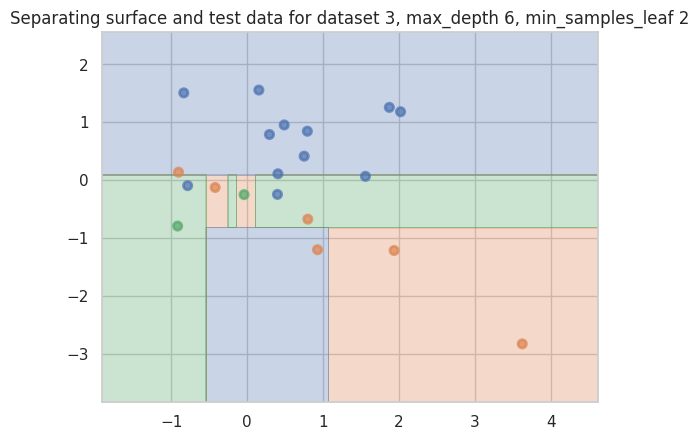

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 3: 0.91


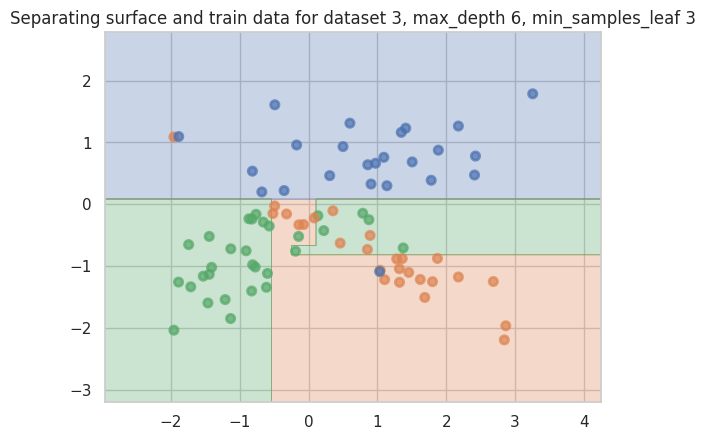

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 3: 0.70


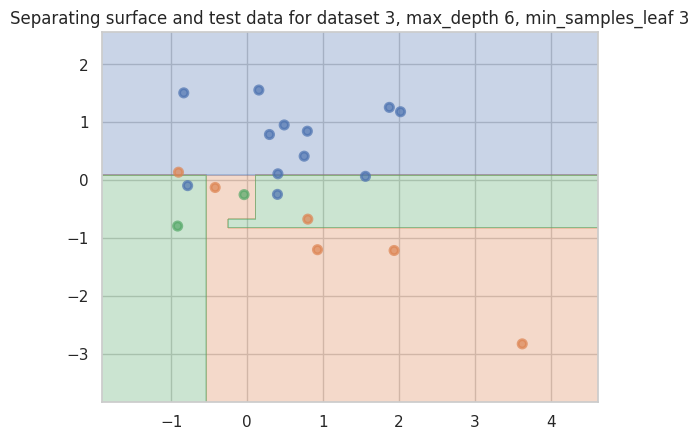

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 4: 0.93


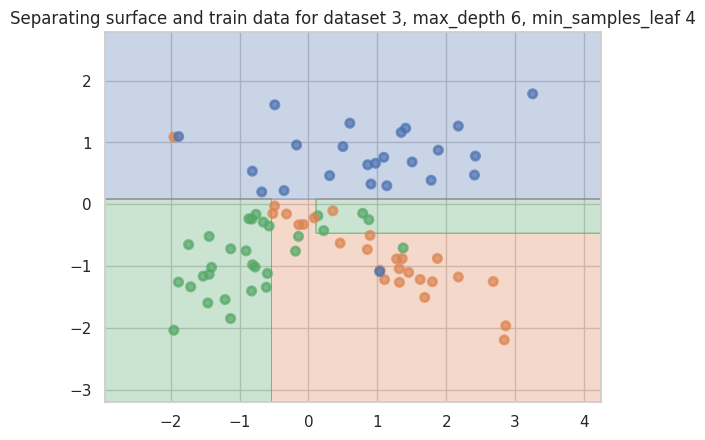

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 4: 0.75


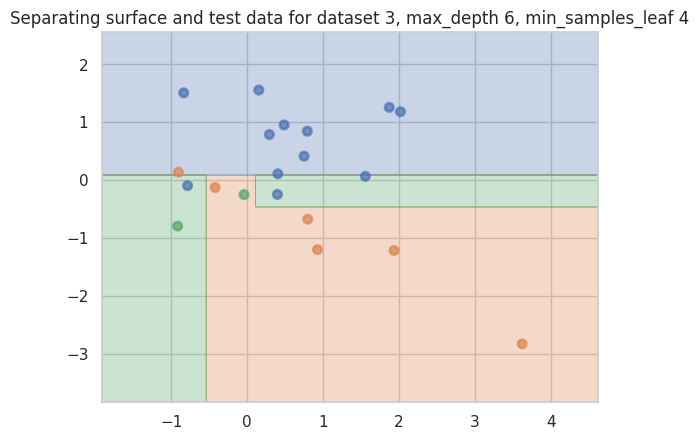

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 5: 0.90


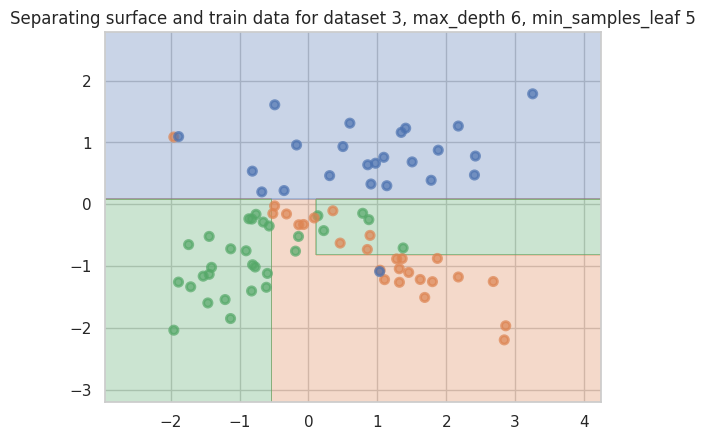

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 5: 0.70


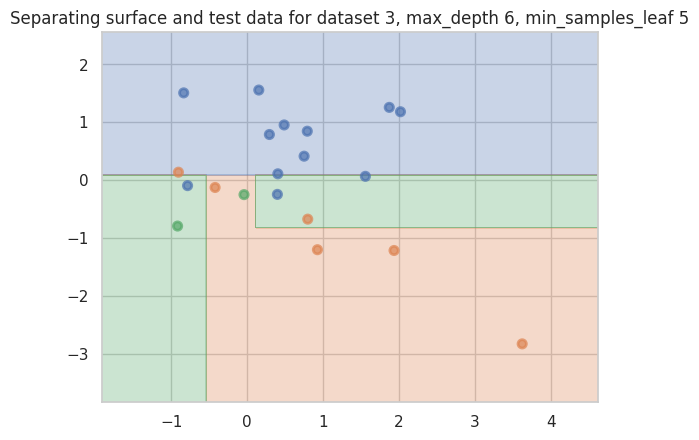

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 6: 0.90


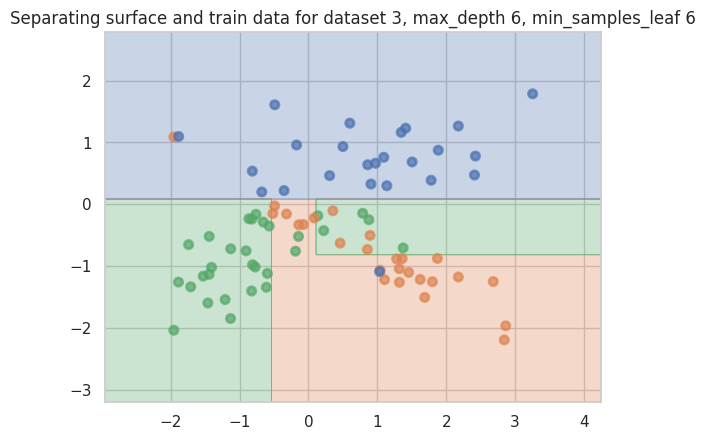

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 6: 0.70


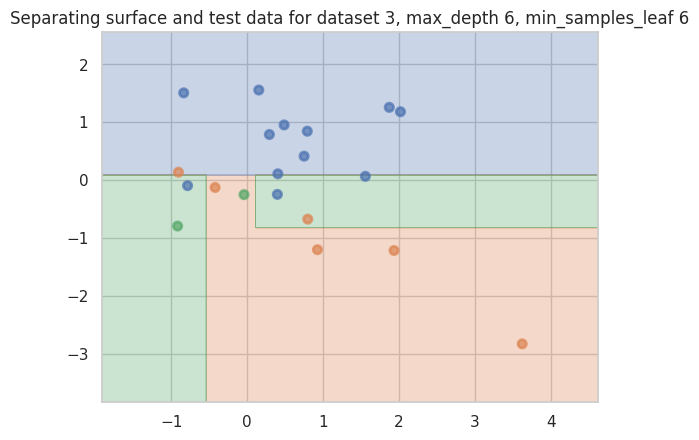

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 7: 0.90


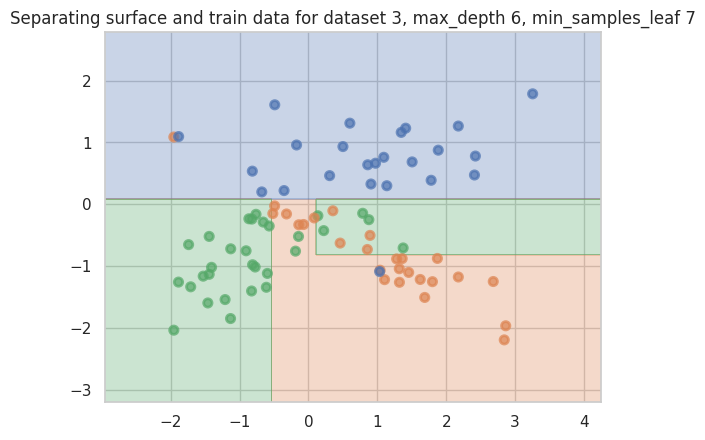

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 7: 0.70


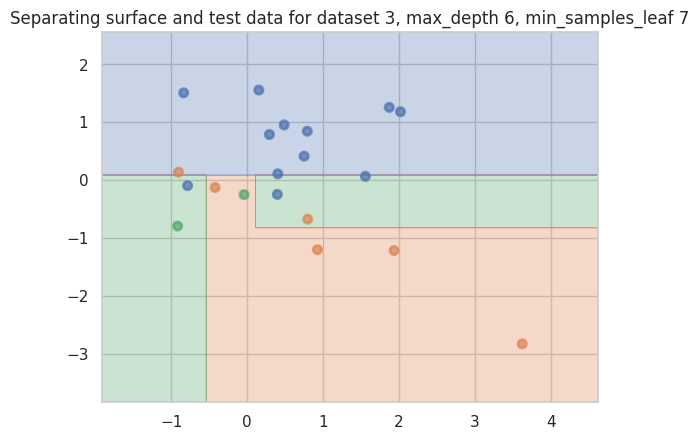

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 8: 0.90


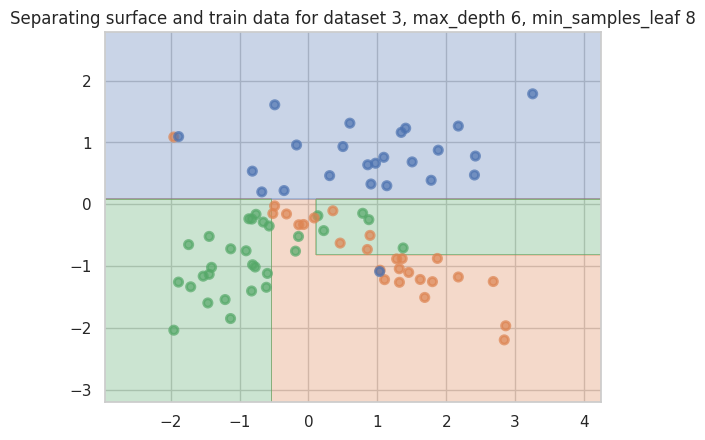

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 8: 0.70


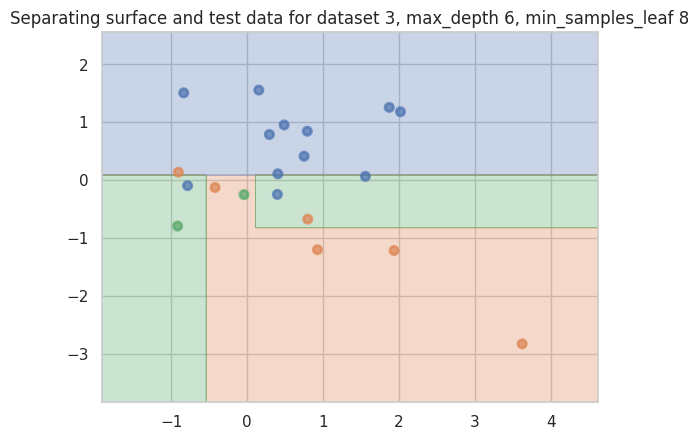

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 9: 0.89


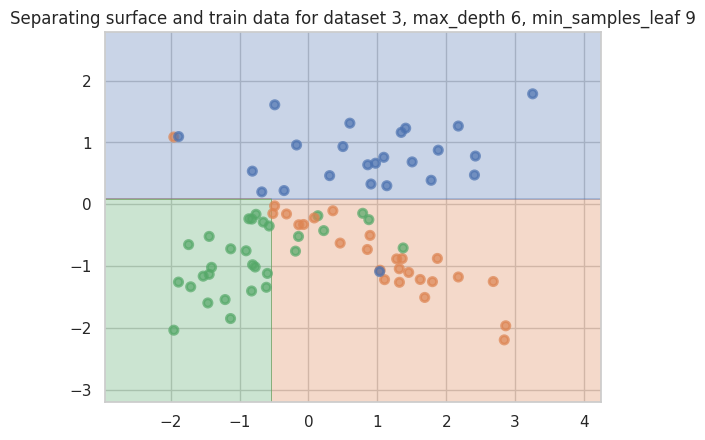

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 9: 0.75


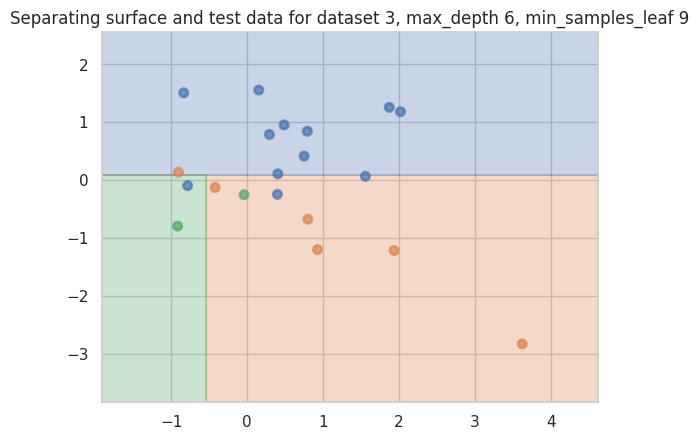

Accuracy on train for dataset 3, max_depth 6, min_samples_leaf 10: 0.89


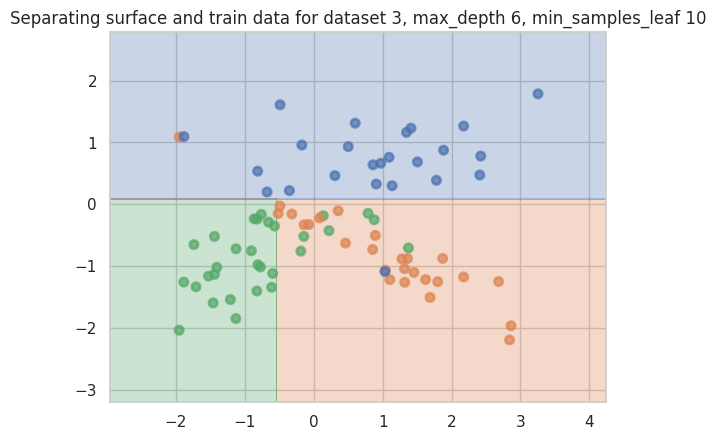

Accuracy on test for dataset 3, max_depth 6, min_samples_leaf 10: 0.75


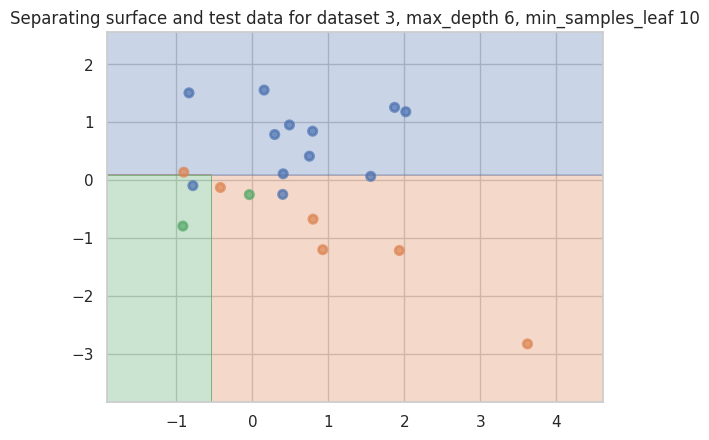

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 1: 0.97


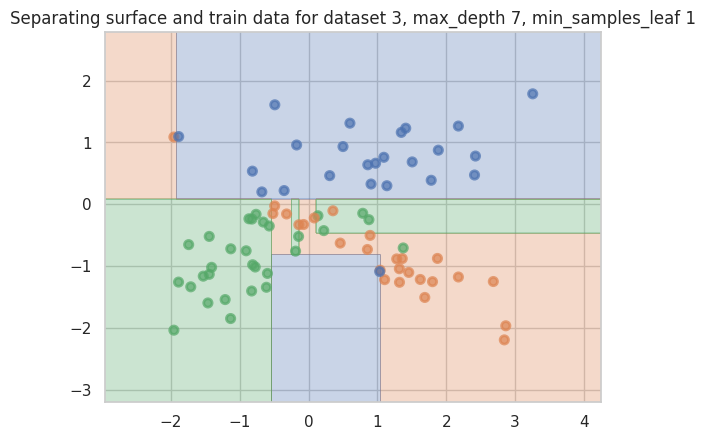

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 1: 0.70


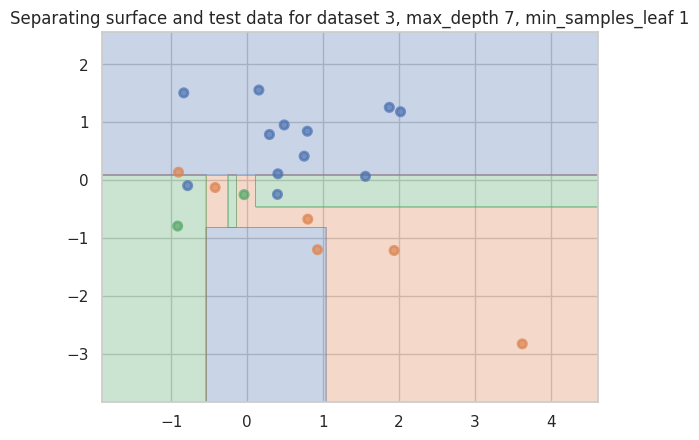

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 2: 0.95


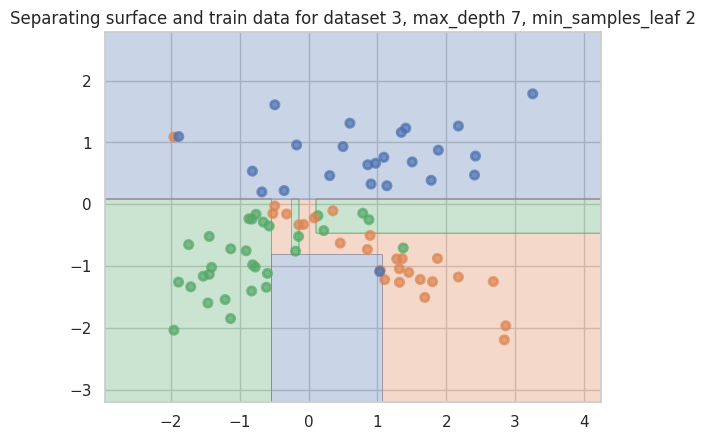

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 2: 0.70


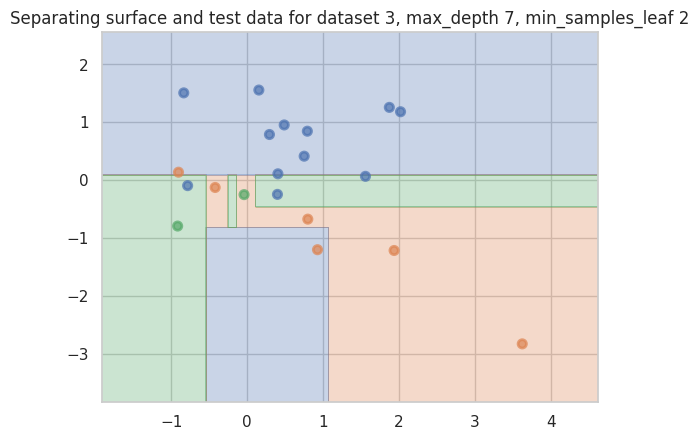

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 3: 0.93


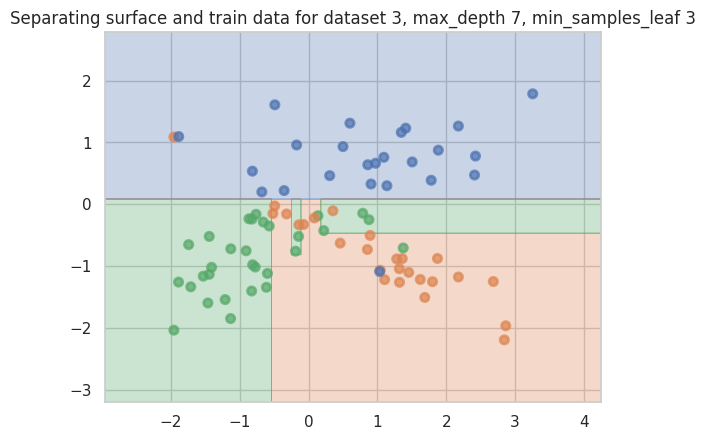

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 3: 0.75


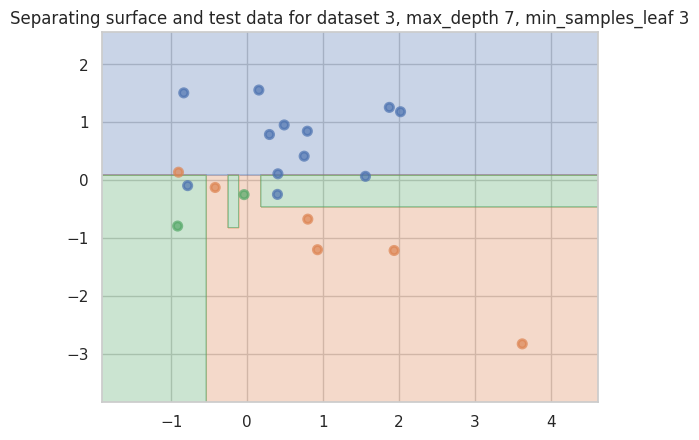

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 4: 0.93


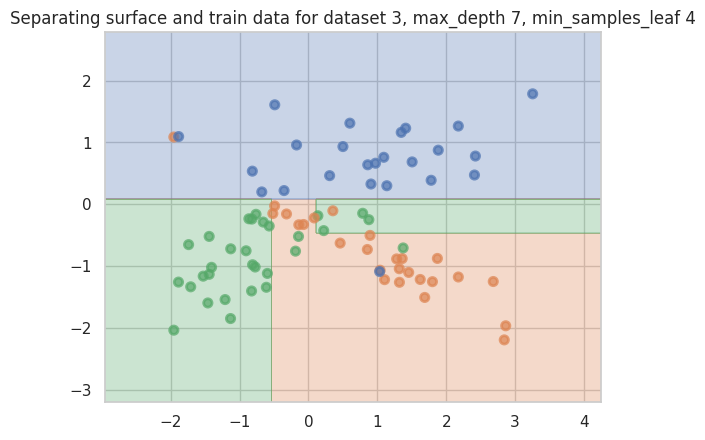

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 4: 0.75


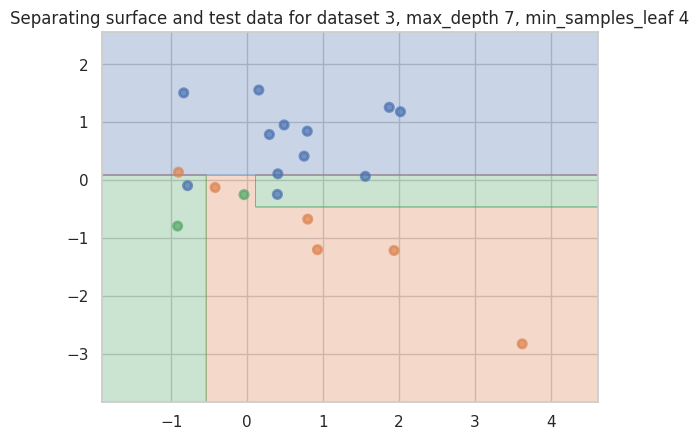

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 5: 0.90


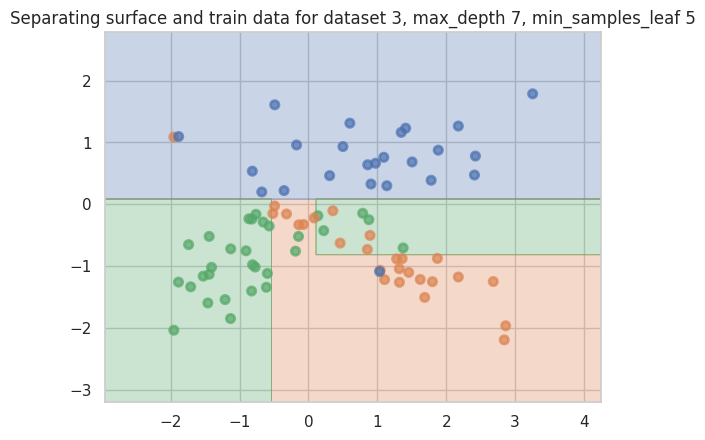

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 5: 0.70


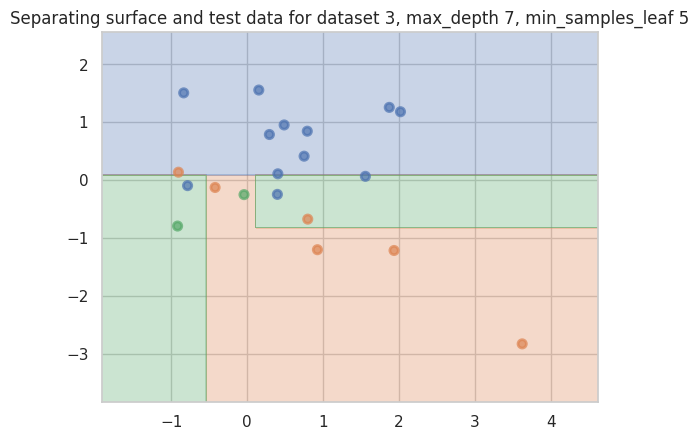

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 6: 0.90


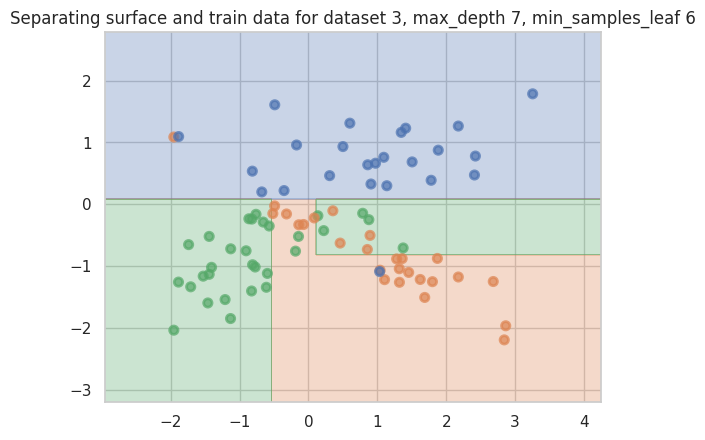

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 6: 0.70


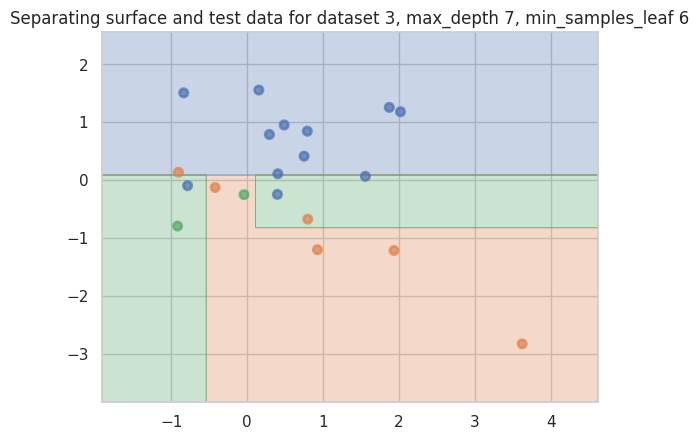

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 7: 0.90


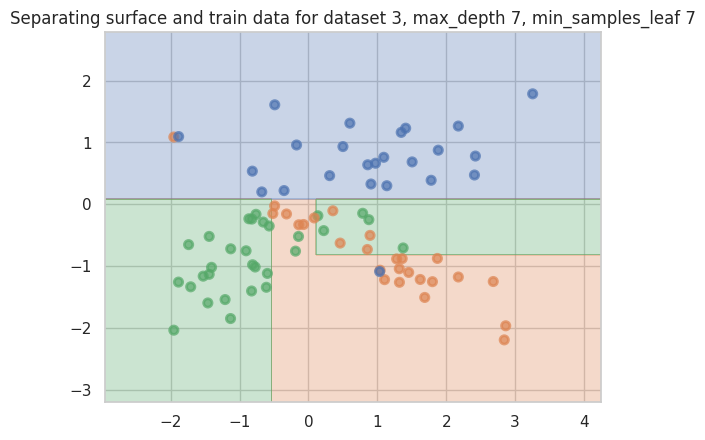

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 7: 0.70


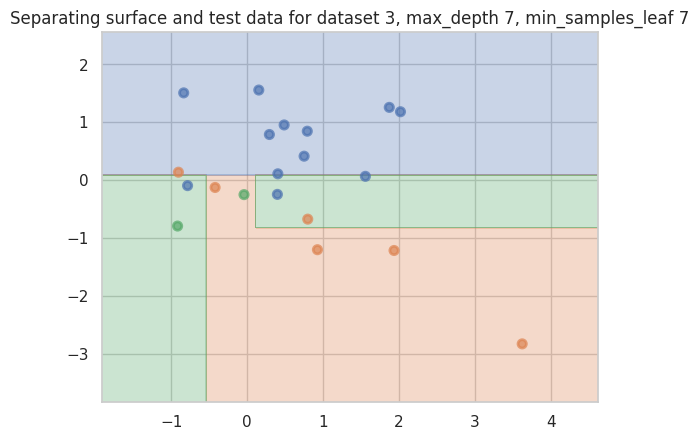

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 8: 0.90


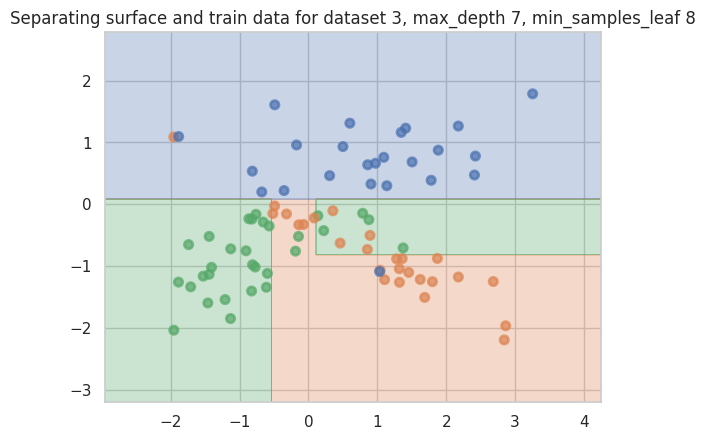

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 8: 0.70


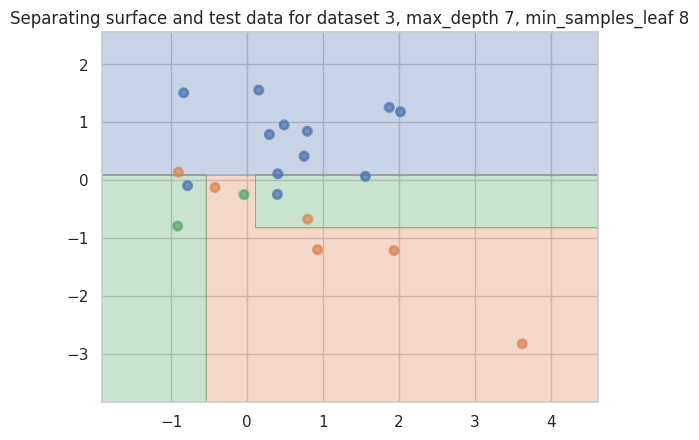

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 9: 0.89


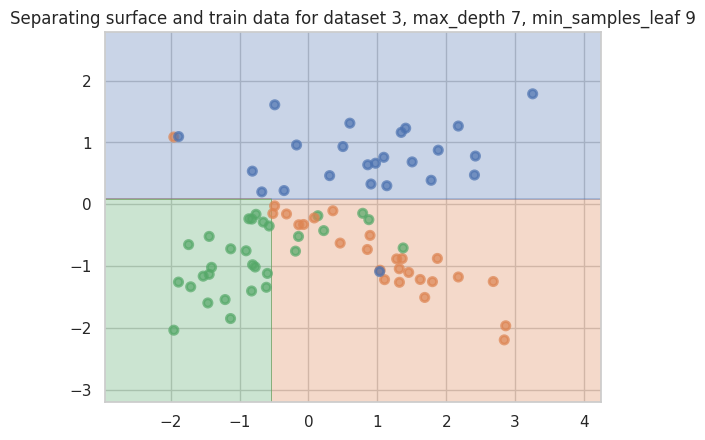

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 9: 0.75


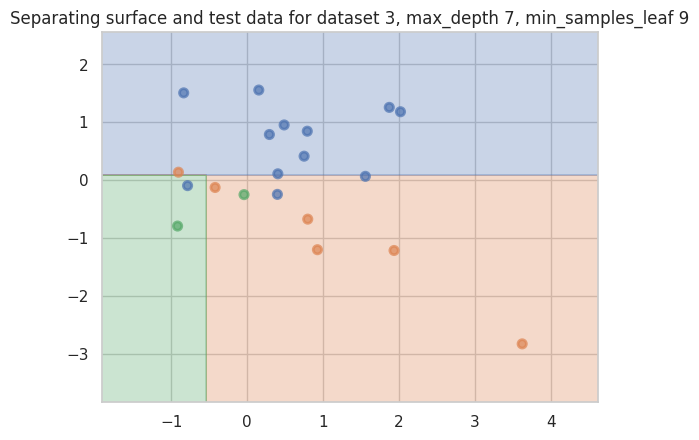

Accuracy on train for dataset 3, max_depth 7, min_samples_leaf 10: 0.89


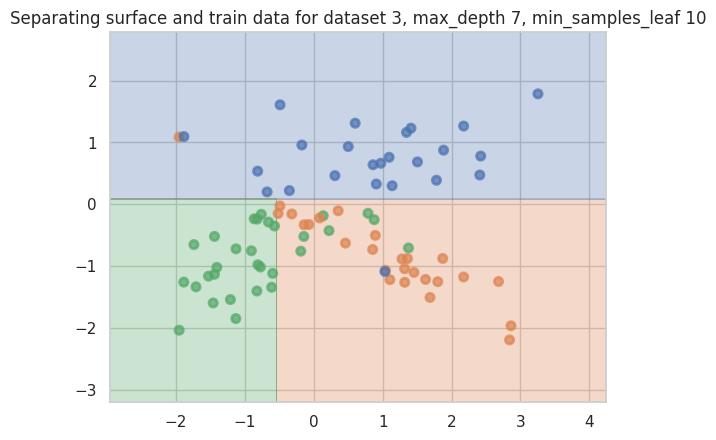

Accuracy on test for dataset 3, max_depth 7, min_samples_leaf 10: 0.75


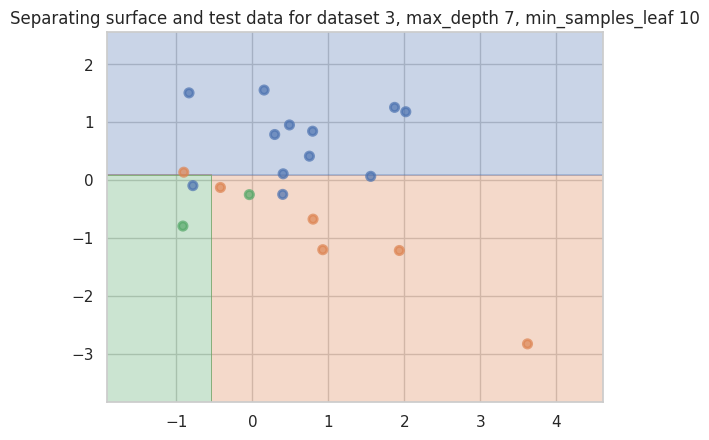

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 1: 1.00


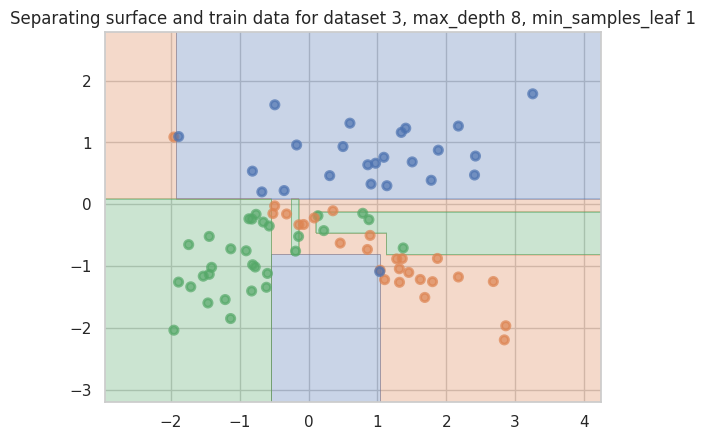

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 1: 0.70


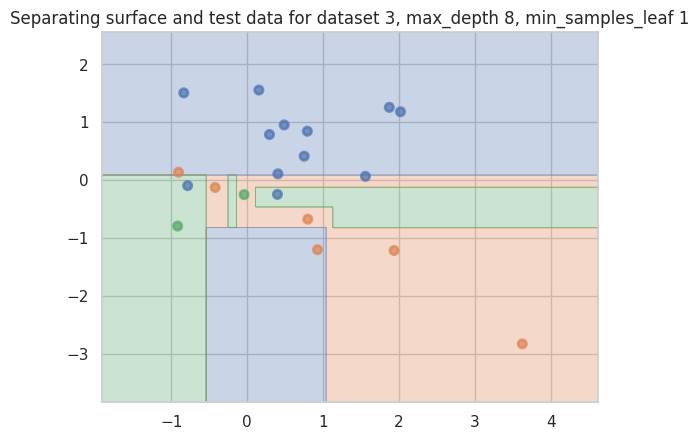

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 2: 0.95


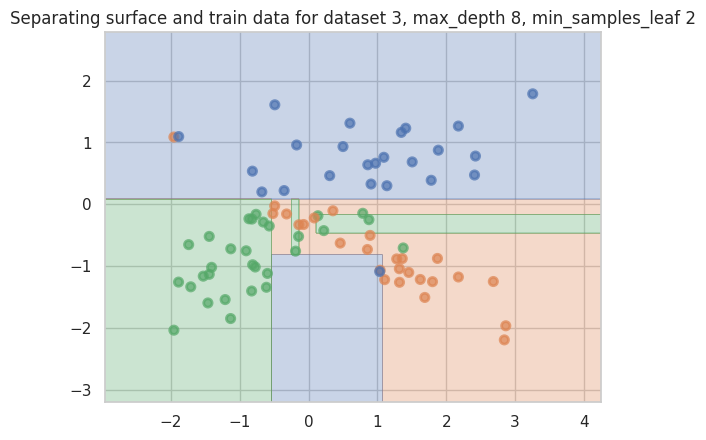

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 2: 0.70


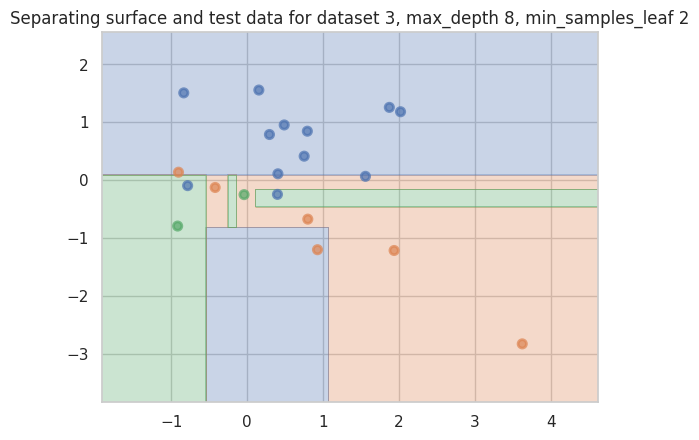

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 3: 0.93


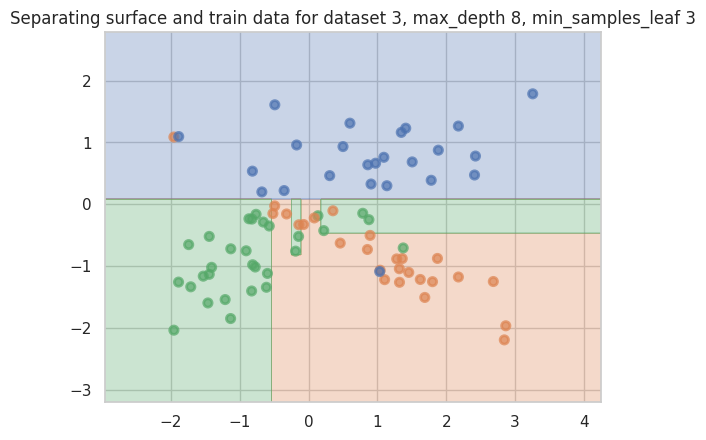

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 3: 0.75


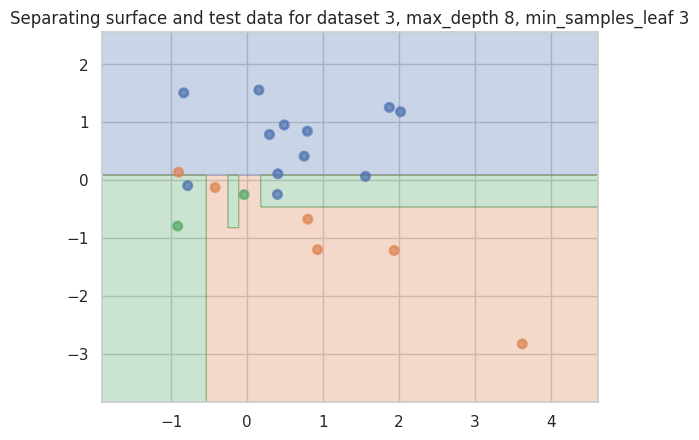

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 4: 0.93


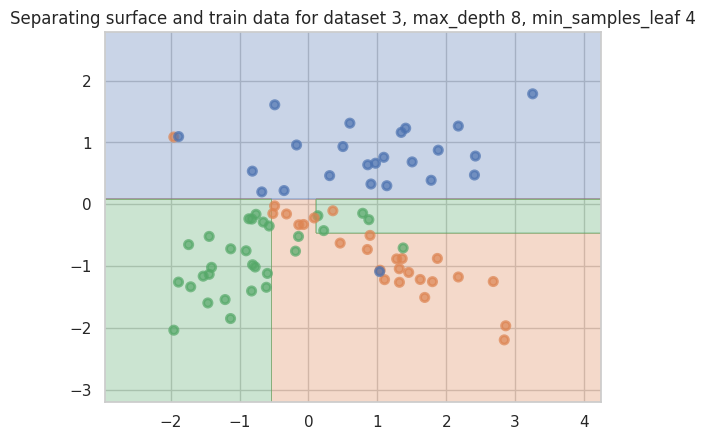

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 4: 0.75


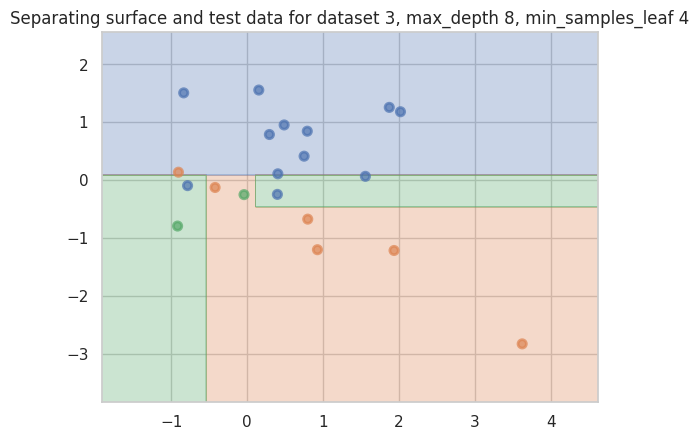

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 5: 0.90


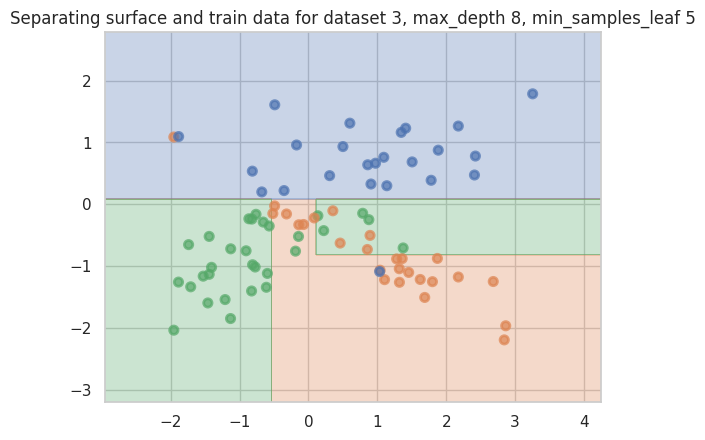

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 5: 0.70


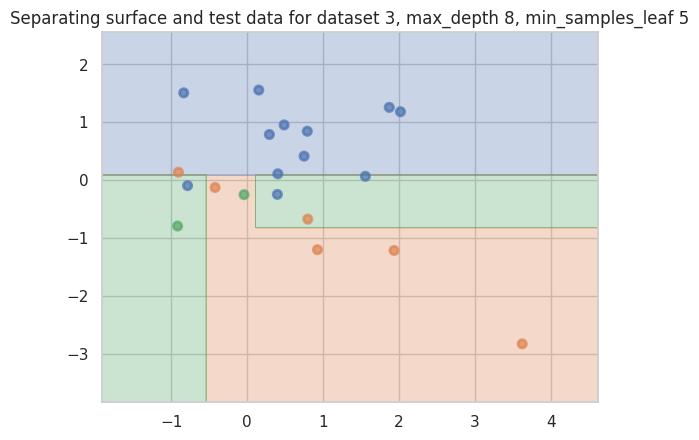

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 6: 0.90


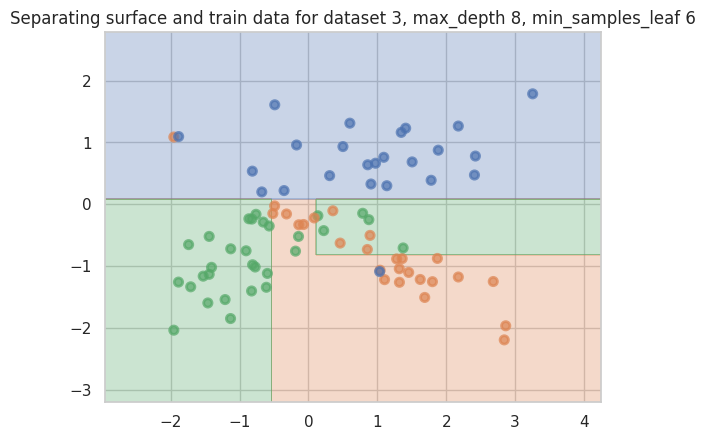

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 6: 0.70


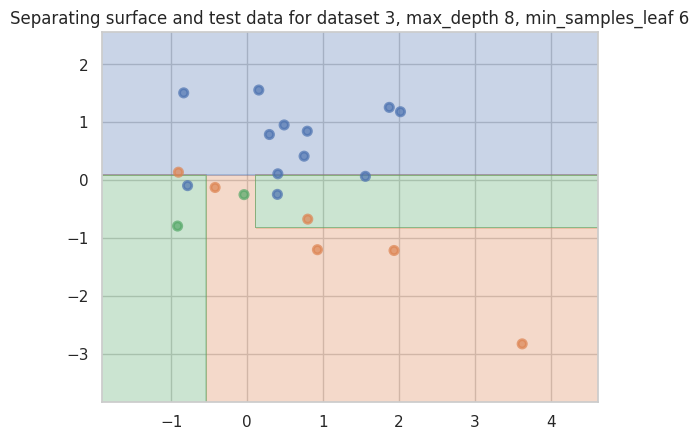

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 7: 0.90


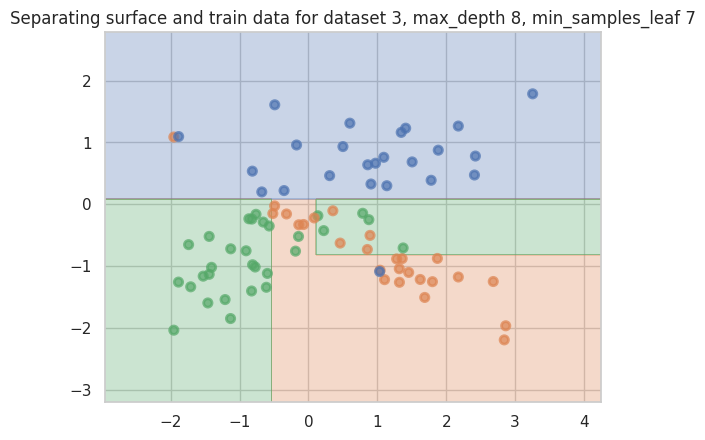

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 7: 0.70


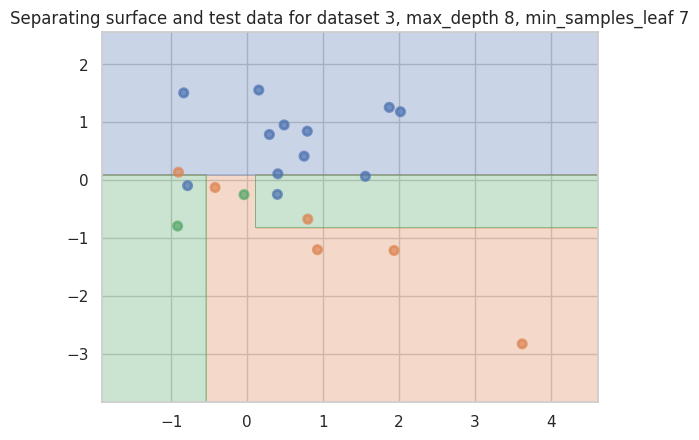

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 8: 0.90


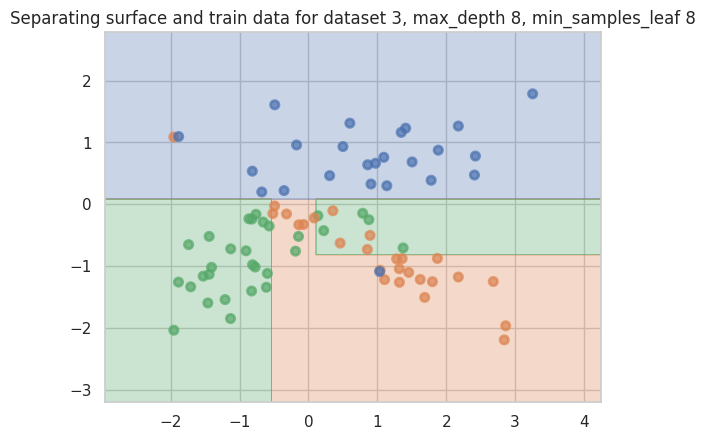

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 8: 0.70


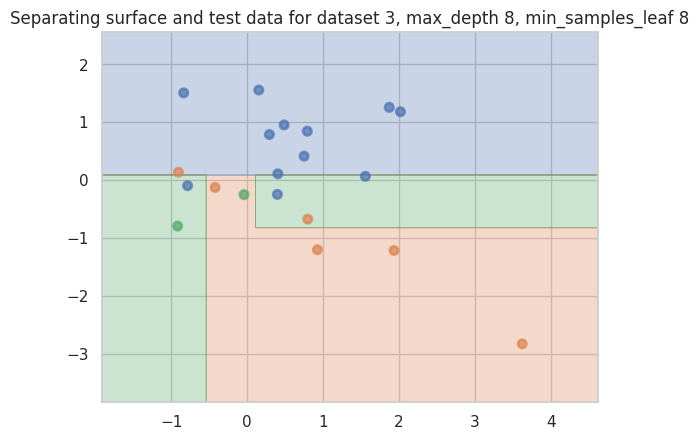

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 9: 0.89


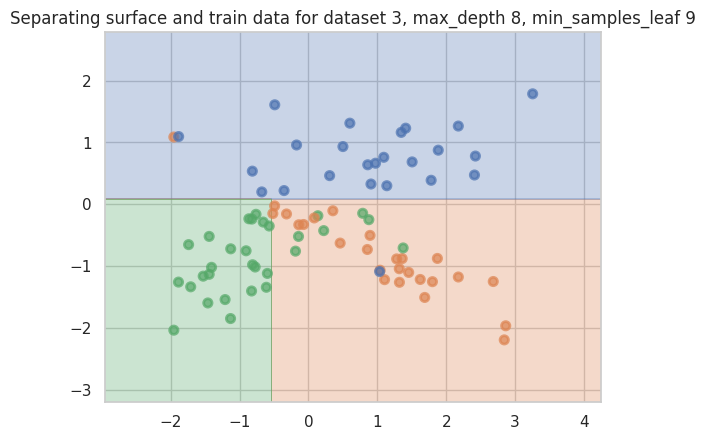

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 9: 0.75


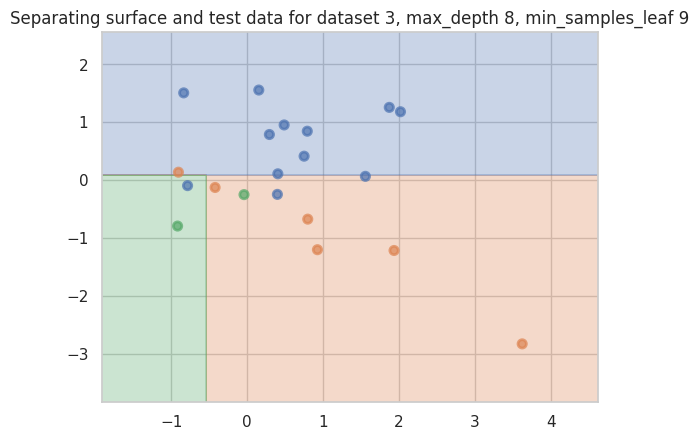

Accuracy on train for dataset 3, max_depth 8, min_samples_leaf 10: 0.89


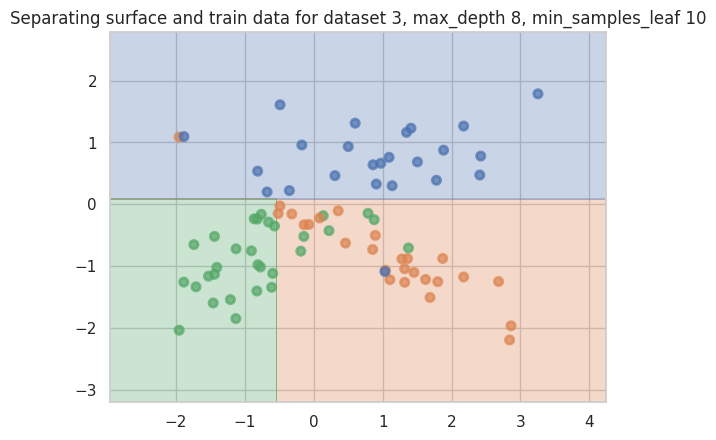

Accuracy on test for dataset 3, max_depth 8, min_samples_leaf 10: 0.75


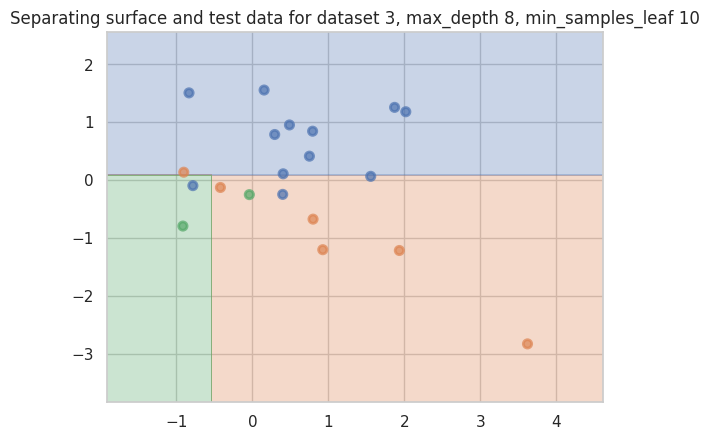

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 1: 1.00


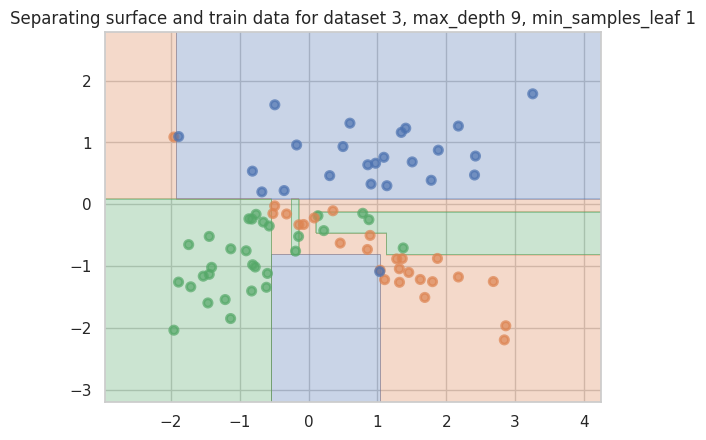

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 1: 0.70


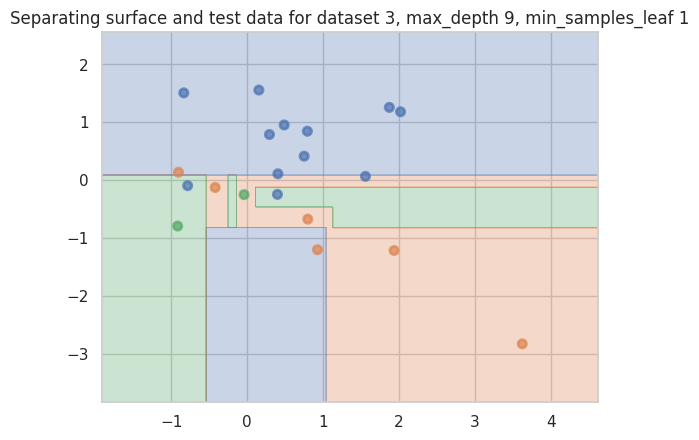

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 2: 0.95


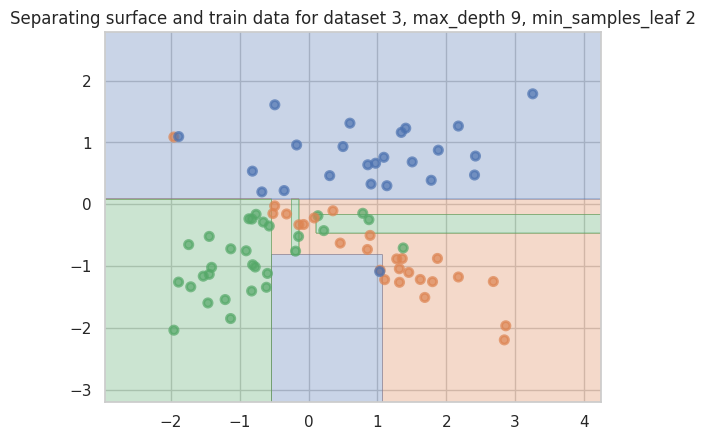

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 2: 0.70


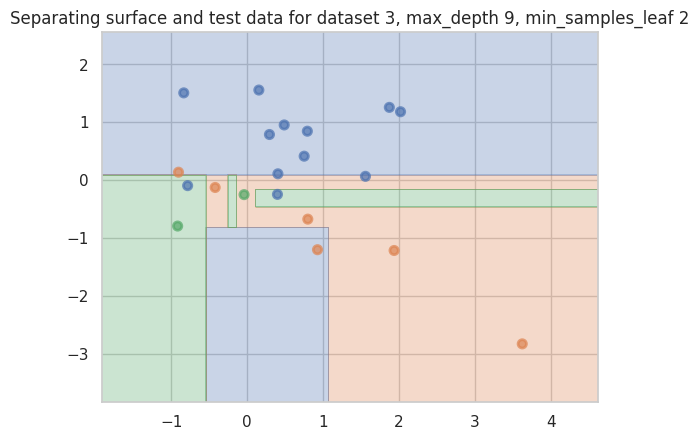

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 3: 0.93


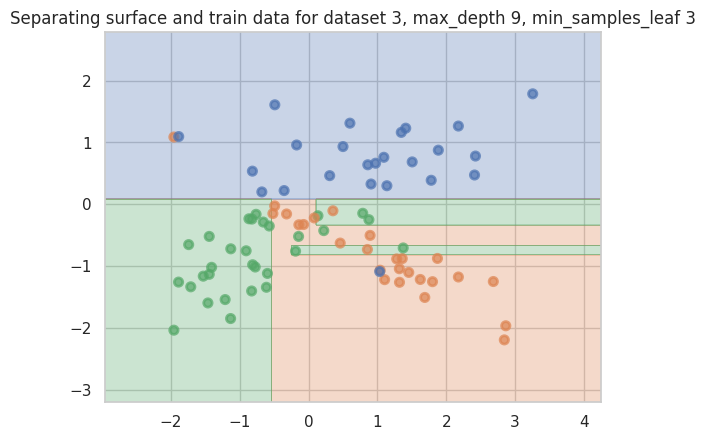

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 3: 0.70


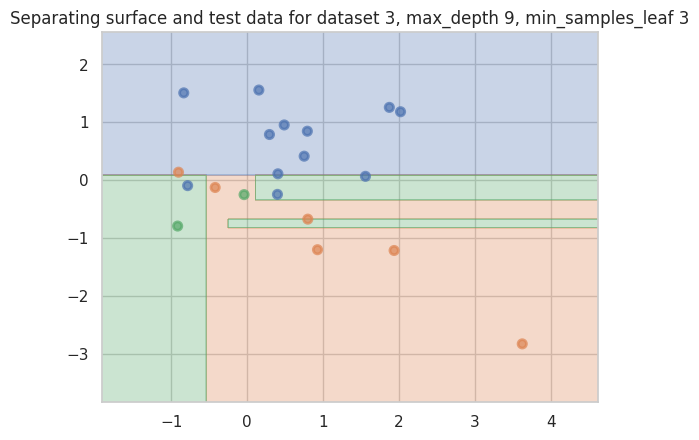

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 4: 0.93


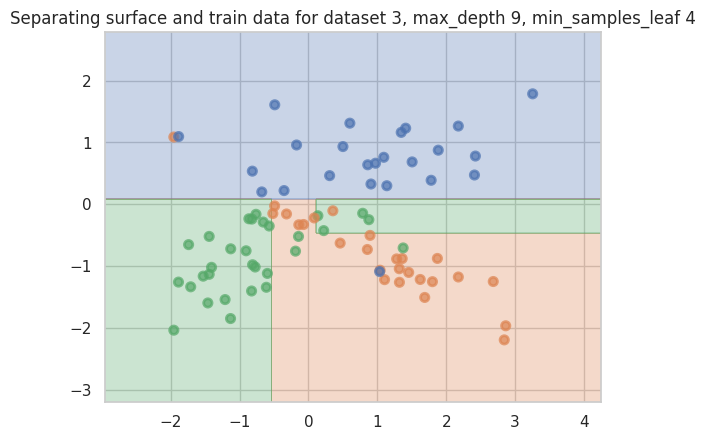

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 4: 0.75


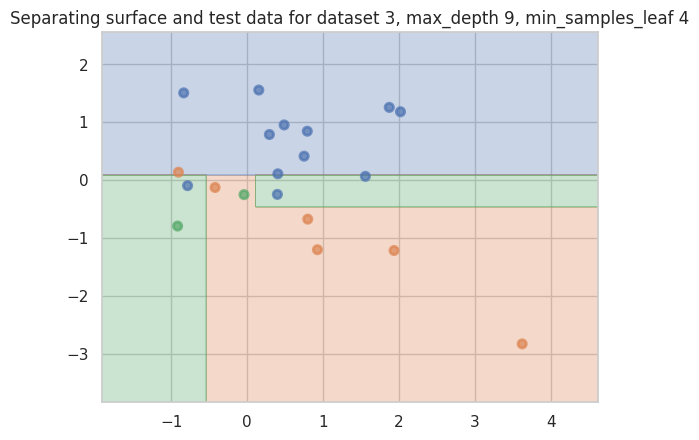

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 5: 0.90


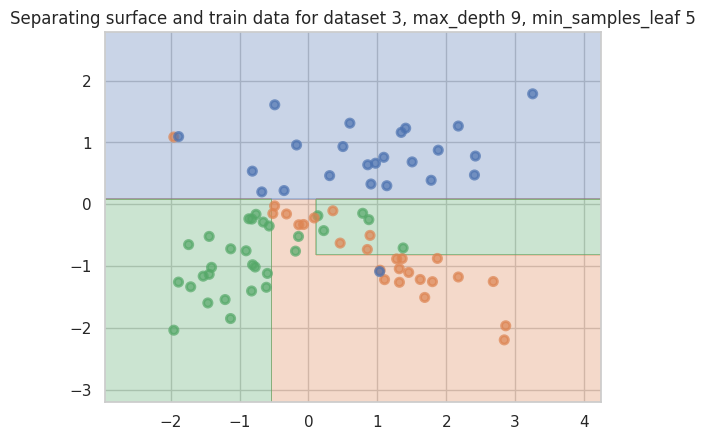

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 5: 0.70


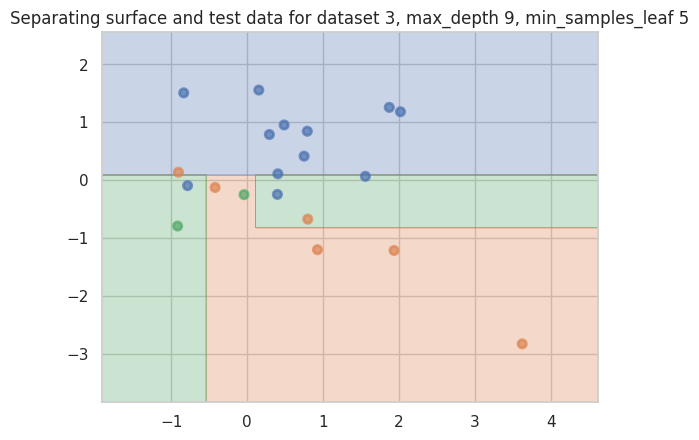

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 6: 0.90


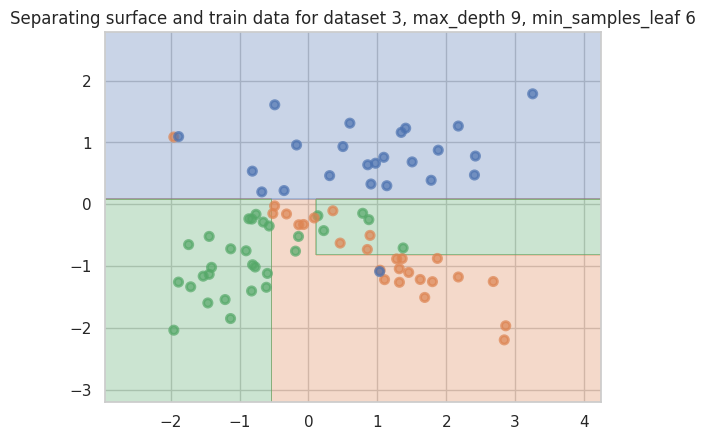

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 6: 0.70


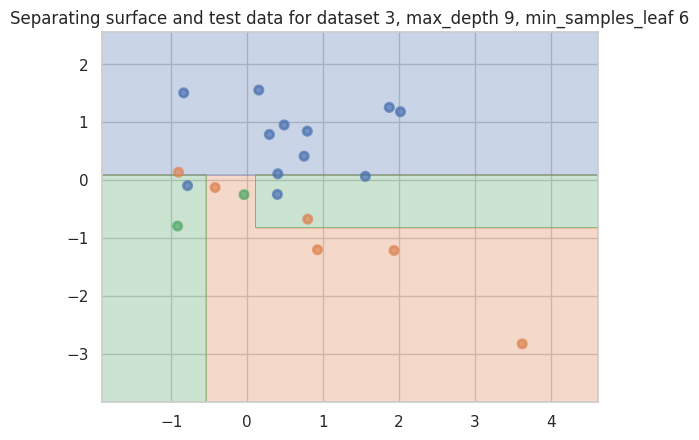

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 7: 0.90


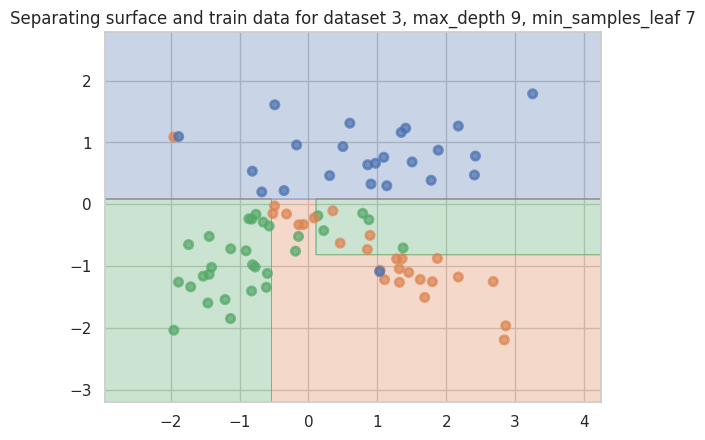

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 7: 0.70


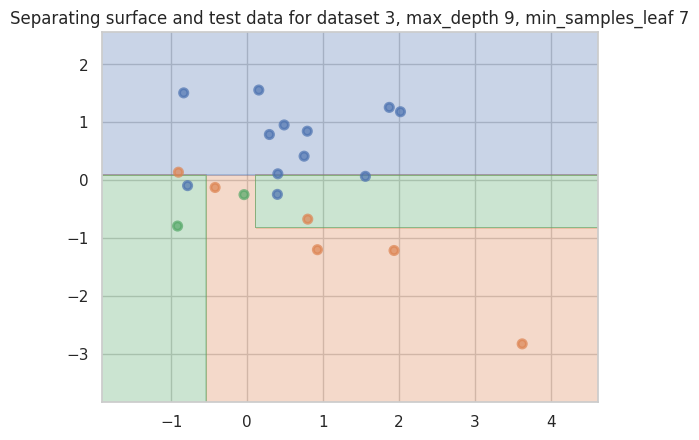

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 8: 0.90


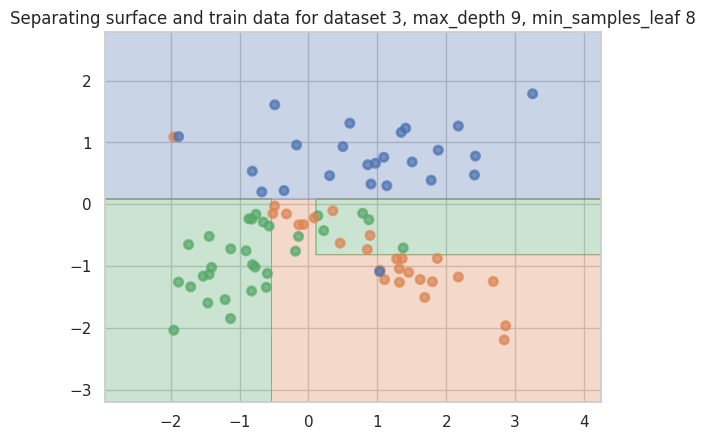

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 8: 0.70


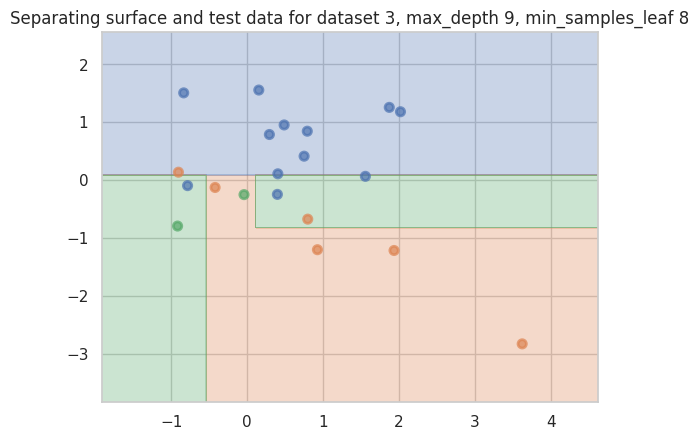

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 9: 0.89


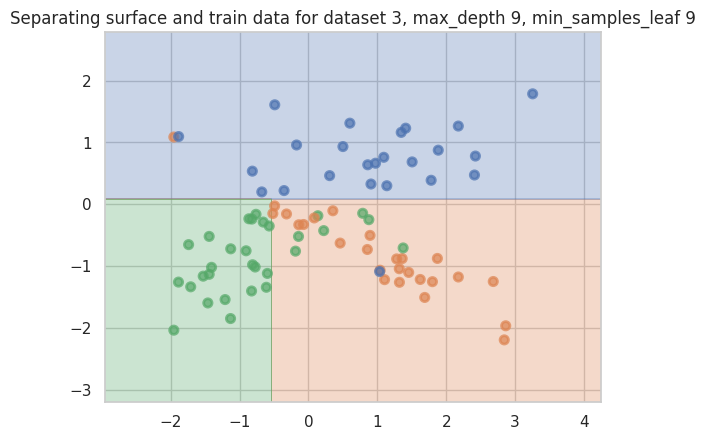

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 9: 0.75


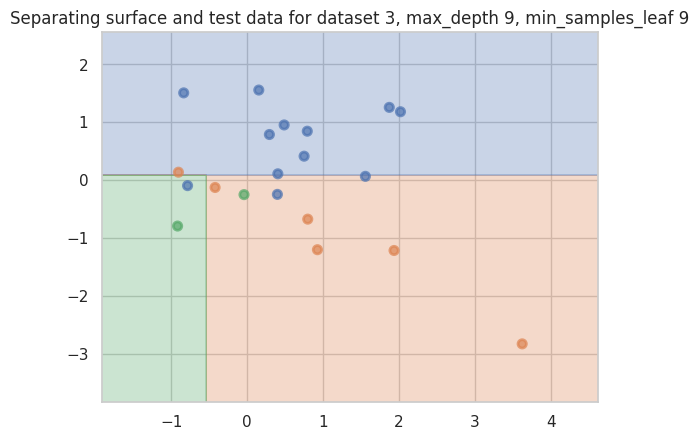

Accuracy on train for dataset 3, max_depth 9, min_samples_leaf 10: 0.89


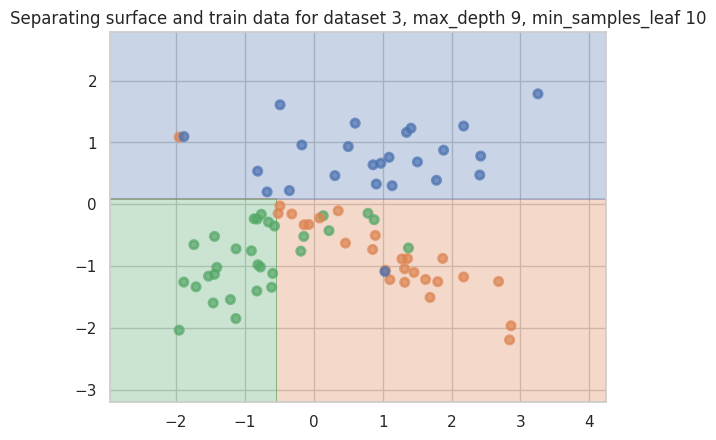

Accuracy on test for dataset 3, max_depth 9, min_samples_leaf 10: 0.75


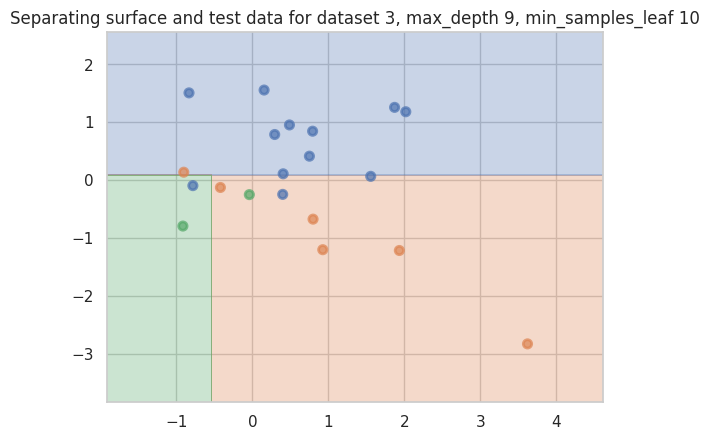

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 1: 1.00


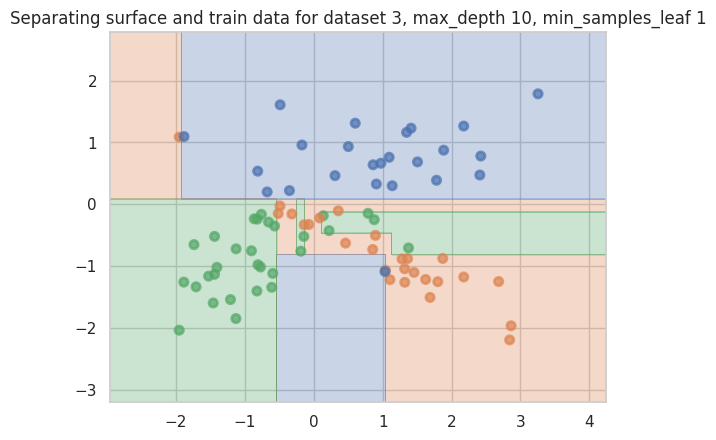

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 1: 0.70


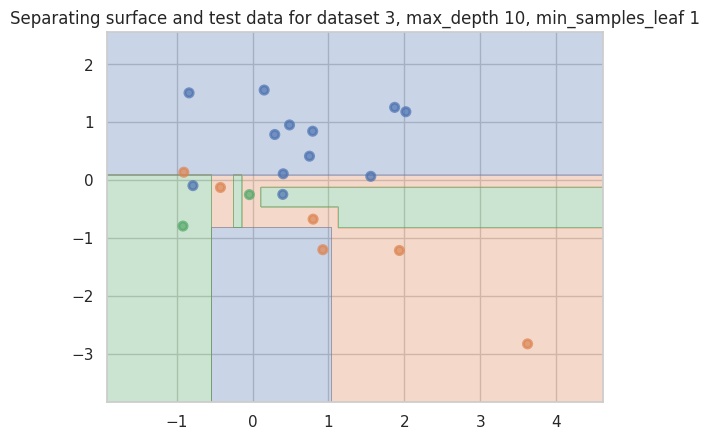

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 2: 0.95


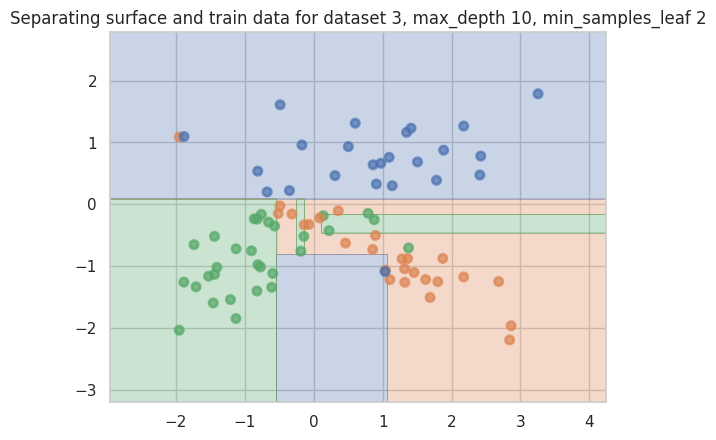

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 2: 0.70


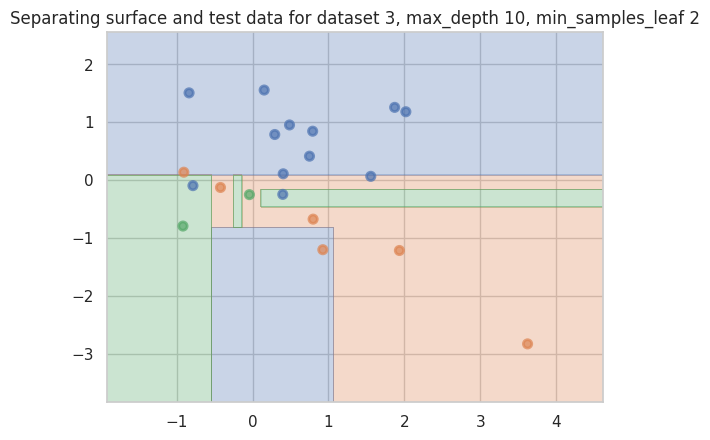

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 3: 0.93


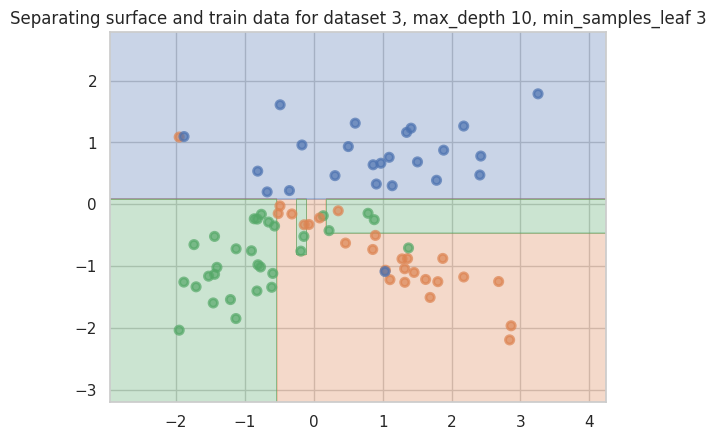

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 3: 0.75


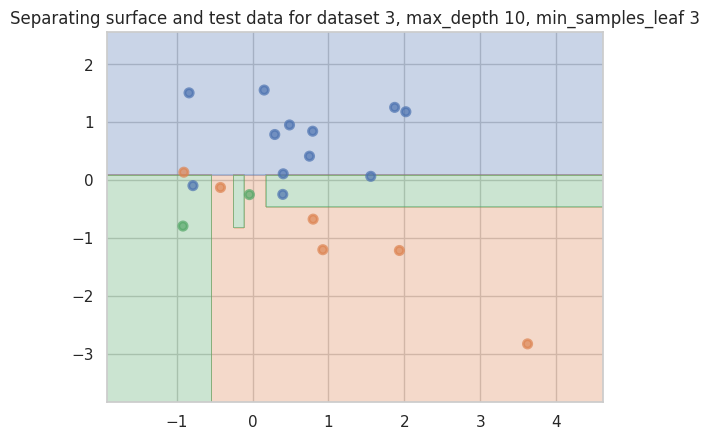

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 4: 0.93


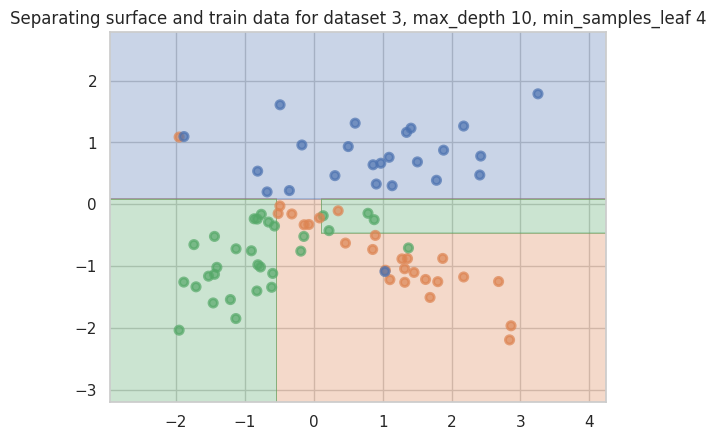

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 4: 0.75


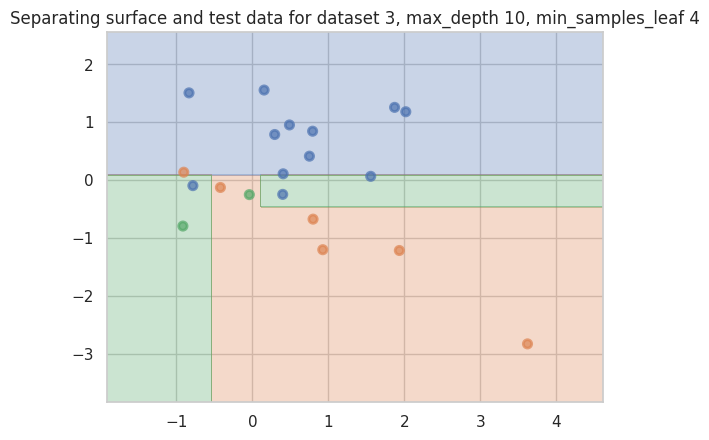

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 5: 0.90


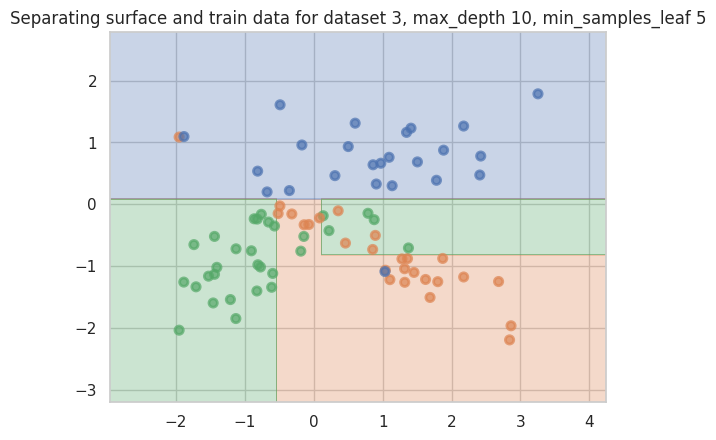

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 5: 0.70


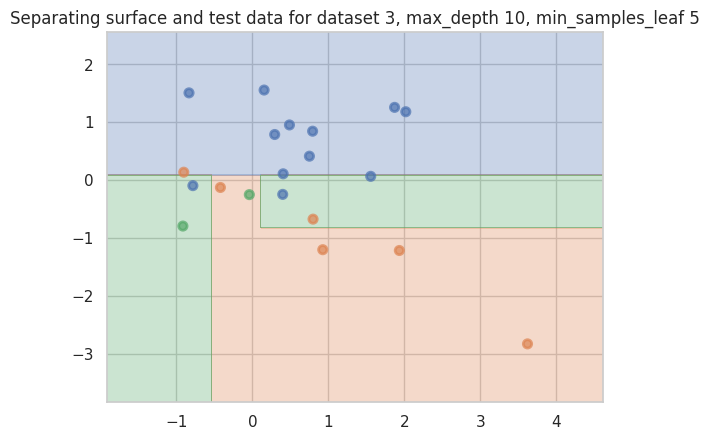

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 6: 0.90


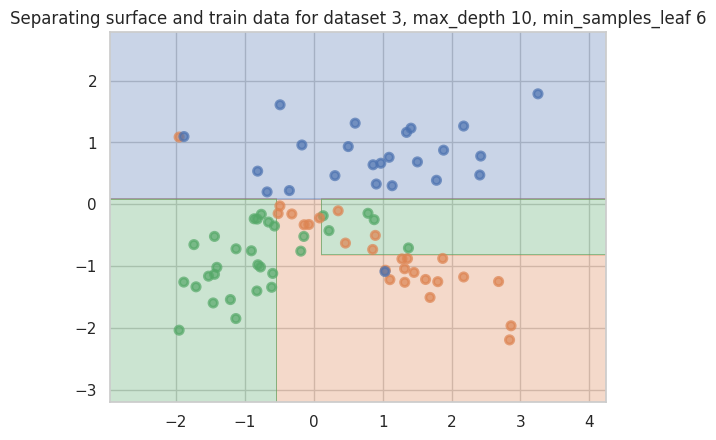

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 6: 0.70


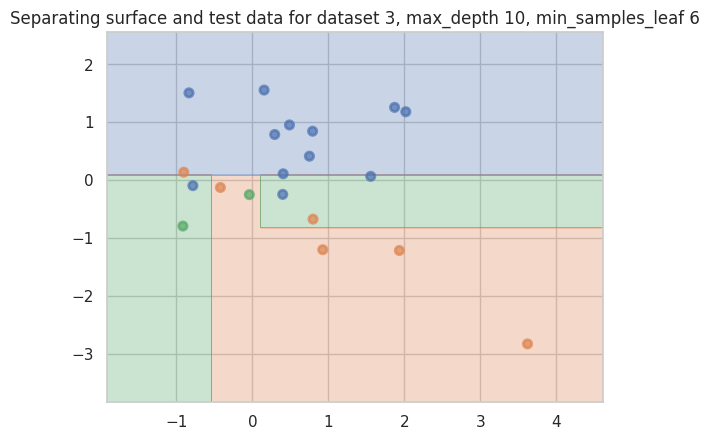

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 7: 0.90


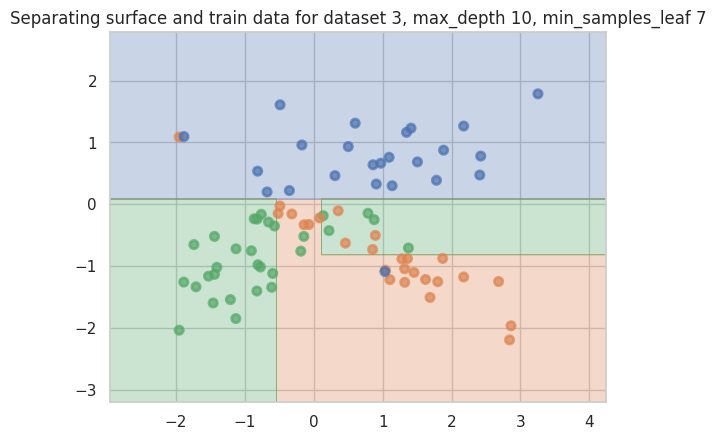

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 7: 0.70


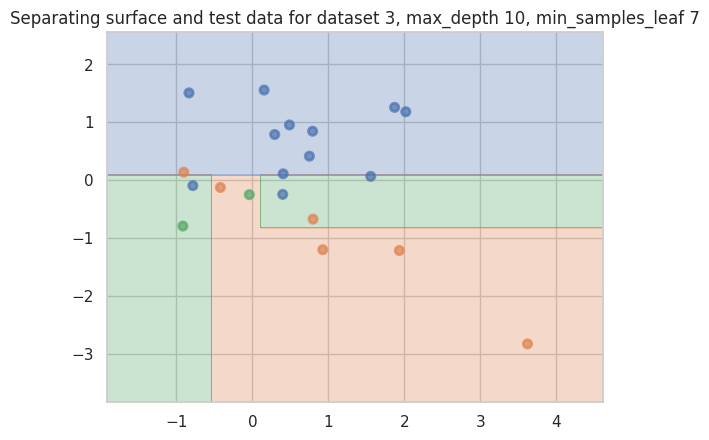

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 8: 0.90


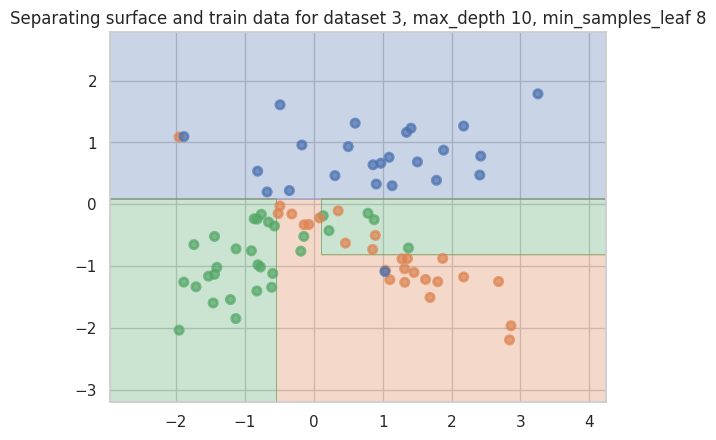

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 8: 0.70


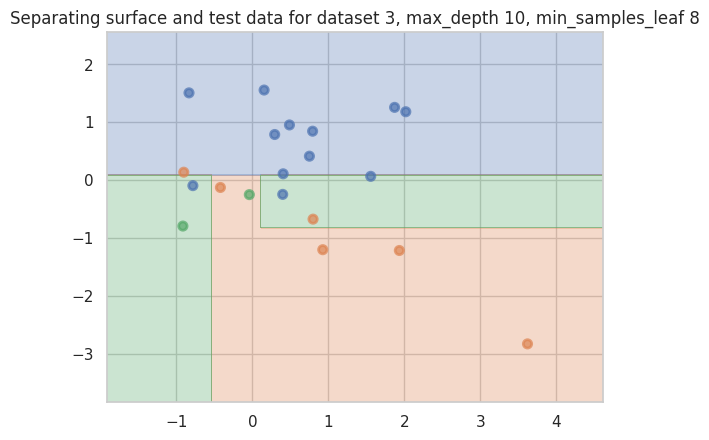

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 9: 0.89


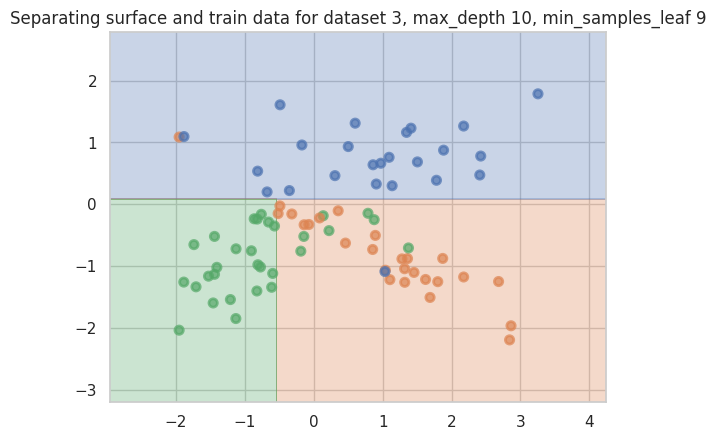

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 9: 0.75


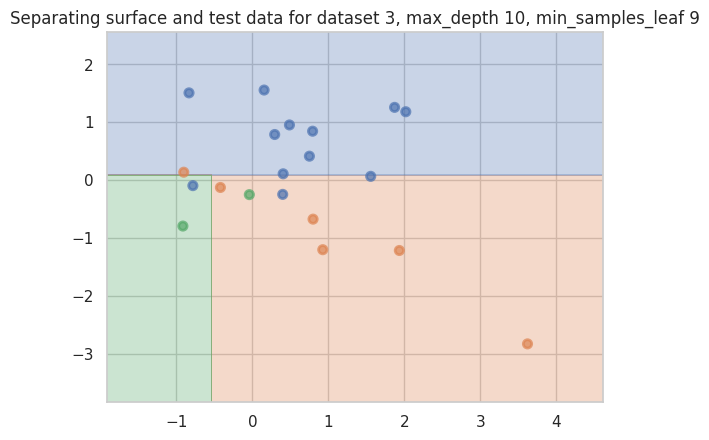

Accuracy on train for dataset 3, max_depth 10, min_samples_leaf 10: 0.89


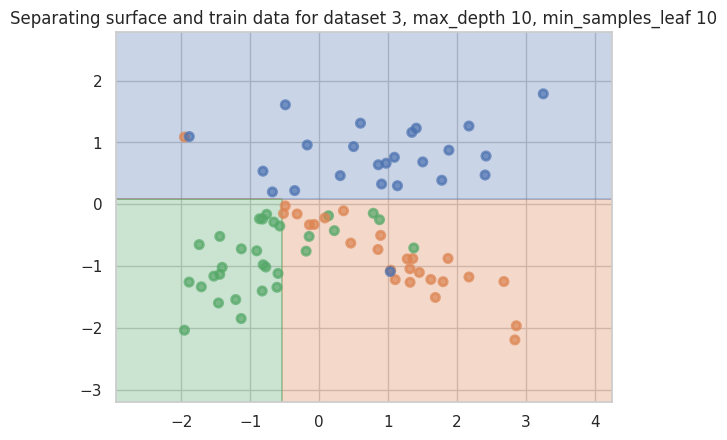

Accuracy on test for dataset 3, max_depth 10, min_samples_leaf 10: 0.75


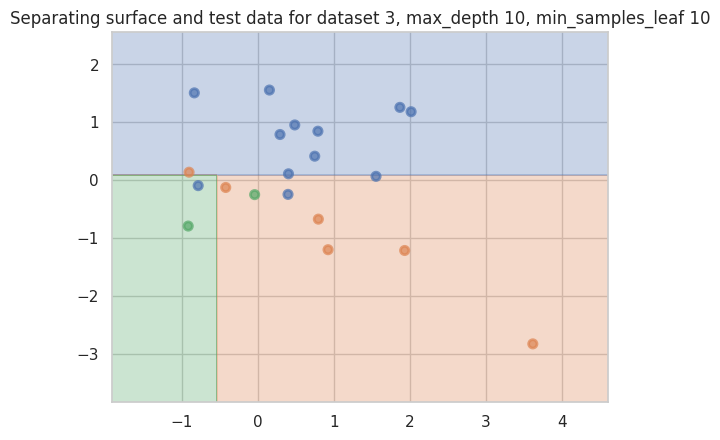

In [21]:
for i in range(3):
    X, y = datasets[i]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    for depth in range(2, 11):
        for samples_leaf in range(1, 11):
            model = DecisionTreeClassifier(max_depth=depth, min_samples_leaf=samples_leaf)
            model.fit(X_train, y_train)
    
            y_train_pred = model.predict(X_train)
            print(f"Accuracy on train for dataset {i+1}, max_depth {depth}, min_samples_leaf {samples_leaf}: {accuracy_score(y_train, y_train_pred):.2f}")
            plot_surface(model, X_train, y_train, f"Separating surface and train data for dataset {i + 1}, max_depth {depth}, min_samples_leaf {samples_leaf}")
            plt.show()
    
            y_test_pred = model.predict(X_test)
            print(f"Accuracy on test for dataset {i+1}, max_depth {depth}, min_samples_leaf {samples_leaf}: {accuracy_score(y_test, y_test_pred):.2f}")
            plot_surface(model, X_test, y_test, f"Separating surface and test data for dataset {i + 1}, max_depth {depth}, min_samples_leaf {samples_leaf}")
            plt.show()

__Ответ:__ в среднем с увеличением глубины модель становится более сложной и достигает лучших (или вообще практически идеальных результатов) на обучающей выборке, но при этом очень-очень быстро переобучается. То же самое происходит при уменьшении минимального количества семплов в листе при фиксированной глубине. Это происходит потому, что, если никак не ограничивать дерево, довольно несложно расставить такие пороги в вершинах, что обучающая выборка будет разделена идеально, но при этом на тестовой качество будет довольно посредственное, поскольку модель слишком сильно подстроилась под единичные примеры из обучающей выборки.

На первых двух датасетах, где структура классов была довольно сложной, для хорошей классификации потребовалась бОльшая глубина дерева (порядка 4-6) и некоторое ограничение min_samples_leaf, чтобы исключить случаи, где у нас есть вершина дерева, отделяющая 1-2 объекта, которые скорее всего являются в некотором смысле выбросами и негативно влияют на обобщающую способность модели. В третьем датасете, где классы были более легко разделимыми, наилучшие результаты показала модель с маленькой глубиной (2-3), ограничение на количество объектов в листе при этом было не очень важно, поскольку маленькая глубина уже обеспечивает не слишком сложную структуру разделяющей поверхности.

# 2. Решающие деревья своими руками

В этой части вам нужно реализовать свой класс для обучения решающего дерева в задаче бинарной классификации с возможностью обработки вещественных и категориальных признаков.

__Задание 3. (1.5 балл)__

Реализуйте функцию find_best_split из модуля hw5code.py

__Задание 4. (0.5 балла)__

Загрузите таблицу [students.csv](https://github.com/esokolov/ml-course-hse/blob/master/2022-fall/homeworks-practice/homework-practice-05-trees/students.csv) (это немного преобразованный датасет [User Knowledge](https://archive.ics.uci.edu/ml/datasets/User+Knowledge+Modeling)). В ней признаки объекта записаны в первых пяти столбцах, а в последнем записана целевая переменная (класс: 0 или 1). Постройте на одном изображении пять кривых "порог — значение критерия Джини" для всех пяти признаков. Отдельно визуализируйте scatter-графики "значение признака — класс" для всех пяти признаков.

In [218]:
df = pd.read_csv('students.csv')
df.head(5)

,STG,SCG,STR,LPR,PEG,UNS
0,0.00,0.00,0.00,0.00,0.00,0
1,0.08,0.08,0.10,0.24,0.90,1
2,0.06,0.06,0.05,0.25,0.33,0
3,0.10,0.10,0.15,0.65,0.30,1
4,0.08,0.08,0.08,0.98,0.24,0


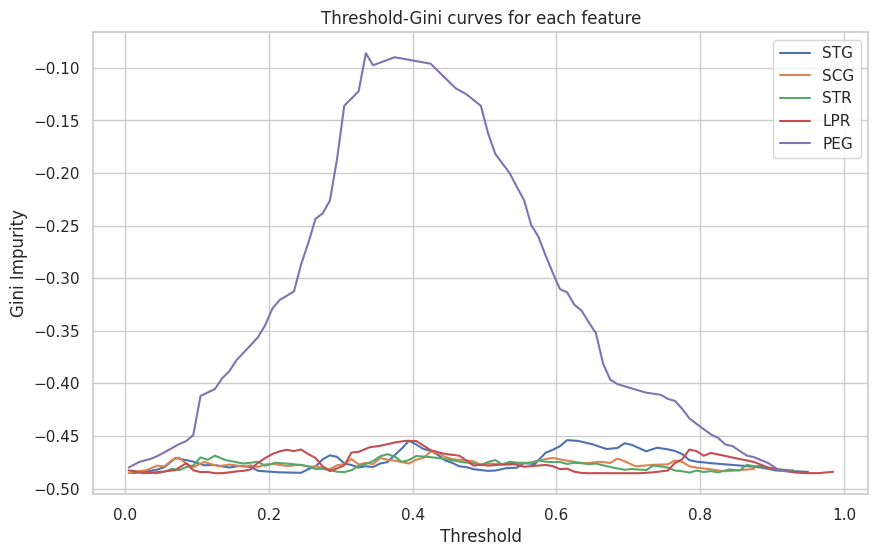

In [219]:
from hw5code import find_best_split

plt.figure(figsize=(10, 6))

for feature in df.columns[:-1]:
    thresholds, ginis, _, _ = find_best_split(df[feature].to_numpy(), df['UNS'].to_numpy())
    sns.lineplot(x=thresholds, y=ginis, label=feature)

plt.title('Threshold-Gini curves for each feature')
plt.xlabel('Threshold')
plt.ylabel('Gini Impurity')
plt.legend()
plt.show()

По не PEG признакам ничего не видно, давайте их ещё на отдельном графике нарисуем.

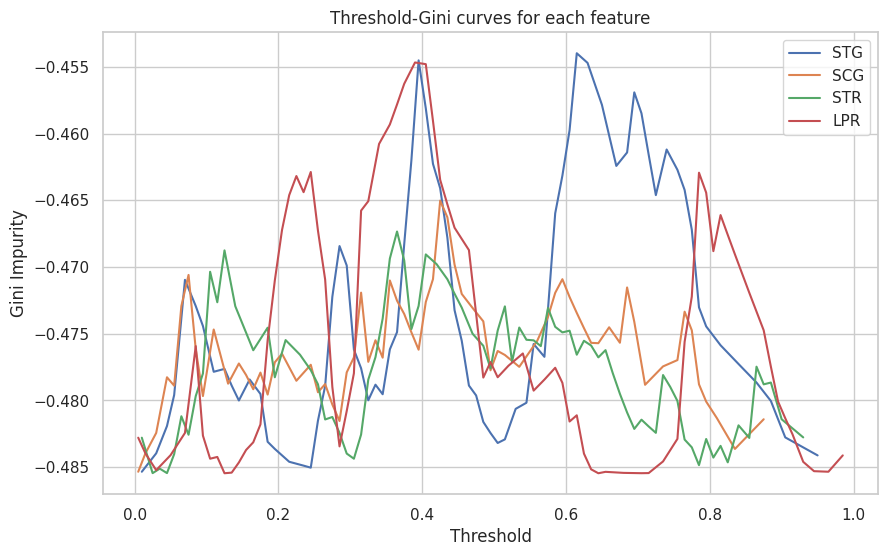

In [220]:
plt.figure(figsize=(10, 6))

for feature in df.columns[:-2]:
    thresholds, ginis, _, _ = find_best_split(df[feature].to_numpy(), df['UNS'].to_numpy())
    sns.lineplot(x=thresholds, y=ginis, label=feature)

plt.title('Threshold-Gini curves for each feature')
plt.xlabel('Threshold')
plt.ylabel('Gini Impurity')
plt.legend()
plt.show()

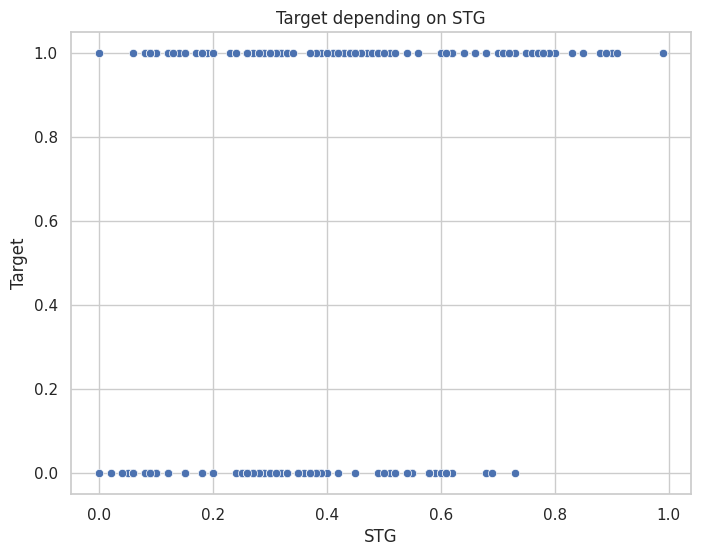

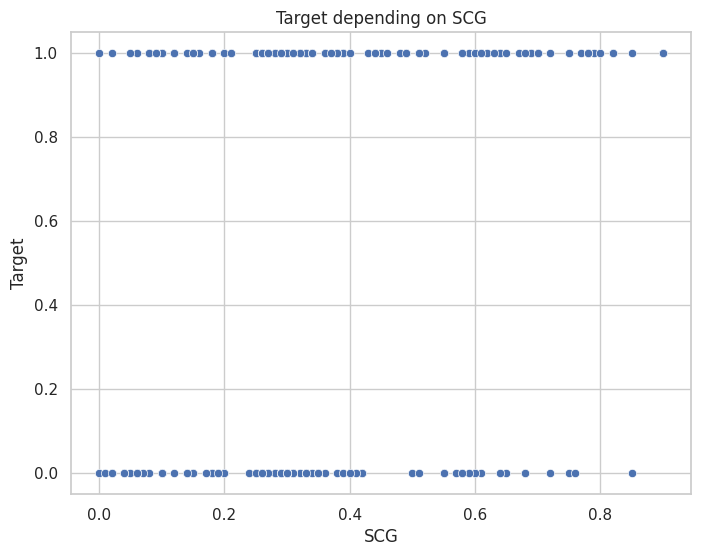

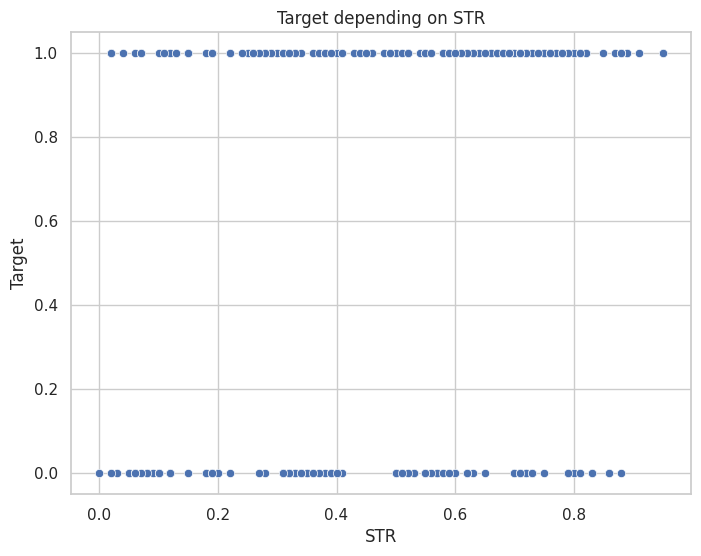

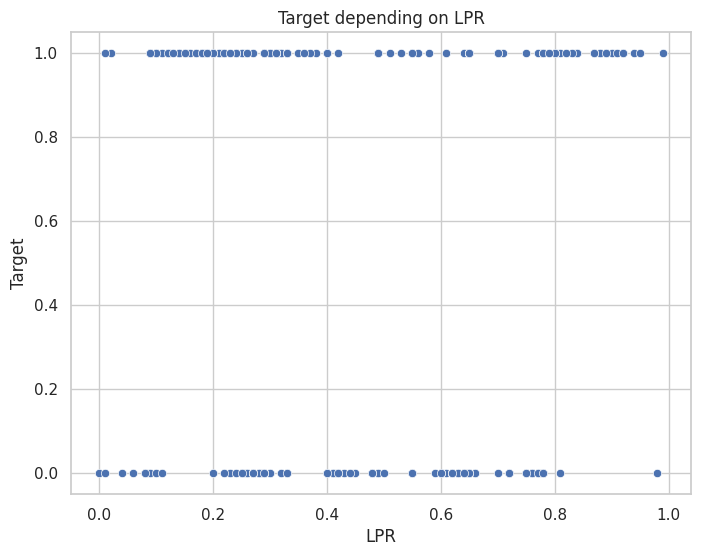

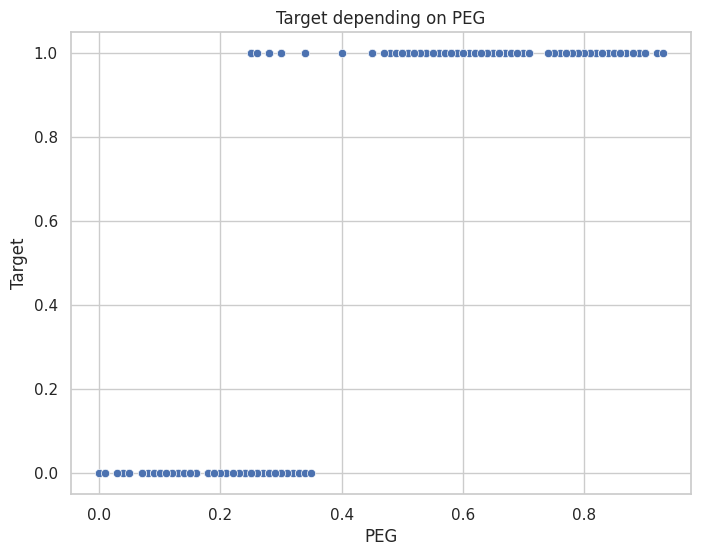

In [221]:
for feature in df.columns[:-1]:
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=feature, y='UNS', data=df)
    plt.title(f'Target depending on {feature}')
    plt.xlabel(feature)
    plt.ylabel('Target')
    plt.show()

__Задание 5. (0.5 балла)__

Исходя из кривых значений критерия Джини, по какому признаку нужно производить деление выборки на два поддерева? Согласуется ли этот результат с визуальной оценкой scatter-графиков? Как бы охарактеризовали вид кривой для "хороших" признаков, по которым выборка делится почти идеально? Чем отличаются кривые для признаков, по которым деление практически невозможно?

**Ответ:** судя по значениям кривых, делить на два поддерева выборку нужно по признаку PEG: его максимальное значение функционала на выборке сильно больше, чем у остальных признаков, то есть он наиболее адекватно разделяет выборку на два класса на первой же итерации. Это рассуждение согласуется и со scatter-графиками: PEG чуть ли не идеально разделяет выборку на два класса, в то время как в остальных признаках сложно увидеть зависимости невооружённым глазом (ну разве что в STG у 0 класса не бывает значений > 0.8, но это совсем как-то притянуто за уши).

Кривая PEG практически уинмодальна, то есть сначала значение критерия Джини маленькое, потом оно растёт, достигает своего максимума и вновь начинает снижаться. Это согласуется с логикой разделения на два поддерева: в идеале мы хотим, чтобы в левой части оказались объекты одного класса, а в правой --- другого, и чтобы порог их хорошо разделил. А значит, по мере приближения к <<идеальному>> разделению, мы всё больше объектов будем относить к правильному классу, и функционал будет всё лучше. Это кривая <<хорошего>> признака. Для <<плохих>> признаков кривая будет постоянно скакать туда-сюда, в ней будет много сильно отличающихся разбиений с практически одинаковым функционалам. У большинства других признаков кривые именно такие.

__Задание 6. (1.5 балла).__

Разберитесь с уже написанным кодом в классе DecisionTree модуля hw5code.py. Найдите ошибки в реализации метода \_fit_node. Напишите функцию \_predict_node.

 Построение дерева осуществляется согласно базовому жадному алгоритму, предложенному в [лекции](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture07-trees.pdf) в разделе «Построение дерева». Выбор лучшего разбиения необходимо производить по критерию Джини. Критерий останова: все объекты в листе относятся к одному классу или ни по одному признаку нельзя разбить выборку. Ответ в листе: наиболее часто встречающийся класс в листе. Для категориальных признаков выполняется преобразование, описанное в лекции в разделе «Учет категориальных признаков».

__Задание 7. (0.5 балла)__

Протестируйте свое решающее дерево на датасете [mushrooms](https://archive.ics.uci.edu/ml/datasets/Mushroom). Вам нужно скачать таблицу agaricus-lepiota.data (лежит на гитхабе вместе с заданием), прочитать ее с помощью pandas, применить к каждому столбцу LabelEncoder (из sklearn), чтобы преобразовать строковые имена категорий в натуральные числа. Первый столбец — это целевая переменная (e — edible, p — poisonous) Мы будем измерять качество с помощью accuracy, так что нам не очень важно, что будет классом 1, а что — классом 0. Обучите решающее дерево на половине случайно выбранных объектов (признаки в датасете категориальные) и сделайте предсказания для оставшейся половины. Вычислите accuracy.

У вас должно получиться значение accuracy, равное единице (или очень близкое к единице), и не очень глубокое дерево.

In [222]:
mushrooms = pd.read_csv('agaricus-lepiota.data')
mushrooms.head(5)

,p,x,s,n,t,p.1,f,c,n.1,k,...,s.2,w,w.1,p.2,w.2,o,p.3,k.1,s.3,u
0,e,x,s,y,t,a,f,c,b,k,...,s,w,w,p,w,o,p,n,n,g
1,e,b,s,w,t,l,f,c,b,n,...,s,w,w,p,w,o,p,n,n,m
2,p,x,y,w,t,p,f,c,n,n,...,s,w,w,p,w,o,p,k,s,u
3,e,x,s,g,f,n,f,w,b,k,...,s,w,w,p,w,o,e,n,a,g
4,e,x,y,y,t,a,f,c,b,n,...,s,w,w,p,w,o,p,k,n,g


In [223]:
from sklearn.preprocessing import LabelEncoder
from hw5code import DecisionTree

label_encoder = LabelEncoder()

for column in mushrooms.columns:
    mushrooms[column] = label_encoder.fit_transform(mushrooms[column])

X_mushrooms, y_mushrooms = mushrooms.drop('p', axis=1), mushrooms['p']

X_train, X_test, y_train, y_test = train_test_split(X_mushrooms, y_mushrooms, test_size=0.5, random_state=42)

model = DecisionTree(['categorical'] * X.shape[1])
model.fit(np.array(X_train), np.array(y_train))
y_pred = model.predict(np.array(X_test))

print('Test accuracy:', accuracy_score(y_pred, y_test))

Test accuracy: 1.0


__Задание 8. (бонус, 1 балл)__

Реализуйте в классе DecisionTree поддержку параметров max_depth, min_samples_split и min_samples_leaf по аналогии с DecisionTreeClassifier. Постройте графики зависимости качества предсказания в зависимости от этих параметров для набора данных tic-tac-toe (см. следующий пункт).

__Задание 9. (2 балла)__

Загрузите следующие наборы данных (напомним, что pandas умеет загружать файлы по url, в нашем случае это файл \*.data), предварительно ознакомившись с описанием признаков и целевой переменной в каждом из них (она записаны в Data Folder, в файле *.names): 
* [mushrooms](https://archive.ics.uci.edu/ml/datasets/Mushroom) (загрузили в предыдущем пункте, классы записаны в нулевом столбце)
* [tic-tac-toe](https://archive.ics.uci.edu/ml/datasets/Tic-Tac-Toe+Endgame) (классы записаны в последнем столбце, датасет лежит на гитхабе вместе с заданием)
* [cars](https://archive.ics.uci.edu/ml/datasets/Car+Evaluation) (классы записаны в последнем столбце, считаем что unacc, acc — это класс 0, good, vgood — класс 1)
* [nursery](https://archive.ics.uci.edu/ml/datasets/Nursery) (классы записаны в последнем столбце, считаем, что not_recom и recommend — класс 0, very_recom, priority, spec_prior — класс 1).

Закодируйте категориальные признаки, использовав LabelEncoder. С помощью cross_val_score (cv=10) оцените accuracy на каждом из этих наборов данных следующих алгоритмов:
* DecisionTree, считающий все признаки вещественными
* DecisionTree, считающий все признаки категориальными
* DecisionTree, считающий все признаки вещественными + one-hot-encoding всех признаков
* DecisionTreeClassifier из sklearn. Запишите результат в pd.DataFrame (по строкам — наборы данных, по столбцам — алгоритмы).

Рекомендации:
* Чтобы cross_val_score вычисляла точность, нужно передать scoring=make_scorer(accuracy_score), обе фукнции из sklearn.metrics.
* Если вам позволяет память (а она скорее всего позволяет), указывайте параметр sparse=False в OneHotEncoder (если вы, конечно, используете его). Иначе вам придется добиваться того, чтобы ваша реализация дерева умела работать с разреженными матрицами (что тоже, в целом, не очень сложно).

In [224]:
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/tic-tac-toe/tic-tac-toe.data
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/car/car.data
!wget https://archive.ics.uci.edu/ml/machine-learning-databases/nursery/nursery.data

--2023-12-13 04:52:50--  https://archive.ics.uci.edu/ml/machine-learning-databases/tic-tac-toe/tic-tac-toe.data
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘tic-tac-toe.data.3’

tic-tac-toe.data.3      [  <=>               ]  25,26K  62,0KB/s    in 0,4s    

2023-12-13 04:52:52 (62,0 KB/s) - ‘tic-tac-toe.data.3’ saved [25866]

--2023-12-13 04:52:52--  https://archive.ics.uci.edu/ml/machine-learning-databases/car/car.data
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘car.data.3’

car.data.3              [   <=>              ]  50,65K   117KB/s    in 0,4s    

2023-12-13 04:52:53 (117 KB/s) - ‘car.data.3’ sa

In [225]:
mushrooms = pd.read_csv('agaricus-lepiota.data')
tic_tac = pd.read_csv('tic-tac-toe.data')
cars = pd.read_csv('car.data')
nursery = pd.read_csv('nursery.data')

In [226]:
tic_tac.head(5)

,x,x.1,x.2,x.3,o,o.1,x.4,o.2,o.3,positive
0,x,x,x,x,o,o,o,x,o,positive
1,x,x,x,x,o,o,o,o,x,positive
2,x,x,x,x,o,o,o,b,b,positive
3,x,x,x,x,o,o,b,o,b,positive
4,x,x,x,x,o,o,b,b,o,positive


In [227]:
cars.head(5)

,vhigh,vhigh.1,2,2.1,small,low,unacc
0,vhigh,vhigh,2,2,small,med,unacc
1,vhigh,vhigh,2,2,small,high,unacc
2,vhigh,vhigh,2,2,med,low,unacc
3,vhigh,vhigh,2,2,med,med,unacc
4,vhigh,vhigh,2,2,med,high,unacc


In [228]:
nursery.head(5)

,usual,proper,complete,1,convenient,convenient.1,nonprob,recommended,recommend
0,usual,proper,complete,1,convenient,convenient,nonprob,priority,priority
1,usual,proper,complete,1,convenient,convenient,nonprob,not_recom,not_recom
2,usual,proper,complete,1,convenient,convenient,slightly_prob,recommended,recommend
3,usual,proper,complete,1,convenient,convenient,slightly_prob,priority,priority
4,usual,proper,complete,1,convenient,convenient,slightly_prob,not_recom,not_recom


In [229]:
mushrooms['p'] = mushrooms['p'].replace({'e': 0, 'p': 1})
tic_tac['positive'] = tic_tac['positive'].replace({'negative': 0, 'positive': 1})
cars['unacc'] = cars['unacc'].replace({'unacc': 0, 'acc': 0, 'good': 1, 'vgood': 1})
nursery['recommend'] = nursery['recommend'].replace({'not_recom': 0, 'recommend': 0, 'very_recom': 1, 'priority': 1, 'spec_prior': 1})

In [230]:
def label_encoding(df, target):
    X, y = df.drop(target, axis = 1), df[target]
    for column in X.columns:
        X[column] = label_encoder.fit_transform(X[column])
    return X, y

X_mushrooms, y_mushrooms = label_encoding(mushrooms, 'p')
X_tic_tac, y_tic_tac = label_encoding(tic_tac, 'positive')
X_cars, y_cars = label_encoding(cars, 'unacc')
X_nursery, y_nursery = label_encoding(nursery, 'recommend')

In [231]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer

ohe = OneHotEncoder(sparse=False)
results = pd.DataFrame(columns=['real', 'categorical', 'real+ohe', 'sklearn'])

def get_results(X, y, df_name):
    model = DecisionTree(['real'] * X.shape[1])
    acc_real = np.mean(cross_val_score(model, X = np.array(X), y = np.array(y), cv = 10, scoring = make_scorer(accuracy_score)))

    model = DecisionTree(['categorical'] * X.shape[1])
    acc_categorical = np.mean(cross_val_score(model, X = np.array(X), y = np.array(y), cv = 10, scoring = make_scorer(accuracy_score)))

    X_ohe = ohe.fit_transform(X)
    model = DecisionTree(['real'] * X_ohe.shape[1])
    acc_real_ohe = np.mean(cross_val_score(model, X = np.array(X_ohe), y = np.array(y), cv = 10, scoring = make_scorer(accuracy_score)))

    model = DecisionTreeClassifier()
    acc_sklearn = np.mean(cross_val_score(model, X = np.array(X), y = np.array(y), cv = 10, scoring = make_scorer(accuracy_score)))

    results.loc[df_name] = [acc_real, acc_categorical, acc_real_ohe, acc_sklearn]
    
get_results(X_mushrooms, y_mushrooms, 'mushrooms')
get_results(X_tic_tac, y_tic_tac, 'tic-tac-toe')
get_results(X_cars, y_cars, 'cars')
get_results(X_nursery, y_nursery, 'nursery')

results

,real,categorical,real+ohe,sklearn
mushrooms,0.999261,1.000000,0.999631,0.958290
tic-tac-toe,0.462697,0.549265,0.553520,0.758004
cars,0.942600,0.967519,0.921767,0.944952
nursery,0.999846,0.999923,0.999769,0.999846


In [232]:
def calc_acc(max_depth = None, min_samples_split = None, min_samples_leaf = None):
    model = DecisionTree(['categorical'] * X_train.shape[1], max_depth, min_samples_split, min_samples_leaf)
    return np.mean(cross_val_score(model, X = np.array(X_tic_tac), y = np.array(y_tic_tac), cv = 10, scoring = make_scorer(accuracy_score)))

acc_by_max_depth = []
acc_by_min_samples_split = []
acc_by_min_samples_leaf = []

for i in range(1, 21):
    acc_by_max_depth.append(calc_acc(max_depth=i))
    acc_by_min_samples_split.append(calc_acc(min_samples_split=i))
    acc_by_min_samples_leaf.append(calc_acc(min_samples_leaf=i))

acc_by_max_depth = np.array(acc_by_max_depth)
acc_by_min_samples_split = np.array(acc_by_min_samples_split)
acc_by_min_samples_leaf = np.array(acc_by_min_samples_leaf)

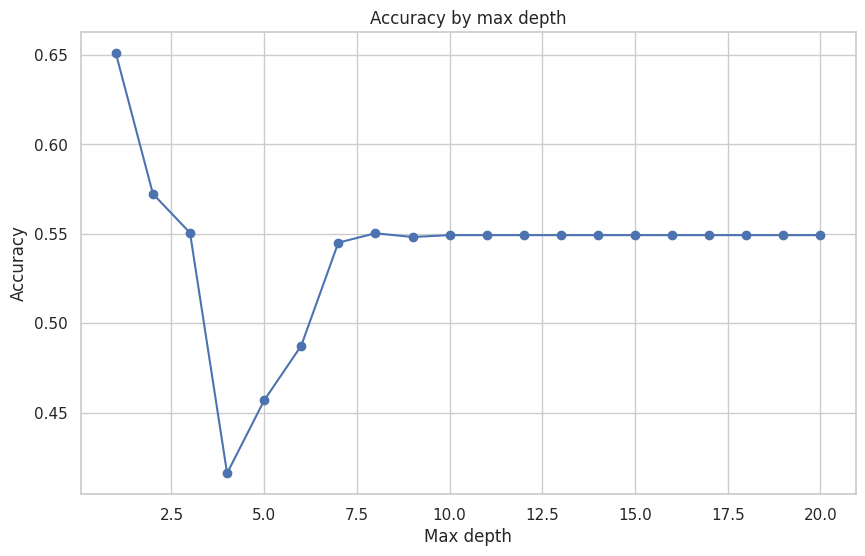

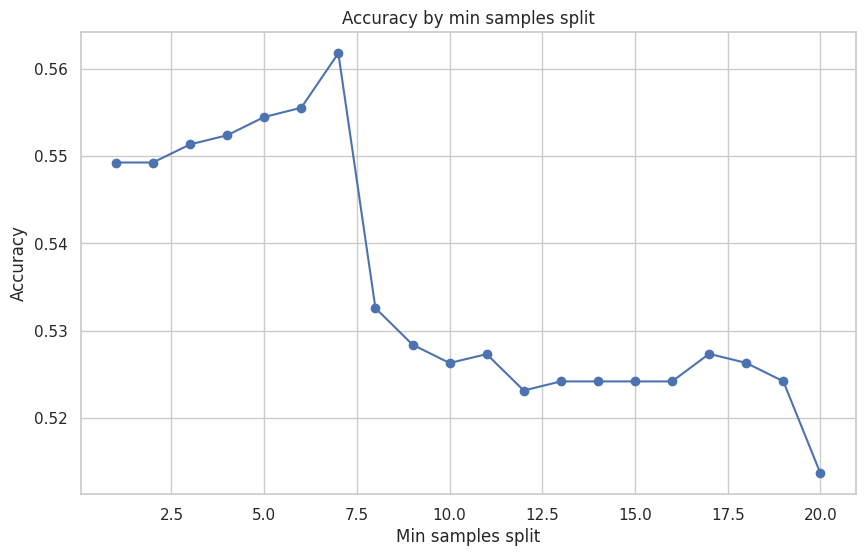

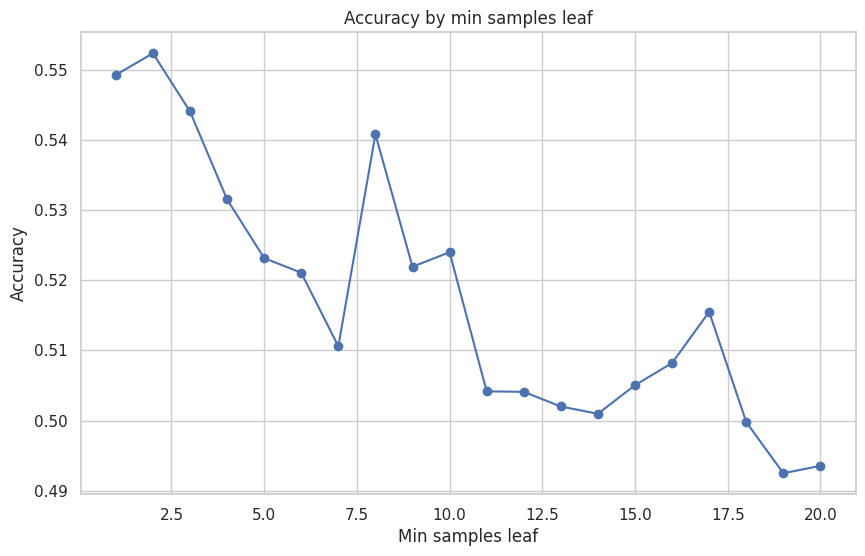

In [233]:
idx = np.arange(1, len(acc_by_max_depth) + 1)

plt.figure(figsize=(10, 6))
plt.plot(idx, acc_by_max_depth, marker='o')
plt.title('Accuracy by max depth')
plt.xlabel('Max depth')
plt.ylabel('Accuracy')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(idx, acc_by_min_samples_split, marker='o')
plt.title('Accuracy by min samples split')
plt.xlabel('Min samples split')
plt.ylabel('Accuracy')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(idx, acc_by_min_samples_leaf, marker='o')
plt.title('Accuracy by min samples leaf')
plt.xlabel('Min samples leaf')
plt.ylabel('Accuracy')
plt.grid(True)
plt.show()

Ладно, таких результатов я не ожидала... С увеличением глубины качество сначала падало, потом подросло и осталось на одном стабильном уровне (хотя, по идее, должно было сначала расти, потом падать). С min_samples_split всё как ожидалось: сначала качество растёт, затем начинает падать. С min_samples_leaf качество вообще скачет жёстко, но всё же виден тренд на падение при сильно большом числе семплов в листе.

__Задание 10. (1 балла)__

Проанализируйте результаты эксперимента. 
Одинаково ли для разных наборов данных ранжируются алгоритмы? 
Порассуждайте, почему так происходит. 

Обратите внимание на значение признаков в разных наборах данных. 
Присутствует ли в результатах какая-то компонента случайности? 
Можно ли повлиять на нее и улушить работу алгоритмов?

**Ответ:** Для mushrooms, cars, nursery результаты получились почти идеальными, лучше всегот себя показал подход categorical, но все остальные тоже не сильно от него отстали. А вот на tic-tac-toe качество получилось в разы хуже, и лучше всего (не считая sklearn) себя показал real+ohe способ. Думаю, тут просто природа данных такая, что сложно добиться хороших результатов одним решающим деревом без какой-либо регуляризации.

Компонента случайности здесь вряд ли играет большую роль, так как мы тестируем через кросс-валидацию и фолдов у нас достаточно много. 

Вставьте что угодно, описывающее ваши впечатления от этого задания:

<img src="https://i.postimg.cc/Px3vW3vs/photo-2023-12-11-14-26-27.jpg" style="width: 400px">